This notebook takes the files that were not used to create the word list in the find_words notebook and vectorizes them so they can be fed through models. Still working on a way to effectively safe this numerical data, but I may only be able to do that with binary data.

In [1]:
import os
import json
import numpy as np
import pandas as pd
import pyarrow as pa
from pandas.io.json import json_normalize
import cryptography
import re
from cryptography.fernet import Fernet
import bs4
from nltk.tokenize import word_tokenize
from nltk.metrics import edit_distance
import pickle
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize
from keras.models import Sequential
from keras import layers

In [2]:
def save_obj(obj, name ):
    with open(name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open(name + '.pkl', 'rb') as f:
        return pickle.load(f)
    
regex = re.compile( u'[？！｡。＂＃＄％＆＇¿（）＊＋，－／：；＜＝＞＠［＼］＾＿｀｛｜｝～｟｠｢｣､、〃《》「」『』【】〔〕〖〗〘〙〚〛〜〝〞〟〰〾〿–—‘’‛“”„‟…‧﹏]', re.U)

#ave_obj(regex, 'regex')
#egex = load_obj('regex
def tokenize(text):
    text = text.lower()
    text = re.sub('&quot;','\'',text)
    text = re.sub('&amp;',' ',text)
    text = re.sub(regex, ' ', text)
    text = re.sub('"', '', text)
    #text = re.sub('-', ' ', text)
    text = re.sub(r'\'(?!\')(.*)\'',r'\0', text)
    text = re.sub(r'%\S|\s%|\D%',' ', text)  
    #text = re.sub(r'[,;{}\(\)<>\/�\?\!_\^\|]', ' ', text)
    text = re.sub(r'[\]\[\s,:;{}\(\)<>\/�\?\!_\^\|\*\+\-=.&]', ' ', text)
    
    toks = re.split(r'\s',text)
    toks = [re.sub(r'((?![=]).*)=', r'\0', x) for x in toks]
    #toks = [re.sub(r'((?![.]).*)\.', r'\0', x) for x in toks]
    #toks = [re.sub(r'(^\.(?![.]).*)', r'\0', x) for x in toks]
    toks = [re.sub(r'\\','', x, re.U) for x in toks]   
    toks = [re.sub(r'((?![\]\[]).*)\]', r'\0', x) for x in toks]
    return sorted(toks)

In [3]:
# load vocab, get top 10000 then put in ascii order to hopefully help speed things up later
vocab = [a for a,b in load_obj('plain_sorted_kvpairs')]
print(len(vocab))
vocab = sorted(vocab[:10000])#takes the top 10000 by freq and puts them in alphabetical/ascii order

13182106


In [14]:
#get vals to randomly-ish sample the very large folders; this uses only odd values and the one in find_words uses only even values
inds = random.sample(range(1,700,2), k = 300)
inds

[303,
 459,
 661,
 265,
 605,
 693,
 73,
 215,
 487,
 687,
 483,
 395,
 479,
 333,
 99,
 425,
 123,
 667,
 11,
 429,
 79,
 209,
 141,
 69,
 263,
 431,
 609,
 305,
 545,
 659,
 679,
 267,
 1,
 97,
 293,
 417,
 229,
 295,
 201,
 251,
 371,
 451,
 205,
 139,
 271,
 505,
 27,
 207,
 187,
 581,
 621,
 109,
 61,
 363,
 247,
 331,
 351,
 393,
 379,
 427,
 575,
 455,
 557,
 173,
 107,
 567,
 115,
 619,
 127,
 665,
 389,
 243,
 501,
 585,
 277,
 591,
 627,
 433,
 571,
 83,
 221,
 59,
 445,
 635,
 321,
 169,
 447,
 211,
 335,
 325,
 637,
 401,
 695,
 509,
 587,
 629,
 131,
 23,
 291,
 179,
 89,
 81,
 309,
 651,
 93,
 147,
 537,
 473,
 471,
 529,
 45,
 95,
 403,
 53,
 699,
 489,
 35,
 647,
 603,
 157,
 261,
 7,
 311,
 559,
 13,
 15,
 365,
 193,
 329,
 411,
 461,
 51,
 327,
 87,
 77,
 503,
 315,
 281,
 669,
 519,
 405,
 25,
 387,
 685,
 161,
 423,
 419,
 269,
 19,
 189,
 521,
 257,
 119,
 555,
 349,
 607,
 383,
 197,
 649,
 469,
 481,
 217,
 361,
 233,
 595,
 359,
 341,
 511,
 623,
 453,
 513,
 57

In [85]:
# Create corpus
'''
data = []
labels = []
indicators=[]
url= []
url_to_ind_distance = []
text_len = []
'''
# Not included as all their files seem to be empty or they have no enrichment: 
    #4/5, 4/6, 4/13, 4/14, 4/15, 4/31, 5/13, 5/14, 5/15, 5/16, 5/17, 5/18, 7/4, 7/5, 7/6
# Empty List serves as a place holder between the data used in find_words and the test data I'm using here
date_batches = [['newbenigndata'],['2019-04-22','2019-04-23','2019-04-24','2019-04-25','2019-04-26','2019-04-27','2019-04-28','2019-04-29'],
                ['2019-04-11','2019-04-12','2019-04-16','2019-04-17','2019-04-18','2019-04-19','2019-04-20','2019-04-21'],
                ['2019-04-30','2019-05-01','2019-05-02','2019-05-03','2019-05-04'],
                ['2019-05-05','2019-05-06','2019-05-07','2019-05-08','2019-05-09','2019-05-10','2019-05-11','2019-05-12'],
                ['2019-05-19','2019-05-20'],
                ['2019-05-21','2019-05-22','2019-05-23','2019-05-24','2019-05-25','2019-05-26','2019-05-27','2019-05-28'],
                ['2019-05-29','2019-05-30','2019-05-31','2019-06-01','2019-06-02','2019-06-03','2019-06-04','2019-06-05'],[],
                ['2019-06-06','2019-06-07','2019-06-08','2019-06-09','2019-06-10','2019-06-11','2019-06-12','2019-06-13'],
                ['2019-06-14', '2019-06-15','2019-06-16', '2019-06-17','2019-06-18','2019-06-19', '2019-06-20', '2019-06-21'],
                ['2019-06-22', '2019-06-23', '2019-06-25', '2019-06-26', '2019-06-27', '2019-06-28','2019-06-29', '2019-06-30'],
                ['2019-07-01','2019-07-02', '2019-07-03', '2019-07-07', '2019-07-09', '2019-07-10'],
                ['2019-07-16','2019-07-17','2019-07-18','newNONTORbenigndata']]
dates = date_batches[-2]+date_batches[-1]+date_batches[-3]+date_batches[-4]+date_batches[-5]#+date_batches[4]+date_batches[5]+date_batches[6]+date_batches[7]+date_batches[8] 
#'2019-04-12','2019-04-16','2019-04-17','2019-04-18','2019-04-19','2019-04-20','2019-04-21]
for date in dates:
    
    files = os.listdir('/data/data/'+date+'/enrichment/fetch_page')
    top = len(files)
    bot = 0
    lst = []
    if top > 700:
        lst = inds
    else:
        lst = range(bot,top)
    for j in lst:
        with open('/data/data/'+date+'/enrichment/fetch_page/'+files[j]) as d:
            r = json.load(d)
            try:
                df = json_normalize(r['data'])
            except:
                break
        try:
            df = df[df['status_code'] == 200].reset_index(drop=True)
            df = df[df['success']]
        except:
            df = df[df['success']]
        #Need to determine label
        html_str = df['page_content'].copy()
        
        for i in range(len(html_str)):
            if df.loc[i,'url'] in url:
                continue
            else:
                url.append(df.loc[i, 'url'])
            if len(files[j]) > 10:
                labels += [1]
            else:
                labels += [0]
            key = bytes( df.loc[i,'encryption_key'],encoding = 'UTF-8')
            f = Fernet(key) 
            #decrypt string
            text = f.decrypt(bytes(html_str[i],encoding='UTF-8'))
            #clean out html
            text = text.decode('utf8')
            text_len.append(len(text))
            url_to_ind_distance.append(edit_distance(df.loc[i,'url'],df.loc[i,'indicator']))

            toks = tokenize(text)
            #need to create vector 
            count = Counter()
            for tok in toks:
                count[tok] += 1
            vec = []
            for v in vocab:
                vec = np.append(vec, [count[v]])
            data.append(vec)
                
            
            
         #end of for
    #end of for
    print('------------'+date+'---------------')
#end of for
data = np.row_stack(data)
data[:2]

------------2019-07-01---------------
------------2019-07-02---------------
------------2019-07-03---------------
------------2019-07-07---------------
------------2019-07-09---------------
------------2019-07-10---------------
------------2019-07-16---------------
------------2019-07-17---------------
------------2019-07-18---------------
------------newNONTORbenigndata---------------
------------2019-06-22---------------
------------2019-06-23---------------
------------2019-06-25---------------
------------2019-06-26---------------
------------2019-06-27---------------
------------2019-06-28---------------
------------2019-06-29---------------
------------2019-06-30---------------
------------2019-06-14---------------
------------2019-06-15---------------
------------2019-06-16---------------
------------2019-06-17---------------
------------2019-06-18---------------
------------2019-06-19---------------
------------2019-06-20---------------
------------2019-06-21---------------
---

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [17]:
save_obj(data, 'vectorized_data')

In [88]:
#stick the labels on to make sure they stay properly matched as I turn data into a DataFrame for shuffling and balancing
print(data.shape)

save_obj(np.column_stack([data,url_to_ind_distance, text_len,labels]), 'labelled_vectorized_data')

(8646, 10000)


In [4]:
#reload data if needed
from sklearn import preprocessing
data = load_obj('labelled_vectorized_data')
scaler = preprocessing.MinMaxScaler()
scaled_data = scaler.fit_transform(data)
df  = pd.DataFrame(scaled_data,columns=vocab+['url_to_ind','text_len','unsafe'])

In [24]:
# Create X, Y, and temp to create balanced samples
from sklearn import preprocessing
scaler = preprocessing.MinMaxScaler()
scaled_data = scaler.fit_transform(data)
#X = #np.column_stack([data,labels])
X = pd.DataFrame(scaled_data,columns=vocab+['url_to_ind','text_len','unsafe'])#np.column_stack([data,labels])
X = X.drop_duplicates()
X1 = X[X['unsafe']==1].sample(frac=1)
print(X1.shape)
X0 = X[X['unsafe']==0].sample(frac=1)
print(X0.shape)
if(X0.shape[0] < X1.shape[0]):
    X1 = X1.reset_index(drop=True).loc[:(X0.shape[0]),:]
else: 
    X0 = X0.reset_index(drop=True).loc[:(X1.shape[0]),:]
print(X1.shape)
print(X0.shape)
temp_df = pd.concat([X0,X1]).sample(frac=1)
X = temp_df.drop(columns=['unsafe'])
Y = temp_df['unsafe']


(3183, 10003)
(3859, 10003)
(3183, 10003)
(3184, 10003)


6367
6367
0.7907341970946211, 0.7907341970946211
0.7891637220259128, 0.7899489595602669
0.8029053788771103, 0.7942677659992148
0.7887711032587358, 0.7928936003140951
0.7962308598351001, 0.7935610522182961
0.8025127601099332, 0.7950530035335689
0.7926972909305064, 0.7947164731617029
0.790341578327444, 0.7941696113074206
0.795838241067923, 0.794355014614143
0.7907341970946211, 0.7939929328621909
6895
avg val accuracy: 0.7939929328621909


<Figure size 1440x720 with 0 Axes>

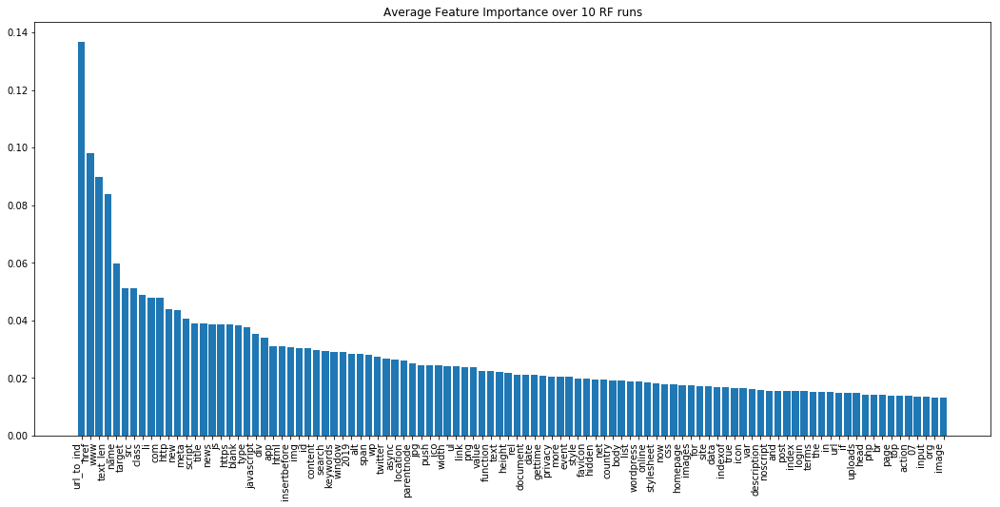

[('url_to_ind', 0.1368643929416823),
 ('href', 0.09800184716963063),
 ('www', 0.08970022070589824),
 ('text_len', 0.0838874645669592),
 ('name', 0.05986061385307456),
 ('target', 0.051306680508414526),
 ('src', 0.05123224122588181),
 ('class', 0.04899247127522119),
 ('li', 0.047753031059479485),
 ('com', 0.0477265500811536),
 ('http', 0.04386228259688999),
 ('new', 0.04350205867922811),
 ('meta', 0.04047931409860239),
 ('script', 0.03913125206024786),
 ('title', 0.038990464694288414),
 ('news', 0.03874960454061269),
 ('js', 0.038662538459467245),
 ('https', 0.03856356976544448),
 ('blank', 0.03839850664447772),
 ('type', 0.03757222666983391),
 ('javascript', 0.03519331630026629),
 ('div', 0.034153252138471805),
 ('app', 0.03107280240084506),
 ('html', 0.030959333007005756),
 ('insertbefore', 0.030590189519868884),
 ('img', 0.030425060839937648),
 ('id', 0.030258840208731354),
 ('content', 0.02962322496076812),
 ('search', 0.02928936329408192),
 ('keywords', 0.028994048368824132),
 ('wi

In [25]:
# run a random forest 'runs' times keeping averages of accuracy and feature importances, then graph 

word_dict = {}
acc = 0
runs = 10
plt.figure(figsize=(20,10))
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size= 0.6, test_size=0.4, random_state=25)
for i in range(runs):
    #if i % 5 == 0:
    #X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size= 0.6, test_size=0.4, random_state = 30+i)
    forest = RandomForestClassifier(n_estimators=80, random_state = i )
    forest.fit(X_train,Y_train)
    #print()
    score = forest.score(X_test,Y_test)
    acc+= forest.score(X_test,Y_test)
    print(str(score)+', '+str(acc/(i+1)))
    #print(*(sorted(list(zip(vocab+['url_to_ind','text_len'],forest.feature_importances_)), key=lambda x: x[1],reverse=True))[:10], sep = '\n')
    #print(classification_report(Y_test,forest.predict(X_test)))
    vals = sorted(list(zip(vocab+['url_to_ind','text_len'],forest.feature_importances_)), key=lambda x: x[1],reverse=True)
    for (x,y) in vals:
        if y > .00000009:
            if x in word_dict.keys():
                word_dict[x] = word_dict.get(x) + y
            else:
                word_dict[x] = y
print(len(word_dict.keys()))
print('avg val accuracy: '+str(acc/runs))
q = 100 #number of tokens to show on graph
plt.figure(figsize=(18,8))
words = sorted(list(word_dict.items()),key=lambda x: x[1],reverse=True)
plt.bar(range(q), [y for (x,y) in words[:q]], align='center')
#plt.bar(range(len(word_dict)), word_dict.values(), align='center')
plt.xticks(range(0,q), [x for x,y in words[:q]])
plt.setp(plt.gca().get_xticklabels(), rotation=90, horizontalalignment='right')
plt.title('Average Feature Importance over 10 RF runs')
plt.show()
words[:150]

In [66]:
#show difference in average value of tokens between classes 
pd.options.display.float_format = '{:.5f}'.format
Z = temp_df.groupby('unsafe', as_index=False).mean()
L = [x for x,y in words[:500]]
vals = np.array(Z[L].T)
Z = Z[L].T

Z['dif']=np.subtract(vals[:,1],vals[:,0])
Z[Z['dif']<0]
#Z.sort_values(by = 'dif', ascending=False).head(60)
#temp_df.head(50)

,0,1,dif
href,0.02813,0.00780,-0.02033
www,0.01043,0.00325,-0.00718
name,0.00694,0.00219,-0.00475
target,0.01042,0.00211,-0.00831
src,0.01267,0.00461,-0.00806
com,0.02612,0.00810,-0.01802
class,0.01536,0.00555,-0.00980
li,0.00577,0.00217,-0.00360
new,0.00328,0.00108,-0.00221
blank,0.00795,0.00145,-0.00650


### Same as above except with the words only


In [26]:
#adjust X to get the tokens only
'''
scaler = preprocessing.MinMaxScaler()
scaled_data = scaler.fit_transform(data)
X = pd.DataFrame(scaled_data,columns=vocab+['url_to_ind','text_len','unsafe'])#np.column_stack([data,labels])
X = X.drop_duplicates()
X = X.drop(columns=['url_to_ind','text_len'])

X1 = X[X['unsafe']==1].sample(frac=1)
print(X1.shape)
X0 = X[X['unsafe']==0].sample(frac=1)
print(X0.shape)
if(X0.shape[0] < X1.shape[0]):
    X1 = X1.reset_index(drop=True).loc[:(X0.shape[0]),:]
else: 
    X0 = X0.reset_index(drop=True).loc[:(X1.shape[0]),:]
print(X1.shape)
print(X0.shape)
temp_df = pd.concat([X0,X1]).sample(frac=1)
'''
X = temp_df.drop(columns=['unsafe','url_to_ind', 'text_len'])
Y = temp_df['unsafe']


0.7934825284648607
0.7962308598351001
0.7950530035335689
0.7950530035335689
0.7966234786022772
0.7868080094228505
0.7981939536709854
0.7919120533961523
0.7942677659992148
0.790341578327444
6981
avg val accuracy: 0.7937966234786022


<Figure size 1800x720 with 0 Axes>

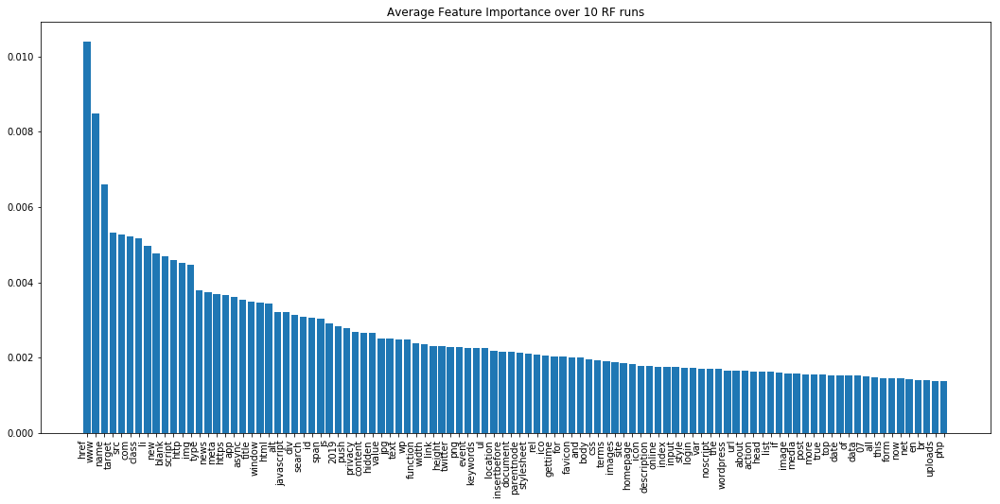

In [27]:
#essentially same as above
word_dict = {}
plt.figure(figsize=(25,10))
acc = 0
runs = 10
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size= 0.6, test_size=0.4, random_state = 25)
for i in range(runs):
    forest = RandomForestClassifier(n_estimators=80, random_state = i )
    forest.fit(X_train,Y_train)
    #print()
    print(forest.score(X_test,Y_test))
    #print(*(sorted(list(zip(vocab,forest.feature_importances_)), key=lambda x: x[1],reverse=True))[:10], sep = '\n')
    #print(classification_report(Y_test,forest.predict(X_test)))
    vals = sorted(list(zip(vocab,forest.feature_importances_)), key=lambda x: x[1],reverse=True)
    acc += forest.score(X_test,Y_test)
    for (x,y) in vals:
        if y > .00000000000000009:#might not even be helpful, was trying to speed things up
            if x in word_dict.keys():
                word_dict[x] = word_dict.get(x) + y
            else:
                word_dict[x] = y
print(len(word_dict.keys()))
print('avg val accuracy: '+str(acc/10))
q = 100 #number of tokens to show on graph
plt.figure(figsize=(18,8))
words = sorted(list(word_dict.items()),key=lambda x: x[1],reverse=True)
plt.bar(range(q), [y/runs for (x,y) in words[:q]], align='center')
#plt.bar(range(len(word_dict)), word_dict.values(), align='center')
plt.xticks(range(0,q), [x for x,y in words[:q]])
plt.setp(plt.gca().get_xticklabels(), rotation=90, horizontalalignment='right')
plt.title('Average Feature Importance over 10 RF runs')
plt.show()

In [ ]:
#add all columns back into X if desired
X = temp_df.drop(columns=['unsafe'])
Y = temp_df['unsafe']

In [13]:
#try logistic regression
from sklearn.linear_model import LogisticRegression
for i in range(10):
    clf = LogisticRegression(random_state=i)
    clf.fit(X_train,Y_train)
    print(clf.score(X_test,Y_test))
    #print(classification_report(Y_test,clf.predict(X_test)))

0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631
0.7797408716136631


In [17]:
#try MLP classifier
from sklearn.neural_network import MLPClassifier
for i in range(1):
    clf = MLPClassifier(verbose=True, batch_size= 10, random_state = i)
    clf.fit(X_train,Y_train)
    print(clf.score(X_test,Y_test))
#print(classification_report(Y_test,clf.predict(X_test)))

Iteration 1, loss = 0.53015574
Iteration 2, loss = 0.42356968
Iteration 3, loss = 0.35785232
Iteration 4, loss = 0.31452475
Iteration 5, loss = 0.27805122
Iteration 6, loss = 0.25438985
Iteration 7, loss = 0.22823553
Iteration 8, loss = 0.21196077
Iteration 9, loss = 0.19584705
Iteration 10, loss = 0.18342223
Iteration 11, loss = 0.17352709
Iteration 12, loss = 0.16429889
Iteration 13, loss = 0.15652549
Iteration 14, loss = 0.15293165
Iteration 15, loss = 0.14479384
Iteration 16, loss = 0.14259555
Iteration 17, loss = 0.14242437
Iteration 18, loss = 0.13570167
Iteration 19, loss = 0.12867084
Iteration 20, loss = 0.12569336
Iteration 21, loss = 0.15004862
Iteration 22, loss = 0.13463014
Iteration 23, loss = 0.12494010
Iteration 24, loss = 0.12265988
Iteration 25, loss = 0.11855386
Iteration 26, loss = 0.11772297
Iteration 27, loss = 0.11708884
Iteration 28, loss = 0.11298750
Iteration 29, loss = 0.11276177
Iteration 30, loss = 0.10801802
Iteration 31, loss = 0.11018372
Iteration 32, los

## NN Trials
Rest of the file is various sequential models 

In [9]:
from keras.models import Sequential
from keras import layers
model = Sequential()
model.add(layers.Dense(40, input_dim=X_train.shape[1], activation='relu'))
model.add(layers.Dropout(0.1))
model.add(layers.Dense(10, input_dim=X_train.shape[1], activation='relu'))
model.add(layers.Dropout(0.1))
model.add(layers.Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history = model.fit(X_train,Y_train, epochs=130, verbose=1, validation_data=(X_test,Y_test), batch_size=9)
loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))



Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Instructions for updating:
Use tf.cast instead.
Train on 3820 samples, validate on 2547 samples
Epoch 1/130
3820/3820 [==============================] - 3s 835us/step - loss: 0.5679 - acc: 0.7338 - val_loss: 0.5197 - val_acc: 0.7735
Epoch 2/130
3820/3820 [==============================] - 3s 720us/step - loss: 0.4408 - acc: 0.8073 - val_loss: 0.5087 - val_acc: 0.7829
Epoch 3/130
3820/3820 [==============================] - 3s 701us/step - loss: 0.3687 - acc: 0.8401 - val_loss: 0.5146 - val_acc: 0.7809
Epoch 4/130
3820/3820 [==============================] - 3s 695us/step - loss: 0.3114 - acc: 0.8715 - val_loss: 0.6136 - val_acc: 0.7766
Epoch 5/130
3820/3820 [==============================] - 3s 717us/step - loss: 0.2736 - acc: 0.8869 - val_loss: 0.6011 - val_acc: 0.7876
Epoch 6/130
3820/3820 [=========

3820/3820 [==============================] - 3s 710us/step - loss: 0.0489 - acc: 0.9798 - val_loss: 2.1569 - val_acc: 0.7640
Epoch 113/130
3820/3820 [==============================] - 3s 705us/step - loss: 0.0450 - acc: 0.9814 - val_loss: 2.1665 - val_acc: 0.7574
Epoch 114/130
3820/3820 [==============================] - 3s 736us/step - loss: 0.0463 - acc: 0.9812 - val_loss: 2.1963 - val_acc: 0.7597
Epoch 115/130
3820/3820 [==============================] - 3s 739us/step - loss: 0.0407 - acc: 0.9840 - val_loss: 2.2142 - val_acc: 0.7648
Epoch 116/130
3820/3820 [==============================] - 3s 749us/step - loss: 0.0433 - acc: 0.9822 - val_loss: 2.2796 - val_acc: 0.7601
Epoch 117/130
3820/3820 [==============================] - 3s 898us/step - loss: 0.0447 - acc: 0.9843 - val_loss: 2.1242 - val_acc: 0.7613
Epoch 118/130
3820/3820 [==============================] - 3s 743us/step - loss: 0.0507 - acc: 0.9806 - val_loss: 2.1999 - val_acc: 0.7542
Epoch 119/130
3820/3820 [================

In [ ]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]

for i in range(10):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(5, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 5 - 1')
plt.show()

0
Train on 3820 samples, validate on 2547 samples
Epoch 1/150
3820/3820 [==============================] - 2s 595us/step - loss: 0.6878 - acc: 0.5895 - val_loss: 0.6832 - val_acc: 0.6180
Epoch 2/150
3820/3820 [==============================] - 2s 518us/step - loss: 0.6796 - acc: 0.6264 - val_loss: 0.6740 - val_acc: 0.6447
Epoch 3/150
3820/3820 [==============================] - 2s 545us/step - loss: 0.6709 - acc: 0.6568 - val_loss: 0.6646 - val_acc: 0.6592
Epoch 4/150
3820/3820 [==============================] - 2s 520us/step - loss: 0.6623 - acc: 0.6547 - val_loss: 0.6559 - val_acc: 0.6722
Epoch 5/150
3820/3820 [==============================] - 2s 517us/step - loss: 0.6544 - acc: 0.6762 - val_loss: 0.6480 - val_acc: 0.6796
Epoch 6/150
3820/3820 [==============================] - 2s 520us/step - loss: 0.6471 - acc: 0.6903 - val_loss: 0.6407 - val_acc: 0.6981
Epoch 7/150
3820/3820 [==============================] - 2s 540us/step - loss: 0.6403 - acc: 0.6997 - val_loss: 0.6342 - val_acc

3820/3820 [==============================] - 2s 528us/step - loss: 0.5034 - acc: 0.7903 - val_loss: 0.5278 - val_acc: 0.7699
Epoch 61/150
3820/3820 [==============================] - 2s 518us/step - loss: 0.5018 - acc: 0.7914 - val_loss: 0.5269 - val_acc: 0.7723
Epoch 62/150
3820/3820 [==============================] - 2s 515us/step - loss: 0.5002 - acc: 0.7921 - val_loss: 0.5260 - val_acc: 0.7727
Epoch 63/150
3820/3820 [==============================] - 2s 512us/step - loss: 0.4987 - acc: 0.7921 - val_loss: 0.5251 - val_acc: 0.7727
Epoch 64/150
3820/3820 [==============================] - 2s 504us/step - loss: 0.4971 - acc: 0.7937 - val_loss: 0.5242 - val_acc: 0.7731
Epoch 65/150
3820/3820 [==============================] - 2s 511us/step - loss: 0.4955 - acc: 0.7942 - val_loss: 0.5234 - val_acc: 0.7727
Epoch 66/150
3820/3820 [==============================] - 2s 511us/step - loss: 0.4940 - acc: 0.7958 - val_loss: 0.5225 - val_acc: 0.7735
Epoch 67/150
3820/3820 [=======================

3820/3820 [==============================] - 2s 512us/step - loss: 0.5583 - acc: 0.7681 - val_loss: 0.5644 - val_acc: 0.7648
Epoch 28/150
3820/3820 [==============================] - 2s 521us/step - loss: 0.5557 - acc: 0.7702 - val_loss: 0.5627 - val_acc: 0.7648
Epoch 29/150
3820/3820 [==============================] - 2s 534us/step - loss: 0.5532 - acc: 0.7715 - val_loss: 0.5610 - val_acc: 0.7640
Epoch 30/150
3820/3820 [==============================] - 2s 511us/step - loss: 0.5508 - acc: 0.7715 - val_loss: 0.5593 - val_acc: 0.7640
Epoch 31/150
3820/3820 [==============================] - 2s 544us/step - loss: 0.5484 - acc: 0.7730 - val_loss: 0.5577 - val_acc: 0.7652
Epoch 32/150
3820/3820 [==============================] - 2s 505us/step - loss: 0.5461 - acc: 0.7751 - val_loss: 0.5562 - val_acc: 0.7656
Epoch 33/150
3820/3820 [==============================] - 2s 504us/step - loss: 0.5437 - acc: 0.7746 - val_loss: 0.5547 - val_acc: 0.7664
Epoch 34/150
3820/3820 [=======================

3820/3820 [==============================] - 2s 504us/step - loss: 0.3748 - acc: 0.8492 - val_loss: 0.4820 - val_acc: 0.7919
Epoch 146/150
3820/3820 [==============================] - 2s 530us/step - loss: 0.3736 - acc: 0.8500 - val_loss: 0.4820 - val_acc: 0.7915
Epoch 147/150
3820/3820 [==============================] - 2s 515us/step - loss: 0.3726 - acc: 0.8500 - val_loss: 0.4817 - val_acc: 0.7919
Epoch 148/150
3820/3820 [==============================] - 2s 624us/step - loss: 0.3715 - acc: 0.8503 - val_loss: 0.4816 - val_acc: 0.7915
Epoch 149/150
3820/3820 [==============================] - 2s 537us/step - loss: 0.3704 - acc: 0.8497 - val_loss: 0.4815 - val_acc: 0.7915
Epoch 150/150
3820/3820 [==============================] - 2s 511us/step - loss: 0.3694 - acc: 0.8513 - val_loss: 0.4813 - val_acc: 0.7919
Training Accuracy: 0.8524
Testing Accuracy:  0.7919
2
Train on 3820 samples, validate on 2547 samples
Epoch 1/150
3820/3820 [==============================] - 2s 640us/step - loss:

Epoch 54/150
3820/3820 [==============================] - 2s 548us/step - loss: 0.5560 - acc: 0.7738 - val_loss: 0.5598 - val_acc: 0.7621
Epoch 55/150
3820/3820 [==============================] - 2s 514us/step - loss: 0.5544 - acc: 0.7736 - val_loss: 0.5586 - val_acc: 0.7621
Epoch 56/150
3820/3820 [==============================] - 2s 551us/step - loss: 0.5529 - acc: 0.7741 - val_loss: 0.5574 - val_acc: 0.7621
Epoch 57/150
3820/3820 [==============================] - 2s 526us/step - loss: 0.5513 - acc: 0.7746 - val_loss: 0.5563 - val_acc: 0.7629
Epoch 58/150
3820/3820 [==============================] - 2s 516us/step - loss: 0.5498 - acc: 0.7749 - val_loss: 0.5552 - val_acc: 0.7633
Epoch 59/150
3820/3820 [==============================] - 2s 534us/step - loss: 0.5482 - acc: 0.7746 - val_loss: 0.5541 - val_acc: 0.7636
Epoch 60/150
3820/3820 [==============================] - 2s 513us/step - loss: 0.5468 - acc: 0.7759 - val_loss: 0.5530 - val_acc: 0.7636
Epoch 61/150
3820/3820 [==========

3820/3820 [==============================] - 2s 533us/step - loss: 0.5930 - acc: 0.7560 - val_loss: 0.5916 - val_acc: 0.7523
Epoch 22/150
3820/3820 [==============================] - 2s 543us/step - loss: 0.5901 - acc: 0.7597 - val_loss: 0.5890 - val_acc: 0.7530
Epoch 23/150
3820/3820 [==============================] - 2s 602us/step - loss: 0.5873 - acc: 0.7618 - val_loss: 0.5866 - val_acc: 0.7538
Epoch 24/150
3820/3820 [==============================] - 2s 591us/step - loss: 0.5845 - acc: 0.7623 - val_loss: 0.5842 - val_acc: 0.7538
Epoch 25/150
3820/3820 [==============================] - 2s 574us/step - loss: 0.5819 - acc: 0.7644 - val_loss: 0.5820 - val_acc: 0.7566
Epoch 26/150
3820/3820 [==============================] - 2s 571us/step - loss: 0.5793 - acc: 0.7657 - val_loss: 0.5798 - val_acc: 0.7570
Epoch 27/150
3820/3820 [==============================] - 2s 524us/step - loss: 0.5768 - acc: 0.7654 - val_loss: 0.5778 - val_acc: 0.7585
Epoch 28/150
3820/3820 [=======================

3820/3820 [==============================] - 2s 508us/step - loss: 0.4199 - acc: 0.8283 - val_loss: 0.4917 - val_acc: 0.7880
Epoch 140/150
3820/3820 [==============================] - 2s 528us/step - loss: 0.4188 - acc: 0.8283 - val_loss: 0.4913 - val_acc: 0.7876
Epoch 141/150
3820/3820 [==============================] - 2s 541us/step - loss: 0.4178 - acc: 0.8288 - val_loss: 0.4909 - val_acc: 0.7876
Epoch 142/150
3820/3820 [==============================] - 2s 534us/step - loss: 0.4167 - acc: 0.8285 - val_loss: 0.4904 - val_acc: 0.7884
Epoch 143/150
3820/3820 [==============================] - 2s 526us/step - loss: 0.4156 - acc: 0.8285 - val_loss: 0.4901 - val_acc: 0.7888
Epoch 144/150
3820/3820 [==============================] - 2s 518us/step - loss: 0.4146 - acc: 0.8291 - val_loss: 0.4897 - val_acc: 0.7884
Epoch 145/150
3820/3820 [==============================] - 2s 533us/step - loss: 0.4135 - acc: 0.8306 - val_loss: 0.4893 - val_acc: 0.7888
Epoch 146/150
3820/3820 [================

Epoch 48/150
3820/3820 [==============================] - 3s 655us/step - loss: 0.5453 - acc: 0.7798 - val_loss: 0.5577 - val_acc: 0.7656
Epoch 49/150
3820/3820 [==============================] - 2s 531us/step - loss: 0.5433 - acc: 0.7817 - val_loss: 0.5562 - val_acc: 0.7664
Epoch 50/150
3820/3820 [==============================] - 2s 531us/step - loss: 0.5413 - acc: 0.7817 - val_loss: 0.5548 - val_acc: 0.7687
Epoch 51/150
3820/3820 [==============================] - 2s 528us/step - loss: 0.5393 - acc: 0.7843 - val_loss: 0.5534 - val_acc: 0.7699
Epoch 52/150
3820/3820 [==============================] - 2s 526us/step - loss: 0.5374 - acc: 0.7840 - val_loss: 0.5521 - val_acc: 0.7699
Epoch 53/150
3820/3820 [==============================] - 2s 511us/step - loss: 0.5354 - acc: 0.7843 - val_loss: 0.5508 - val_acc: 0.7695
Epoch 54/150
3820/3820 [==============================] - 2s 537us/step - loss: 0.5335 - acc: 0.7840 - val_loss: 0.5495 - val_acc: 0.7687
Epoch 55/150
3820/3820 [==========

3820/3820 [==============================] - 2s 527us/step - loss: 0.6128 - acc: 0.7547 - val_loss: 0.6091 - val_acc: 0.7534
Epoch 16/150
3820/3820 [==============================] - 2s 523us/step - loss: 0.6088 - acc: 0.7558 - val_loss: 0.6054 - val_acc: 0.7519
Epoch 17/150
3820/3820 [==============================] - 2s 526us/step - loss: 0.6050 - acc: 0.7573 - val_loss: 0.6020 - val_acc: 0.7523
Epoch 18/150
3820/3820 [==============================] - 2s 543us/step - loss: 0.6014 - acc: 0.7607 - val_loss: 0.5987 - val_acc: 0.7523
Epoch 19/150
3820/3820 [==============================] - 2s 549us/step - loss: 0.5980 - acc: 0.7610 - val_loss: 0.5956 - val_acc: 0.7523
Epoch 20/150
3820/3820 [==============================] - 2s 560us/step - loss: 0.5947 - acc: 0.7623 - val_loss: 0.5927 - val_acc: 0.7542
Epoch 21/150
3820/3820 [==============================] - 2s 548us/step - loss: 0.5916 - acc: 0.7620 - val_loss: 0.5900 - val_acc: 0.7554
Epoch 22/150
3820/3820 [=======================

3820/3820 [==============================] - 2s 516us/step - loss: 0.4166 - acc: 0.8298 - val_loss: 0.4899 - val_acc: 0.7848
Epoch 134/150
3820/3820 [==============================] - 2s 543us/step - loss: 0.4156 - acc: 0.8298 - val_loss: 0.4895 - val_acc: 0.7856
Epoch 135/150
3820/3820 [==============================] - 2s 532us/step - loss: 0.4145 - acc: 0.8301 - val_loss: 0.4892 - val_acc: 0.7845
Epoch 136/150
3820/3820 [==============================] - 2s 551us/step - loss: 0.4135 - acc: 0.8309 - val_loss: 0.4888 - val_acc: 0.7848
Epoch 137/150
3820/3820 [==============================] - 2s 525us/step - loss: 0.4124 - acc: 0.8306 - val_loss: 0.4884 - val_acc: 0.7852
Epoch 138/150
3820/3820 [==============================] - 2s 554us/step - loss: 0.4114 - acc: 0.8314 - val_loss: 0.4880 - val_acc: 0.7852
Epoch 139/150
3820/3820 [==============================] - 2s 530us/step - loss: 0.4104 - acc: 0.8325 - val_loss: 0.4877 - val_acc: 0.7856
Epoch 140/150
3820/3820 [================

3820/3820 [==============================] - 2s 555us/step - loss: 0.4413 - acc: 0.8212 - val_loss: 0.4993 - val_acc: 0.7825
Epoch 101/150
3820/3820 [==============================] - 2s 542us/step - loss: 0.4399 - acc: 0.8215 - val_loss: 0.4987 - val_acc: 0.7813
Epoch 102/150
3820/3820 [==============================] - 2s 527us/step - loss: 0.4386 - acc: 0.8220 - val_loss: 0.4982 - val_acc: 0.7809
Epoch 103/150
3820/3820 [==============================] - 2s 532us/step - loss: 0.4372 - acc: 0.8225 - val_loss: 0.4975 - val_acc: 0.7809
Epoch 104/150
3820/3820 [==============================] - 2s 523us/step - loss: 0.4359 - acc: 0.8225 - val_loss: 0.4969 - val_acc: 0.7813
Epoch 105/150
3820/3820 [==============================] - 2s 533us/step - loss: 0.4346 - acc: 0.8233 - val_loss: 0.4964 - val_acc: 0.7825
Epoch 106/150
3820/3820 [==============================] - 2s 541us/step - loss: 0.4333 - acc: 0.8241 - val_loss: 0.4958 - val_acc: 0.7837
Epoch 107/150
3820/3820 [================

3820/3820 [==============================] - 2s 534us/step - loss: 0.5689 - acc: 0.7668 - val_loss: 0.5852 - val_acc: 0.7491
Epoch 68/150
3820/3820 [==============================] - 2s 534us/step - loss: 0.5679 - acc: 0.7668 - val_loss: 0.5846 - val_acc: 0.7499
Epoch 69/150
3820/3820 [==============================] - 2s 541us/step - loss: 0.5668 - acc: 0.7668 - val_loss: 0.5841 - val_acc: 0.7491
Epoch 70/150
3820/3820 [==============================] - 2s 547us/step - loss: 0.5657 - acc: 0.7670 - val_loss: 0.5835 - val_acc: 0.7483
Epoch 71/150
3820/3820 [==============================] - 2s 539us/step - loss: 0.5647 - acc: 0.7683 - val_loss: 0.5828 - val_acc: 0.7507
Epoch 72/150
3820/3820 [==============================] - 2s 545us/step - loss: 0.5636 - acc: 0.7704 - val_loss: 0.5823 - val_acc: 0.7511
Epoch 73/150
3820/3820 [==============================] - 2s 526us/step - loss: 0.5626 - acc: 0.7715 - val_loss: 0.5817 - val_acc: 0.7530
Epoch 74/150
3820/3820 [=======================

3820/3820 [==============================] - 2s 544us/step - loss: 0.5618 - acc: 0.7675 - val_loss: 0.5682 - val_acc: 0.7558
Epoch 35/150
3820/3820 [==============================] - 2s 533us/step - loss: 0.5597 - acc: 0.7699 - val_loss: 0.5667 - val_acc: 0.7574
Epoch 36/150
3820/3820 [==============================] - 2s 535us/step - loss: 0.5576 - acc: 0.7702 - val_loss: 0.5652 - val_acc: 0.7601
Epoch 37/150
1500/3820 [==========>...................] - ETA: 0s - loss: 0.5528 - acc: 0.7773

In [8]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))
for i in range(10):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(10, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(5, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('10 - 5 - 1')
plt.set_xlim(top=65)
plt.show()

Using TensorFlow backend.


0


NameError: name 'Sequential' is not defined

<Figure size 1008x720 with 0 Axes>

In [ ]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))
for i in range(5):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(5, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(10, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('5 - 10 - 1')
plt.show()

In [ ]:
#appears best at a glance
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))
for i in range(5):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(10, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 10 - 1')
plt.show()

In [ ]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))

for i in range(5):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(5, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 5 - 1')
plt.set_xlim(top=65)
plt.show()

In [ ]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))

for i in range(5):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    model.add(layers.Dense(10, activation='relu'))
    model.add(layers.Dropout(0.1))
    model.add(layers.Dense(5, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 10 - 5 - 1')
plt.set_xlim(top=65)
plt.show()

In [ ]:
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))
for i in range(10):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    model.add(layers.Dropout(0.05))
    model.add(layers.Dense(10, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 10 - 1')
plt.show()

In [ ]:
#appears best at a glance
import keras
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from numpy.random import seed
callbacks = [EarlyStopping(monitor='val_loss', min_delta=.0001, patience=5, verbose=0, mode='auto', baseline=None, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=0, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)]
plt.figure(figsize=(14,10))
for i in range(25):
    print(i)
    seed(i)
    model = Sequential()
    model.add(layers.Dense(15, input_dim=X_train.shape[1], activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(10, activation='relu'))
    #model.add(layers.Dropout(0.1))
    model.add(layers.Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=['accuracy'])
    history = model.fit(X_train,Y_train, epochs=150, verbose=1, callbacks=callbacks, validation_data=(X_test,Y_test), batch_size=10)
    loss, accuracy = model.evaluate(X_train, Y_train, verbose=False)
    print("Training Accuracy: {:.4f}".format(accuracy))
    loss, accuracy = model.evaluate(X_test, Y_test, verbose=False)
    print("Testing Accuracy:  {:.4f}".format(accuracy))
    plt.plot(history.history['val_acc'])
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.title('15 - 10 - 1')
plt.set_xlim(top=65)
plt.show()

In [11]:
#pairs = load_obj('sorted_kvpairs_url')
pairs[100:300]

[('content', 4959),
 ('return', 4958),
 ('u', 4932),
 ('more', 4931),
 ('o', 4910),
 ('&', 4894),
 ('images', 4872),
 ('br', 4861),
 ('value', 4855),
 ('left', 4853),
 ('new', 4834),
 ('2019', 4833),
 ('|', 4826),
 ('false', 4811),
 ('m', 4765),
 ('w', 4755),
 ('input', 4746),
 ('as', 4732),
 ('true', 4706),
 ('\x00]', 4700),
 ('$', 4684),
 ('font-family', 4667),
 ('form', 4653),
 ('display', 4648),
 ('arial', 4648),
 ('en', 4640),
 ('id', 4626),
 ('background-color', 4606),
 ('l', 4589),
 ('h2', 4554),
 ('no', 4533),
 ('type', 4501),
 ('ie', 4488),
 ('please', 4474),
 ('all', 4456),
 ('you', 4435),
 ('top', 4413),
 ('document', 4398),
 ('page', 4396),
 ('[', 4350),
 ('it', 4278),
 ('header', 4274),
 ('10px', 4266),
 ('20px', 4241),
 ('10', 4217),
 ('name', 4194),
 ('src=https', 4179),
 ('button', 4158),
 ('target=_blank', 4130),
 ('us', 4121),
 ('11', 4118),
 ('not', 4116),
 ('\x02', 4097),
 ('100%', 4094),
 ('window', 4092),
 ('footer', 4025),
 ('h3', 3976),
 ('1px', 3975),
 ('or', 3

In [23]:
p1 = load_obj('sorted_kvpairs_url')
p2 = load_obj('new_sorted_kvpairs')
print(*(list(zip(p1,p2))), sep='\n')

(('\x00', 190965), ('html', 19063))
(('id=\x00', 29255), ('head', 18865))
(('title', 13983), ('body', 18608))
(('a', 12633), ('meta', 17948))
(('head', 12588), ('title', 17780))
(('0', 11947), ('a', 17517))
(('css', 11754), ('0', 17420))
(('html', 11339), ('p', 16583))
(('body', 11029), ('div', 16485))
(('type=text', 10978), ('type=text', 15683))
(('p', 10174), ('doctype', 15566))
(('-', 9946), ('charset=utf-8', 15266))
(('meta', 9876), ('css', 15015))
(('script', 9777), ('ul', 14964))
(('url', 9522), ('li', 14934))
(('s', 9448), ('\x00', 14749))
(('none', 9422), ('script', 14592))
(('div', 9401), ('link', 14512))
(('1', 8980), ('-', 14481))
(('charset=utf-8', 8779), ('=', 14208))
(('style', 8738), ('if', 13920))
(('li', 8236), ('1', 13701))
(('ul', 8235), ('for', 13646))
(('https', 8020), ('img', 13594))
(('for', 7901), ('s', 13558))
(("'", 7894), ('var', 13351))
(('!doctype', 7763), ('--', 13348))
(('2', 7745), ('i', 13254))
(('class=\x00', 7745), ('none', 13090))
(('+', 7736), ('fun

(('\x18y', 959), ('border-left', 1173))
(('\u07fc', 959), ('\x00\x1a', 1173))
(('these', 958), ('\x03o', 1173))
(('underline', 958), ('ie8', 1172))
(('figure', 958), ('s.src', 1172))
(("9'", 958), ('fl', 1172))
(('9k', 958), ('ϡ', 1172))
(('.g', 958), ('&z', 1171))
(('u7', 958), ('w5', 1170))
(('w^', 958), ('ӹ', 1170))
(('\x16x', 958), ('7j', 1169))
(('\x7fu', 958), ('encoding=utf-8', 1168))
(('q\x16', 958), ('g#', 1168))
(('g`', 958), ('p@', 1168))
(('߬', 958), ('ѡ', 1168))
(('\x07g', 958), ('\x1ar', 1168))
(('w\x13', 958), ('ͼ', 1168))
(('\x03z', 958), ('.e', 1167))
(('݇', 958), ('k3', 1167))
(('8h', 957), ('8m', 1167))
(('j4', 957), ('67', 1166))
(("u'", 957), ('û', 1166))
(('c\x04', 957), ('\x0eq', 1166))
(('ѻ', 957), ('t\x7f', 1166))
(('`\x07', 957), ('w\x16', 1166))
(('d%', 957), ('s\x15', 1166))
(('\x17e', 957), ('sizes=72x72', 1165))
(('e%', 957), ('professional', 1165))
(('ο', 956), ('#main', 1165))
(("'t", 956), ('đ', 1165))
(('\x17i', 956), ('\x01k', 1165))
(('x[', 956), ('o

(('\U000ffb05', 814), ('rw', 814))
(('^&ի', 814), ('r++', 814))
(('lו\x01\x17d', 814), ('cil', 814))
(('mb[f7x', 814), ('d\x10a', 814))
(('`\x10\x00\x07\x04project-', 814), ('clv', 814))
(('fvy\x05', 814), ('zjj', 814))
(('\x00\x00\x00normal.dotm\x00', 814), ('o\x08\x00', 814))
(('s߱s', 814), ('qrf', 814))
(('\x03\x00\x00\x00\x0f\x00\x00\x10', 814), ('sٯ', 814))
(('\x04\x00\x008\x01\x00\x00x\x01\x00\x00', 814), ('k\x10\x00\x03\x04vba', 814))
(('\x00\x00\x10\x00\x0f\x00\x02', 814), ('\x00@\x00\x00\x00\x00\x00\x00\x00\x00', 814))
(('\ue339', 814), ('\x03\x00\x00\x06\x04\x00\x00\x16\x04\x00\x00&\x04\x00\x006\x04\x00\x00f\x04\x00\x00v\x04\x00\x00f\x04\x00\x00v\x04\x00\x00', 814))
(("%qh|\x18'\x16", 814), ('j\x04\x00aj\x10\x00n\x00', 814))
(('\x03\x03\x00set\x00\x00', 814), ('\x01\x00\x00\x00\x00\x00\x00t\x00i\x00m\x00e\x00s\x00', 814))
(('\x03\x03\x00tb15', 814), ('kq\x02j', 814))
(('\x03\x01\x00addtextbox\x0e', 814), ('\x00\x00\x00\x10\x00\x08', 814))
(('\x00\x00\x14\x00cj\x10\x00oj\x04\x

(('%n[', 774), ('\x08zrax8\x03', 769))
(('6q\x01', 774), ('\x08\x131a\x14\x177sv', 769))
(('繯', 774), ('sg͋', 769))
(('\x11=d', 774), ('\x02\x06\x08\x05\x04\x03\x01', 769))
(('mk\x18', 774), ('d.h2', 769))
(('h$\x01', 774), ('r\x07\x17\x04g', 769))
(('bפ', 774), ('\x19\x7fmۆ', 769))
(('帟', 774), ('ܣ-k', 769))
(('\x01̯', 774), ('k\x18$q$', 769))
(('\x03ɧ', 774), ('5u٪', 769))
(('y\x19#', 774), ('=ueoy\x14', 769))
(('ڧj', 774), ('\x0ed\x03ϟ\x08\x99', 769))
(('₆', 774), ('e\ue69d', 769))
(('ܪ*', 774), ('`\x02ob', 769))
(('p\x07\x07', 774), ('.9-\x00v', 769))
(('n\x0e\x14', 774), ('僿\x18\x00\x07', 769))
(("\x00'f", 774), ('ֺwx', 769))
(('d\x11\x19', 774), ('i验', 769))
(('14l', 774), ('p\x14lή', 769))
(('\x1b^x', 774), ('nffv֣=\x05', 769))
(('h˄', 774), ('og\x10+', 769))
(('`\x0fe', 774), ('7\x19\x0fi\x04', 769))
(('5ƚ', 774), ('d@dd\x04d@dd\x04da', 769))
(('㻈', 774), ('oy#x', 769))
(('9d\x10', 774), ('`-`h##', 769))
(('qڦ', 774), ('\x06\x0e\x063', 769))
((']˝', 774), ('i-i=', 769))
(('\x00

(('\x11\x01\x11\x10\x11f\x17+\x16', 769), ('360', 534))
(('mhiw', 769), ('domcontent', 534))
(('etz鮵f\x1a', 769), ('k0', 534))
(('d@dd\x04d@dd\x04da', 769), ('2.7', 534))
(('kz\x08#', 769), ('yandex', 534))
(('^kdc', 769), ('powerful', 534))
(('\x1bmei\x13b', 769), ('\x04x', 534))
(('\x02i\x08iq', 769), ('3y', 534))
(('yq\x00\x18', 769), ('4j', 534))
(('9ēa', 769), ('\x1ak', 534))
((']\x14mˇ\x1b', 769), ('\x1az', 534))
(('\x11\x10\x11\x11\x01\x11\x10\x11\x14', 769), ('y\x11', 534))
(('\x08h#$9', 769), ('*b', 534))
(('\x06=ż', 769), ('ң', 534))
(('[\x13k\\', 769), ('\x08s', 534))
(('ncky$', 769), ('ǭ', 534))
(("\uf1aa'ut", 769), ('\x02\x03\x00', 534))
(('䃟6f', 769), ('enough', 533))
(('㨬7z', 769), ('opt', 533))
(('-%1c', 769), ('tweet', 533))
(('z\x07p\x00\x00?r\x0f', 769), ('$d', 533))
(('u\x15qau#', 769), ('.t', 533))
(('i\x18\x04\x12\x08\x04`', 769), ('n-', 533))
(('kxɨvc\x04', 769), ('y*', 533))
(('\x00\x00nc', 769), ('x`', 533))
(('\x17e\x7fce', 769), ('w\x18', 533))
(('ǝaߦ9vg', 76

(('ij', 432), ('\x17d', 459))
(('ux', 432), ('τ', 459))
(('hw', 432), ('g\x16', 459))
(('rel=bookmark', 431), ('\x08l', 459))
(('!t', 431), ('\x10l', 459))
(('due', 431), ('\x12n', 459))
(('dw', 431), ('for.', 458))
(('name=email', 430), ('manual', 458))
(('87', 430), ('.resize', 458))
(('a++', 430), ('750', 458))
(('%s', 430), ('shown', 458))
(('noframes', 430), ('machine', 458))
(('b@', 430), ('essential', 458))
(('times', 429), ('#666666', 458))
(('fullscreen', 429), ('words', 458))
(('rel=preload', 429), ('8s', 458))
(('green', 429), ('6j', 458))
(('4z', 429), ('r\x17', 458))
(('\x0fh', 429), ('\x05\x03', 458))
(('h`', 429), ('y\x0f', 458))
(('c\x17', 429), ('l*', 458))
(('vw', 428), ('\x05\x1a', 458))
(('a?', 428), ('u\x1b', 458))
(('chinese', 428), ('\x12z', 458))
(('*\\', 428), ('y\x15', 458))
(('popup', 427), ('@\x00', 458))
(('sizes=76x76', 427), ('ר', 458))
(('unescape', 427), ('r\x18', 458))
(('#footer', 427), ('\x03s', 458))
(('customers', 427), ('ڐ', 458))
(('php', 427), (

(('0j', 317), ('ͷ', 399))
(('į', 317), ('#post-##', 399))
(('f\x05', 317), ('8j', 399))
(('ś', 317), ('ۑ', 399))
(('\x064', 317), ('\x08=', 399))
(('k=', 317), ('ձ', 399))
(('disable', 316), ('g\x10', 399))
(('unknown', 316), ('m*', 399))
(('45deg', 316), ('&x', 399))
(('kids', 316), ('8\x04', 399))
(('-webkit-box-sizing', 316), ('v\x14', 399))
(('usd', 316), ('\x02~', 399))
(('t\x17', 316), ('l\x12', 399))
(('\x06x', 316), ('~\x7f', 399))
(('ϣ', 316), ('\x00\x00\x00\x04\x00\x00\x00', 399))
(('|\x06', 316), ('\x00\x01\x00\x01\x00\x00\x00\x00\x00\x05\x00\x00\x00', 399))
(('\x00\x00\x00\x00\x00\x00\x00[\x00', 316), ('\x00\x01\x00\x01\x00\x00\x00\x00\x00\x07\x00\x00\x00', 399))
(('las', 315), ('\x02\x00\x00\x00\x00\x00\x00\x00\x00\x04\x00\x00\x00-\x01\x05\x00', 399))
(('.trigger', 315), ('\x01\x018\x00\x00\x00\x02', 399))
(('|0', 315), ('\x08\x00\x00@\x08\x00\x00a\x08\x00\x00b\x08\x00\x00c\x08\x00\x00d\x08\x00\x00l\x08\x00\x00', 399))
(('drive', 315), ('\x01\x00\x00\x07\x00', 399))
(('blo

(('ٮ', 252), ('break-all', 337))
(('˓', 252), ('\x05\x0e', 337))
(('\x19b', 252), ('~.', 337))
(('+\x1a', 252), ('7\x18', 337))
(('\x00\x00\x00r\x00\x00\x00\x00\x00\x00\x00o\x00b\x00j\x00e\x00c\x00t\x00p\x00o\x00o\x00l\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x16\x00\x01\x01', 252), ('gaa', 337))
(('$200!', 252), ('\x96', 337))
(('technical', 251), ('2\x12', 337))
(('class=price', 251), ('\x0f#', 337))
(('ltr', 251), ('ř', 337))
(('.+', 251), ('\x082', 337))
(('+3', 251), ('\x13\x14', 337))
(('steps', 251), ('\x07\x11', 337))
(('a.active', 251), ('̥', 337))
(('122', 251), ('3=', 337))
(('thing', 251), ('̵', 337))
(('handler', 251), ('߳', 337))
(('cookiedomain', 251), ('9\x17', 337))
(('outside', 251), ('҉', 337))
(('four', 251), ('\x7f=', 337))
(('\x9c', 251), ('\x15\x05', 337))
(('relations', 251), ('\x149', 337))
(('overlay', 251), ('\x159', 337))

(('\x19\x0f', 213), ('console.error', 296))
(('x\x14', 213), ('e=a', 296))
(('\x00\x11', 213), ('r=u', 296))
(('ʋ', 213), ('mailchimp', 296))
(('s\x11', 213), ('euro', 296))
(('ӥ', 213), ('countdown', 296))
(('m!', 213), ('со', 296))
(('#\x0e', 213), ('191', 296))
(('ތ', 213), ('вас', 296))
(('ĺ', 213), ('bst', 296))
(('\x07^', 213), ('academy', 296))
(('\x16y', 213), ('800w', 296))
(('\x16\x08', 213), ('.clearfix', 296))
(('z[', 213), ('ſ', 296))
(('̈', 213), ('hook', 296))
(('\x02s', 213), ('ߘ', 296))
(('\x07\x1a', 213), ('̨', 296))
(('\x01\x0e', 213), ('ݿ', 296))
(('\x11\x10\x00\x07', 213), ('9\x1b', 296))
(('i~', 213), ('8\x13', 296))
(('\x1a#', 213), ('\x19~', 296))
(('\x00\x08\x00\x00\x00\x00\x00\x00\x00\x00\x00\x06\x00\x00', 213), ('0\x13', 296))
(('\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x00\x00\x00', 213), ('\u05cd', 296))
(('n.loaded=!0', 212), ('*\x11', 296))
(('showing', 212), ('\x1b\x1a', 296))
(('\\-', 212), ('ב', 296))
(('native',

(('\x10d', 183), ('.status-reason', 253))
(('1\x15', 183), ('hwbvjr6mipkhtaoe54xpbgrl8rixkx1bk3+a1auhhxute3shevnsip4redbnona9nowyewuq54ahpex3naiqlwhiiqlqkpbwsrfpdmdb', 253))
(('\x02\x06', 183), ('hd8tsdcwtbu8w30ssiis7p9nwz7cgaedjlam9ktad0+mxwrse8xstamoriocazmg3bqglqrhvcbu3qhw3+aaohwp52qiafqkawodhkzfneyck4zpp5qh5cp4vfil8wm', 253))
(('\x01\x01\x00', 183), ('.additional-info-items', 253))
(('µ', 183), ('w33pfh31cgybpgw9lba3ic8c8ia77nle514vu8bpj6', 253))
(('\x0e^', 183), ('6givn9ynf8bfbd4rurflwzbvybeqii4i9aky+2r29597', 253))
(('~*', 183), ('#2f3230', 253))
(('ʬ', 183), ('228pkq3nznmqd1w7rmnrwjeqemiwksacmi', 253))
(('ɠ', 183), ('ivborw0kggoaaaansuheugaaapaaaadqcamaaacrxjhdaaaat1bmveuaaaaaaad', 253))
(('\x07y', 183), ('2bm9mvz6ogeyxfokhfmheoewx9cyehvuphmt4jphybtnhxhqmdggbvzjxbuwn2gogbpy6rtcoejnpxfkb+ceyhhcfmj6dqshfegfmt71fopgpe1phomtey8oz3ycr2utiinqeftj3ilm18afsu', 253))
(('\x7f]', 183), ('cchopptlicmgxiax3qfyqirci3cq2znk3tyduunpxipus8joli5e1u2ywn1kxd3uv9vxadvnjntiksh1v3bse', 253))
(('m\x07'

(('wwos.nine.com.au', 162), ('parameters', 214))
(('ddunqj', 162), ('haben', 214))
(('nine.com.au', 162), ('electrical', 214))
(('\x06\x00\x00\x00\x00\x00\x00\x03\x00\x00\x00', 162), ('sensitive', 214))
(('anytime', 161), ('discovery', 214))
(('class=carousel-inner', 161), ('gps', 214))
(('col-sm-8', 161), ('1.08', 214))
(('trident', 161), ('***', 214))
(('robot', 161), ('nutrition', 214))
(('310px', 161), ('value=30', 214))
(('days.', 161), ('suit', 214))
(('parents', 161), ('glyphicon-search', 214))
(('saving', 161), ('backup', 214))
(('.dropdown', 161), ('1%', 214))
(('exchange', 161), ('noi', 214))
(('val', 161), ('.site-content', 214))
(('182', 161), ('encrypted-media', 214))
(('6.41', 161), ('aay', 214))
(('beyond', 161), ('\x08\x02\x00\x00', 214))
(('330', 161), ('lib0raryea', 214))
(('[b]', 161), ('choosing', 213))
(('r.push', 161), ('title=news', 213))
(('*$', 161), ('brain', 213))
(('.settargeting', 161), ('.slice', 213))
(('_|', 161), ('import', 213))
(('550px', 161), ('past

(('class=wpcf7-form-control', 150), ('script--', 192))
(('class=wpcf7-response-output', 150), ('addressregion', 192))
(('@*', 150), ('fue', 192))
(('6?', 150), ('cada', 192))
(('img#wpstats', 150), ('style=border-color', 192))
(('\x15\\', 150), ('too.', 192))
(('\x085', 150), ('beste', 192))
(('\x08\x1a', 150), ('firstday', 192))
(('ˀ', 150), ('fa-rss', 192))
(('7\x06', 150), ('\x00@\x03', 192))
(('\x08\\', 150), ('8\x10\x00\x08', 192))
(('\x139', 150), ('yoga', 191))
(('?\x01', 150), ('257', 191))
(('^\x06', 150), ('f10', 191))
(('\x05\x19', 150), ('2f2019', 191))
(('\x10!', 150), ('worker', 191))
(('!\x18', 150), ('joy', 191))
(('\\7', 150), ('height=75', 191))
(('0\x19', 150), ('watching', 191))
(('ܪ', 150), ('follows', 191))
(('|-', 150), ('.bd', 191))
(('ߌ', 150), ('vintage', 191))
(('\x15\x06', 150), ('bookmark', 191))
(('5~', 150), ('for=email', 191))
(('̤', 150), ('24.9', 191))
(('@\x0e', 150), ('situation', 191))
(('=&', 150), ('права', 191))
(('ݒ', 150), ('288', 191))
(('ٞ', 

(('2.187', 136), ('\x03\x14\x00\x02\x00\x08\x00', 172))
(('`+', 136), ('\x00\x00\x00\x08\x03\x00\x00\x00', 172))
(('1-1.67', 136), ('56835', 172))
(('~-', 136), ('class=posted-on', 172))
(('\x18!', 136), ('401', 171))
(('\x0f\x10', 136), ('bit.ly', 171))
(('\x01~', 136), ('f09', 171))
(('\x00\x00\x00\x10', 136), ('falls', 171))
(('\x029', 136), ('#d8d8d8', 171))
(('\x00\x00\x00j', 136), ('.refresh', 171))
(('א', 136), ('.55', 171))
(('\x00ts', 136), ('c=c', 171))
(('\x07%', 136), ('p=function', 171))
(('ڋ', 136), ('id=2', 171))
(('ف', 136), ('craft', 171))
(('*\x03', 136), ('buyer', 171))
(('`\x13', 136), ('lithuania', 171))
(('\x14@', 136), ('nick', 171))
(('\x00p\x03', 136), ('window.location.host', 171))
(('\x02`', 136), ('field.', 171))
(('\x0e~', 136), ('30%', 171))
(('\x07+', 136), ('class=blue', 171))
(('ܞ', 136), ('holders', 171))
(('\x12\x11', 136), ('378', 171))
(('%\x15', 136), ('leo', 171))
(('jhy', 136), ('lighter', 171))
(('r\x10\x00\x08', 136), ('zh-tw', 171))
(('y\x10\x

(('#\x03', 126), ('z\x10\x00\x07', 154))
(('\x03*', 126), ('\x00\x00\x00i\x00', 154))
(('k\x10\x00\x0f', 126), ('h\x00\x00\x008\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00@\x00\x04\x00\x00\x00\x00\x00\x04\x07\x04\x07', 154))
(('͘', 126), ('\x04`\x00\x00\x00\x00\x00', 154))
(('מ', 126), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00ru', 154))
(('^\x07', 126), ('clothes', 153))
(('\\2', 126), ('341', 153))
(('ƻ', 126), ('18+', 153))
(('ב', 126), ('abs', 153))
(('\x14\x15', 126), ("today's", 153))
(('\x0e=', 126), ('dallas', 153))
(('jtp', 126), ('michigan', 153))
(('\x00\x1a\x03', 126), ('d+=', 153))
(('\x18\x00\x00\x00h\x06\x00\x00\x00', 126), ('&&f', 153))
(('\x18\x00\x00\x00x\x00\x00\x00\x00', 126), ('spp', 153))
(('\x18\x00\x00\x008\x04\x00\x00\x00', 126), ('subjects', 153))
(('\x00autoopen\x02', 126), ('cricket', 153))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

(('class=content-disclaimer', 113), ('type=file', 138))
(('class=content-privacy-policy', 113), ('speaking', 138))
(('erro@r', 113), ('scholarship', 138))
(('뚖', 113), ('h=a', 138))
(('1635', 113), ('a.add', 138))
(('u\x00\x00\x00\x00\x00\x00', 113), ('.me', 138))
(("\x16j'", 113), ('++t', 138))
(('\x02\x01\x1b', 113), ('height=480', 138))
(('librarfyea', 113), ('feels', 138))
(('d\x183d3', 113), ('width=360', 138))
(('bb4\x080w', 113), ('senegal', 138))
(('491f39a', 113), ('aria-label=twitter', 138))
(('50\x14\x00', 113), ('converter', 138))
(('6\x00users\\ad\x00mini~1\\a\x00ppdata\\l\x00ocal\\tem\x00p\\word8.', 113), ('id=close', 138))
(('0\x00db', 113), ('sverige', 138))
(('\x06\x01q\x05\x00', 113), ('334', 138))
(('offic', 113), ('#f00', 138))
(("dfml20l'b", 113), ('stadium', 138))
(('f9f38-a@\x01\x00-48a3-ae\x0060-38ae7', 113), ('c=b', 138))
(('b\x18s\x003@\x02\x04dd45\x002ee1-e08f\x010a-8\x00\x04-0\x002608c4d0', 113), ('purchasing', 138))
(('\x01\x00\x03\x00b', 113), ('536', 138)

(('\x04k`diviu', 110), ('d=g', 128))
(('\x00\x07\x00kokzudi\x00', 110), ('o=p', 128))
(('\x00\x06\x00lt3k44', 110), ('.ne', 128))
(('1\x01\x00\x00\x00\x00\x01\x004\x00\x00\x00', 110), ('a.apply', 128))
(('\x03\x03\x00jfid1gk7\x10\x00\x06', 110), ('closure', 128))
(('\x00\x06\x00g8k0sh', 110), ('m=function', 128))
(('\x01u.rdjvshf', 110), ('e=array.prototype.slice.call', 128))
(('\x00\x07\x00zjqr3ja\x00', 110), ('this.src', 128))
(('\x18arpqbgj', 110), ('plm', 128))
(('!w\x02q', 110), ('17.4', 128))
(('#with', 110), ('15000', 128))
(('\x00\x08\x00tsjkc0tz', 110), ('fold', 128))
(('\x004\x00[\x00', 110), ('473', 128))
(('name=usffp1t', 110), ('e.indexof', 128))
(('bzviwld\x06m\x18\x10\x02', 110), ('547', 128))
(('\x00\x06\x00vo0yq7', 110), ('474', 128))
(('\x00\x07\x00z9j5ri1\x00', 110), ('страницы', 128))
(('nqtr0dcva', 110), ('backgroundcolor', 128))
(('\x00\x06\x00wb3ipn', 110), ('1.41', 128))
(('\x00\x06\x00fnynzq$\x004\x02\x01\x00', 110), ('c0.1', 128))
(('\x03\x00\x00\x00\x00\x00\x

(('t?c', 104), ('\x06y\x13', 121))
(('1.125', 104), ('d$\x08', 121))
(('height=10', 104), ('\x01\x00\x00\x00\x0f', 121))
(('flowers', 104), ('menu-item-22', 121))
(('16.5', 104), ('x\x08\x00\x00', 121))
(('română', 104), ('hk\x04', 121))
(('math.max', 104), ('d59', 121))
(('en_au', 104), ('\x01getenvironmentstringsw\x00\x00', 121))
(('ocean', 104), ('==================================================', 121))
(('fill=#ffffff', 104), ('title=dynamic-css', 121))
(('start--', 104), ('\x03\x03\x00d', 121))
(('t=l.createelement', 104), ('\x08\x10\x00\x06', 121))
(('d[v]', 104), ('y\x10\x00\x07', 121))
(('u=navigator.useragent', 104), ('\x00destroyicon\x00', 121))
(('one.', 104), ('name=itemid', 121))
(('instantly', 104), ('class=theiastickysidebar', 121))
(('too.', 104), ('o\x10\x00\x08', 121))
(('aria-label=toggle', 104), ('t\x00an', 121))
(('21.7', 104), ('\x08\x00\x13\x11', 121))
(('flu', 104), ('.exd', 121))
(('pagebehaviors', 104), ('x\x01urkj\x03a\x10', 121))
(('msa', 104), ('\x01\x00\

(('dpb=7c7e6f73b354b454b454', 100), ('id=page-header', 112))
(('www\x00hlymu', 100), ('ml-auto', 112))
(('\x00\x00\x00\x00\x00\x01\x00\x19\x0f\x00\x00\x00\x00\x00\x00\x02\x00\x00\x00\x02\x00\x00\x00\x02\x00\x00\x00\x00\x00', 100), ('alaska', 112))
(('description=bjbtntd4', 100), ('fatal', 112))
(('\x10\x00\x00\x00z\x00v\x00g\x00c\x00o\x00j\x00d\x00j\x00\x04\x00\x00\x03o', 100), ('content=320', 112))
(('iu4wj7', 100), ('fiction', 112))
(('f7ew1f=125', 100), ('offres', 112))
(('\x00y\x00\x00\x00\x00\x00[\x00', 100), ('hct', 112))
(('cg6\x00jset\x05', 100), ('.sc', 112))
(('\x00\x07\x00tphfq2j\x00', 100), ('a.h', 112))
(('_proces\x00l\x00', 100), ('portions', 112))
(('\x16n1jp\x08f9y', 100), ('tostring', 112))
(('\x03\x03\x00_b_var_wuwsn3qq', 100), ('navigator.sendbeacon', 112))
(('\x08\x00\x10\x00\x00\x00@\x01\x00\x00\x04', 100), ('c&3', 112))
(('s0z\x00gvv', 100), ('e=arguments', 112))
(('cv7tb@\x1ben', 100), ('1==', 112))
(('\x00\x00\x00j\x00w\x00a\x00r\x00a\x00c\x00c\x00a\x00d\x00w\x0

(('\x03\x03\x00n2__69', 96), ('\x00\x00\x00b\x007\x00z\x00i\x00d\x00j\x00\x08\x00\x00', 110))
(('\x03!\x00b\x03', 96), ('zto\x00aijk1', 110))
(('_\x00c.e\x04c\x0fm\x043o\x0fq.]\x14q.!\x1bq_x621', 96), ('\x00\x00\x00a\x00k\x00a\x00g\x00u\x00a\x00b\x00g\x00b\x002\x00a\x00d\x00o\x00a\x00d\x00q\x00b\x00z\x00a\x00g\x00u\x00a\x00c\x00g\x00b\x00w\x00a\x00h\x00i\x00a\x00b\x00w\x00b\x00m\x00a\x00g\x00k\x00a\x00b\x00a\x00b\x00l\x00a\x00c\x00s\x00a\x00j\x00w\x00b\x00c\x00a\x00c\x00c\x00a\x00k\x00w\x00a\x00k\x00a\x00f\x00a\x00a\x00e\x00g\x00b\x00f\x00a\x00g\x00o\x00a\x00d\x00w\x00b\x00r\x00a\x00c\x00s\x00a\x00j\x00w\x00a\x00u\x00a\x00g\x00u\x00a\x00e\x00a\x00b\x00l\x00a\x00c\x00c\x00a\x00o\x00w\x005\x00\x00', 110))
(('\x02\x01\x00\x04\x00', 96), ('\x00\x07\x00rjnsrtn\x00k\x00t\x00', 110))
(('s96343', 96), ('\x00\x06\x00ulle2t$\x002\x02\x01\x00', 110))
(('\x00\x00\x000\x00.c_51457', 96), ('jufi\x00z198', 110))
(('tp#5', 96), ('\x03\x03\x00gmt16esr', 110))
(('o38087', 96), ('\x0e\x00\x00\x00v\x00j\x

(('$γ&', 93), ('\x12\x18\x03', 108))
(('+n._', 93), ('suq', 108))
(('i\x16fg]', 93), ('pcn', 108))
(('ժ8t?g', 93), ('h@\x06', 108))
(('ܗ5n.$', 93), ('\u0600\x15', 108))
(('av^?e', 93), ('tky', 108))
(('셶60iir[', 93), ('\x12wk', 108))
(('\x18\x7f|b~', 93), ('*o6', 108))
(('lbd\x19qoaδ\x07', 93), ('hro', 108))
(('c\x11\x05\x06m', 93), ('jˣ', 108))
(('d\x01fd', 93), ('\x17b$', 108))
(('tx^a', 93), ('\x03\x00\x13', 108))
(('v#d\x06', 93), ('u\x043', 108))
((']tbh', 93), ('v4`', 108))
(('if\x05w', 93), ('s\x01\x00', 108))
(('nf͈q', 93), ('v\x01\x00', 108))
(('rh\x19|ގɜ', 93), ('.\x00\x00\x00', 108))
(('z빌', 93), ('a\x00\x00\x00', 108))
(('\x19g~-wo', 93), ('ipe', 108))
(('f߷x', 93), ('@n5', 108))
(('\x17\x04ܩ3\x14', 93), ('\x15x\x1a', 108))
(('ngwt1ӏ\x132g', 93), ('ⴗ', 108))
(('+t\x161', 93), ('#\x01h', 108))
(('**3tr', 93), ('page-item-8', 108))
(('g\x13_\x02j', 93), ('o\x15\x0f', 108))
(('\x01]33', 93), ('\x04k7', 108))
(('gj\x05p]', 93), ('\x0293', 108))
(('ۢ\x03i', 93), ('xw@', 108))
((

(('\x07mjg', 93), ('value=ca', 105))
(('be+j˩', 93), ('vanuatu', 105))
(('\x12glf\x10', 93), ('papua', 105))
(('cv$0yx', 93), ('guyana', 105))
(('ҹ\x164r̀p', 93), ('settings.', 105))
(('ov\x074', 93), ('prefetch', 105))
(('ѐ\x03cѳ\x15', 93), ('liberia', 105))
(('bfǭ', 93), ('restricted', 105))
(('+nݶ', 93), ('value=ar', 105))
(('\u07bfey', 93), ('no-touch', 105))
(('\x00&\x00\x00\x00', 93), ('principe', 105))
(('v11.1.1', 93), ('terminal', 105))
(('\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 93), ('companion', 105))
(('\x17uef', 93), ('ull', 105))
(('objectid', 93), ('773', 105))
(('\x00\x00\x00x\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

(('\x1bܶ', 89), ('wpv', 103))
(('teren', 89), ('xft', 103))
(('style.nine.com.au', 89), ('t\x0fp', 103))
(('travel.nine.com.au', 89), ('\x0e3@', 103))
(('licenses', 88), ('xzu', 103))
(('popularity', 88), ('a\x10\x00', 103))
(('work?', 88), ('hle', 103))
(('class=desktop', 88), ('â\x1b', 103))
(('hreflang=he', 88), ('fe\x03', 103))
(('eventtype', 88), ('jfx', 103))
(('istanbul', 88), ('r\x00f', 103))
(('401', 88), ('gƴ', 103))
(('.search', 88), ('krh', 103))
(('-.5em', 88), ('ô\x05', 103))
(('col-sm-5', 88), ('\x0482', 103))
(('e.onload', 88), ('0\x10\x00', 103))
(('e[n].exports', 88), ("r'=", 103))
(('+n.port', 88), ('\x00\x00\x00+', 103))
(('class=tabs', 88), ('\x16b8', 103))
(('maker', 88), ('\x02\x02\x02', 103))
(('nearly', 88), ('\x00\x04\x00s', 103))
(('revenue', 88), ('7\x10\x00', 103))
(('s=math.max', 88), ('wpw', 103))
(('egg', 88), ('q\x150', 103))
(('donald', 88), ('eqy', 103))
(('1.375', 88), ('4`\x10', 103))
(('bolder', 88), ('\x13\x023', 103))
(('localstorage.removeitem',

(('employee', 79), ('j=h', 99))
(('.hidden', 79), ('nex', 99))
(('-webkit-animation-name', 79), ('.woocommerce.widget', 99))
(('лет', 79), ('nbp', 99))
(('posting', 79), ('dez', 99))
(('mutation', 79), ('id=icon-vk', 99))
(('window.onerror=function', 79), ('id=icon-flickr', 99))
(('*display', 79), ('vfb', 99))
(('dress', 79), ('brochures', 99))
(('701', 79), ('lun', 99))
(('kann', 79), ('0.643', 99))
(('.main', 79), ('v=readystatechange', 99))
(("xmlns='http", 79), ('.type===v', 99))
(('n.createelement', 79), ('w=l.si', 99))
(('-135px', 79), ('isotope', 99))
(('1500px', 79), ('\x00vh', 99))
(('width=26', 79), ('lgf', 99))
(('удалить', 79), ('prg', 99))
(('317', 79), ('\x16po', 99))
(('100]]', 79), ('7zt', 99))
(('react', 79), ('vj\x00', 99))
(('event.target', 79), ('znm', 99))
(('poster', 79), ('eϣ', 99))
(('301', 79), ('wsy', 99))
(('.bg', 79), ('upc', 99))
(('бизнеса', 79), ('nqx', 99))
(('приложения', 79), ('ldl', 99))
(('s=document.getelementsbytagname', 79), ('gar', 99))
(('185px'

(('coh', 74), ('j2436647', 96))
(('56806', 74), ('\x03\x03\x00h631575', 96))
(('57135', 74), ('\x0ep59б\x13', 96))
(('%\x00\x00\x00', 74), ('666146343', 96))
(('3\x00\x00', 74), ('\x03\x03\x00z894', 96))
(('p\x03\x00\x00', 74), ('j03666', 96))
(('h\x10\x00', 74), ('qp\x7f55', 96))
(('\x15jw', 74), ('j43336', 96))
(('\x01\x10\x00\x08', 74), ('862455781', 96))
(('+source', 74), ('688\x020\x06dp950', 96))
(('ubuntu-logo.png', 74), ('\x03\x03\x00a4094868', 96))
(('derived.', 74), ('l9@9i', 96))
(("ubuntu's", 74), ('077\x05gk', 96))
(('alt=ubuntu', 74), ('j11357', 96))
(('ubuntu-bug', 74), ('3\x007.create@', 96))
(('bugs.launchpad.net', 74), ('\x03\x03\x00d48203', 96))
(('class=options-output', 74), ('w44844', 96))
(("masonry.min.js?ver=3.3.2'", 74), ('\x07\x00\x00\x00\x00\x17\x00f175170\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00$\x00', 96))
(('4.036', 74), ('\x03\x03\x00v0186062', 96))
(('letterman', 74), ('\x10$q\x12', 96))
(('4.696', 74), ('f88506', 96))
(('!\x00\x00\x00\x00\x00', 74), 

(('value=поиск', 69), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00

(('1.375-0.286', 68), ('cht', 90))
(('2.679t2.58', 68), ('nut', 90))
(('0.321q-0.696', 68), ('div.table', 90))
(('2.839-2.009', 68), ('cba', 90))
(('0.375-1.036', 68), ('kij', 90))
(('3.714-1.554', 68), ('sla', 90))
(('3.607-0.464q2.821', 68), ('hon', 90))
(('22.214v3.768q0', 68), ('#contact', 90))
(('1.929v3.375h5.232l-0.696', 68), ('é\x93¾æ\x8e¥', 90))
(('1.214-4.875', 68), ('vii', 90))
(('0.786-0.313', 68), ('uyz', 90))
(('1.571-5.214', 68), ('ainsi', 90))
(('1.063q-1.589', 68), ('li.ui-tabs-active', 90))
(('0.911-1.196', 68), ('likebox.php', 90))
(('0.482-3.214', 68), ('href=#path-1', 90))
(('1.482-1.125', 68), ('id=path-1', 90))
(('1.661-0.018', 68), ('1zm10', 90))
(('0.643-1.232', 68), ('ncq', 90))
(('6.036q0.071', 68), ('jquery.bxslider.css', 90))
(('19.071q-0.054', 68), ('drake', 90))
(('0.625-3.098t1.241-6.25', 68), ('shp', 90))
(('1.518-1.393', 68), ('tdt', 90))
(('11.161v17.696h-5.893v-17.696h5.893zm6.607', 68), ('#branding', 90))
(('1.268-0.464', 68), ('#ffa902', 90))
(('1.

(('value=nl', 66), ('0.438q0.143', 89))
(('et_pb_section_1', 66), ('4.304q0.018', 89))
(('a.onerror=null', 66), ('0.179-0.607t0.518-0.25q0.25', 89))
(('a.src&&', 66), ('5.071zm9.893', 89))
(('et_minified_css', 66), ('5.866q0', 89))
(('et_pb_image_0', 66), ('5.696-6.036', 89))
(('.et_pb_row', 66), ('0.589-2.348zm27.429', 89))
(('et_pb_column_1', 66), ('0.268t-1.018', 89))
(('et-last-child', 66), ('0q3.25', 89))
(('et_minified_js', 66), ('3.063t2.973', 89))
(('et_shortcodes_strings', 66), ('0.339-0.036', 89))
(('srpski', 66), ('0.946t4.259', 89))
(('value=en-us', 66), ('0-2.357-0.875t-0.893-2.179q0-1.321', 89))
(('likes', 66), ('0.643-0.714', 89))
(('íslenska', 66), ('5.125q0', 89))
(('498', 66), ('0.321-0.321', 89))
(('vital', 66), ('2.339-0.304', 89))
(('nav-pills', 66), ('5.107-0.125', 89))
(('45.4', 66), ('3.714-1.554', 89))
(('477', 66), ('0.071-2.607-0.295t-2.348-0.946-1.839-1.179-1.259-1.027l-0.446-0.429q-0.179-0.179-0.491-0.536t-1.277-1.625-1.893-2.696-2.188-3.768-2.33-4.857q-0.1

(('!dust.compile', 64), ('1.955-3.545', 88))
(('a=b.head', 64), ('8.054-0.054', 88))
(('contentsecondtierdata.rls=json.parse', 64), ('0.58t-0.589', 88))
(('e[c[d]]=b', 64), ('3.679-7.607', 88))
(('?document.addeventlistener', 64), ('0.375-0.393zm25.179', 88))
(('requestparams=dto.jsparameter.request', 64), ('tribe-no-js', 88))
(('a=e+1', 64), ('s\x10\x00\x08', 88))
(('this.allowmissing?c=a', 64), ('\x00\x00\x00h\x03\x00\x00\x00', 88))
(('g.$len=f', 64), ('j\x10\x00\x0e', 88))
(("id=doseurl_'", 64), ('\x04lstrcmpa\x00\x00', 88))
(('i=j+l', 64), ('searchparams', 88))
(('.content-imprint', 64), ('\x08&=', 88))
(("'&token=sometoken", 64), ('symlinking', 88))
(('f%e===0&&f!==d.length', 64), ('a2dismod', 88))
(('_!==c&&b.hasownproperty', 64), ('*.load', 88))
(('dto.dbg', 64), ('userdir.html', 88))
(('a=b.go', 64), ('apache2.', 88))
(('stack||', 64), ('ports.conf', 88))
(('#container-privacypolicy', 64), ('a2disconf', 88))
(('sb-default', 64), ('apache2ctl', 88))
(('dto.t&&b.push', 64), ('mod

(('placeholder=e-mail', 62), ('usando', 85))
(('stockholm', 62), ('class=carousel-item', 85))
(('shield', 62), ('invitation', 85))
(('kzt', 62), ('nobody', 85))
(('zar', 62), ('català', 85))
(('stayed', 62), ('gon', 85))
(('-webkit-inline-flex', 62), ('صفحه', 85))
(('knights', 62), ('mucho', 85))
(('queensland', 62), ('86400', 85))
(('athletic', 62), ('contatti', 85))
(('455', 62), ('magazin', 85))
(('best!', 62), ('ata', 85))
(('viewtype', 62), ('#bdbdbd', 85))
(('.ui-widget-content', 62), ('613', 85))
(('shoe', 62), ('kda', 85))
(('inn', 62), ('front-page', 85))
(('url.', 62), ('35.7', 85))
(('27.4', 62), ('30.3', 85))
(('s.go-mpulse.net', 62), ('contributor', 85))
(('alarm', 62), ('elk', 85))
(('essl', 62), ('min=0', 85))
(('ait', 62), ('114px', 85))
(('consists', 62), ('legendary', 85))
(('fraud', 62), ('.video', 85))
(('depart', 62), ('onedrive', 85))
(('settlement', 62), ('worlds', 85))
(('data-target', 62), ('prescription', 85))
(('user-friendly', 62), ('class=tip', 85))
(('32.4

(('questions?', 59), ('1060', 83))
(('collaborate', 59), ('ita', 83))
(("'view", 59), ('plug-in', 83))
(('x-handlebars-template', 59), ('archiver', 83))
(('short_name', 59), ('hyphens', 83))
(('cem', 59), ('representatives', 83))
(('.index', 59), ('attraction', 83))
(('hem', 59), ('rip', 83))
(('&#0', 59), ('dropping', 83))
(('lb=function', 59), ('powers', 83))
(('^\\s*$', 59), ('jeremy', 83))
(('584px', 59), ('name=subject', 83))
(('-.5', 59), ('name=firstname', 83))
(('g.value', 59), ('kto', 83))
(('.gb_da', 59), ('hreflang=cs-cz', 83))
(('g.join', 59), ('class=status', 83))
(('z+1', 59), ('35.2', 83))
(('0===c&&', 59), ('fth', 83))
(('a.stop', 59), ('autofocus=autofocus', 83))
(('\\.\\d*', 59), ('minify', 83))
(('c=error', 59), ('mpx', 83))
(('d=c.length', 59), ('npo', 83))
(('value=hp', 59), ('avril', 83))
(('document?null', 59), ('petit', 83))
(('g=undefined!=typeof', 59), ('domingo', 83))
(('h[2]', 59), ('recursos', 83))
(('5|v', 59), ('once.', 83))
(('a.trim', 59), ('name=conten

(('fortune', 58), ('iu0', 82))
(('flush', 58), ('*k6', 82))
(("ads'", 58), ('mez', 82))
(('été', 58), ('ppe', 82))
(('lui', 58), ('xyt', 82))
(('encore', 58), ('tgr', 82))
(('sitekey', 58), ('7bz', 82))
(('287', 58), ('kzw', 82))
(('734', 58), ('jkp', 82))
(('title=hotels', 58), ('uov', 82))
(('destinations.', 58), ('omw', 82))
(('8em', 58), ('yy3', 82))
(('data-lang=it', 58), ('shg', 82))
(('скидка', 58), ('wys', 82))
(("show'", 58), ('vwr', 82))
(('himself', 58), ('rg\x1a', 82))
(('f.addeventlistener', 58), ('ywu', 82))
(('huffpost', 58), ('wda', 82))
(('pagesize', 58), ('uhh', 82))
(('height=2', 58), ('oes', 82))
(('regularly', 58), ('tyn', 82))
(('205px', 58), ('@\x00\x18', 82))
(('onerror=et_core_page_resource_fallback', 58), ('gxa', 82))
(('-webkit-animation-delay', 58), ('wcl', 82))
(('et_pb_row_2', 58), ('sok', 82))
(('onload=et_core_page_resource_fallback', 58), ('mjn', 82))
(('class=et_pb_text_inner', 58), ('uaf', 82))
(('android-icon-192x192.png', 58), ('s\x08z', 82))
(('app

(('hzh', 57), ('dtz', 80))
(('qk4', 57), ('dtt', 80))
(('p\x02a', 57), ('\x02nq', 80))
(('0.7.2', 57), ('qlj', 80))
(('class=sign-box', 57), ('\x00\x13\x00', 80))
(('creams', 57), ('bo+', 80))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00m\x00\x00\x00', 57), ('5gg', 80))
(('сервер', 57), ('quk', 80))
(('window.vgmodal', 57), ('ik&', 80))
(('viagogo.recentlyviewed.get', 57), ('ҍf', 80))
(('a=window.vgpageevent.createpageevent', 57), ('r\x16y', 80))
(('?selected=+c+&hide=false', 57), ('a@\x00', 80))
(('id=ftrsocial', 57), ('ykn', 80))
(('returnbyel1', 57), ('ήe', 80))
(('vgpageevent.insertpageevent', 57), ('ήm', 80))
(('polyfill_ie8.js?v=1237389252', 57), ('\x00j\x08', 80))
(('gcol5-l', 57), ('nsn', 80))
(('ipe].join', 57), ('nh8', 80))
(('#btn-footer-act', 57), ('mk\x02', 80))
(('vgpageevent.init', 57), ('adt', 80))
(('radiuss', 57), ('h9e', 80))
(('mtxxxl', 57), ('\x03nc', 80))
(('vgpa

(('tops', 56), ('parker', 78))
(('diamond', 56), ('insight.min.js', 78))
(('.loading', 56), ('body.', 78))
(('e[r]===n&&e.splice', 56), ('1199', 78))
(('r[a]!==e[a]', 56), ('focal', 78))
(('e=i.split', 56), ('r=y', 78))
(('class=media-body', 56), ('class=drop', 78))
(('g[e]=n', 56), ('помогает', 78))
(('e=p.createelement', 56), ('c-1.1', 78))
(('fighting', 56), ('12-12', 78))
(('&#45', 56), ('nicole', 78))
(('main-content', 56), ('manila', 78))
((']+\x00', 56), ('tên', 78))
(('f.interaction=function', 56), ('nước', 78))
(('f.addpageaction=o', 56), ('năng', 78))
(('newrelic=f', 56), ('0.50', 78))
(('f=nreum', 56), ('fundraising', 78))
(('y=window.xmlhttprequest=function', 56), ('value=64', 78))
(('y.prototype', 56), ('0lef', 78))
(('tài', 56), ('20soli', 78))
(('phong', 56), ('tv.', 78))
(('liệu', 56), ('домен', 78))
(('thương', 56), ('sgg', 78))
(('cũng', 56), ('ministry', 78))
(('kiện', 56), ('006', 78))
(('quyền', 56), ('displaying', 78))
(('vì', 56), ('class=list-group-item', 78))
(

(('e=e.target', 54), ('chn', 76))
(('c=d[a]', 54), ('citizens', 76))
(('_.bd', 54), ('value=in', 76))
(('_.yc', 54), ('fac', 76))
(('a[0]=!0', 54), ('lsh', 76))
(('mochikit', 54), ('srt', 76))
(('this.zd', 54), ('interests.', 76))
(('ke=function', 54), ('nebraska', 76))
(('.15px', 54), ('n50', 76))
(('_.gc=function', 54), ('emily', 76))
(('m=h[k]', 54), ('jqxhr', 76))
(('[\\\\\\x00-\\x1f\\x7f-\\xff]', 54), ('178px', 76))
(("big'", 54), ('deck', 76))
(('_.x=function', 54), ('d.g', 76))
(('f.onreadystatechange=function', 54), ('a=a.concat', 76))
(('!k.addeventlistener||!object.defineproperty', 54), ('0==a.indexof', 76))
(('#202124', 54), ('.vq', 76))
(('arguments[e]', 54), ('this.c=', 76))
(('#d14836', 54), ('f=c.length', 76))
(('f.addeventlistener?', 54), ('e.clientx', 76))
(('ws9tlc', 54), ('withcredentialsin', 76))
(('k.removeeventlistener', 54), ('c.slice', 76))
(('?#.]+', 54), ('784px', 76))
(('_.zd=function', 54), ('.cq', 76))
(('_.sd=new', 54), ('c.nodename', 76))
(('k=number', 54

(('hrfvqwmzrrw', 54), ('m32', 75))
(("'prepare", 54), ('icon-uri=http', 75))
(('faux_bar', 54), ('2200', 75))
(('styles.css?v=1551443055', 54), ('class=col-2', 75))
(('for=updated_year', 54), ('enctype=application', 75))
(("soft32_atf_728x90'", 54), ('d.write', 75))
(('itnt.', 54), ('crack', 75))
(('font=tahoma', 54), ('voz', 75))
(('name=os_filter[]', 54), ('product#', 75))
(('15894712', 54), ('favicon-152.png', 75))
(('for=licence_1', 54), ('class=ticker', 75))
(("soft32_atf_mobile'", 54), ('novel', 75))
(('id=licence_3', 54), ('class=grid-container', 75))
(('class=wrap_bar', 54), ('glyph', 75))
(("soft32_atf_300x250_second'", 54), ('title=0', 75))
(('www.soft32.it', 54), ('cvx', 75))
(('id=licence_4', 54), ('stayed', 75))
(('for=licence_2', 54), ('funded', 75))
(('name=os_filter', 54), ('carrying', 75))
(('drugnom0x8w61.cloudfront.net', 54), ('travels', 75))
(("'+document.getelementsbytagname", 54), ('title=international', 75))
(('scripts.js?v=1551443055', 54), ('backed', 75))
(('fo

(('class=fbar', 53), ('vij', 74))
(('gaia.l.a.r', 53), ('\x02pq', 74))
(('a.a=d', 53), ('sqo', 74))
(('this.d.log', 53), ('~iy', 74))
(('qfae', 53), ('6vv', 74))
(('_.fk', 53), ('fqk', 74))
(('k.value', 53), ('ak6', 74))
(('a=this.g[f]', 53), ('wfy', 74))
(('google.y[c]', 53), ('ktw', 74))
(('ad=function', 53), ('0qw', 74))
(('div.gb_sa', 53), ('kfg', 74))
(('class=evhmz', 53), ('lbh', 74))
(('c.o=a', 53), ('6bq', 74))
(('a.b&&4=', 53), ('=pu', 74))
(('ja=j', 53), ('eyk', 74))
(('array||', 53), ('w\x0em', 74))
(('[\\s\\u2028\\u2029]*', 53), ('kiw', 74))
(('.b4gxfc', 53), ('dz\x00', 74))
(('navigator.plugins&&navigator.plugins.length', 53), ('ukt', 74))
(('a.d=null', 53), ('dsr', 74))
(('.gb_q', 53), ('hbq', 74))
(('gb_ea', 53), ('vej', 74))
(('_.la', 53), ('ųm', 74))
(('.gb_ea.gb_f', 53), ('fos', 74))
(('iq=function', 53), ('șz', 74))
(('c=a.b[d]', 53), ('qkp', 74))
(('c.classname=gb_ra-buttonset-default', 53), ('wyk', 74))
(('up.spd', 53), ('zco', 74))
(('c.n=!0', 53), ('jtx', 74))
((

(('&bull', 53), ('z\x00r', 73))
(('killing', 53), ('@\x08f', 73))
(('degree', 53), ('sh\x00', 73))
(('supreme', 53), ('u\x10h', 73))
(('.rellist.supports', 53), ('5cq', 73))
(('e.exports', 53), ('zok', 73))
(('tourism', 53), ('\x1b\x07o', 73))
(('0.06', 53), ('rlx', 73))
(('966', 53), ('ke8', 73))
(('ja-jp', 53), ('slc', 73))
(('vi-vn', 53), ('zws', 73))
(('kategorien', 53), ('jvt', 73))
(('callid', 53), ('h\x03\x00', 73))
(('92.2', 53), ('\x18#t', 73))
(('router', 53), ('rğ', 73))
(('i=v', 53), ('cu7', 73))
(('document.body.classlist.add', 53), ('kgg', 73))
(('cmploaded', 53), ('\x0e\x00l', 73))
(('thema', 53), ('lvr', 73))
(('ohne', 53), ('ylo', 73))
(('543', 53), ('uje', 73))
(('486', 53), ('â6', 73))
(('pennsylvania', 53), ('l\x14d', 73))
(('677', 53), ('čl', 73))
(('!=-1&&', 53), ('znh', 73))
(('appendto', 53), ('vŋ', 73))
(('document.body.classname.indexof', 53), ('s&w', 73))
(('2.2-0.7', 53), ('ibr', 73))
(('c[b]', 53), ('ȉm', 73))
(('v.length&&', 53), ('avq', 73))
(('urgent', 5

(('a.$i=function', 52), ('y\x7fo', 72))
(('this.o.rb', 52), ('xyn', 72))
(('.mus_tt3', 52), ('dr+', 72))
(('c[q]=b[q]', 52), ('ôz', 72))
(('hlgh3', 52), ('rcv', 72))
(('this.g!=this.j.length', 52), ('nbq', 72))
(('a.g.length', 52), ('r-j', 72))
(('jsname=juypv', 52), ('cvf', 72))
(('this.o.lc', 52), ('mt\x02', 72))
(('wavy-underline.png', 52), ('xq\x10', 72))
(('click==d&&o', 52), ('vzc', 72))
(('a.i=d', 52), ('rdf=http', 72))
(('class=rjpuvb', 52), ('ņh', 72))
(('g.location.host', 52), ('pyy', 72))
(('.sbct', 52), ('ֆy', 72))
(('a!=this.i&&a&&a.__owner&&', 52), ('lmh', 72))
(('this.sb.nc', 52), ('j.r', 72))
(('\\x22[null', 52), ('jś', 72))
(('this.vf=!0', 52), ('eh\x08', 72))
(('this.h=h||!1', 52), ('r3n', 72))
(('\\x22ti0g6a\\x22', 52), ('vxq', 72))
(('&&!q.createevent&&q.createeventobject', 52), ('owm', 72))
(('google.c.u', 52), ('\x1aa\x00', 72))
(('this.sb.haslistener', 52), ('ul1', 72))
(('&&a.o[c].vb', 52), ('\x18\x00l', 72))
(('.xekxtf', 52), ('b\x0eb', 72))
(('.sfbgx', 52), ('

(('this.la=!0', 52), ('ӭ0', 71))
(('zd=function', 52), ('\x1bwk', 71))
(('ff=function', 52), ('ϣi', 71))
(('_.n=this', 52), ('kfe', 71))
(('.erkvqe', 52), ('љd', 71))
(('fbts', 52), ('\x17ts', 71))
(('e=c.t', 52), ('ǚh', 71))
(('c=_.xj', 52), ('sa.', 71))
(('math.ln10', 52), ('ijq', 71))
(('.gb_uf', 52), ('\x08ts', 71))
(('_.am', 52), ('m\x03k', 71))
(('this.kb=this.b=this.o', 52), ('yab', 71))
(('_.sj=function', 52), ('`\x02\x00', 71))
(('div.tsf-p', 52), ('hfe', 71))
(('.gb_uf.gb_f', 52), ('0mu', 71))
(('?_.e', 52), ('cgz', 71))
(('e.eventtype', 52), ('pʀ', 71))
(('vwndde', 52), ('ysv', 71))
(('d3sqld', 52), ('`թ', 71))
(('\\x22a', 52), ('u\x17x', 71))
(('this.ja=this.ja', 52), ('\x0eti', 71))
(('\\x22cookie_timeout\\x22', 52), ('9vp', 71))
(('\\x22async\\x22', 52), ('q\x06\x00', 71))
(('a=_.g', 52), ('lko', 71))
(('&&13==f', 52), ('zƿ', 71))
(('b.which||b.keycode||b.key', 52), ('tԝ', 71))
(('\\x22ddsuhw\\x22', 52), ('4te', 71))
(('this.o.nc', 52), ('.vf', 71))
(('_.z.prototype.ja=!1

(('h=n.parentnode.getelementsbytagname', 52), ('1&\x7f', 70))
(('window.lazysizes', 52), ('\x01bi', 70))
(('other_microsoftstore_cont', 52), ('j1l', 70))
(('f=o[0]', 52), ('2\x05\x10', 70))
(('body.p_mscom.s_mscomhp.r_videoplayeriframeroute', 52), ('xl*', 70))
(('e=p[u]', 52), ('\x19kc', 70))
(('.c-meta-text', 52), ('n+k', 70))
(('this.map.isdefine?this.map', 52), ('54m', 70))
(('^complete$', 52), ('aď', 70))
(('u[1]&&', 52), ('\x10wn', 70))
(('this.responsecache[this.getcachekey', 52), ('\x1b@\x00', 70))
(('this.depmatched[n]||', 52), ('\x03z3', 70))
(('this.ajaxcall', 52), ('yȁ', 70))
(('?t&&t', 52), ('jȃ', 70))
(('.f-sticky', 52), ('\x15ls', 70))
(('onscripterror', 52), ('@\x00\x00\x00\x00\x00', 70))
(('this.map.url=s.nametourl', 52), ('c\x0e\x17', 70))
(('t=ci', 52), ('n\x19k', 70))
(('nt.push', 52), ('f\x0fo', 70))
(('n.prototype.getcategory=function', 52), ('o=q', 70))
(('n.definedep', 52), ('m\x03=', 70))
(('y=e.normalize', 52), ('de4', 70))
(('footerareaend', 52), ('ƶ\x00', 70)

(('_.kb=function', 51), ('kǆ', 69))
(('_.cf=new', 51), ('he\x18', 69))
(('ij.prototype.reset=function', 51), ('բy', 69))
(('kk[this.ea]', 51), ('ҵy', 69))
(('q=_.zb', 51), ('ozj', 69))
(('og.og2.-1okjhac4g6eqz.l.x.o', 51), ('o\x18n', 69))
(('sq.xh', 51), ('ņ\x05', 69))
(('c=_.$e', 51), ('bu\x18', 69))
(('_.vd.prototype.de=!0', 51), ('*ru', 69))
(('_.tg.prototype.tostring=function', 51), ('eφ', 69))
(('hk.prototype.r=function', 51), ('ŭn', 69))
(('_.uc=_.b&&!_.ib', 51), ('`=e', 69))
(('this.da=_.m', 51), ('i\x16r', 69))
(('a=_.de', 51), ('θr', 69))
(('_.ak=new', 51), ('le\x15', 69))
(('this.data.ogl=_.l', 51), ('ٝd', 69))
(('v=ub', 51), ('9dr', 69))
(('e+b.width||e', 51), ('x7g', 69))
(('null!=gb&&gb', 51), ('js\x08', 69))
(('30|s', 51), ('c\x00\x14', 69))
(('e=cl', 51), ('z-g', 69))
(('_.sb=_.a', 51), ('vڼ', 69))
(('this.d=_.j', 51), ('fsf', 69))
(('yl=new', 51), ('&ѱ', 69))
(('rl=sl', 51), ('md9', 69))
(('a=_.yl', 51), ('6ft', 69))
(('_.w=ba', 51), ('vle', 69))
(('_.xc.prototype.de=!0

(('haas', 51), ('d&eacute', 68))
(('ash', 51), ('1sen', 68))
(('value=ar', 51), ('poy', 68))
(('closer', 51), ('área', 68))
(('height=23', 51), ('class=footer-left', 68))
(('et_pb_column_8', 51), ('embed-responsive-16by9', 68))
(('constitute', 51), ('expenses', 68))
(('et_pb_column_1_2', 51), ('calltoaction', 68))
(('gavin', 51), ('solved', 68))
(('advertisers', 51), ('id=first', 68))
(('melayu', 51), ('bfy', 68))
(('data-cache=\x00', 51), ('=-1&&', 68))
(('title=big', 51), ('hps', 68))
(('43.3', 51), ('data-media', 68))
(('44.9', 51), ('domnodeinserted', 68))
(('for-women', 51), ('aria-label=all', 68))
(('644', 51), ('hide-for-medium', 68))
(('831', 51), ('sng', 68))
(('thankyou', 51), ('m5w', 68))
(('44.3', 51), ('advised', 68))
(('subscribers', 51), ('denn', 68))
(('timor', 51), ('lamb', 68))
(("'images", 51), ('texto', 68))
(('å\x8a', 51), ('vot', 68))
(("bold'", 51), ('37.jpg', 68))
(('cualquier', 51), ('prawa', 68))
(('icq', 51), ('33.3333', 68))
(('37.3', 51), ('class=style', 68

(('30.5c-16.8', 51), ('z23', 67))
(('0l-66', 51), ('4eg', 67))
(('330c-4', 51), ('dedicated-server', 67))
(('195.54c.74-46.32', 51), ('sfl', 67))
(('d=m948', 51), ('glp', 67))
(('0c14', 51), ('ecy', 67))
(('m6-198l126', 51), ('sick', 67))
(('6-78', 51), ('llp', 67))
(('6h-14c-4', 51), ('nmg', 67))
(('data-reactid=.1lptx8q7bi8.0.1.1.0.$5.1', 51), ('ngl', 67))
(('m-416', 51), ('waa', 67))
(('data-reactid=.1lptx8q7bi8.0.1.1.0.$2.1.$2.0.0.0', 51), ('gï', 67))
(('24-24v-190c0-12-10-24-24-24z', 51), ('kó', 67))
(('data-reactid=.1lptx8q7bi8.0.1.1.0.$1.0.0.0', 51), ('slr', 67))
(('0-228', 51), ('zzb', 67))
(('window.document.location.protocol', 51), ('soloarrowlefthoffset', 67))
(('122c-4', 51), ('soloarrowrighthoffset', 67))
(('0v-28c0-2-2-2', 51), ('soloarrowleftvoffset', 67))
(('0-44-34-78-78-78-44', 51), ('soloarrowrightvoffset', 67))
(('0-50-22-50-50z', 51), ('18pt', 67))
(('48v474z', 51), ('oiv', 67))
(('52-30', 51), ('ky\x00', 67))
(('$2.1.$0', 51), ('w7w', 67))
(('w4pv4c9shiwl8etmsqofu

(('147px', 49), ('q4m', 66))
(('input[type=range]', 49), ('r*f', 66))
(('decade', 49), ('uѓ', 66))
(('watchlist', 49), ('4hv', 66))
(('700i', 49), ('is7', 66))
(('530px', 49), ('\ufde7', 66))
(('emerging', 49), ('\x0e#f', 66))
(('committee', 49), ('sj\x01', 66))
(('elections', 49), ('c\x00h', 66))
(('a=window', 49), ('y9p', 66))
(('classid=clsid', 49), ('vqd', 66))
(("index'", 49), ('sp&', 66))
(('leaderboard', 49), ('ӎa', 66))
(('7.41l14', 49), ('5z\x16', 66))
(('6l-6', 49), ('xڂ', 66))
(('glasses', 49), ('սx', 66))
(('1.41-1.41l10.83', 49), ('\x10\x00l', 66))
(('id-id', 49), ('åp', 66))
(('t.p', 49), ('\x00ue', 66))
(('zurück', 49), ('\x02p*', 66))
(('chip', 49), ('*vf', 66))
(('destroy', 49), ('g\x12m', 66))
(('aktuelle', 49), ('7p#', 66))
(('erstellen', 49), ('\x7fwu', 66))
(('s=new', 49), ('\x10t\x03', 66))
(('&&a', 49), ('-p\x0e', 66))
(('besten', 49), ('\x19ty', 66))
(('30.2', 49), ('bwn', 66))
(('gathering', 49), ('vw\x19', 66))
(('573', 49), ('ét', 66))
(('loginurl', 49), ('pn

(('7ef', 48), ('lj#', 65))
(('g%+', 48), ('t\x03p', 65))
(('\x11\x10\x00\x0e', 48), ('ɉq', 65))
(('\x06ҝ', 48), ('eqn', 65))
(("d'f", 48), ('îw', 65))
(('=\x10\x00\x0f', 48), ('\x00f\x1a', 65))
(('wa*', 48), ('wwn', 65))
(('l7^', 48), ('ʵh', 65))
((']wf', 48), ('d\x00\x05', 65))
(('\x0fϓ', 48), ('ƥp', 65))
(('\x1b\x10\x00\x0e', 48), ('u*x', 65))
(('ňd', 48), ('ljl', 65))
(('a*o', 48), ('ʮk', 65))
(('\x18uj', 48), ('26w', 65))
(('a*v', 48), ('\x10\x00@', 65))
(('sȝ', 48), ('qۻ', 65))
(('k\x08v', 48), ('wb\x05', 65))
(('q*u', 48), ('axx', 65))
(('\x00v\x7f', 48), ('vut', 65))
(('mۦ', 48), ('\x14\x7fm', 65))
(("l'j", 48), ('fn.', 65))
(('_ß', 48), ('no\x0e', 65))
(('j%m', 48), ('gv\x16', 65))
(('\x02ۍ', 48), ('.1c', 65))
(('ԭc', 48), ('c1l', 65))
(('nӷ', 48), ('jb9', 65))
(('k՚', 48), ('jrx', 65))
(('¥j', 48), ('h\x07a', 65))
(('3as', 48), ('p\x1b+', 65))
(('^ev', 48), ('e9g', 65))
(('ô\x05', 48), ('ɵk', 65))
(('ٓs', 48), ('\x18ϫ', 65))
(('dj\x05', 48), ('vgy', 65))
(('\x030t', 48), ('\x0

(('_req.send', 47), ('\x05on', 64))
(('b_capital', 47), ('d\x14c', 64))
(("hasjs'", 47), ('h$h', 64))
(('iq_sbox_accommodation_num_guests', 47), ('\x105v', 64))
(('otfdasffgefbacaftvcdgtkpeciyubmc', 47), ('r\x1bk', 64))
(('class=footer-top-link', 47), ('$bj', 64))
(('data-target=\\', 47), ('f\x05z', 64))
(('ydxfdknknkznarksabfgttjrlxet', 47), ('eip', 64))
(('-logos-booking-logo', 47), ('0yr', 64))
(('time_until', 47), ('akq', 64))
(('beach_name', 47), ('mя', 64))
(('data-sb-id=main', 47), ('pv\x10', 64))
(('pb_google_place_movie_theater', 47), ('\x0foe', 64))
(('fe_banner__extra_classes', 47), ('z\x00w', 64))
(('login.html?tmpl=profile', 47), ('m\x14q', 64))
(('drnzduefeabvrehgc', 47), ('q\x1ab', 64))
(('class=lang_no', 47), ('\x00~\x03', 64))
(('data-main-css=1', 47), ('a$p', 64))
(('pgvfkbuzdcgzsacctxyasvbysldfsuckxe', 47), ('ǽt', 64))
(('class=discover-index', 47), ('q\x00b', 64))
(('list_my_lists_onbaording_box_comp', 47), ('ͳ\x00', 64))
(('destinationfindersignupprompt', 47), ('\x

(('0-12.31', 47), ('ĺg', 63))
(('raf_friendlanding_index_lightbox_headline_fixed_wallet', 47), ('\x10a\x04', 63))
(('1.323-1.325v-21.35c0-.732-.593-1.325-1.325-1.325z', 47), ('͍a', 63))
(('bk-svg-wrapper', 47), ('\x110\x0f', 63))
(('async_atlas_v2_cn_js', 47), ('\x124c', 63))
(('pdi_index_popup_wpm_bullet_3', 47), ('\x0e.f', 63))
(('language_exception_iq_sbox_accommodation_num_rooms_1', 47), ('$8u', 63))
(('iq_sbox_cars_year_of_arrival', 47), ('lћ', 63))
(('tr.url', 47), ('\x08aj', 63))
(('v[33]', 47), ('6ro', 63))
(('zocdhesyfaytzteengdlmvkkxnufidjgdc', 47), ('\x7fel', 63))
(("'et-scroll-observer", 47), ('nm\x18', 63))
(('38.875-96.027', 47), ('ya`', 63))
(('fe_bbtool_permission_is_connected_to_bbtool', 47), ('hh\x07', 63))
(('b_recommender_models', 47), ('j6o', 63))
(('pp_index_popup_bpg_how_to_1', 47), ('u\x01g', 63))
(("opened'", 47), ('9˸', 63))
(('class=rlp-intro-how__container', 47), ('ph@', 63))
(('xp__date', 47), ('*ok', 63))
(('cashback_badge_tooltip_copy', 47), ('tn\x08', 63

(('weekday_to', 47), ('this.b=this.o=this.w=a', 62))
(('b_code', 47), ('this.d=this.f', 62))
(('data-mask=true', 47), ('q=k.b', 62))
(('booking.env.group_remove', 47), ('m=+c.join', 62))
(('content=4e703a72c5a92fafdcf3dc553f1bfe46_1552664341', 47), ('a.w==this', 62))
(('fe_unified_postcard__flag_country', 47), ('hq=function', 62))
(('v[8]', 47), ('su2028u2029', 62))
(('content=rwjynfipbzvxqhl4990txktdglkezn-knv33yakvwgq', 47), ('a.o&&g', 62))
(('r.mn', 47), ('nf=function', 62))
(('v[102]', 47), ('google.spjs=false', 62))
(('longleat', 47), ('ba=array.prototype.indexof', 62))
(('obujndafzfdudcqpzpuooibtmxc', 47), ('this.h=e', 62))
(('2.74l-.4.405-.14-.55c-.35-1.344-1.53-2.085-3.3-2.085h-2.86l.02', 47), ('this.o.start', 62))
(('bui_color_grayscale_lighter', 47), ('this.a=this.w=0', 62))
(('nampcdwoojmwsuiqhhfmpsxhurqttae', 47), ('c.getvariable', 62))
(('data-bui-component=carousel', 47), ('d.a=e', 62))
(('4.47-1.01', 47), ('qs-timer', 62))
(('b_cheapest_room_night_u_price', 47), ('this.b

(('bookings2components_destfinder_capital_city_badge_capital_city_badge_inc1', 47), ('uc\x00', 62))
(('bigblue_std_sm', 47), ('*+h', 62))
(('acc_index_rental_cars_popular_nearby_kilometres', 47), ('zvl', 62))
(('eryhxsgdndiyrehgc', 47), ('\x01t\x13', 62))
(('lists_email_invalid_first_name_error', 47), ('wτ', 62))
(('ppxgwpfcsbahyddbbwvuzwfke', 47), ('d\x18t', 62))
(('ppxgwphddpcadfgbjae', 47), ('jp\x05', 62))
(('iq_sbox_cars_month_of_departure', 47), ('jit', 62))
(('0-11.902-4.986-11.902-11.856', 47), ('o\x11p', 62))
(('class=\\lp-postcard-avg-price-badge', 47), ('yro', 62))
(('index.sl.html', 47), ('db\x14', 62))
(('b_timestamp', 47), ('fы', 62))
(('data-item-id=emk_banner_index', 47), ('ya\x14', 62))
(('start_link_2', 47), ('nҿ', 62))
(('deals_price_watch6', 47), ('psk', 62))
(('class=\\unified-postcard-horizontal__thumbnail\\', 47), ('vkb', 62))
(('ywyhfudeatprxubo', 47), ('2\x00q', 62))
(('geo_beach_water_quality_great', 47), ('\x07wl', 62))
(('sr_last_room_reserved', 47), ('ɝl', 6

(('all_deals_1', 47), ('q\xad', 62))
(('eduecbiujlmjngldzjnctqfet', 47), ('q$\x0f', 62))
(('\\\\ntype=\\submit\\\\ntitle=\\', 47), ('k8x', 62))
(('data-tooltip-text=not', 47), ('njz', 62))
(('aduavyccdotvddatdoxbaeke', 47), ('kʆ', 62))
(('ypnvspxbddrftwqcuycfjqvzmycvcmilspdznzagwe', 47), ('vo7', 62))
(('ng_map_price_for_x_nights', 47), ('eފ', 62))
(('o=lightningjs', 47), ('\x0f5\x01', 62))
(('data-bui-ref=input-stepper-value', 47), ('6ҧ', 62))
(('span\\u003e\\n]', 47), ('\x16ԟ', 62))
(('slang-sk', 47), ('b5\x00', 62))
(('hwafneoyfnbupannbudlc', 47), ('m#-', 62))
(('method=\\post\\\\u003e', 47), ('$r\x1b', 62))
(('language_exception_iq_sbox_flights_travellers_1', 47), ('f\x0fn', 62))
(('slang-my', 47), ('p21', 62))
(('content=@bookingcom', 47), ('ű', 62))
(('t[26]', 47), ('ů-', 62))
(('class=subscription_form_wrap', 47), ('\x02\x00\x00j', 62))
(('fe_cbtn_size', 47), ('uȿ', 62))
(('bkpbhoucbtdeldbqnzesnoydlzaarkdquoxqc', 47), ('vy5', 62))
(('biujlmwedfbafzhvdamrseaksfdbbjblo', 47), ('#7

(('voo', 46), ('vp&', 61))
(('\x00f\x07', 46), ('dbv', 61))
(('μg', 46), ('8rl', 61))
(('z֜', 46), ('g\x0eb', 61))
(('up~', 46), ('ub\x1b', 61))
(('|\x17d', 46), ('z˟', 61))
(('\x12fz', 46), ('37a', 61))
(('a\x1b_', 46), ('4oj', 61))
(('er\x19', 46), ('z\x19p', 61))
(('ik1', 46), ('댘', 61))
(("s'h", 46), ('\x12-z', 61))
(('\x07$\x00', 46), ('=ȫ', 61))
(('r0n', 46), ('b\x03\x10', 61))
(('cԧ', 46), ('82s', 61))
(('y1j', 46), ('c1j', 61))
(('st\x06', 46), ('\x08vo', 61))
(('\x00v\x07', 46), ('gvq', 61))
(('zf5', 46), ('5ac', 61))
(('#bf', 46), ('t#9', 61))
(('^~m', 46), ('sg*', 61))
(('\x1bv8', 46), ('ڥe', 61))
(('z\x0e1', 46), ('~7\x19', 61))
(('|ω', 46), ('\x11s3', 61))
(('\x1a\x15b', 46), ('&jf', 61))
(('js\x1b', 46), ('c\x1bu', 61))
(('kad', 46), ('n-g', 61))
(('w\x06p', 46), ('\x03a\x00', 61))
(('o\u074c', 46), ('f\x1ba', 61))
(('n\x15w', 46), ('\x14ҍ', 61))
(('7g-', 46), ('ԉx', 61))
(('e3\x1b', 46), ('&ǩ', 61))
(('s\x0e\x0f', 46), ('\x12gg', 61))
(('\x05r\x14', 46), ('`\x02w', 61))


(('biển', 44), ('xw5', 60))
(('nhanh', 44), ('ȫj', 60))
(('tính', 44), ('\x17ĝ', 60))
(('chứng', 44), ('bkc', 60))
(('thân', 44), ('qۯ', 60))
(('phố', 44), ('i\x06d', 60))
(('lòng', 44), ('by\x06', 60))
(('sở', 44), ('sfi', 60))
(('play.', 44), ('0z\x1b', 60))
(('921', 44), ('\x10sq', 60))
(('tend', 44), ('tnw', 60))
(('shadows', 44), ('\x15dp', 60))
(('deluxe', 44), ('s֥', 60))
(('tons', 44), ('\x01\x00\x19', 60))
(('gui.', 44), ('jp\x15', 60))
(('doors', 44), ('nŧ', 60))
(('22z', 44), ('mzi', 60))
(('toujours', 44), ('ua\x0e', 60))
(('1.75rem', 44), ('z\x1bo', 60))
(('injection', 44), ('.*f', 60))
(('dimension10', 44), ('õs', 60))
(('class=header-wrap', 44), ('yt\x11', 60))
(('addon', 44), ('ac\x10', 60))
(('contact.php', 44), ('\x05\x14\x00', 60))
(('vimeo', 44), ('ҽf', 60))
(('nun', 44), ('s\x04w', 60))
(('rom', 44), ('@jl', 60))
(('pourquoi', 44), ('sм', 60))
(('26.5', 44), ('wjd', 60))
(('catalogue', 44), ('=ǻ', 60))
(('mois', 44), ('~ej', 60))
(('именно', 44), ('j\x0fw', 60))
((

(('acj2yz', 43), ('\x10cq', 59))
(('\x01\x00\x00\x00ڞ', 43), ('lf6', 59))
(('\x03\x04\x00!\x02', 43), ('kae', 59))
(('74762fda-ccd8-446d-b659-53916658c178', 43), ('3oe', 59))
(('\x00\x00\x00\x1b\x00k065241c536624m193814j83350\x00rate\x00\x00', 43), ('3`l', 59))
(('\x0e\x00p\x002\x009\x001\x008\x005\x005\x00\x14\x000\x00c\x005\x00e\x00b\x006\x00e\x00d\x003\x009\x00', 43), ('\x16uc', 59))
(('6342b\x11b2', 43), ('z7\x15', 59))
(('v241c\x03', 43), ('8ߎ', 59))
(('\x00f5508722r15982m37_576z08607766h', 43), ('bc@', 59))
(('\x03a_\x00181932n4\x001753z611\x1878o`\x1a\x02-s70@781x01', 43), ('ki\x05', 59))
(('a\x07p88\x11\x01', 43), ('ւr', 59))
(('\x00p884996z9_79170u635202v9_550\x00\x00\x00\x00\x00\x00', 43), ('eg\x15', 59))
(('\x03\x03\x00w554_05.t\x10\x00\x07', 43), ('ϫu', 59))
(('\x00m5817__l707192b826000a2__2811\x00l\x00q\x00', 43), ('\x03dt', 59))
(('\x10l4\x00846304r0\x02_', 43), ('rb1', 59))
(('s805\x00yq\x00214074v_\x03', 43), ('td\x7f', 59))
(('q25\x00131_', 43), ('\x126o', 59))
(('\x03

(('min-css', 41), ('sectigo', 58))
(('.main-container', 41), ('typo3', 58))
(('66.1', 41), ('adblocknotdetected', 58))
(('menu-item-71', 41), ('class=sign-title', 58))
(('nyj', 41), ('id=after', 58))
(('116.6', 41), ('class=page-center', 58))
(('paris\\', 41), ('ellip', 58))
(('interessante', 41), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00l\x00\x00\x00', 58))
(('id=menu-item-18', 41), ('proce', 58))
(('plesk.com', 41), ('\x0000\x00\x00\x01\x00\x04\x00h\x06\x00\x00\x01\x00', 58))
(('webops', 41), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00j\x00\x00\x00', 58))
(('tag-link-position-27', 41), ('functio\x00n', 58))
(('class=fusion-standard-logo', 41), ('ipei', 58))
(('content-wrap', 41), ('class=mzodal', 58))
(('name=option', 41), ('window.fbasyncexec', 58))
(('elementor-section-full_wid

(('\x08\x00\x10\x00\x00\x00h\x05\x00\x00\x00', 40), ('yŷ', 57))
(('\x08\x00\x18\x00\x00\x00\x10\x00\x00\x00\x00', 40), ('ܦd', 57))
(('\x02\x01\x00\x05\x00k\x00t\x00n\x00\x00', 40), ('d\x00k', 57))
(('\x08\x00\x10\x00\x00\x00p\x00\x00\x00\x00', 40), ('pś', 57))
(('\x05\x00k\x00t\x00w\x00o\x00r\x00', 40), ('\x02nc', 57))
(('\x08\x00\x12\x00\x00\x00p\x00\x00\x00\x00', 40), ('x\x95', 57))
(('\x08\x00\x14\x00\x00\x008\x00\x00\x00\x00', 40), ('m\x04&', 57))
(('\x02\x01\x00\x05\x00k\x00t\x00', 40), ('p\x00\x0f', 57))
(('\x05\x00k\x00t\x00n\x00', 40), ('vf\x05', 57))
(('\x02\x01\x00\x05\x00k\x00t\x00f\x00f\x00', 40), ('q.s', 57))
(('\x08\x00\x18\x00\x00\x00\x18\x00\x00\x00\x00', 40), ('wӧ', 57))
(('\x07\x00.a', 40), ('@\x7fg', 57))
(('\x08\x03\x06\x00\x00\x00x\x03\x00\x00\x00', 40), ('v&\x12', 57))
(('\x08\x00\x12\x00\x00\x00@\x05\x00\x00\x00', 40), ('li\x00', 57))
(('\x02\x01\x00\x05\x00k\x00t\x00\x07\x00^', 40), ('i\x0fp', 57))
(('\x08\x00\x14\x00\x00\x00h\x02\x00\x00\x00', 40), ('yc8', 57))

(('\x183@e!\x00e', 39), ('vu\x00', 56))
(('!.\x03\x07#', 39), ('\x06\x151', 56))
(('wdklxk', 39), ('pʂ', 56))
(('rdow@w@qwvq7r', 39), ('\x01eu', 56))
(('\x00\x00\x00\x00\x00\x01\x00\x02\x00\x00\x08\x07\x00\x00\x00kww7saa\x02\x00\x00\x08\x06\x00\x00\x00jmvumuq\x00\x00\x7f\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00ru', 39), ('m3@', 56))
(('\x00\x07\x00tjiworm\x00', 39), ('vg\x12', 56))
(('\x00\x07\x00nbwebwv\x00', 39), ('\x01gx', 56))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00%\x01\x00\x00h\x00\x00\x00\x00\x00\x00\x00w\x00o\x00r\x00d\x00d\x00o\x00c\x00u\x00m\x00e\x00n\x00t\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x1a\x00\x02\x00\x16\x00\x00\x00', 39), ('oŷ', 56))
(('\x0581$', 39), ('b\x1ad', 56))
(('-\x02\\iof1q_', 39),

(('title=bruno', 38), ('oses', 56))
(('remedy', 38), ('\x08\x00\x02\x00\x00\x000\x08\x00\x00\x00', 56))
(('asx', 38), ('\x00\x00\x00v\x00', 56))
(('636x358', 38), ('showwi', 56))
(('environment.', 38), ('\x06\x10\x00\x07', 56))
(('+34', 38), ('\x00\x00\x7f3\x00\x00', 56))
(('#top_bar.is-sticky', 38), ('\x00c\x00u\x00', 56))
(('x86', 38), ('class=sign-avatar', 56))
(('hur', 38), ('login.main.css', 56))
(('seguro', 38), ('admin-lte', 56))
(('layout.css', 38), ('class=page-center-in', 56))
(('189.5', 38), ('class=sign-box', 56))
(('113.2', 38), ('adminlte.css', 56))
(('r?l', 38), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00c\x00\x00\x00', 56))
(('zeq', 38), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00m\x00\x00\x00', 56))
(('cellpadding=20', 38), ('\x17http', 56))
(('support.plesk.com', 38

(('\x03\x03\x00pbaxagaot', 38), ('тg', 55))
(('\x03\x03\x00_b_var_odbada', 38), ('x-k', 55))
(('\x03\x03\x00bwbdwza', 38), ('=sy', 55))
(('uɶݕviinvy', 38), ('\x1b6w', 55))
(('h\x04\x00\x00i\x00', 38), ('9gf', 55))
(('ue\x139w', 38), ('3tq', 55))
(('\x03\x03\x00kaqczo', 38), ('fx\x02', 55))
(('\x03\x03\x00wazkcb_', 38), ('\x04c3', 55))
(('u&oi', 38), ('5\x02\x00', 55))
(('~ѻkoڟi', 38), ('\x00ö', 55))
(('i+dt', 38), ('¯\x00', 55))
(('fov孉%b4', 38), ('\x11\x05\x00', 55))
(('\x19v\x00\x00\x00\x00\x00\x0e\x00\x00\x00\x10\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00', 38), ('j\x04\x00', 55))
(('f9s٫rh', 38), ('\x03\x00y', 55))
(("'7w\x13h", 38), ('\x06\x02\x00', 55))
(('_b\u0378', 38), ('\x02\x00s', 55))
(('jjتp', 38), ('\x1b\x01\x00', 55))
(('ٚű', 38), ('\x006\x08', 55))
(('ze\x134', 38), ('i\x00\x00\x00\x00', 55))
(('!w\x18cac', 38), ('3i\x00', 55))
(('iou8', 38), ('\x00ó', 55))
(('\x03\x03\x00_b_var_wkdd_dxo', 38), ('ut\x15', 55))
(('r+t~5f', 38), ('\x02\x07\x06', 55))
(('c\x02\x00\x00_\x1

(('%s\x0e*m', 38), ('fc\x11', 54))
(('cvļm8', 38), ('vi\x08', 54))
(('\x03\x03\x00aac4adj', 38), ('ɋa', 54))
(('oo@la', 38), ('yc\x00', 54))
(("oa\x07߳\x15'", 38), ('\x06o\x17', 54))
(('\\䚕6ڧ', 38), ('l\x13k', 54))
(('䫬mi\x0f', 38), ('p@\x03', 54))
(('\x1by\\hc', 38), ('ޙz', 54))
(('\x13#o_', 38), ('p3f', 54))
(('!\x1aa\x16д', 38), ('`ji', 54))
(('莎\u05cbg', 38), ('vd4', 54))
(('_%h\x03', 38), ('\x15jw', 54))
(('h3ti3', 38), ('ًm', 54))
(('yl_l', 38), ('nǎ', 54))
(('\U00106668m', 38), ('ple', 54))
(('jys˒z', 38), ('br.', 54))
(('\x03\x03\x00_b_var_vauuqwau', 38), ('wt\x02', 54))
(('7215918\x08n@txagax', 38), ('cll', 54))
(('zacak\x06', 38), ('t~b', 54))
(('rĵe', 38), ('pp2', 54))
(('9%\x17\x13qo\x01', 38), ('z`\x0f', 54))
(('\x03\x03\x00jgu4cu', 38), ('穖', 54))
((']hz0', 38), ('\x10sh', 54))
(('yus̞nd', 38), ('x\x04k', 54))
(('pһb', 38), ('ϧ@', 54))
(('\x04|\x11$', 38), ('k+u', 54))
(('֞ixcyc', 38), ('fk=', 54))
(('84ے', 38), ('\x7fβ', 54))
(('\x03\x03\x00_b_var_xuokaaau', 38), ('\x1ay

(('ڑᇃ', 38), ('\x00uk', 54))
(('\x03\x03\x00_b_var_txbkda', 38), ('1ё', 54))
(('h͕dؾ', 38), ('\x03ew', 54))
(('sf%|t\x10', 38), ('stn', 54))
(('\x03\x03\x00oaaaoza6?\x10\x00\x08', 38), ('yvt', 54))
(('&ԟd', 38), ('\x06\x00\x0f', 54))
(('\x13ln?m', 38), ('rgl', 54))
(('\x03\x03\x00ua11akx', 38), ('\x07`\x17', 54))
(('&zl%দ%2ǥ2', 38), ('d`u', 54))
(('c\x008\x08kxz', 38), ('wa0', 54))
(('\x03\x03\x00idcaacaa', 38), ('lѧ', 54))
(('[=c~', 38), ('ooy', 54))
(('\x03\x03\x00mxbcxaa', 38), ('o\x17d', 54))
(('p+\x08o', 38), ('wxc', 54))
(("'.꒬", 38), ('iux', 54))
(('t\x05pu&', 38), ('c\x05w', 54))
(('xԩ]6i', 38), ('y\x15+', 54))
(('ɑaq', 38), ('ʶ\x06', 54))
(('\x11&6\x16', 38), ('\x7fhp', 54))
(('\x03\x03\x00rqaq__qx', 38), ('r4j', 54))
(('7mv-', 38), ('\x17\x07u', 54))
(('\x19ٕn', 38), ('x9a', 54))
(('\x1awtφf', 38), ('y\x03.', 54))
(('44151', 38), ('lyq', 54))
(('za\x10wzc_', 38), ('-x=', 54))
(('jvjv\\', 38), ('ȏf', 54))
(('\x06n\x19m', 38), ('\x1ayw', 54))
(('e\x00a\x00b\x00z\x00o\x00b\x00\x

(('ٔ\x00@', 38), ('colspan=6', 54))
(('\x000\x00a\x005\x00f\x00b\x000\x000\x00e\x00-\x00d\x007\x001\x008\x00-\x004\x001\x00c\x00c\x00-\x009\x00f\x001\x006\x00-\x00c\x008\x00f\x00e\x00f\x004\x006\x00c\x003\x00a\x00c\x00d\x00', 38), ('\x08vw3', 54))
(('\x03dz\x1a\x19q', 38), ('\x00\x10\x10\x00\x00\x01\x00', 54))
(('\x03\x03\x00zaaxbdadzx\x10\x00\x06', 38), ('h݇', 54))
(('\x13\x05\x08\x01i6ia1_qcx\x03\x00', 38), ('efter', 54))
(('h\x00\x06@\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

(('_e\\ͯ', 38), ('class=c-paragraph', 53))
(('\x15\x01\x01@', 38), ('i.srcsetattr', 53))
(('\x03\x03\x00_b_var_qdqawqc', 38), ('r.init', 53))
(('dpb=686a946795679567', 38), ('i.autosizesclass', 53))
(('\x197945\x101614\x08aoxc', 38), ('afarkas', 53))
(('bէ\x7f', 38), ('number.isinteger', 53))
(('\x03\x03\x00jqubaduk\x02', 38), ('i.loadmode=2', 53))
(('\x03\x03\x00idxaauk', 38), ('i.loadedclass', 53))
(('g\x00\x00u\x00a\x00x\x00zu', 38), ('window.lazysizes', 53))
(('\x0fl.i', 38), ('scnr', 53))
(('fd.jĭ', 38), ('lazysizesconfig.sizesattr', 53))
(('ʕ\U00094512', 38), ('srcsetin', 53))
(('|j|~\x03r', 38), ('t+nhttp', 53))
(('\x1b\x19pd', 38), ('bt=0', 53))
(('\x03\x03\x00oqbaaca3', 38), ('h.normalize', 53))
(('caw\x10jc', 38), ('ts=4', 53))
(('rn.%*', 38), ('li=b', 53))
(("$\x00d\x02\x01\x00'\x00f", 38), ('s=t.', 53))
(('\x03\x03\x00iuckgw4q', 38), ('i.srcattr', 53))
(('7嗰m', 38), ('h=125', 53))
(('\x00\x00\x00\x00\x02\x00\x00tahomap\x00\x00\x02$\x00\x01\x01@', 38), ('mwf.app', 53))
(('\x

(('completing', 37), ('ԡ\x07', 53))
(("logo.png'", 37), ('ܥd', 53))
(('blogging', 37), ('m\x01p', 53))
(('teams.', 37), ('kح', 53))
(('penalty', 37), ('`er', 53))
(('159.1', 37), ('dfg', 53))
(('206.5', 37), ('be\x08', 53))
(('russell', 37), ('ւg', 53))
(('conversations', 37), ('hh0', 53))
(('207.5', 37), ('zr\x02', 53))
(('c104.4', 37), ('z6\x08', 53))
(('aims', 37), ('rp*', 53))
(('dental', 37), ('n0t', 53))
(('sara', 37), ('źj', 53))
(('1985', 37), ('x\x00.', 53))
(('office_nonnav', 37), ('z\x1b\x0e', 53))
(('конфиденциальности', 37), ('i#l', 53))
(('compare-all-microsoft-office-products?tab=2', 37), ('kt\x01', 53))
(('решения', 37), ('bњ', 53))
(('x-clearfix', 37), ('ҝ\x1a', 53))
(('над', 37), ('x\x01r', 53))
(('19+00', 37), ('o-a', 53))
(('111.7', 37), ('\x1bxc', 53))
(('55+00', 37), ('rsg', 53))
(('187.1', 37), ('uxu', 53))
(('scooters', 37), ('ɠt', 53))
(('58+00', 37), ('wjg', 53))
(('jonathan', 37), ('e\x14f', 53))
(('ade', 37), ('bp\x1b', 53))
(('id=cse-search-box', 37), ('ĩh'

(('l\x02b\x11~', 37), ('ǻ+', 53))
(('\x07\x0ele', 37), ('.o\x08', 53))
(('stu2ⳗ', 37), ('\x10\x10w', 53))
(('oj+_jf', 37), ('ݤx', 53))
(('\x0e\x00ië\x10ڶ', 37), ('ŕz', 53))
(('\x06l@j', 37), ('$j6', 53))
(('٭vl', 37), ('\x13fa', 53))
(('gjޔ', 37), ('ɋ\x03', 53))
(('\x7f_\\$\x12ԯ', 37), ('ș*', 53))
(('tek\x13', 37), ('aܚ', 53))
(('ݯov\x0e', 37), ('1ٜ', 53))
(('sep\x7f', 37), ('f8z', 53))
(('ql\x03s\x15', 37), ('*ѥ', 53))
(('b\x7f\x05lӱؖ6', 37), ('ii\x0f', 53))
(('ן5y7k\x11ꓨ', 37), ('ܿh', 53))
(('\x15zܶ', 37), ('ʤb', 53))
(('d\x17\x0e*c', 37), ('e\x17~', 53))
(('^~wi', 37), ('3ћ', 53))
(('\x0fz߁', 37), ('vb1', 53))
(('ώr5&', 37), ('ϡ@', 53))
(('7oi#', 37), ('ɢu', 53))
(('x&+b_', 37), ('8~w', 53))
(('\x06u\x07ƞf', 37), ('ӓ=', 53))
(('9=\x171', 37), ('\x03؉', 53))
(('ެf~9pd', 37), ('f\x8d', 53))
(('k!wi', 37), ('腌', 53))
(('\x7foicb\x15', 37), ('3y6', 53))
(('t3o\x19', 37), ('̈\x00', 53))
(('~\u312e', 37), ('9xu', 53))
(('[?ɲ', 37), ('$e8', 53))
(('99hwe', 37), ('x\x03m', 53))
(('\x7f8ٞ', 

(('réseau', 36), ('aria-label=shopping', 52))
(('symbolic', 36), ('lotus', 52))
(('height=56', 36), ('value=115', 52))
(('*background-color', 36), ('philip', 52))
(('leia', 36), ('c19', 52))
(('www.slideshare.net', 36), ('snp', 52))
(('betheme', 36), ('pox', 52))
(('page-pager', 36), ('thân', 52))
(('section-page-footer', 36), ('value=transparent', 52))
(('class=the_content_wrapper', 36), ('tích', 52))
(('this.hash', 36), ('adsbygoogle=window.adsbygoogle', 52))
(('iwa', 36), ('window.datalayer=window.datalayer', 52))
(('id=subheader', 36), ('giữa', 52))
(('ehe', 36), ('tục', 52))
(('cellpadding=1', 36), ('đọc', 52))
(('70px!important', 36), ('104.5', 52))
(('medicine.', 36), ('saba', 52))
(('-6%', 36), ('searchterm', 52))
(('axd', 36), ('wem', 52))
(('22.28', 36), ('header.png', 52))
(('title=accessories', 36), ('block.', 52))
(('35em', 36), ('navbar-expand-md', 52))
(('fusion-sticky-menu-', 36), ('hou', 52))
(('class=moduletable', 36), ('中', 52))
(('elementor-align-center', 36), ('d=m

(('c166.5', 36), ('\x00\x1b\x01', 52))
(('fill=#20407c', 36), ('obm', 52))
(('c164.9', 36), ('@6x', 52))
(('l39.9', 36), ('ivj', 52))
(('l131.5', 36), ('ûo', 52))
(('25.7l117.3', 36), ('plq', 52))
(('18.6043956', 36), ('sdv', 52))
(('59.7647975', 36), ('\x04k5', 52))
(('27.7zm200.2', 36), ('dhk', 52))
(('206.8', 36), ('eɨ', 52))
(('12.7c207.4', 36), ('ݘl', 52))
(('38.5l163.5', 36), ('@r7', 52))
(('c10.717405', 36), ('\x19km', 52))
(('6.8zm78.4', 36), ('yzs', 52))
(('16.1c192.3', 36), ('fyp', 52))
(('c2.87516674', 36), ('4ӛ', 52))
(('l164.5', 36), ('dcb', 52))
(('20.1018182', 36), ('s7b', 52))
(('13.8c206.6', 36), ('xuv', 52))
(('28.8c10.3', 36), ('m+f', 52))
(('l115.6', 36), ('x\x16v', 52))
(('l127', 36), ('qu#', 52))
(('47.5zm84.7', 36), ('pq\x16', 52))
(('47.5zm99', 36), ('#\x11v', 52))
(('6.4zm113.3', 36), ('cyq', 52))
(('131.560612', 36), ('c\x14a', 52))
(('c84.0896162', 36), ('\x17\x196', 52))
(('c141.2', 36), ('ήk', 52))
(('16.650819', 36), ('ihg', 52))
(('3.42216607', 36), ('*6z

(('\x14tk\x19', 35), ('id=menu-item-132', 52))
(('z\x05~\x12o', 35), ('\x08qw', 52))
(('s؟ోv\x0e', 35), ('$ɹ', 52))
(('bꥤ\x14', 35), ('\x18թ', 52))
(('d\x08\x18\x12\\4&', 35), ('f9.', 52))
(('`f\x1a\x10_', 35), ('=i=', 52))
(('&5\x0ecl\x0f', 35), ('6bg', 52))
(('8z\x15e', 35), ('έ\x04', 52))
(('=qnpj\x02n', 35), ('#\x15e', 52))
(('\x19q\x15a', 35), ('\x0fޒ', 52))
(('2\x01%\x19', 35), ('q3\x07', 52))
(('\x18у\x06', 35), ('һ\x01', 52))
(('\x07ȭcwo', 35), ('p\x04\x07', 52))
(('4qxy', 35), ('j8\x1b', 52))
(('9~x5o', 35), ('h\x1av', 52))
(('ᣁrj', 35), ('kߥ', 52))
(('7ŋ~', 35), ('\x14lp', 52))
(('\x19cf\x19', 35), ('3\x1ar', 52))
(('dϭb', 35), ('y-h', 52))
(('ۨs\\-', 35), ('0\x00\x10', 52))
(('2ys@29z', 35), ('k~v', 52))
(('\x13ڕ^', 35), ('tt3', 52))
(('ixg\x15o', 35), ('q&.', 52))
(('~\x13$c', 35), ('\x17s\x1a', 52))
(('\ue558\x15̊', 35), ('\x17j#', 52))
(('6ݻv', 35), ('~m\x0e', 52))
(('\x1bc4z', 35), ('큸', 52))
(('4\x075%', 35), ('a\x0f-', 52))
(('c4q\\\x14', 35), ('\x13܂', 52))
(('q\x05rg

(('r6y', 35), ('.hg.prototype.removechild=function', 51))
(('3\x15g', 35), ('z&&g&&', 51))
(('qq~', 35), ('.fg.prototype.s=function', 51))
(('vm$', 35), ('gl&&delete', 51))
(('8\x05j', 35), ('.hg.prototype.va=', 51))
(('!ll', 35), ('sq.wi', 51))
(('?cz', 35), ('.tg.prototype.zb=', 51))
(('ksk', 35), ('.mf.prototype.f=function', 51))
(('h6s', 35), ('te.prototype.haslistener=function', 51))
(('k9v', 35), ('xl.prototype.w=function', 51))
(('gk\x0f', 35), ('.qg=new', 51))
(('\x12i@', 35), ('.bf.prototype.start=function', 51))
(('0qw', 35), ('f=h.kc', 51))
(('g%m', 35), ('.ck&&this.w.cancel', 51))
(('$e*', 35), ('.l=kq.prototype', 51))
(('aێ', 35), ('.bf.j.r.call', 51))
(('x\x7fb', 35), ('$l=new', 51))
(('r\x1an', 35), ('mq.prototype.w=function', 51))
((']ay', 35), ('hk.j.r.call', 51))
(('ooj', 35), ('.ol=', 51))
(("ww'", 35), ('.am=function', 51))
(('\x0fç', 35), ('.sk=new', 51))
(('cߓ', 35), ('0px==b.height', 51))
(('#.l', 35), ('zk.prototype.k=function', 51))
(('zjc', 35), ('ij.prototype

(('id=shellmenu_45', 34), ('16-42', 51))
(('yep', 34), ('8-10v-38c0-8-4-14-8-18l0', 51))
(('hreflang=en-cz', 34), ('24.1c3.9', 51))
(('class=footer-secondary', 34), ('data-reactid=.1lptx8q7bi8.0.1.1.0.$1.1.$0.0.1.1', 51))
(('$30', 34), ('data-reactid=.1lptx8q7bi8.0.1.1.0.$1.1.$2.0.0', 51))
(('content=your', 34), ('$3.1.$5.0.0.0', 51))
(('.icon-link', 34), ('10-36', 51))
(('304px', 34), ('117l-8.2-16a1.79', 51))
(('depends', 34), ('42v228c0', 51))
(('virtually', 34), ('4-14-2-12-10l26-104c0-2-2-6-4-8l-80-68c-6-4-2-14', 51))
(('upscale', 34), ('198-22', 51))
(('762', 34), ('6h18c2', 51))
(('r=p', 34), ('data-reactid=.1lptx8q7bi8.0.1.1.0.$0.1.$9.0.0', 51))
(('.constructor', 34), ('data-reactid=.1lptx8q7bi8.0.1.1.0.$3.1.$0.0', 51))
(('684', 34), ('data-reactid=.1lptx8q7bi8.0.1.1.0.$0.1', 51))
(('done!', 34), ('$2.1.$2', 51))
(('name=form_key', 34), ('4-8h14c4', 51))
(('e.currenttarget', 34), ('72v118c0', 51))
(('edward', 34), ('8.33-34.5', 51))
(('yorum', 34), ('class=navi-drawer', 51))
((

(('proprietary', 33), ('545.5', 51))
(('cpp', 33), ('52l-58', 51))
(('value=at', 33), ('94-94h266', 51))
(('width=225', 33), ('data-reactid=.1lptx8q7bi8.0.1.0', 51))
(('rok', 33), ('2-54-4-10-18-36-58-36h0v2c0', 51))
(("style='float", 33), ('data-reactid=.1lptx8q7bi8.0.1.1.1.1', 51))
(('ngl', 33), ('$1.1.$0.0.0', 51))
(('smo', 33), ('$0.1.$3.0.0', 51))
(('ena', 33), ('16-36', 51))
(('value=mr', 33), ('10h-14c-4', 51))
(('hvac', 33), ('$3.1.$4.0', 51))
(('class=menu-title', 33), ('28-6', 51))
(('vorbehalten.', 33), ('26-16', 51))
(('.header-center', 33), ('160s122-72', 51))
(('class=content-wrap', 33), ('0c14-16', 51))
(('minicart', 33), ('34-2', 51))
(('associations', 33), ('m6-198l126', 51))
(('ultimately', 33), ('32-40', 51))
(('productive', 33), ('0l-184-182c-4-6-12-6-16', 51))
(('0.77', 33), ('class=navi-badge', 51))
(('hov', 33), ('28-12', 51))
(('title=welcome', 33), ('50.59-47.64', 51))
(('data-permalink=https', 33), ('88c-4', 51))
(('data-caption', 33), ('data-reactid=.1lptx8q7

(('\x00q_90805i3__3419u16160_g47836', 33), ('\x10et', 51))
(('\x03\x03\x00a_0352', 33), ('\x1bjw', 51))
(('\x008x36_342', 33), ('\x1188', 51))
(('\x00\x00\x00\x19\x00b7324_1a324_0c02685z50104\x00', 33), ('p\x02j', 51))
(('\x10\x00j\x000\x006\x006\x00_\x007\x00_\x009\x00\x14\x000\x00b\x005\x00e\x00b\x007\x00d\x008\x003\x002\x00', 33), ('0ҙ', 51))
(('\x03\x03\x00_b_var_f576190h5\x10\x00\x0f', 33), ('kj\x15', 51))
(('\x00o106__43j58_05w211_05w0_88_16\x00', 33), ('f2\x1b', 51))
(('\x03\x03\x00i7699553f\x14\x10\x00\x07', 33), ('ѡ\x00', 51))
(('fk`\\\x08127', 33), ('zx$', 51))
(('\x03\x03\x00r7483213', 33), ('̋4', 51))
(('~`\x08f\x11\x10', 33), ('`rw', 51))
(('\x15s38p_867', 33), ('-\x11h', 51))
(("'o_7\x002100j430\x009601d49_\x0022_3v2_4\x184_7\x00w\x02", 33), ('κa', 51))
(('_f\x0084603f43', 33), ('\x01&\x06', 51))
(('\x00\x00\x00\x1b\x00r55553f_6423h6_115_f_492936\x00\x00\x00', 33), ('\x11ξ', 51))
(('\x0fi\x042r\x04', 33), ('zق', 51))
(('b__0', 33), ('l\x12k', 51))
(('l61f', 33), ('̺w', 51

(('class=nav-dropdown', 32), ('kyu', 50))
(("style.css?ver=3.6.1'", 32), ('mdw', 50))
(('h\x15g', 32), ('d=p', 50))
(('w~e', 32), ('spc', 50))
(('yj\x10', 32), ('tce', 50))
(('zcg', 32), ('tf=', 50))
(('voj', 32), ('p--', 50))
(('`\x10\x00', 32), ('b--', 50))
(('slg', 32), ('mhl', 50))
(('p@t', 32), ('современной', 50))
(('2la', 32), ('юмор', 50))
(('g.f', 32), ('name=charset', 50))
(('duz', 32), ('201812', 50))
(('xxc', 32), ('subbanner', 50))
(('jcu', 32), ('class=promo-section', 50))
(('.vc_parallax-inner', 32), ('guest-house', 50))
(('id=menu-item-57', 32), ('index.zh-cn.html', 50))
(('.social-menu', 32), ('&#165', 50))
(('container_wrap', 32), ('for=group', 50))
(("units'", 32), ('data-title=get', 50))
(("class='template-page", 32), ('uibb', 50))
(("class='entry-content-wrapper", 32), ('lang=es-ar', 50))
(('avia_framework_globals.frameworkurl', 32), ('#ff0202', 50))
(("fullsize'", 32), ('name=endpoint', 50))
(("class='post-entry", 32), ('41.05', 50))
(('avia_framework_globals.ajax

(('dme', 31), ('rۀ', 50))
(('k_m', 31), ('\x16\x16v', 50))
(('hpu', 31), ('f&p', 50))
(('k\x10r', 31), ('\x02ϗ', 50))
(('4ow', 31), ('zۣ', 50))
(('ϲs', 31), ('hyx', 50))
(('gu\x15', 31), ('&ū', 50))
(('ӎh', 31), ('ikg', 50))
(('dht', 31), ('\x10az', 50))
(('×b', 31), ('u#l', 50))
(('fa-lock', 31), ('i&r', 50))
(('fa-phone-square', 31), ('#n6', 50))
(('tabletportrait', 31), ('۰u', 50))
(('tabletlandscape', 31), ('\x19r\x1b', 50))
(('name=_wpnonce', 31), ('e\u07bc', 50))
(('egy', 31), ('t\x11h', 50))
(('meg', 31), ('yӆ', 50))
(('et_secondary_nav_enabled', 31), ('~h\x1b', 50))
(('et_pb_blurb_5', 31), ('\x13li', 50))
(('data-height-onload=66', 31), ('5ӑ', 50))
(('class=one_third', 31), ('jʲ', 50))
(('small-text-center', 31), ('π\x18', 50))
(('slider-nav-circle', 31), ('yո', 50))
(('class=icon-box', 31), ('a@p', 50))
(('dragthreshold', 31), ('p7u', 50))
(('.bg-loaded', 31), ('ѵm', 50))
(('chăm', 31), ('䉒', 50))
(('follow-icons', 31), ('\x07a\x1b', 50))
(('.button.secondary', 31), ('ttz', 50

(('fzz', 30), ('idw', 49))
(('jaa', 30), ('ylq', 49))
(('g1w', 30), ('0pm', 49))
(('wvj', 30), ('sdb', 49))
(('_c\x1a', 30), ('߹i', 49))
(('hht', 30), ('eh\x0e', 49))
(('hfc', 30), ('fgn', 49))
(('xt\x1a', 30), ('tpb', 49))
(('o\x0fb', 30), ('h\x05s', 49))
(('mkn', 30), ('kc\x15', 49))
(('tkt', 30), ('f1\x00', 49))
(('ejp', 30), ('p3\x0f', 49))
(('kqf', 30), ('fsg', 49))
(('~cp', 30), ('wla', 49))
(('hbr', 30), ('qqc', 49))
(('qvg', 30), ('wwd', 49))
(('yny', 30), ('htx', 49))
(('q\x00j', 30), ('*o+', 49))
(('ӱ-', 30), ('yba', 49))
(('uzo', 30), ('cew', 49))
(('\x11q\x07', 30), ('ʒ9', 49))
(('c-t', 30), ('fge', 49))
(('dzg', 30), ('quv', 49))
(('ogs', 30), ('gξ', 49))
(('\x03̴', 30), ('\x02m\x07', 49))
(('̴m', 30), ('uiv', 49))
(('ydm', 30), ('\x02v\x0e', 49))
(('_2z', 30), ('ͻ-', 49))
(('؏h', 30), ('xck', 49))
(('xao', 30), ('ufb', 49))
(('%\x045', 30), ('uqs', 49))
(('kky', 30), ('ehx', 49))
(('utk', 30), ('nx\x05', 49))
(('iyk', 30), ('opn', 49))
(('ktf', 30), ('t2i', 49))
(('gkw', 

(('upgraded', 29), ('p~\x08', 49))
(('hzg', 29), ('gu+', 49))
(('width=330', 29), ('\x00\x07i', 49))
(('mistakes', 29), ('eā', 49))
(('r=6', 29), ('\x17dk', 49))
(('carries', 29), ('\x10\x16=', 49))
(('alt=next', 29), ('ͧa', 49))
(('akm', 29), ('ū6', 49))
(('class=image-wrap', 29), ('q.6', 49))
(('alt=business', 29), ('mυ', 49))
(('anglais', 29), ('4h\x01', 49))
(('ope', 29), ('ǧ\x04', 49))
(('e.nodename', 29), ('\x00\x1ad', 49))
(('typ', 29), ('~\x16x', 49))
(('u=settimeout', 29), ('\x17@r', 49))
(('tgs', 29), ('uĉ', 49))
(('tow', 29), ('w@4', 49))
(('title=hand', 29), ('\x8bm', 49))
(('i=t.length', 29), ('4&o', 49))
(('tis', 29), ('\x12r\x7f', 49))
(('e.removechild', 29), ('\x00*\x08', 49))
(('&#108', 29), ('5\x00=', 49))
(('12471', 29), ('1\x05\x1b', 49))
(('pesky', 29), ('f$\x11', 49))
(('button.close', 29), ('ȣv', 49))
(('thereby', 29), ('qc6', 49))
(('class=video-player', 29), ('t\x13\x0f', 49))
(('candy', 29), ('xg\x06', 49))
(('administrators', 29), ('iގ', 49))
(('tws', 29), ('

(('$search.select2', 29), ('2.22-5.046', 48))
(('window.vgpageevent', 29), ('0-.77-.936.933.933', 48))
(('select2-npm-cfe6c3a9.js', 29), ('eddjfpyrqswckwfqtcbbfbbucdlre', 48))
(('e.params.data.id', 29), ('eryhxsgdndiydymo', 48))
(('noshad', 29), ('class=lp-postcard-avg-price-copy', 48))
(('item[key]', 29), ('nafqcjwzubgqdaiekbaddbdoqrtdtlago', 48))
(('[item]', 29), ('unified-postcard', 48))
(('citydropdown.citychanged', 29), ('desktopevents', 48))
(('id=searchinevent', 29), ('index.he.html', 48))
(('viagogo.events.emit', 29), ('naredufzzgbcatannwjcdpihadrkdpihaedaro', 48))
(('vgpageevent', 29), ('sub-container', 48))
(('30deg', 29), ('data-component=dropdown-onload-shower', 48))
(('nba-playoffs', 29), ('aid=800210&si=ai', 48))
(('warrington', 29), ('bui-banner', 48))
(('v9.2.1', 29), ('aamlfacdjxipalcht', 48))
(('adekbcccsaleqqsnhrueojcat', 29), ('bzwokttsitcfopbyhqnzmoke', 48))
(('телефону', 29), ('0-.772-.91', 48))
(('prenatal', 29), ('index.sr.html', 48))
(('search...', 29), ('foote

(('\x03\x03\x00z_1105b', 29), ('1.323-.593', 48))
(('\x03\x03\x00d699557', 29), ('ppxgwphddhurkixbrsuwe', 48))
(('\x03\x03\x00_b_var_n34351', 29), ('data-tooltip-custom-class=grid-postcard', 48))
(('68887', 29), ('hczcdvvsufxprqeqfkciprao', 48))
(('\x00*\x06\x05\x00k\x00t\x00sh', 29), ('bpfnvbukctbtzwknyt', 48))
(('\x03\x03\x00a88798_p', 29), ('boeayzgrzutvguajyftre', 48))
(('i0\x00\x004\x008\x002\x001t\x00\x1a', 29), ('class=rlp-intro-how', 48))
(('\x03\x03\x00_b_var_w5997_03', 29), ('ombuvxfdwyckmmtfnffhfrt', 48))
(('c955609=0', 29), ('omnqedokncojejfzxdcjlt', 48))
(('\x03\x03\x00_b_var_i845136', 29), ('aamlfxlysfdchazfyweifnvbukcke', 48))
(('528490\x08294\x04', 29), ('value=2020-2', 48))
(('\x03\x03\x00l810_13', 29), ('fxycwastweirdtseouwdke', 48))
(('\x03\x03\x00o05739\x12h\x10\x00\x06', 29), ('bkpbombucjzrvcscacyazdqht', 48))
(('\x15ihl̃', 29), ('hwafypykdcdjeailydeaxcfamo', 48))
(('\x03\x03\x00i747408_', 29), ('bzwoinzfmcuzmhvvxjyntpzaywvbtqcsndemswe', 48))
(('\x1bd%z7__52r5', 29

(('li.current-page-parent.submenu', 28), ('nq\x1b', 48))
(('li.current_page_ancestor.submenu', 28), ('j\x08y', 48))
(('d=c[0]+', 28), ('\x1bsm', 48))
(('li.current-menu-item.submenu', 28), ('\x19\x03\x00', 48))
(('li.current-menu-ancestor.submenu', 28), ('4\x17j', 48))
(('\x00\x00.', 28), ('l&c', 48))
(('éu', 28), ('vu\x07', 48))
(('e\x14w', 28), ('.\x15b', 48))
(('=pz', 28), ('rߘ', 48))
(('\x07\x01\x00', 28), ('ʎp', 48))
(('\x12td', 28), ('w-*', 48))
(('bc@', 28), ('1wm', 48))
(('\x08ll', 28), ('p\x002', 48))
(('-tm', 28), ('d&b', 48))
(('\x00\x00\x15', 28), ('=k3', 48))
(('\x00\x00&', 28), ('քo', 48))
(('\x08tp', 28), ('-ie', 48))
(('[ð', 28), ('zg@', 48))
(('\x08po', 28), ('\x03v\x05', 48))
(('l$\x08', 28), ('pbd', 48))
(('d$\x14', 28), ('ď.', 48))
(('p\x08\x00\x00', 28), ('oä', 48))
(('mă', 28), ('ees', 48))
(('tč', 28), ('ija', 48))
(('iec', 28), ('ycf', 48))
(('t$\x04', 28), ('\x1a$p', 48))
(('c\x08f', 28), ('oix', 48))
(('9\x01\x00\x00', 28), ('c\x1b@', 48))
(('@\x00u', 28), ('\

(('o7zhsj', 28), ('fingering', 47))
(('da\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x15j', 28), ('subcategory', 47))
(('\x02\x00\x00\x00\x00\x00\x00a\x00w\x00j\x007\x00l\x00p\x00b\x00n\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x12\x00\x02\x01', 28), ('title=history', 47))
(('\x03\x03\x00wfl2tv', 28), ('surprises', 47))
(('\x00\x07\x00xfw7hns\x00', 28), ('id=global', 47))
(('\x08wpyc0o8yk', 28), ('pdfs', 47))
(('\x00\x06\x00o8kn2j', 28), ('recs', 47))
(('\x07\x00\x00\x00\x00\x00\x00_\x001\x006\x002\x000\x007\x004\x009\x008\x004\x006\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x18\x00\x01\x01\x1a\x00\x00\x00$\x00\x00\x00!\x00\x00\x000', 28), ('00.', 47))
(('\x00\x07\x00roke

(('c7c2c1c9c3m1r1a1', 27), ('3\x15g', 47))
(('n3c3c1c9c3m1r1a1', 27), ('mr*', 47))
(('id=shellmenu_30', 27), ('\x10qg', 47))
(('c3c7c2c1c9c3m1r1a1', 27), ('jt~', 47))
(('n1c3c10c2c1c9c3m1r1a1', 27), ('\x05bc', 47))
(('nn1c10c2c1c9c3m1r1a1', 27), ('=m6', 47))
(('n6c3m1r1a1', 27), ('\x19\x15o', 47))
(('tollfree', 27), ('aqx', 47))
(('0.93', 27), ('ǔv', 47))
(('incorporates', 27), ('jmo', 47))
(('.popup', 27), ('t\x0f@', 47))
(('30rem', 27), ('y\u05cf', 47))
(('gigs', 27), ('mu\x00', 47))
(('class=en-us', 27), ('aty', 47))
(('ecosystem', 27), ('cl\x02', 47))
(('hcw', 27), ('~ϟ', 47))
(('gestión', 27), ('ƌ5', 47))
(('ise', 27), ('բ\x12', 47))
(('#505050', 27), ('8-c', 47))
(('2º', 27), ('gqf', 47))
(('cidade', 27), ('\x08\x00\x15', 47))
(('zwo', 27), ('\x05ڹ', 47))
(('#5c5c5c', 27), ('uyk', 47))
(('foaf', 27), ('ժ\x0e', 47))
(('kingston', 27), ('0ũ', 47))
(('100+', 27), ('tj\x0f', 47))
(('periods', 27), ('mnq', 47))
(('885', 27), ('k$\x7f', 47))
(('minify', 27), ('ibj', 47))
(('imgsrc', 27

(('hb*', 27), ('cg\x13', 47))
(('9io', 27), ('t\x13m', 47))
(('_gg', 27), ('\x7fx\x01', 47))
(('wjm', 27), ('pou', 47))
(('ir!', 27), ('z܆', 47))
(('σu', 27), ('6ay', 47))
(('\\ec', 27), ('ƍ4', 47))
(('\x1bzm', 27), ('ɏ5', 47))
(('kap', 27), ('b&=', 47))
(('\x04\x10\x00\x0e', 27), ('npw', 47))
(('\x13\x1a\x00', 27), ('l\x10\x01', 47))
(('sfk', 27), ('\x16ӭ', 47))
(('`ct', 27), ('\x102c', 47))
(('gnn', 27), ('kff', 47))
(('likewise', 27), ('ixd', 47))
(('id=menu-item-87', 27), ('5\x7f#', 47))
(('szy', 27), ('ra\x00', 47))
(('#header_creative.active', 27), ('y\x16\x17', 47))
(('class=avia-arrow', 27), ('k¼', 47))
(('class=avia-bullet', 27), ('nւ', 47))
(('class=avia-arrow-wrap', 27), ('\x1amf', 47))
(('class=avia-menu-fx', 27), ('\x0fll', 47))
(('avia-builder-el-no-sibling', 27), ('b׳', 47))
(("style='padding-bottom", 27), ('\x1axg', 47))
(('menu-item-44', 27), ('b4\x11', 47))
(('footer-widget-1', 27), ('zw7', 47))
(('?page_id=8', 27), ('h0g', 47))
(('menu-item-101', 27), ('i39', 47))
((

(('.kyliol', 27), ('&7j', 47))
(('data-component=embed', 27), ('ͽ\x16', 47))
(('.kyliol[data-aspect-ratio]', 27), ('ۖ\x1a', 47))
(('navdroplist__linknavdroplist-sc-1w32dz1-2', 27), ('vp`', 47))
(('class=navdroplist__linknavdroplist-sc-1w32dz1-2', 27), ('f\x0e3', 47))
(('.iwkltf', 27), ('o\x14g', 47))
(('iwkltf', 27), ('\x17\x19p', 47))
(('class=navdroplist__ulnavdroplist-sc-1w32dz1-0', 27), ('-1r', 47))
(('class=navdroplist__linavdroplist-sc-1w32dz1-1', 27), ('ұ\x01', 47))
(('128x0', 27), ('\x04\x9e', 47))
(('ninecomau', 27), ('ak\x14', 47))
(('alt=swisse', 27), ('m\x01\x7f', 47))
(('merchantid', 27), ('o֯', 47))
(('flordis', 27), ('~8y', 47))
(('\x00\x00\x00p\x08\x00\x00\x04', 27), ('m\x084', 47))
(("'de\x00bug.prin\x00t", 27), ('\x12m\x7f', 47))
(('\x04\x00\x00\x003\x007\x00\x05\x00\x00', 27), ('i\x0fh', 47))
(('\x00\x02\x0072', 27), ('@f9', 47))
(('\x00\x03\x00855\x00', 27), ('3ʁ', 47))
(('\x00\x03\x00215\x00', 27), ('j0\x00', 47))
(('\x00\x00\x00\x05\x00\x00\x00jast\x00\x00\x00\x00

(('lzh', 26), ('\x7fob', 46))
(('dbt', 26), ('`xj', 46))
(('qi\x02', 26), ('zc\x03', 46))
(('r.y', 26), ('y˙', 46))
(('dgi', 26), ('\uf1ef', 46))
(('\x7ftp', 26), ('\x1bkc', 46))
(('ywu', 26), ('jyb', 46))
(('uxv', 26), ('ì\x07', 46))
(('ϡo', 26), ('1a+', 46))
(('wdg', 26), ('pyo', 46))
(('xlm', 26), ('ib\x00', 46))
(('mgd', 26), ('\x13@-', 46))
(('jcp', 26), ('eթ', 46))
((']ss', 26), ('k\x16&', 46))
(('htx', 26), ('k\x08s', 46))
(('vyl', 26), ('d\x06a', 46))
(('wӿ', 26), ('k\x15i', 46))
(('evk', 26), ('d$\x06', 46))
(('wuu', 26), ('w4y', 46))
(('uov', 26), ('\x14jk', 46))
(('bvt', 26), ('y\x101', 46))
(('rzv', 26), ('eje', 46))
(('uiv', 26), ('\x08u@', 46))
(('ine', 26), ('fhk', 46))
(('pgi', 26), ('yhx', 46))
(('ybv', 26), ('tne', 46))
(('crr', 26), ('r\x11y', 46))
(('dqo', 26), ('vk\x04', 46))
(('z$m', 26), ('dzp', 46))
(('ywk', 26), ('bfj', 46))
(('nzc', 26), ('lzz', 46))
(('kvf', 26), ('ǎa', 46))
(('|fn', 26), ('hy8', 46))
(('gkb', 26), ('nv\x0f', 46))
(('t8\x16', 26), ('sxu', 46)

(('música', 25), ('耟', 46))
(('width=75', 25), ('ǟ\x03', 46))
(('wdb', 25), ('u\x01.', 46))
(('важно', 25), ('67j', 46))
(('форуме', 25), ('~-.', 46))
(('948', 25), ('#2x', 46))
(('руководство', 25), ('\x02iu', 46))
(('columnists', 25), ('*g4', 46))
(('make-up', 25), ('zܶ', 46))
(('cosmetic', 25), ('c\x10e', 46))
(('lawrence', 25), ('\x00&y', 46))
(('sweeping', 25), ('cσ', 46))
(('journalists', 25), ('n37', 46))
(('8.58', 25), ('ҷ9', 46))
(('legalname', 25), ('w\x119', 46))
(('apple-touch-icon-precomposed.png', 25), ('2\x00u', 46))
(('ufo', 25), ('d\x17d', 46))
(('class=socials', 25), ('$j7', 46))
(('2.1-2.1', 25), ('ď8', 46))
(('مصر', 25), ('x3$', 46))
(('ean', 25), ('z٥', 46))
(('.datepicker', 25), ('ͺf', 46))
(('class=owl-lazy', 25), ('72z', 46))
(('bbm', 25), ("ng'", 46))
(('mí', 25), ('r`i', 46))
(('mundial', 25), ('\x08jl', 46))
(('azul', 25), ('~u\x08', 46))
(('preguntas', 25), ('v\x02k', 46))
(('actualidad', 25), ('f5a', 46))
(('incluido', 25), ('¶2', 46))
(('vio', 25), ('݅\x04

(('nї', 25), ('newslist', 45))
(('sż', 25), ('g1e', 45))
(('yul', 25), ('189px', 45))
(('gdh', 25), ('採用情報', 45))
(('lgf', 25), ('144.3', 45))
(('.n2-ss-spinner-simple-white-container', 25), ('91.7', 45))
(('data-no-lazy=1', 25), ('131.8', 45))
(('n2notransition', 25), ('d=m37.3', 45))
(('allowrestart', 25), ('027', 45))
(('class=n2-ss-spinner-simple-white', 25), ('feminine', 45))
(('autoplaytoslideindex', 25), ('width=188', 45))
(('overflowhiddenpage', 25), ('maroon', 45))
(('.n2-ss-spinner-simple-white', 25), ('029', 45))
(('constrainratio', 25), ('026', 45))
(('class=n2-ss-spinner-simple-white-container', 25), ('drain', 45))
(('nginx.com', 25), ('#353535', 45))
(('#34536a', 25), ('different.', 45))
(('vesta', 25), ('hollow', 45))
(('input]', 25), ('publicité', 45))
(("js.cookie.min.js'", 25), ('s&eacute', 45))
(('deeplinking', 25), ('.9375rem', 45))
(('knowledgeable', 25), ('.col-xs-6', 45))
(('height=98', 25), ('alt=game', 45))
(('et_pb_button', 25), ('engagements', 45))
(('id=et-i

(('cat-item-194', 25), ('xbd', 45))
(('cat-item-196', 25), ('ǧg', 45))
(('cat-item-208', 25), ('\x0fim', 45))
(('cat-item-211', 25), ('w*l', 45))
(('cat-item-202', 25), ('l\x0f3', 45))
(('cat-item-177', 25), ('qbr', 45))
(('tôn', 25), ('rvq', 45))
(('entry-utility-prep-cat-links', 25), ('ij\x1b', 45))
(('class=tag-links', 25), ('w5@', 45))
(('class=entry-utility-prep', 25), ('eѐ', 45))
(('-moz-border-radius-bottomleft', 25), ('vny', 45))
(('.wp-polls', 25), ('jwv', 45))
(('salford', 25), ('ڒe', 45))
(("content='name.com", 25), ('xؾ', 45))
(('-261px', 25), ('\x14cv', 45))
(('content=name.com', 25), ('\x023m', 45))
(("its'", 25), ('w`\x1b', 45))
(('class=customlargeicon-locked-red', 25), ('nml', 45))
(('registrants', 25), ('\x02fn', 45))
(('icann?', 25), ('goz', 45))
(('account-management-sprite.png', 25), ('dvs', 45))
(("registrant's", 25), ('\x0eȥ', 45))
(("tools.'", 25), ('i\x02a', 45))
(('.customlargeicon-locked-red', 25), ('u\x00\x11', 45))
(('name.com', 25), ('\x1ae\x01', 45))
(("c

(('kwaxuqua\x021t\x08da4bdd', 25), ('\x18k6', 45))
(('\x03\x03\x00vo411qaw', 25), ('b\x7f6', 45))
(('\x03\x03\x00zdaaucu_', 25), ('ƹ\x7f', 45))
(('\x03\x03\x00_b_var_dxa4aaccl', 25), ('b4y', 45))
(('\x03\x03\x00_b_var_hbabbabw', 25), ('u\x12m', 45))
(('\x03\x03\x00_b_var_fqxzwc4x', 25), ('ˣw', 45))
(('\x03\x03\x00zxagwaa4k', 25), ('9\x7ff', 45))
(('\x03\x03\x00dxa4aacc', 25), ('9n\x0e', 45))
(('\x00\x00\x05\x05\x1a\x02w', 25), ('e9.', 45))
(('k\x00t\x00\\\x00s\x00o\x00', 25), ('r\x0e\x07', 45))
(('\x03\x03\x00maaaac1a', 25), ('\x16ф', 45))
(('og\x9bfb', 25), ('x&\x06', 45))
(('zj\x00\x00\x00\x00\x00\x00', 25), ('ņq', 45))
(('\x03\x03\x00cacdax', 25), ('́o', 45))
(('qxau1', 25), ('\x7f\x19x', 45))
(('\x03\x03\x00lxdaau', 25), ('˭l', 45))
(('yq@box', 25), ('ư`', 45))
(('\x03\x03\x00ogubdb', 25), ('ijr', 45))
(('\x00b\x05x\x00.\x00`\x05cos', 25), ('-q0', 45))
(('\x03\x03\x00fgkaaowg', 25), ('p\x04\x0f', 45))
(('\x03\x03\x00_b_var_uqaawqa', 25), ('nwj', 45))
(('\x03\x03\x00zbddxq4ub', 25),

(('g+b!q', 25), ('3ز', 45))
(('i\x06cy', 25), ('l\x0f\x15', 45))
(('xuzq?\x16', 25), ('\u05f9z', 45))
(('g\x10ϥ\x17l', 25), ('\x18ބ', 45))
(('e2̆mh', 25), ('śj', 45))
(('i8fbib', 25), ('\x07i`', 45))
(('\uebc7.', 25), ('矑', 45))
(("`'4[", 25), ('\x12\x17q', 45))
(('mu\x046\x15', 25), ('k\x02\x14', 45))
(('-jdd', 25), ('ً\x07', 45))
(('=1šɺ', 25), ('њc', 45))
(('5\x17p~', 25), ('\x00m\x1b', 45))
(('.\x1axֻ', 25), ('\x9d@', 45))
(('`\u05f7c', 25), ('j4b', 45))
(('njn\x0f', 25), ('9v@', 45))
(('u\x127.\x18bu', 25), ('l\x06\x11', 45))
(('u~ē', 25), ('im\x0e', 45))
(('\\\x13y6!', 25), ('=.x', 45))
(('vњ9', 25), ('2g3', 45))
(('\x11f\x01\x7f*zp', 25), ('蚧', 45))
(('.ѕ1', 25), ('妰', 45))
((']z-\x179', 25), ('\x1aܝ', 45))
(('q槇', 25), ('gg\x15', 45))
(('`5d#', 25), ('=m\x01', 45))
(('nl*|', 25), ('˽u', 45))
(('t\x02\u070e', 25), ('❔', 45))
(('\x12n\x19˞q', 25), ('`5\x02', 45))
(('²w*z', 25), ('7e9', 45))
(('\x12\x07z1y', 25), ('\x07m\x04', 45))
(('^d4]\x05', 25), ('ⱥ&', 45))
(('gtڶ&', 25), ('\

(('id=mi-29', 25), ('roundtrip.js', 44))
(('support-belts', 25), ('0.8rem', 44))
(('brands#letter-e', 25), ('connectors', 44))
(('bone-joints-health', 25), ('dc3', 44))
(('id=mi-229', 25), ('unbeatable', 44))
(('class=letteritem', 25), ('tvg', 44))
(('id=mi-152', 25), ('nbb', 44))
(('id=mi-168', 25), ('instructions.', 44))
(('bondi', 25), ('fuente', 44))
(('class=offmenu-wrapper', 25), ('diciembre', 44))
(('data-id=mi-208', 25), ('menu-item-223', 44))
(('cold-cough-flu', 25), ('clo', 44))
(('window.svgspriteconfig', 25), ('帮助中心', 44))
(('swaddles', 25), ('height=136', 44))
(('href=#svgi-instagram', 25), ('fenster', 44))
(('travel-kits', 25), ('aktivieren', 44))
(('title=mood', 25), ('d=y', 44))
(('id=mi-140_top', 25), ('--head', 44))
(('id=mi-218', 25), ('u+h', 44))
(('tens-machines', 25), ('verwalten', 44))
(('express-checkout', 25), ('navigation.css', 44))
(('id=mi-181', 25), ('017', 44))
(('id=mi-155', 25), ('казань', 44))
(('id=mi-140', 25), ('راه', 44))
(('href=#svgi-mail', 25), (

(('d$h', 24), ('m\x16@', 44))
(('_\x10\x00', 24), ('̠0', 44))
(('op`', 24), ('ǯq', 44))
(('ncg', 24), ('\x04f\x0f', 44))
(('ugh', 24), ('zqv', 44))
(('awi', 24), ('+1\x19', 44))
(('\x01\x00\x00\x00\x07', 24), ('#\x00w', 44))
(('āf', 24), ('28t', 44))
(('psj', 24), ('l\x07m', 44))
(('\x05\x10\x00', 24), ('\x13*t', 44))
(('a=t.media||all', 24), ('qhv', 44))
(('class=vc_grid-container-wrapper', 24), ('΅p', 44))
(('class=vc_grid-container', 24), ('t\x16u', 44))
(('t.media=a', 24), ('1ic', 44))
(('kox', 24), ('ft\x00', 44))
(('hzt', 24), ('bbx', 44))
(('rtq', 24), ('8\x11\x0f', 44))
(('bxk', 24), ('b\x07\x1b', 44))
(('orp', 24), ('\x07p\x1a', 44))
(('jiw', 24), ('0\x10f', 44))
(('njk', 24), ('gy\x1b', 44))
(('hsf', 24), ('ebb', 44))
(('rzo', 24), ('\x16\x00r', 44))
(('neq', 24), ('\x08@\x14', 44))
(('xng', 24), ('\x0e\x1a4', 44))
(('\x15nz', 24), ('dڕ', 44))
(('ibe', 24), ('zg\x08', 44))
(('gle', 24), ('э+', 44))
(('5đ', 24), ('n\u07b3', 44))
(('akd', 24), ('\x044r', 44))
(('jqr', 24), ('\x

(('c2.33333333', 24), ('zsh', 43))
(('c11.7827381', 24), ('dp\x05', 43))
(('1.63690476', 24), ('extexclude', 43))
(('c13.6942888', 24), ('exttarget', 43))
(('id=cfe-comment-template', 24), ('extalert', 43))
(('29.8154762', 24), ('extinclude', 43))
(('20.2606203', 24), ('extsubdomains', 43))
(('1.39086174', 24), ('mailtoclass', 43))
(('2.84090909', 24), ('extalerttext', 43))
(('14.2755682', 24), ('extclass', 43))
(('1.80357143', 24), ('f16d', 43))
(('17.4461941', 24), ('.search-results', 43))
(('19.2470238', 24), ('710px', 43))
(('9.07142857', 24), ('312px', 43))
(('40.3063102', 24), ('.no-js', 43))
(('15.7492898', 24), ('.sa', 43))
(('l31.3767701', 24), ('y=e', 43))
(('11.6388494', 24), ('xc=', 43))
(('class=commentarea__notauthorized', 24), ('g.d', 43))
(('44.3076581', 24), ('qd=', 43))
(('m56.6954439', 24), ('k=m', 43))
(('class=submit-comment', 24), ('rd=', 43))
(('25.3405775', 24), ('fsp', 43))
(('12.3303571', 24), ('5-1', 43))
(('41.1124706', 24), ('дает', 43))
(('11.5297619', 24)

(('categorie', 23), ('\x003y', 43))
(('500g', 23), ('\x7fe\x00', 43))
(('pwr', 23), ('˦f', 43))
(('class=query', 23), ('gsv', 43))
(('rvw', 23), ('b6y', 43))
(('identifiable', 23), ('ņ\x04', 43))
(('rdm', 23), ('\x029v', 43))
(('1-.8', 23), ('q\x18$', 43))
(('1.97', 23), ('o7y', 43))
(('warrant', 23), ('h\x077', 43))
(('l.a', 23), ('hby', 43))
(('pages.', 23), ('\x08\x18\x00', 43))
(('mwu', 23), ('d8\x10', 43))
(('xmb', 23), ('\x03ӡ', 43))
(('bfd', 23), ('ag$', 43))
(('surely', 23), ('sғ', 43))
(('pay.', 23), ('\x0fsf', 43))
(('ril', 23), ('\x062h', 43))
(('involve', 23), ('+me', 43))
(('isd', 23), ('jη', 43))
(('s=\x00', 23), ('tbf', 43))
(('paramètres', 23), ('nmd', 43))
(('whereas', 23), ('q0\x17', 43))
(('samedi', 23), ('hnw', 43))
(('class=icon-angle-right', 23), ('\x18\x0es', 43))
(('particuliers', 23), ('ⷫ', 43))
(('mws', 23), ('aob', 43))
(('urinary', 23), ('zϰ', 43))
(('disconnected.', 23), ('\x00xu', 43))
(('kmx', 23), ('eph', 43))
(('www.js', 23), ('jξ', 43))
(('class=ibm-co

(('vgf', 23), ('\x19b\x1a', 43))
(('kqg', 23), ('\x1bn@', 43))
(('zje', 23), ('jg\x13', 43))
(('wm+', 23), ('\x12$a', 43))
(('ggq', 23), ('싰', 43))
(('kov', 23), ('u3\x17', 43))
(('cyk', 23), ("ѩ'", 43))
(('pa\x13', 23), ('2\u07b9', 43))
(('s$l', 23), ('\x0f8m', 43))
(('s]s', 23), ('\x10f3', 43))
(('yke', 23), ('-@w', 43))
(('nli', 23), ('ʄy', 43))
(('zgu', 23), ('\x08v8', 43))
(('epe', 23), ('\x03\x12j', 43))
(('qmr', 23), ('~̮', 43))
(('mnj', 23), ('\x7f8b', 43))
(('\x0er`', 23), ('\x0f\x1a\x15', 43))
(('xƃ', 23), ('fڨ', 43))
(('jch', 23), ('ɰq', 43))
(('kxg', 23), ('e\x130', 43))
(('iao', 23), ('=$=', 43))
(('zq\x7f', 23), ('56h', 43))
(('o\x1bh', 23), ("e'2", 43))
(('o\x12i', 23), ('a\x0f\x7f', 43))
(('lڳ', 23), ('3\x12`', 43))
(('f5h', 23), ('זf', 43))
(('gsq', 23), ('\x02g3', 43))
(('bys', 23), ('7*j', 43))
(('crw', 23), ('\x02\x1b\x01', 43))
(('\x03so', 23), ('\x106\x06', 43))
(('owf', 23), ('8ܐ', 43))
(('msx', 23), ('ǻ\x06', 43))
(('gce', 23), ('\x1446', 43))
(('z*k', 23), ('1ϱ

(('mess', 22), ('prise', 42))
(('frau', 22), ('spelling', 42))
(('texte', 22), ('td1', 42))
(('o=y', 22), ('1936', 42))
(('seinen', 22), ('alfred', 42))
(('slidemargin', 22), ('1934', 42))
(('mehr.', 22), ('informational', 42))
(('zwischen', 22), ('fee.', 42))
(('n.width', 22), ('а.', 42))
(('name=button', 22), ('olympics', 42))
(('mittwoch', 22), ('g=window.xmlhttprequest=function', 42))
(('.01', 22), ('shoots', 42))
(('partenaire', 22), ('parsing', 42))
(('visite', 22), ('tragedy', 42))
(('mises', 22), ('tutor', 42))
(('abbr[data-original-title]', 22), ('обновить', 42))
(('choisissez', 22), ('лето', 42))
(('d=m11', 22), ('kib', 42))
(('vitesse', 22), ('*padding', 42))
(('suivi', 22), ('predicted', 42))
(('f.o', 22), ('incorporates', 42))
(('1.583', 22), ('acquisitions', 42))
(('derniers', 22), ('ニュース', 42))
(('class=i', 22), ('-33px', 42))
(('financial-services', 22), ('itemimage', 42))
(('classification', 22), ('.order', 42))
(('name=menu', 22), ('201.8', 42))
(('хочется', 22), ('20

(('w._trfq', 22), ('suf', 42))
(('boing', 22), ('ͳ*', 42))
(('w.ux', 22), ('몺', 42))
(('w.ux.gaconfig', 22), ('$v\x04', 42))
(('version[1]', 22), ('6dl', 42))
(('w.ux.eldorado.page', 22), ('ihs', 42))
(('w._gadatalayer', 22), ('bc\x08', 42))
(('wrhs-assets', 22), ('ܖk', 42))
(('window.ux', 22), ('e@n', 42))
(('trfqconfig', 22), ('ȼ\x00', 42))
(('sherpa', 22), ('d6d', 42))
(("upgrade-your-browser'", 22), ('ujw', 42))
(('uxcore2.min.css', 22), ('-j\x07', 42))
(('window.ux.eldorado', 22), ('vth', 42))
(('action=index.php', 22), ('ǟc', 42))
(('class=text-primary', 22), ('p60', 42))
(('\x05u\x13', 22), ('ɲx', 42))
(('+\x13l', 22), ('ҋ8', 42))
(('?\x106', 22), ('o*+', 42))
(('lt*', 22), ('wwi', 42))
(('\x10`c', 22), ('\x02nr', 42))
(('ؐ!', 22), ('t9r', 42))
(("_'\x17", 22), ('6bw', 42))
(('\x15ώ', 22), ('s\x197', 42))
(('+ʳ', 22), ('x\x10g', 42))
(('\x1bw2', 22), ('hkj', 42))
(('0\x12b', 22), ('\x11*o', 42))
(('ؗ\x05', 22), ('w0s', 42))
(('~\x016', 22), ('ޝ\x07', 42))
(('\x12\x1b\x0e', 22), 

(('jow', 22), ('zph', 42))
(('z`m', 22), ('cv*', 42))
(('cwh', 22), ('h\x00s', 42))
(('ebk', 22), ('\x12bu', 42))
(('\x07ms', 22), ('\x109$', 42))
(('lyo', 22), ('ⴅ', 42))
(('w_r', 22), ('\x0eqh', 42))
(('mth', 22), ('vdd', 42))
(('ogr', 22), ('\x08ܫ', 42))
(('wyh', 22), ('m\x10a', 42))
(('qsh', 22), ('4a.', 42))
(('zec', 22), ('r\x10f', 42))
(('gmi', 22), ('`p\x0e', 42))
(('wea', 22), ('m2\x1b', 42))
(('lmj', 22), ('\x1b\x01z', 42))
(('itq', 22), ('\x04ss', 42))
(('pjn', 22), ('t*s', 42))
(('mɵ', 22), ('\x044@', 42))
(('yrb', 22), ('k\x04p', 42))
(('zdp', 22), ('nd\x08', 42))
(('ack', 22), ('@\x17n', 42))
(('puz', 22), ('\x17`4', 42))
(('zew', 22), ('xf\x00', 42))
(('q\x05l', 22), ('gqx', 42))
(('vht', 22), ('\x02\x00+', 42))
(('nkf', 22), ('á\x10', 42))
(('cjr', 22), ('$\x03\x00', 42))
(('ynx', 22), ('ğ\x00', 42))
(('eoc', 22), ('s\x00p', 42))
(('cdx', 22), ('\x06\x00\x06', 42))
(('kge', 22), ('$\x04\x00', 42))
(('ysj', 22), ('\x1a\x03\x00', 42))
(('fwr', 22), ('\x04\x00e', 42))
(('b

(('aw\x15', 22), ('24\x02', 42))
(('t&q', 22), ('굯', 42))
(('ҏc', 22), ('ᅋ', 42))
(('$ht', 22), ('٠$', 42))
(('hyv', 22), ('t\x18~', 42))
(('w@o', 22), ('d\x01\x1a', 42))
(('ot\\', 22), ('ͩ\x05', 42))
(('xz\x02', 22), ('+ld', 42))
(('+iz', 22), ('\x113n', 42))
(('tyg', 22), ('\x106w', 42))
(('gvx', 22), ('\x03m\x01', 42))
(('v\x17a', 22), ('\x157l', 42))
(('\x14ow', 22), ('b\x19+', 42))
(('plw', 22), ('ȅ\x12', 42))
(('\x01qo', 22), ('ͷ3', 42))
(('n!v', 22), ('\x13͇', 42))
(('yno', 22), ('6j\x02', 42))
(('5_x', 22), ('\x16ɩ', 42))
(('u\x11m', 22), ('ܓ&', 42))
(('9kf', 22), ('֥r', 42))
(('ћv', 22), ('\x99z', 42))
(('пd', 22), ('c\x08\x16', 42))
(('knm', 22), ('\x16\x043', 42))
(('\x01!a', 22), ('ܓ\x12', 42))
(('i!m', 22), ('\x17\x12+', 42))
(('eel', 22), ('0\x15=', 42))
(('\x11e]', 22), ('`=#', 42))
(('x\x04r', 22), ('݃\x01', 42))
(('igs', 22), ('ܣ\x7f', 42))
(('g\x17a', 22), ('ۗ$', 42))
(('xmt', 22), ('\x0fq\x06', 42))
(('odv', 22), ('w\x08f', 42))
(('bbx', 22), ('\x14ʔ', 42))
(('yv8', 

(('idi', 21), ('0mf', 41))
(('buka', 21), ('u\x10o', 41))
(('masih', 21), ('ntn', 41))
(('saja', 21), ('$3r', 41))
(('adrian', 21), ('ӧc', 41))
(('height=118', 21), ('įy', 41))
(('pemilu', 21), ('s\x08x', 41))
(('seperti', 21), ('mhe', 41))
(('brandon', 21), ('\x16=y', 41))
(('utama', 21), ('7ay', 41))
(('terkini', 21), ('\x13e\x02', 41))
(('фотографии', 21), ('kqw', 41))
(('позже', 21), ('8\x05j', 41))
(('президента', 21), ('ٯx', 41))
(('пользователь', 21), ('ӳk', 41))
(('елена', 21), ('74x', 41))
(('года.', 21), ('yud', 41))
(('часов', 21), ('akw', 41))
(('самостоятельно', 21), ('xl.', 41))
(('быстрый', 21), ('ojf', 41))
(('зеленского', 21), ('hׄ', 41))
(('soda', 21), ('dwj', 41))
(('span.active', 21), ('w\x7fs', 41))
(('onresize', 21), ('f-j', 41))
(('#d7d7d7', 21), ('xwo', 41))
(('$.ajaxsetup', 21), ('#s\x01', 41))
(('lotto', 21), ('qxa', 41))
(('19.85', 21), ('3z4', 41))
(('svi', 21), ('\x1bj&', 41))
(('||this', 21), ('⼺', 41))
(('n&&n', 21), ('mku', 41))
(('array&&function', 21),

(('qf\x16', 21), ('uh\x0f', 41))
(('.xp', 21), ('.ӽ', 41))
(('afr', 21), ('l\x0f6', 41))
(('su%', 21), ('q1\x01', 41))
(('z^m', 21), ('溡', 41))
(('xig', 21), ('\x16c=', 41))
(('lxn', 21), ('\x05έ', 41))
(('nln', 21), ('6x`', 41))
(('\x15=w', 21), ('iy6', 41))
(('=sq', 21), ('$x\x16', 41))
(('kdj', 21), ('+p3', 41))
(('buo', 21), ('ѱ\x15', 41))
(('ovn', 21), ('\x16ܤ', 41))
(('nco', 21), ('v\x15\x02', 41))
(('ҥv', 21), ('v\x18\x08', 41))
(('hś', 21), ('mی', 41))
(('wxj', 21), ('șn', 41))
(('iٛ', 21), ('7s3', 41))
(('ruj', 21), ('yo\x05', 41))
(('c]x', 21), ('اz', 41))
(('ysq', 21), ('\x08t\x0e', 41))
(('tpx', 21), ('\ue44b', 41))
(('^\x01j', 21), ('\u07bbr', 41))
(('[zs', 21), ('0\x00\x0f', 41))
(('vɓ', 21), ('9\x05o', 41))
(('ze\x7f', 21), ('r*g', 41))
(('lqu', 21), ('+\x00e', 41))
(('rph', 21), ('$#f', 41))
(('sħ', 21), ('\x1bϳ', 41))
(('fqk', 21), ('y\x053', 41))
(('kqv', 21), ('2.d', 41))
(('粗', 21), ('kj\x0f', 41))
(('kis', 21), ('ǧd', 41))
(('dkd', 21), ('\x018q', 41))
(('æq', 21),

(('|yi', 21), ('xa1', 40))
(('*.9', 21), ('u-b', 40))
(('яr', 21), ('g\x00b', 40))
(('p#v', 21), ('\x19j\x11', 40))
(('h.q', 21), ('qeu', 40))
(('\x12b\\', 21), ('b\x04@', 40))
(('7fi', 21), ('xۢ', 40))
(('oba', 21), ('xcu', 40))
(('ͳk', 21), ('\x05rc', 40))
(('wp-image-46', 21), ('d`r', 40))
(('menu-item-165', 21), ('ejj', 40))
(('id=url', 21), ('v\x14d', 40))
(('begin=\ufeff', 21), ('ygx', 40))
(('class=content-sidebar-wrap', 21), ('iш', 40))
(('full-width-content', 21), ('\x1akq', 40))
(('f5?', 21), ('zob', 40))
(('na\x04', 21), ('qӂ', 40))
(('ktu', 21), ('plk', 40))
(('9\x12_', 21), ('uê', 40))
(('a&~', 21), ('jbx', 40))
(('irmj', 21), ('\x14l.', 40))
(('m٣', 21), ('cڰ', 40))
(('7\x11o', 21), ('\x08af', 40))
(('8sd', 21), ('mо', 40))
(('u-t', 21), ('xkm', 40))
(('귤', 21), ('glr', 40))
(('ʪc', 21), ('9ii', 40))
(('ӎ3', 21), ('r\x08*', 40))
(('\x07hz', 21), ('ip&', 40))
(('e\\3', 21), ('qxg', 40))
(('\x00\x12\x04', 21), ('gg\x19', 40))
(('\x13dj', 21), ('fm8', 40))
(('ˇ6', 21), ('0fa

(('\\desktop\\', 20), ('\x7fm\x00', 40))
(('12000', 20), ('v\x04p', 40))
(('htl', 20), ('eœ', 40))
(('largo', 20), ('e\x12\x00', 40))
(('confirms', 20), ('w\x02p', 40))
(('1015px', 20), ('\x00\x03\x00\x17', 40))
(('i=settimeout', 20), ('\x00\x02~', 40))
(('gsl', 20), ('w\x0f\x00', 40))
(('dataobj', 20), ('¨l', 40))
(('class=mfp-hide', 20), ('p0\x00', 40))
(('class=main-section', 20), ('õw', 40))
(('class=header-cart', 20), ('~8\x00', 40))
(('038', 20), ('d\x03\x00\x00', 40))
(('02.jpg', 20), ('vǌ', 40))
(('bedrooms', 20), ('rqt', 40))
(('vix', 20), ('.h@', 40))
(('nursery', 20), ('ֆu', 40))
(('waiver', 20), ('ld\x00', 40))
(('doubts', 20), ('*h$', 40))
(('smoothly', 20), ('\x18&\x01', 40))
(('weigh', 20), ('mvl', 40))
(('high-end', 20), ('ϋp', 40))
(('boosts', 20), ('ւc', 40))
(('encouraging', 20), ('dgr', 40))
(('partly', 20), ('\x17ٖ', 40))
(('question.', 20), ('1by', 40))
(('kyi', 20), ('\x05dq', 40))
(('heather', 20), ('xv4', 40))
(('barn', 20), ('痞', 40))
(('nohover', 20), ('\x13\

(('pg5', 20), ('политики', 39))
(('tƥ', 20), ('myt', 39))
(('śp', 20), ('установить', 39))
(('un\x0f', 20), ('мнения', 39))
(('xsz', 20), ('dny', 39))
(('xҳ', 20), ('1901', 39))
(('cwg', 20), ('class=mfp-hide', 39))
(('=bx', 20), ('liner', 39))
(('dpu', 20), ('btn--primary', 39))
(('owv', 20), ('4.49', 39))
(('8su', 20), ('guac', 39))
(('ckj', 20), ('enu', 39))
(('[ih', 20), ('3.82', 39))
(('tr-', 20), ('xhr.status', 39))
(('yqc', 20), ('5.42', 39))
(('vre', 20), ('6.05', 39))
(('npd', 20), ('title=select', 39))
(('yu\x17', 20), ('kerala', 39))
(('zlu', 20), ('fav.png', 39))
(('gx\x7f', 20), ('searchtext', 39))
(('g\x0f_', 20), ('3200', 39))
(('jto', 20), ('title=returns', 39))
(('zio', 20), ('unlocked', 39))
(('o1i', 20), ('class=page-section', 39))
(('~eh', 20), ('benefits.', 39))
(('\x14wx', 20), ('class=st2', 39))
(('mfo', 20), ('.st2', 39))
(('z؍', 20), ('citroen', 39))
(('ygx', 20), ('touch-icon-ipad-retina.png', 39))
(('eǌ', 20), ('imagery', 39))
(('rto', 20), ('allo', 39))
(('m

(('uxq', 20), ('4md', 39))
(('pja', 20), ('lzx', 39))
(('o\x0f\x06', 20), ('u6v', 39))
(('ygz', 20), ('fѷ', 39))
(('\x18be', 20), ('xiw', 39))
(('sp6', 20), ('qϥ', 39))
(('ąm', 20), ('aq\x04', 39))
(('@es', 20), ('ժl', 39))
(('qzh', 20), ('nբ', 39))
(('vpm', 20), ('h+r', 39))
(('&gh', 20), ('o@c', 39))
(('͍\x08&', 20), ('~ls', 39))
(('bza', 20), ('a\x7fo', 39))
(('p\x7fu', 20), ('jhb', 39))
(('yti', 20), ('\x1bȍ', 39))
(('moj', 20), ('ca\x0f', 39))
(('qas', 20), ('h\x18i', 39))
(('iƨ', 20), ('gmr', 39))
(('xws', 20), ('c$s', 39))
(('pgp', 20), ('âw', 39))
(('f\\y', 20), ('iut', 39))
(('vrz', 20), ('k3a', 39))
(('et]', 20), ('ø\x04', 39))
(('xɂ', 20), ('qnͷ', 39))
(('\x01hf', 20), ('0rp', 39))
(('zs\x15', 20), ('t\x19z', 39))
(('\x10co', 20), ('e\x10\x04', 39))
(('z?o', 20), ('qo\x14', 39))
(('kkn', 20), ('jǌ', 39))
(('1kl', 20), ('j\x14i', 39))
(('ӎa', 20), ('dٸ', 39))
(('vpu', 20), ('.\x1bq', 39))
(('bwh', 20), ('ǎ\x0e', 39))
(('u^d', 20), ('t\x1au', 39))
(('gο', 20), ('ufq', 39))
(('

(('ijyqs0k', 20), ('at\x7f', 39))
(('u*-셀', 20), ('ca4', 39))
(('\x00i\x00j\x00r\x00r\x00k\x003\x00', 20), ('cy5', 39))
(('~mx\x18', 20), ('\x0e\x00b', 39))
(('ijrrk3=0', 20), ('\x12΄', 39))
(("dfm20\x1bl'b", 20), ('`\x13q', 39))
(('\x00\x1a\x00\x00\x00\x00\x05\x00\x00\x00', 20), ('@\x005', 39))
(('zb1wez`', 20), ('ыw', 39))
(('aokdf\x06ch\x15\x054ebl8f', 20), ('d=\x7f', 39))
(('zm\x11vm', 20), ('χa', 39))
(('cmg=767487408940aa44aa44aa44aa44', 20), ('\x03\x08f', 39))
(('z6ٶz&', 20), ('u\x05b', 39))
(('\x08\x00\x06\x00\x00\x00\x08', 20), ('ќc', 39))
(('\x00ijyqsk', 20), ('ɣ\x13', 39))
(('\x00\x00\x00\x008\x08\x00\x00\x00', 20), ('01s', 39))
(('iwwwojn\x00t\x00', 20), ('ag\x12', 39))
(("'\x00\x00\x00\x00\x00\x00꒵&g`uh", 20), ('dmu', 39))
(('\x00ehjuu0x7\x00', 20), ('\x15x\x05', 39))
(("\x11'\x00\x00\x00\x00\x00\x00", 20), ('ld\x18', 39))
(('jhhjqhgr\x00', 20), ('sʻ', 39))
(('sriz7l2n0\x00', 20), ('\x08ѭ', 39))
(('muvcim', 20), ('@ի', 39))
(('ydmnn\x046j', 20), ('t\x1a4', 39))
(('mm0vwoo'

(('lt@pusilw\x18o', 20), ('type=divider.default', 39))
(('\x00\x06\x00j5tpxq', 20), ('class=elementor-divider-separator', 39))
(('\x03\x03\x00tyjbvwoj', 20), ('elementor-widget-divider', 39))
(('aor3g\x06f', 20), ('37.78', 39))
(('gpow\x11gzm', 20), ('0displa', 39))
(('u\x02\x02\x00', 20), ('40.69', 39))
(('\x08\x00\x06\x00\x00\x00`', 20), ('class=social-aux', 39))
(('\x19ďu', 20), ('id=domain-search-mask', 39))
(('tfc7vuڡp\x07\x01', 20), ('www.neustar.biz', 39))
(('\x00\x08\x00pcthzzyv', 20), ('expiration.css', 39))
(('gk7tm[h\x03y\x04\x12psmkwv\x06b', 20), ('id=domain-search-wrap', 39))
(('\x1amvrn_k', 20), ('id=alt-domains-section', 39))
(('\x00\x06\x00or9tn3', 20), ('www.cointernet.com.co', 39))
(('\x16\x00\x00\x00x\x05\x00\x00\x00', 20), ('id=main-promo', 39))
(('riuq\x18hi7[r', 20), ('id=main-promo-inner', 39))
(('szaufw', 20), ('img-co-logo-no-tm.gif', 39))
(('class=e0m4on6', 20), ('main-promo', 39))
(('mjjp129', 20), ('www.go.co', 39))
(('88lisae@\x11f\x00\x03', 20), ('alt=sugg

(('exename32=sxrozlvz', 20), ('wsry1sk', 39))
(('\x04\x00\x00\x1b\x05\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00f', 20), ('\x00\x03\x00990\x00', 39))
(('\x00#\x16qsh`jtvfz\x19', 20), ('\x00\x03\x00521\x00', 39))
(('\x00\x08\x00a3bljyzn$\x004\x02\x01\x00', 20), ('\x0e\x00\x00\x00l\x00g\x00f\x00i\x000\x00a\x00c\x00\x01\x00\x00\x7f', 39))
(('!lbzoq8blq', 20), ('n0cwz8', 39))
(('\x1a\x00\x00\x00\x00\x00\x00p\x00r\x00o\x00j\x00e\x00c\x00t\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x10\x00\x02\x01\x04\x00\x00\x00\x19\x00\x00\x00', 20), ('\x04\x00\x00\x03t', 39))
(('\x00\x06\x00nd5hfd', 20), ('di@\x00\x10\x01\x1a\x00p\x10\x003\x00l\x00\x06v\x00d\x10\x00i\x00\x06\x02fclz@q8ajc=', 39))
(('gliuiv\x00ja', 20), ('\x04c1\x10jfpl', 39))
(('#ie9fn\x03', 20), ('\x009r\x0fm\x04', 39))
(('yw5kkrj\x022', 20), ('\x00m\x008\x00u\x00z\x00s\x00\x06\x00\

(('6.04', 19), ('sjj', 38))
(('_lj', 19), ('lro', 38))
(('14.59', 19), ('k+j', 38))
(('_np', 19), ('sjh', 38))
(('_pa', 19), ('\x07yq', 38))
(('rooturl', 19), ('\x0fdm', 38))
(('iah', 19), ('k9p', 38))
(('_eb', 19), ('\x1aoo', 38))
(('7.64', 19), ('w+t', 38))
(('_uz', 19), ('qjw', 38))
(('_hg', 19), ('urq', 38))
(('class=cal', 19), ('dwr', 38))
(('_fp', 19), ('ysy', 38))
(('6.61', 19), ('eζ', 38))
(('_um', 19), ('qyc', 38))
(('6.63', 19), ('is\x07', 38))
(('addtest', 19), ('\x04gw', 38))
(('modernizr=new', 19), ('8wn', 38))
(('samp]', 19), ('\u058cm', 38))
(('e.css.supports', 19), ('xht', 38))
(('enablejsclass', 19), ('8zq', 38))
(('csssupportsrulein', 19), ('wƙ', 38))
(('modernizr[a[0]]=new', 19), ('̝w', 38))
(('e&&supportsin', 19), ('z\x17.', 38))
(('e.modernizr=modernizr', 19), ('30\x00', 38))
(('modernizr._config.enablejsclass', 19), ('ԋg', 38))
(('modernizr[a[0]]', 19), ('&oi', 38))
(('modernizr._q.unshift', 19), ('`i~', 38))
(('modernizr._q.push', 19), ('ưz', 38))
(('mh-bird', 19

(('*pb', 19), ('3ؔ', 38))
(('xo\x19', 19), ('1s\x17', 38))
(('qw\x0f', 19), ('f\x12g', 38))
(('^go', 19), ('+xi', 38))
(('beq', 19), ('i\x1bv', 38))
(('zdv', 19), ('\x13\x1a@', 38))
(('axr', 19), ('x.h', 38))
(('z3v', 19), ('gqo', 38))
(('cwi', 19), ('lpj', 38))
(('l\x05n', 19), ('mj\x01', 38))
(('yzi', 19), ('xi\x15', 38))
(('\x17is', 19), ('΅@', 38))
(('pdh', 19), ('\x1b܆', 38))
(('%gf', 19), ('\x01p\x07', 38))
(('\x15hw', 19), ('ݲc', 38))
(('shz', 19), ('eԑ', 38))
(('c_x', 19), ('冃', 38))
(('ikt', 19), ('7he', 38))
(('zif', 19), ('f@h', 38))
(('xt\x07', 19), ('p0q', 38))
(('wgr', 19), ('xe\x13', 38))
(('ӱs', 19), ('2uj', 38))
(('lp\x1b', 19), ('ƕz', 38))
(('etw', 19), ('yjr', 38))
(('qha', 19), ('p9l', 38))
(('ȝf', 19), ('\x163k', 38))
(('pe\x04', 19), ('rʃ', 38))
(('lθ', 19), ('w79', 38))
(('oec', 19), ('a\x19\x01', 38))
(('fcw', 19), ('sz\x00', 38))
(('nfj', 19), ('ű\x14', 38))
(('8ht', 19), ('tqt', 38))
(('gi\x13', 19), ('\x03ω', 38))
(('ïs', 19), ('\x08ޟ', 38))
(('qӂ', 19), ('ss

(('xzg', 19), ('`l2mşv', 38))
(('kmz', 19), ('ʙs2', 38))
(('`nm', 19), ('x=mkt', 38))
(('.n.', 19), ('ޕ65', 38))
(("'qh", 19), ('raxaaka', 38))
(('fm\x12', 19), ('\x03\x03\x00lq1quag4', 38))
(('.qr', 19), ('\x03\x03\x00b1caab', 38))
(('zfv', 19), ('\U000f05ba\x19', 38))
(('gyr', 19), ('\x03\x03\x00uoaqau', 38))
(('yxu', 19), ('#ѥ8j', 38))
(('d9o', 19), ('\x03\x03\x00raagozxr', 38))
(('pjc', 19), ('9ed~y۬ӱ', 38))
(('1wd', 19), ('#7uz#', 38))
(('rҿ', 19), ('\U000bab67q', 38))
(('rߎ', 19), ('jjl*w', 38))
(('pl\x16', 19), ('\x03\x03\x00haa1cb&', 38))
(('\x15ұ', 19), ('vdjzgn', 38))
(('l$w', 19), ('xowwa1aa\x15', 38))
(('tnf', 19), ('ozbabx4a', 38))
(('ku\x15', 19), ('a4aaqawd', 38))
(('nxi', 19), ('ݗ&\x7fmd*y', 38))
(('ǆq', 19), ('yi\x13\x1b\x13', 38))
(('!wd', 19), ('\x03\x03\x00za4a', 38))
(('o5e', 19), ('\x00\x00\x00w\x00a\x00x\x00a\x00d\x00i\x00a\x00f\x00q\x00b\x007\x00a\x00d\x00g\x00a\x00f\x00q\x00b\x007\x00a\x00d\x00e\x00a\x00n\x00a\x00b\x009\x00a\x00h\x00s\x00a\x00m\x00g\x00a\x002\x

(('ǌk', 19), ('p*rtup', 38))
(('e8b', 19), ('\x03\x03\x00oaaddwzg2', 38))
(('p41', 19), ('\x03\x03\x00aaadbw', 38))
(('cb\x0e', 19), ('vpv*.z', 38))
(('.ou', 19), ('数f', 38))
(('=ay', 19), ('cabq$\x15\x10\x00\x07', 38))
(('\x11q\x14', 19), ('\x01\x00\x02\x00\x18\x00p\x00r\x00o\x00j\x00e\x00c\x00t\x00.\x00w\x00d\x00z\x00u\x00d\x00u\x00g\x00.\x00a\x00u\x00t\x00o\x00o\x00p\x00e\x00n\x00\x01\x00\x11\x01\x00\x00\x00\x18\x00p\x00r\x00o\x00j\x00e\x00c\x00t\x00.\x00w\x00d\x00z\x00u\x00d\x00u\x00g\x00.\x00a\x00u\x00t\x00o\x00o\x00p\x00e\x00n\x00\x00\x00@\x00', 38))
(('j%c', 19), ('ndxxaaka', 38))
(("zg'", 19), ('\x06\x13*\x17', 38))
(('6ai', 19), ('\x03\x03\x00uacacu\x04', 38))
(('w͟', 19), ('jdoqauda', 38))
(("'e\x04", 19), ('\x1bvir\x7f', 38))
(('\x1b|v', 19), ('n`bcxa1\x01\x11', 38))
(('fs]', 19), ('e\x12ó', 38))
(('irm', 19), ('x榶', 38))
(('ƒa', 19), ('\x03\x03\x00yuqcaa4a\x17', 38))
(('o\x7fo', 19), ('\x17\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00-', 38))
(('sv\x16', 19), ('cijs\x08n', 38))


(('2a+9hpn9v0f5ktk8ch839j+9paofn', 19), ('hcacza', 38))
(('otpy08yo7mvf2b0jr6d0fa6scbjk2abk9zm0e2lmc3lskgeghkacyahic', 19), ('0a\x005fb00e-d\x00718-41cc\x00-9f16-c8\x00fef46c3a\x00cd', 38))
(('hwahmksc8ayosr34i2zqgh6dbvtnpy7bnuz0slnua+rc1zyxoljktahbnhlswwoi42p3qtevdgw+', 19), ('\x03\x03\x00mkzcbaa', 38))
(('uomunhjqzv80gfo2n7s1xysofpijoq0angqqmiiftukptw9eefllcairokqwuijbnj4zxh+ao08d', 19), ('qnitym', 38))
(('val=balloon', 19), ('jabbc4uh\x10\x00\x0f', 38))
(('iuwsac92dqn9nm', 19), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00

(('b獌!\x0f', 19), ('`ĵ', 37))
(('\x19̠ͭ', 19), ('ct\x00', 37))
(('euz̩\x08', 19), ('o\x02q', 37))
(('oý\x10ȣ', 19), ('\x0eyv', 37))
(('z퓾\x07', 19), ('c\x03\x03', 37))
(('b%d?ae', 19), ('鸫', 37))
(('\x06%4ɔ?h', 19), ('qox', 37))
(('ĸi\x1a', 19), ('k\x03q', 37))
(('.c9i', 19), ('m\x04g', 37))
(('yrțb', 19), ('\x03th', 37))
(("fv'*", 19), ('8pq', 37))
(('\x1a܅ޮ', 19), ('r-x', 37))
(('ܬm\u05ff~', 19), ('#ge', 37))
(('\x05gqu', 19), ('mle', 37))
(('?\x19kt\x08', 19), ('\x08dr', 37))
(('9kԛ\x16', 19), ('cx0', 37))
(('q\x04\x19\x1b', 19), ('ׇu', 37))
(('d\x1be?', 19), ('iһ', 37))
(('ጽq', 19), ('pb\x10', 37))
(('m|d2', 19), ('sce', 37))
(('f\x16f?', 19), ('jd-', 37))
(('\x13u_\x18\x02n', 19), ('wn\x17', 37))
(('p\x16ɇ', 19), ('9b3', 37))
(('2⟐', 19), ('p~7', 37))
(('sd\x11l~', 19), ('rս', 37))
((']h\x16\x13', 19), ('fxe', 37))
(('ō%mm~|k', 19), ('\x1akf', 37))
(('\x16z\U00056be1', 19), ('tš', 37))
(('yad9v', 19), ('n\x10y', 37))
(('%\x19\x04\x02', 19), ('y&s', 37))
(('6v7]', 19), ('\x03h\x00'

(('\x0e\x00\x00\x00t\x00d\x00d\x00a\x00i\x00n\x00j\x00\x05\x00\x00', 19), ('2\x05\x00', 37))
(('\x00\x06\x00kw3dzn', 19), ('\x17\x0e\x00', 37))
(('\x00\x07\x00zd1ideo\x00', 19), ('uby', 37))
(('iz8jqw', 19), ('ylu', 37))
(('\x00\x03\x00739\x00', 19), ('0\x03\x00', 37))
(('\x00\x03\x00964\x00', 19), ('`sh', 37))
(('!\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x16\x01\x00\x00', 19), ('\x11gy', 37))
(('i\x00\x00\x00\x00\x00\x00\x18\x02\x00\x00\x00!', 19), ('\x03\x00&', 37))
(('jru6x5', 19), ('\x08ɫ', 37))
(('\x00w\x00h\x00p\x006\x008\x00b\x00u\x00.\x00t\x00h\x00i\x00s\x00d\x00o\x00c\x00u\x00m\x00e\x00n\x00t\x00.\x00a\x00u\x00t\x00o\x00o\x00p\x00e\x00n\x00\x00\x00@\x00\x10\x01\x00\x00\x00\x00\x00!\x00\x00\x00\x00\x00\x00\x00\x01\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x10\x00\x00\x00\x00\x00\x00\x00n\x00\x00\x00', 19), ('`dl', 37))
(('\x00\x07\x00mncbad_\x00', 19), ('\x1

(('understands', 18), ('junho', 37))
(('supporters', 18), ('ɋyb', 37))
(('fw4', 18), ('khme', 37))
(('reasons.', 18), ('\x10`l', 37))
(('sm4', 18), ('\x17\x01\x10', 37))
(('he&#x27', 18), ('\x16\x05\x11', 37))
(('.dropdown-header', 18), ('36~', 37))
(('plano', 18), ('\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 37))
(('.mark', 18), ('\x18@6', 37))
(('font-weight-bold', 18), ('\x01\x05.', 37))
(('.list-group-item', 18), ('倫', 37))
(('.navbar-text', 18), ('downscale', 37))
(('a.text-warning', 18), ('n2-ss-widget-display-mobile', 37))
(('.text-info', 18), ('n2-ss-widget-display-tablet', 37))
(('.text-warning', 18), ('itemid=101', 37))
(('a.text-info', 18), ('significa', 37))
(('.btn-success', 18), ('experiência', 37))
(('.modal-lg', 18), ('id=slogan', 37))
(('a.text-success', 18), ('fa-line-chart', 37))
(('4v2', 18), ('v9.5', 37))
(('script.onerror', 18), ('c42.6', 37))
(('1-2.12', 18), ('c84.7', 37))
(('ð\x9dð°', 18), ('c83.6', 37))
(('21.01', 18), ('points=60.6', 37))


(('s\x10n', 18), ('monument', 36))
(('lҧ', 18), ('icon--twitter', 36))
(('g|h', 18), ('a23', 36))
(('ze8', 18), ('ab0', 36))
(('s\x10y', 18), ('спорта', 36))
(('q\x1bl', 18), ('жители', 36))
(('kխ', 18), ('y=c', 36))
(('to\x7f', 18), ('p.h', 36))
(('?ax', 18), ('laws.', 36))
(('u\x01q', 18), ('1914', 36))
(('qw\x08', 18), ('value=add', 36))
(("z'w", 18), ('value=01', 36))
(('wy\x1b', 18), ('1935', 36))
(('ycj', 18), ('value=1995', 36))
(('9tg', 18), ('rises', 36))
(('r\x08w', 18), ('#2c3e50', 36))
(('\x02mu', 18), ('invention', 36))
((']zf', 18), ('class=transparent', 36))
(('e\x08c', 18), ('поля', 36))
(('sӽ', 18), ('максимально', 36))
(('w+k', 18), ('data-order=desc', 36))
(('xe\x15', 18), ('lodash.min.js', 36))
(('xc]', 18), ('tabindex=103', 36))
(('yq\x13', 18), ('no$', 36))
(('xiq', 18), ('torture', 36))
(('iӧ', 18), ('известно', 36))
(('xld', 18), ('i=m', 36))
(('d\x7ff', 18), ('n.n', 36))
(('p6x', 18), ('оформления', 36))
(('u9k', 18), ('u043du0430', 36))
(('9py', 18), ('fkw', 3

(('òl', 18), ('n9w', 36))
(('6fo', 18), ('ku\x7f', 36))
(('\x17es', 18), ('pkc', 36))
(('9vo', 18), ('vcu', 36))
(('\x03ù', 18), ('5pz', 36))
(('\x07jk', 18), ('br#', 36))
(('y\x12w', 18), ('dv`', 36))
(('h\x14\x11', 18), ('уh', 36))
(('bv\x13', 18), ('xn\x7f', 36))
(('af!', 18), ('k8z', 36))
(('hwt', 18), ('דf', 36))
(('x\x04q', 18), ('-\x08e', 36))
(('*vk', 18), ('6br', 36))
(('xcw', 18), ('սe', 36))
(('lj\x11', 18), ('ꃧ', 36))
(('@tx', 18), ('\x15hi', 36))
(('oq\x0e', 18), ('l*n', 36))
(('axf', 18), ('\x00qu', 36))
(('x3w', 18), ('\x17؊', 36))
(('ħp', 18), ('g#a', 36))
(('\x13jg', 18), ('cğ', 36))
(('hxf', 18), ('p9t', 36))
(('ukg', 18), ('xm0', 36))
(('lq\x11', 18), ('ǽ\x06', 36))
(('űx', 18), ('\x01ab', 36))
(('g\x7fp', 18), ('ή7', 36))
(('ue|', 18), ('6zs', 36))
(('iq\x14', 18), ('zah', 36))
(('l\x17z', 18), ('̆\x0f', 36))
(('c\x03k', 18), ('s-y', 36))
(('γm', 18), ('eo\x07', 36))
(('uƈ', 18), ('k\x12j', 36))
(('q?s', 18), ('6ϖ', 36))
(('yb]', 18), ('ʵv', 36))
(('yxh', 18), ('vg`

(('qҭ', 18), ('ê\x06', 36))
(('xo\x06', 18), ('3.e', 36))
(('\x13va', 18), ('t\x07u', 36))
(('yxt', 18), ('p\x14\x0f', 36))
(('eի', 18), ('yh3', 36))
(('aeu', 18), ('\x03xi', 36))
(('br+', 18), ('q\x18t', 36))
(('!dn', 18), ('~\x02\x00', 36))
(('jɩ', 18), ('\x08ws', 36))
(('gve', 18), ('\x14\x08h', 36))
(('vqn', 18), ('xhn', 36))
(('qgg', 18), ('\x18zm', 36))
(('ӭa', 18), ('5ы', 36))
(('akr', 18), ('ͷw', 36))
(('i|d', 18), ('rm#', 36))
(('qb\x1b', 18), ('ƃb', 36))
(('bn\x16', 18), ('g\x00l', 36))
(('\x03mx', 18), ('gf\x0f', 36))
(('qrc', 18), ('b`p', 36))
(('x\x07y', 18), ('d4\x04', 36))
(('i?z', 18), ('-fr', 36))
(('-dl', 18), ('+wo', 36))
(('ok8', 18), ('\x17rt', 36))
(('zxr', 18), ('2he', 36))
(('nѯ', 18), ('rͽ', 36))
(('qӏ', 18), ('35y', 36))
(('q\x02u', 18), ('\x05ӣ', 36))
(('qli', 18), ('ƕq', 36))
(('o6\x1a', 18), ('iż', 36))
(('kgt', 18), ('îr', 36))
(('ym]', 18), ('`wk', 36))
(('эs', 18), ('t23', 36))
(('p~+', 18), ('gd\x04', 36))
(('ntp', 18), ('\x15o\x11', 36))
(('w\x00r', 18

(('og+', 18), ('xoq', 36))
(('q@c', 18), ('nد', 36))
(('qxs', 18), ('˿\x13', 36))
(('fk-', 18), ('j\x01a', 36))
(('wł', 18), ('ei\x10', 36))
(('w\x0fh', 18), ('h\x00o', 36))
(('ts9', 18), ('go$', 36))
(("'ye", 18), ('\x08p\x02', 36))
(('_?a', 18), ('nd\x1b', 36))
(('bc|', 18), ('jx&', 36))
(('+ws', 18), ('wȑ', 36))
(('kp\x14', 18), ('yɟ', 36))
(('qj*', 18), ('jlj', 36))
(('y_y', 18), ('ayt', 36))
(('skw', 18), ('pwb', 36))
(('x1l', 18), ('\x14ub', 36))
(('plx', 18), ('zb9', 36))
(('hg\x10', 18), ('\x00~\x05', 36))
(('.xo', 18), ('ykp', 36))
(('zǉ', 18), ('z+d', 36))
(('xvy', 18), ('jf\x7f', 36))
(('m\x06z', 18), ('д\x03', 36))
(('uuw', 18), ('o`a', 36))
(('q\x15u', 18), ('tĩ', 36))
(('ma\x01', 18), ('\x01x\x16', 36))
(('ya`', 18), ('multithread', 36))
(('mp_', 18), ('ml.', 36))
(('g|g', 18), ('\x01\x12\x18', 36))
(('oq\x18', 18), ('\x01\x01\x11', 36))
(('ydy', 18), ('\x10\x01\x03', 36))
(('p#e', 18), ('\x06\x17x', 36))
(('orf', 18), ('\x04tp', 36))
(('pa^', 18), ('h\x007', 36))
(('υy',

(('$ir', 18), ('j\x1a\x19', 36))
(('ͨu', 18), ('\x05\x15j', 36))
(('\\co', 18), ('i\x1az', 36))
(('fom', 18), ('=f\x08', 36))
(('xwe', 18), ('7\x10w', 36))
(('c\x06c', 18), ('oǽ', 36))
(('qfi', 18), ('ȯ8', 36))
(('2ej', 18), ('bl@', 36))
(('xvs', 18), ('41\x03', 36))
(('y0h', 18), ('0-\x13', 36))
(('κj', 18), ('ϣ\x19', 36))
(('x\x06y', 18), ('9ɺ', 36))
(('\x01au', 18), ('\x08`s', 36))
(('eec', 18), ('p3v', 36))
(('qno', 18), ('\x1b~d', 36))
(('5an', 18), ('쎴', 36))
(('ypd', 18), ('\x0fʹ', 36))
(('xus', 18), ('i\x00\x18', 36))
(('lܙ', 18), ('g\x7ff', 36))
(('qt!', 18), ('꾆', 36))
(('li$', 18), ('q2a', 36))
(('dey', 18), ('bk@', 36))
(('xgl', 18), ('ت5', 36))
(('eң', 18), ('xc\x01', 36))
(('gqx', 18), ('u\x112', 36))
(('x\x1bv', 18), ('\x05yh', 36))
(('jm4', 18), ('ڥ\x03', 36))
(('*uc', 18), ('t~c', 36))
(('p\x18a', 18), ('-+\x0e', 36))
(('ȗ^', 18), ('\x07ld', 36))
(('ek\x15', 18), ('l֑', 36))
(('z\x10t', 18), ('~n\x08', 36))
(('f-a', 18), ('\x03u&', 36))
(('\x07ek', 18), ('8u\x19', 36))

(('title=generic', 18), ('34.4l50.1', 36))
(("varnishprinting'", 18), ('c164.1', 36))
(("thethe-haccordion.css?ver=3.6.1'", 18), ('27.7l191.7', 36))
(('freecriminalbackgroundcheck.us', 18), ('l47.1', 36))
(('?products=window-cling', 18), ('38.5zm160.4', 36))
(('empathiccivilization.com', 18), ('47zm162.2', 36))
(('librarycopyright.net', 18), ('l21.3333333', 36))
(('?p=962', 18), ('7.6c62.1', 36))
(('blitzer', 18), ('c23.532', 36))
(('ajaxsubmitmessage', 18), ('12.6244161', 36))
(("wpgroho.js?ver=3.6.1'", 18), ('48.9.6', 36))
(('?p=989', 18), ('10.3166727', 36))
(('.scid-1', 18), ('l118.1', 36))
(('leafme.ca', 18), ('34.4l157.6', 36))
(('?products=4x6-postcards-uv', 18), ('c20.9', 36))
(('funtimesmagazine.us', 18), ('202.4', 36))
(('naturopathic', 18), ('322.610502', 36))
(('id=alert-shadow', 18), ('c31.3018182', 36))
(('?products=envelopes', 18), ('6.8c97.1', 36))
(('jquery.ct.alertbar.js', 18), ('8.48043338', 36))
(('id=ct_contactinfo-2', 18), ('6.8l87.4', 36))
(('clearstate.com', 18)

(('\x0e\x00\x00\x00z\x00h\x00m\x008\x00b\x00e\x00t\x00\x03\x00\x00', 18), ('-p4', 35))
(('unnft', 18), ('oled', 35))
(('\x19z6j2e\x18njs\x02+', 18), ('giftcard', 35))
(('\x03\x03\x00wi_qfg', 18), ('class=item-img', 35))
(('awklsj2', 18), ('sgp', 35))
(('\x00\x02\x0023', 18), ('1.094', 35))
(('\x00u\x08\x01v\x08\x01\x12\x03j\x00\x00\x00\x00\x16h1p', 18), ('careers.html', 35))
(('k5o2bc\\zf', 18), ('.94', 35))
(('\x03\x03\x00vkdifdq0', 18), ('data-center', 35))
(('\x00\x07\x00baml1zq\x00', 18), ('width=512', 35))
(('\x10\x00\x00\x00i\x00a\x00o\x00m\x00p\x00i\x00v\x00z\x00\x03\x00\x00', 18), ('íøõ¾µøí¼', 35))
(('\x00\x08\x00hdzoorhc', 18), ('í\x95\x9cêµ\xadì\x96´', 35))
(('\x10\x00\x00\x00r\x00s\x00s\x00y\x00g\x00r\x00h\x00u\x00\x03\x00\x00', 18), ('l37', 35))
(('\x016\x18cwftwl6', 18), ('4-1.79', 35))
(('\x0e\x00\x00\x00l\x00b\x00r\x00y\x003\x00v\x009\x00\x03\x00\x00', 18), ('portuguãªs', 35))
(('\x00\x08\x00rjitkvev', 18), ('alt=android', 35))
(('\x00\x06\x00pcbfva', 18), ('x=b', 35))
(

(('accesorios', 17), ('+rs', 35))
(('linda', 17), ('\x13l\x00', 35))
(('embargo', 17), ('$ô', 35))
(('col-xl-6', 17), ('\x12ik', 35))
(('바로가기', 17), ('ife', 35))
(('-165px', 17), ('\x02p\x16', 35))
(('-286px', 17), ('\x05w\x05', 35))
(('383px', 17), ('p\x07p', 35))
(('-264px', 17), ('\x1a\x1a#', 35))
(('#a1a1a1', 17), ('\x15p\x00', 35))
(('646px', 17), ('lsq', 35))
(('oct.', 17), ('lǃ', 35))
(('temporada', 17), ('\x00y2', 35))
(('r[u]', 17), ('p\x11l', 35))
(('1.1-2.3', 17), ('m\x14b', 35))
(('n.onload=null', 17), ('j6f', 35))
(('laliga', 17), ('w\x14z', 35))
(('u.call', 17), ('z=b', 35))
(('tomar', 17), ('ja\x12', 35))
(('volver', 17), ('s\x15j', 35))
(('1-.3', 17), ('lھ', 35))
(('tag_for_child_directed_treatment', 17), ('mq\x10', 35))
(('e=e.substring', 17), ('dӡ', 35))
(('r.l', 17), ('u3g', 35))
(('.+e', 17), ('\x7fji', 35))
(('usa.', 17), ('5˙', 35))
(('&#xa9', 17), ('5my', 35))
(('stroke-linejoin', 17), ('op\x17', 35))
(('1.0.2', 17), ('u.u', 35))
(('lakes', 17), ('4ed', 35))
(('s

(('class=bts', 17), ('\x1arh', 35))
(('class=vga', 17), ('tğ', 35))
(('class=clfooter', 17), ('\x08¦', 35))
(("localstorage.html?v=51a29e41f8e978141e4085ed4a77d170'", 17), ('z\x04\x03', 35))
(('auckland.craigslist.org', 17), ('values.', 35))
(('?forumid=8', 17), ('h¦', 35))
(('class=forums', 17), ('f\x03e', 35))
(('telaviv.craigslist.org', 17), ('\x08u\x00', 35))
(('html5shiv.min.js?v=842da1f4e6843c73e1f537775ad18488', 17), ('rş', 35))
(('general-concat.min.js?v=1ddd4a89b27ead11a5b226e8710fa94a', 17), ('d.\x00', 35))
(('class=kid', 17), ('\x00n\x0f', 35))
(('moscow.craigslist.org', 17), ('referenced', 35))
(('id=ggg', 17), ('ò\x00', 35))
(('class=gov', 17), ('\x03oo', 35))
(('bodyclasslist.join', 17), ('\x00\x11r', 35))
(('class=crumb', 17), ('f+\x00', 35))
(('class=pet', 17), ('\x06\x00\x14', 35))
(('data-mode=mobile', 17), ('\x0e=\x07', 35))
(('value=rel', 17), ('i\x12y', 35))
(('class=mc', 17), ('\x02#\x00', 35))
(('bodyclasslist[0]', 17), ('m\x06f', 35))
(('class=neu', 17), ('\x07\

(('sspϙ', 17), ('\x00\x00\x00j\x08', 35))
(('iza]', 17), ('0f\x0fof@f\x0fonpf\x0fov`f\x0fo~pf\x0f\x7fg@f\x0f\x7fopf\x0f\x7fw`f\x0f\x7f\x7fp', 35))
(('cl\x06z', 17), ('=t\x01gv', 35))
(('%_w_m`sr', 17), ('e\x08sv', 35))
(('e6dt', 17), ('\x1a\x03\x00\x00', 35))
(('o*l\x03', 17), ('eċe', 35))
(('ǡ*w\x17', 17), ('\x19t\x15=', 35))
(('iý\x0e', 17), ('w\x01\x00\x00h', 35))
(('vhj%\x04_d7y', 17), ("application's", 35))
(('\x07d3\x11q\x06', 17), ('\x19t\x0e=\x05', 35))
(('sjd2^', 17), ('\x00\x00\x00h\x06\x00\x00\x00', 35))
(('f~տn', 17), ('\x14\x10\x00\x0e', 35))
(('km\x18', 17), ('\x00\x00\x00`\x00\x00\x00a\x00\x00\x00b\x00\x00\x00c\x00\x00\x00d\x00\x00\x00e\x00\x00\x00f\x00\x00\x00g\x00\x00\x00h\x00\x00\x00i\x00\x00\x00j\x00\x00\x00k\x00\x00\x00l\x00\x00\x00m\x00\x00\x00n\x00\x00\x00o\x00\x00\x00p\x00\x00\x00q\x00\x00\x00r\x00\x00\x00s\x00\x00\x00t\x00\x00\x00u\x00\x00\x00', 35))
(('c\x0ez', 17), ('y\x10\x00\x0f', 35))
(('p9z', 17), ('\x00\x00\x7f+\x00\x00', 35))
(('bk9', 17), ('ptext', 35))

(('l\x05v', 17), ('fundraiser', 34))
(('κw', 17), ('js.cookie.min.js', 34))
(('f\x13o', 17), ('14h', 34))
(('mz|', 17), ('insights.', 34))
(('\x07v\x05', 17), ('beau', 34))
(('cv7', 17), ('independently', 34))
(('~rl', 17), ('r.l=', 34))
(('ecx', 17), ('3.5em', 34))
(('wa~', 17), ('9np', 34))
(('qhj', 17), ('medieval', 34))
(('fyc', 17), ('tackling', 34))
(('\\nz', 17), ('u=\x00', 34))
(('ċn', 17), ('class=input-group-field', 34))
(('\x05c\x1b', 17), ('k.b', 34))
(('ϝ|', 17), ('accelerator', 34))
(('jϟ', 17), ('rebel', 34))
(('avn', 17), ('memes', 34))
(('nob', 17), ('h=w', 34))
(('\x12ab', 17), ('necklace', 34))
(('ķc', 17), ('value=cx', 34))
(('yym', 17), ('value=eur', 34))
(('r\x0fj', 17), ('680w', 34))
(('jjk', 17), ('6.76', 34))
(('ͳn', 17), ('franc', 34))
(('\x07uw', 17), ('result.', 34))
(('\x7foh', 17), ('overflow-hidden', 34))
(('b$n', 17), ('0.047', 34))
(('j\x04n', 17), ('2008.', 34))
(('ix\x06', 17), ('dropbox', 34))
(('o\x11n', 17), ('元', 34))
(('\x10dg', 17), ('が', 34))
(

(('v2b', 17), ('u\x19n', 34))
(('t.x', 17), ('c\x14h', 34))
(('\x0e_w', 17), ('\x18ns', 34))
(('5bc', 17), ('\x07oc', 34))
(('axv', 17), ('\x06xi', 34))
(('x^j', 17), ('\x0fpi', 34))
(('ҳx', 17), ('vλ', 34))
(('pҟ', 17), ('of\x0e', 34))
(('l1f', 17), ('s§', 34))
(('rni', 17), ('lή', 34))
(('ib\x00', 17), ('k0b', 34))
(('_en', 17), ('h\x18h', 34))
(('\x15hk', 17), ('8ƅ', 34))
(('vn7', 17), ('\x16\x07\x14', 34))
(('j9n', 17), ('m\x10\x06', 34))
(('\x06xg', 17), ('gҹ', 34))
(('wɲ', 17), ('хh', 34))
(('w[i', 17), ('n\x12h', 34))
(('\x1aei', 17), ('݈\x10', 34))
(('fi3', 17), ('bm\x03', 34))
(('\x19ku', 17), ('\x18t\x00', 34))
(('6py', 17), ('s\x02r', 34))
(('mi\x1b', 17), ('i9x', 34))
(('m$u', 17), ('\x06\u05cd', 34))
(('x\x13o', 17), ('ni$', 34))
(('d%r', 17), ('ozx', 34))
(('k+u', 17), ('i~u', 34))
(('lul', 17), ('m2u', 34))
(('\x17_x', 17), ('öw', 34))
(('f\x00o', 17), ('-dz', 34))
(('o\x16u', 17), ('oz\x1a', 34))
(('rj|', 17), ('q\x15r', 34))
(('xhf', 17), ('h\x08l', 34))
(('\x01aq', 17

(('jr\x00', 17), ('\x01un', 34))
(('zpz', 17), ('hv`', 34))
(('zd#', 17), ('s4z', 34))
(('*uw', 17), ('rhq', 34))
(("i'i", 17), ('ce\x08', 34))
(('a-r', 17), ('f1n', 34))
(('@چ', 17), ('oi#', 34))
(('|fl', 17), ('qв', 34))
(('fn\x17', 17), ('ծr', 34))
(('^do', 17), ('yq1', 34))
(('se0', 17), ('r\x10q', 34))
(('lcz', 17), ('y8e', 34))
(('o\x03x', 17), ('hy\x07', 34))
(('7?y', 17), ('fɏ', 34))
(('whu', 17), ('l3q', 34))
(('qz\x14', 17), ('t\x0fj', 34))
(('\x14or', 17), ('oǳ', 34))
(('fi\x02', 17), ('0mh', 34))
(('h@z', 17), ('unw', 34))
(('qec', 17), ('œv', 34))
(("cz'", 17), ('mt\x17', 34))
(('oo!', 17), ('h\x02\x04', 34))
(('~ot', 17), ('mx\x07', 34))
(('wyg', 17), ('k~t', 34))
(('fʉ', 17), ('xl\x1a', 34))
(('#zc', 17), ('e܀', 34))
(('k\x0en', 17), ('\x11q\x08', 34))
(('a#g', 17), ('\x07wi', 34))
(('\x7fmc', 17), ('\x02\x0e\x12', 34))
(('rxe', 17), ('8d\x00', 34))
(('fsj', 17), ('i\x18o', 34))
(('\x02bu', 17), ('ƶz', 34))
(('`tq', 17), ('qme', 34))
(('mlo', 17), ('l8y', 34))
(('do-', 1

(('xbc', 17), ('\x1bw2', 34))
(('et@', 17), ('\x00\x14a', 34))
(('ղy', 17), ('yg&', 34))
(('v.7', 17), ('\x04p\x02', 34))
(('yb?', 17), ('\x03io', 34))
(('@gq', 17), ('tn.', 34))
(('\x03yf', 17), ('ٝ\x00', 34))
(('m!r', 17), ('i\x1bs', 34))
(('8hu', 17), ('9\x00\x0f', 34))
(('ƛo', 17), ('oqr', 34))
(('t2j', 17), ('\x10wq', 34))
(('i|b', 17), ('5xx', 34))
(('×\x16', 17), ('yæ', 34))
(('t^z', 17), ('id7', 34))
(('\x14dx', 17), ('xb\x00', 34))
(('dcx', 17), ('\x04hh', 34))
(('1fq', 17), ('g\x08g', 34))
(('kş', 17), ('n3r', 34))
(('gv\x19', 17), ('\x12w\x10', 34))
(('?l\x03', 17), ('.\x03\x02', 34))
(('1no', 17), ('a\x10f', 34))
(('t_m', 17), ('ײb', 34))
(('3wl', 17), ('a\x059', 34))
(('zld', 17), ('9po', 34))
(('vqq', 17), ('q\x04h', 34))
(('ԋo', 17), ('ug\x08', 34))
(('!tr', 17), ('dt#', 34))
(('v.z', 17), ('h\x11k', 34))
(('\x15vi', 17), ('\x00ş', 34))
(('eq2', 17), ('\x03rf', 34))
(('mn\x15', 17), ('\x00ÿ', 34))
(('uŕ', 17), ('\x03r\x04', 34))
(('eǯ', 17), ('=1t', 34))
(('-ic', 17), ('

(('id=menu-item-293', 17), ('\x01ot', 34))
(('id=menu-item-229', 17), ('i\x02x', 34))
(('id=menu-item-291', 17), ('\u074bi', 34))
(('id=menu-item-289', 17), ('\u03808', 34))
(('addtoany_list', 17), ('*21', 34))
(('for=mce-email', 17), ('uͥ', 34))
(('menu-item-168', 17), ('d9r', 34))
(('menu-item-189', 17), ('d\x7fy', 34))
(('id=menu-item-168', 17), ('n\x0e\x05', 34))
(('cat-item-16', 17), ('zq$', 34))
(('rv@', 17), ('p&+', 34))
(('lr\x08', 17), ('bj\x08', 34))
(('t\x12e', 17), ('gf8', 34))
(('\x10t]', 17), ('3ac', 34))
(('t\x11\x17', 17), ('o\x16r', 34))
(('kte', 17), ('\x7f$\x1b', 34))
(('ӿ\x17', 17), ('\x17\x05\x13', 34))
(('bzp', 17), ('\x07҆', 34))
(('m\x00t', 17), ('\x95#', 34))
(('?[m', 17), ('vt~', 34))
(('\x11wt', 17), ("ݩ'", 34))
(('ӟw', 17), ('\x06֙', 34))
(('v\x17t', 17), ('f3\x01', 34))
(('ǥt', 17), ('̢\x04', 34))
(('\x07\x7fr', 17), ('럝', 34))
(('ev\x01', 17), ('bۑ', 34))
(('0^y', 17), ('ֹ\x16', 34))
(('\x12~s', 17), ('\x17-l', 34))
(('32h', 17), ('rq4', 34))
(('o߈', 17), 

(('508px', 16), ('scarcityenabledonproductitems', 33))
(('.c\\', 16), ('&filterfeatures=false&nomedia=true&part=1', 33))
(('\\+p', 16), ('cookiebannerposition', 33))
(('d.documentelement', 16), ('cookiebannertheme', 33))
(('f=document', 16), ('websitecloneable', 33))
(('.attribution', 16), ('squarespace.load', 33))
(('combobase', 16), ('templatetweakable', 33))
(('involvement', 16), ('commentsenabled', 33))
(('[\\\\\\', 16), ('ssbadgetype', 33))
(('viewability', 16), ('&filterfeatures=false&nomedia=true&part=2', 33))
(('doubles', 16), ('scarcitymessagetype', 33))
(('mt-20', 16), ('selectedcurrency', 33))
(('n=json.parse', 16), ('enablemailinglistoptinbydefault', 33))
(('-57px', 16), ('tweakjson', 33))
(('liam', 16), ('useescapekeytologin', 33))
(('researcher', 16), ('&filterfeatures=false&part=4', 33))
(('107%', 16), ('ssbadgeposition', 33))
(('n.m=e', 16), ('scarcityenabledonproductblocks', 33))
(('polite', 16), ('cookiebannerctatext', 33))
(('undiscovered', 16), ('squarespacefonts.lo

(('1|c', 16), ('m\x12z', 33))
(('stubhub', 16), ('݄b', 33))
(('e=date.now', 16), ('*tn', 33))
(('aria-disabled=true', 16), ('p8=', 33))
(('i=t[0]', 16), ('x\x1ao', 33))
(('fo%', 16), ('smq', 33))
(('advertiser', 16), ('1qm', 33))
(('backwards', 16), ('f$n', 33))
(('sv%', 16), ('q8y', 33))
(('privacy-policy#cookies', 16), ('\u07b4j', 33))
(('tka', 16), ('v2b', 33))
(('=no', 16), ('&fj', 33))
(('milestone', 16), ('uψ', 33))
(('testandtarget', 16), ('rƌ', 33))
(('title=page', 16), ('y*c', 33))
(("vimeo.min.js?ver=4.2.6-78496d1'", 16), ('c.n', 33))
(('suggesting', 16), ('jce', 33))
(('data-full-width-responsive=true', 16), ('h\x08k', 33))
(('consisting', 16), ('\x0eex', 33))
(('clinics', 16), ('6qg', 33))
(('consuming', 16), ('ѹi', 33))
(('wallet.', 16), ('f\x7fu', 33))
(('pa2', 16), ('vn\x17', 33))
(('pl7', 16), ('tϛ', 33))
(('12-hour', 16), ('9qs', 33))
(('a.text-primary', 16), ('ba7', 33))
(('.bg-info', 16), ('s\x17l', 33))
(('.table-bordered', 16), ('qg0', 33))
(('a.bg-info', 16), ('4\

(('mrdehaviland', 16), ('뙿', 33))
(('font?kit=rbebacoccnn-5ixkdivljd1lkoz82bbu2f46dhhcs3c&skey=7fbc556774b13ef0&v=v5#poppins', 16), ('έp', 33))
(('\\segoe_printregular\\', 16), ('s\x9b', 33))
(('b15a6899-c706-46a9-8c2b-a80b62ba301b.woff\\', 16), ('óg', 33))
(('f4245069-28b7-43b7-8a10-708b9f3c398b.svg#f4245069-28b7-43b7-8a10-708b9f3c398b\\', 16), ('0ts', 33))
(('augustbold-webfont.woff\\', 16), ('ǉw', 33))
(('a0cb08d5-975f-4c8d-bcdc-d771a014d92a.ttf\\', 16), ('\x14nd', 33))
(('\\stencil-w01-bold\\', 16), ('\x1b\x1b\x1a', 33))
(("'signika", 16), ('źk', 33))
(('131201ff-3951-4583-b4d9-2bc668927583.eot?#iefix\\', 16), ('j\x0er', 33))
(('zuqx3k1yuel3eavo-zpeahnmd6bowmi0fiyv_ehe03s.woff', 16), ('lݾ', 33))
(('9_7s_twegdh5pq3u05rvkj8e0i7kzn-epnyo3hzu7kw.woff', 16), ('\x04wo', 33))
(('cgairkap9empe8_pwxbajftxra8tvwticgirnjhmvjw.woff2', 16), ('\x10ua', 33))
(("'fredericka", 16), ('kq6', 33))
(('jura\\', 16), ('\x00sn', 33))
(('\\fbneogothic\\', 16), ('dō', 33))
(('2b40e918-d269-4fd9-a572-19f5fec

(('class=querybox', 16), ('\x01\x00#', 33))
(('class=sga', 16), ('õc', 33))
(('data-cat=mca', 16), ('\x02\x006', 33))
(('icon-trash', 16), ('ç\x00', 33))
(('href=?lang=ko&setlang=1', 16), ('ä\x12', 33))
(('zurich.craigslist.org', 16), ('ø\x1a', 33))
(('data-cat=laf', 16), ('utente', 33))
(('madrid.craigslist.org', 16), ('\x15\x00\x06', 33))
(('한국말', 16), ('\x08è', 33))
(('name=lastlink', 16), ('r¶', 33))
(('data-cat=bbb', 16), ('\x08r\x05', 33))
(('class=ggg', 16), ('opis', 33))
(('class=wet', 16), ('\x19\x00\x06', 33))
(('data-cat=mar', 16), ('\x12í', 33))
(('class=rnr', 16), ('pï', 33))
(('class=prk', 16), ('copy.', 33))
(('data-cat=rid', 16), ('ês', 33))
(('data-cat=gra', 16), ('œq', 33))
(('class=fua', 16), ('\x00\x00\x00\x00\x00\x00\x008', 33))
(('class=sks', 16), ('p\x00\x06', 33))
(('data-cat=rrr', 16), ('u\x00\x1a', 33))
(('data-cat=grp', 16), ('\x00\x00\x00\x1a', 33))
(('data-cat=hsa', 16), ('o\x15\x00', 33))
(('class=moa', 16), ('\x03ok', 33))
(('data-cat=act', 16), ('\x16ok'

(("6.gif'", 16), ('ew\x0e', 33))
(('class=page-scroll', 16), ('ťk', 33))
(('target=new', 16), ('9ad', 33))
(('data-animation=fade', 16), ('c@p', 33))
(('class=fusion-custom-menu-item', 16), ('сp', 33))
(('fusion-animated', 16), ('s$g', 33))
(('vestibulum', 16), ('x5o', 33))
(('class=fusion-main-menu-icon', 16), ('p-z', 33))
(('.button-1', 16), ('f9h', 33))
(('fusion-column-no-min-height', 16), ('ys\x7f', 33))
(('servidores', 16), ('d\x05t', 33))
(('mayoría', 16), ('llk', 33))
(('défaut', 16), ('qр', 33))
(('functions.', 16), ('mb\x10', 33))
(("'is", 16), ('ýu', 33))
(('class=top-right', 16), ('qp6', 33))
(('blog.html', 16), ('g\x06x', 33))
(('10\\.0', 16), ('ra\x1b', 33))
(('msviewportstyle', 16), ('nt@', 33))
(('#008000', 16), ('nh\x03', 33))
(('itemid-101', 16), ('kv$', 33))
(('msviewportstyle.appendchild', 16), ('er`', 33))
(('slider3.jpg', 16), ('ڞ&', 33))
(('window.mfn_prettyphoto', 16), ('\x7f\x00x', 33))
(('getfound', 16), ('zs\x15', 33))
(('+0c', 16), ('\x03&n', 33))
(('m\x10\x

(('pti', 16), ('\x00dptolp\x00\x00', 33))
(('page-layout-1column', 16), ('\x01extcreatepen\x00\x00', 33))
(('m&y', 16), ('\x03outputdebugstringa\x00\x00', 33))
(('#\x04\x180\x16', 16), ('\x00createfontindirectw\x00', 33))
(('style=text-indent', 16), ('z1\x7f', 33))
(('i2f', 16), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 33))
(('i2y', 16), ('7p8', 33))
(('außerdem', 16), ('+ém', 33))
(('sowohl', 16), ('\x01\x00\x00\x03', 33))
(('echt', 16), ('\x02j\x02', 33))
(('favoritos', 16), ('e\x08yy', 33))
(('tax.', 16), ('kontakt.html', 33))
(('#rm', 16), ('filterable', 33))
(('lt\x1a', 16), ('.fwidget', 33))
(('\\ێ', 16), ('et-social-rss', 33))
(('o-m', 16), ('menu-item-121', 33))
(('dm~', 16), ('js-comp-v

(('z|c', 16), ('1.334', 32))
(('vqe', 16), ('title=india', 32))
(('at0', 16), ('s9+', 32))
(('k\\u', 16), ('pandora', 32))
(('e\x16s', 16), ('7.19', 32))
(('=sw', 16), ('11.11', 32))
(('r3t', 16), ('0x7', 32))
(("'sa", 16), ('a-2', 32))
(('a\x18f', 16), ('2f3', 32))
(('\x7fdx', 16), ('alt=login', 32))
(("bk'", 16), ('registration.', 32))
(('\x193g', 16), ('#909090', 32))
(('оf', 16), ('value=1970', 32))
(('s\x02u', 16), ('sprite.png', 32))
(('on6', 16), ('value=1994', 32))
(('\x0fsr', 16), ('value=1997', 32))
(('υp', 16), ('value=1985', 32))
(('s\x12g', 16), ('c72', 32))
(('ejg', 16), ('1909', 32))
(('#ju', 16), ('encyclopedia', 32))
(('1gx', 16), ('value=1991', 32))
(('nzr', 16), ('космос', 32))
(('dj\x18', 16), ('смерти', 32))
(('@v\x05', 16), ('class=sports', 32))
(('hȫ', 16), ('thrilling', 32))
(('\x7fft', 16), ('kendall', 32))
(('vgr', 16), ('=\x00t', 32))
(('h\x14f', 16), ('memcached', 32))
(('nx@', 16), ('asp.net', 32))
(('3hu', 16), ('fa-linkedin-in', 32))
(('sѭ', 16), ('this.h

(('ǉr', 16), ('d7m', 32))
(('\x140~', 16), ('z=k', 32))
(('o\x16k', 16), ('\x01bn', 32))
(('ekd', 16), ('hc\x19', 32))
(('i@j', 16), ('\x1a\x132', 32))
(('7me', 16), ('uĥ', 32))
(('娼', 16), ('r~k', 32))
(('ǳ3', 16), ('t\x05w', 32))
(('\\up', 16), ('l\x05l', 32))
(('z1x', 16), ('h@r', 32))
(('u\\c', 16), ('ps$', 32))
(('.oq', 16), ('\x15jf', 32))
(('rn.', 16), ('\x00\x0ft', 32))
(('\x18c@', 16), ('y\x05d', 32))
(('b\x0fe', 16), ('bo\x01', 32))
(('m~m', 16), ('#\x0fd', 32))
(('\x18ј', 16), ('\x0fes', 32))
(('?qo', 16), ('x\x00\x0f', 32))
(('sc7', 16), ('zv9', 32))
(('t\x18h', 16), ('\x07é', 32))
(('\\̋', 16), ('9ut', 32))
(('vċ', 16), ('6hm', 32))
(('mӌ', 16), ('pw\x0e', 32))
(('$yg', 16), ('1ɸ', 32))
(('\x7fae', 16), ('vǽ', 32))
(('ţy', 16), ('\x12wg', 32))
(('\x06wj', 16), ('o\x16l', 32))
(('.x\x00', 16), ('7lr', 32))
(('ϝu', 16), ('s\x00\x04', 32))
(('ǯj', 16), ('=ci', 32))
(('_yq', 16), ('eέ', 32))
(('vjp', 16), ('c=q', 32))
(('fr\x03', 16), ('tѻ', 32))
(('ăp', 16), ('z\x06m', 32))
(

(('^yh', 16), ('tl*', 32))
(('f*h', 16), ('\x08+m', 32))
(('h\x12l', 16), ('xe-', 32))
(('ȧr', 16), ('xs8', 32))
(('g+x', 16), ('g\x06h', 32))
(('xk`', 16), ('\x07zd', 32))
(('kfn', 16), ('pѝ', 32))
(('+le', 16), ('4jc', 32))
(('ù@', 16), ('ak3', 32))
(('ao]', 16), ('xз', 32))
(('%kk', 16), ('\x7fxx', 32))
(('xɠ', 16), ('\x16ar', 32))
(('ǫo', 16), ('dl\x10', 32))
(('yz\x11', 16), ('të', 32))
(('jw\x18', 16), ('mý', 32))
(('j-b', 16), ('yxr', 32))
(('7eu', 16), ('tb\x10', 32))
(('itg', 16), ('dp0', 32))
(('c\x13x', 16), ('dǧ', 32))
(('co\x1b', 16), ('8\x04e', 32))
(('w\x1a7', 16), ('er\x05', 32))
(('b*m', 16), ('n5m', 32))
(('avq', 16), ('n\x00z', 32))
(('y|u', 16), ('qs\x11', 32))
(('w`a', 16), ('\x01d\x06', 32))
(('nd$', 16), ('uog', 32))
(('dy\x03', 16), ('f\x19y', 32))
(('ts*', 16), ('äm', 32))
(('\x11qt', 16), ('\x04v\x14', 32))
(('fu\x05', 16), ('d-y', 32))
(('\x13j\x17', 16), ('t2-', 32))
(('\u05cbt', 16), ('7eq', 32))
(('ߜo', 16), ('jj\x04', 32))
(('up\x03', 16), ('ið', 32))
(("

(('uņ', 16), ('xh\x03', 32))
(('\x0fd~', 16), ('ώf', 32))
(('l!k', 16), ('u*h', 32))
(('utf', 16), ('նj', 32))
(('gcw', 16), ('wk\x17', 32))
(('l\x01o', 16), ('tz\x1a', 32))
(('\x0eqg', 16), ('ǜv', 32))
(('u0j', 16), ('bś', 32))
(('ѽ\x08', 16), ('aҭ', 32))
(('a~~', 16), ('t&o', 32))
(('mŵ', 16), ('ʠi', 32))
(('ltb', 16), ('ӏs', 32))
(('ѓ2', 16), ('@b6', 32))
(('\x16ph', 16), ('\x0fet', 32))
(('nk\x16', 16), ('\x00it', 32))
(('lzd', 16), ('jb4', 32))
(('n1d', 16), ('\x00\x0f\x03', 32))
(('hi2', 16), ('h\x1b2', 32))
(('qu9', 16), ('dq\x00', 32))
(('6dn', 16), ('knt', 32))
(('|nt', 16), ('n\x1aj', 32))
(('fk]', 16), ('5zz', 32))
(('ҳj', 16), ('a0m', 32))
(('9gr', 16), ('ýf', 32))
(('xb\x02', 16), ('se-', 32))
(('7md', 16), ('ƶ\x01', 32))
(('rp\x1a', 16), ('\x11í', 32))
(('t\x1by', 16), ('\x17ߖ', 32))
(('\x17wd', 16), ('1tk', 32))
(('gя', 16), ('ÿ\x13', 32))
(('\x133z', 16), ('i\x14v', 32))
(('зv', 16), ('rӊ', 32))
(('qys', 16), ('\x10\x01e', 32))
(('8op', 16), ('s@\x06', 32))
(('óo', 16),

(('x.t', 16), ('kő', 32))
(('շ\x7f', 16), ('ԍb', 32))
(('qib', 16), ('f\x1ap', 32))
(('jp9', 16), ('\x01cu', 32))
(('k\x18d', 16), ('\x00݃', 32))
(('\x18p3', 16), ('=6a', 32))
(('eȥ', 16), ('$m\x14', 32))
(('%1r', 16), ('\x0e\x02\x00\x00', 32))
(('\x0fmd', 16), ('pց', 32))
(('b\x13l', 16), ('p\x11w', 32))
(('\x04sr', 16), ('\x06jh', 32))
(('mރ', 16), ('\x01qd', 32))
(('ʀs', 16), ('\x16qg', 32))
(('?ns', 16), ('ʤq', 32))
(('m~n', 16), ('sը', 32))
(('t3b', 16), ('#y\x04', 32))
(('hga', 16), ('ãa', 32))
(("s'2", 16), ('nu\x1a', 32))
(('s\x0f?', 16), ('7n*', 32))
(('2о', 16), ('yś', 32))
(('w\x17j', 16), ('t4n', 32))
(('\x00ef', 16), ('vҍ', 32))
(('.×', 16), ('l՜', 32))
(('ďd', 16), ('\x17kk', 32))
((']-f', 16), ('a\x01n', 32))
(('ϩi', 16), ('1\x12`', 32))
(('a\x00i', 16), ('pf\x19', 32))
(('v\x12t', 16), ('js9', 32))
(('-tz', 16), ('n\x16g', 32))
(('øh', 16), ('\x03\x14e', 32))
(('r\x02y', 16), ('yџ', 32))
(('ĝo', 16), ('n\x08i', 32))
(('tl3', 16), ('8qn', 32))
(('qx6', 16), ('zѓ', 32))
(

(('è¿½è·¡ã\x82µã\x83¼ã\x83\x93ã\x82¹', 16), ('forwarding', 32))
(('!--å½\x93æ\x97¥å\x88\x86ã\x81¯å', 16), ('.rss-date', 32))
(('å¾³å³¶', 16), ('class=u0022eu-cookie-withdraw-buttonu0022u003ewithdraw', 32))
(('ã\x82\x86ã\x81\x86ã\x83\x91ã\x83\x83ã\x82¯', 16), ('class=rslides', 32))
(('ã\x83\x97ã\x83¬ã\x82¹ã\x83ªã\x83ªã\x83¼ã\x82¹', 16), ('#ffa500', 32))
(('é\x83µä¾¿ã\x83»è\x8d·ç\x89©ã\x82µã\x83¼ã\x83\x93ã\x82¹ä¸\x80è¦§', 16), ('thuận', 32))
(('æ\x84\x9båª\x9b', 16), ('class=readon', 32))
(('ï¼\x88eè»¢å±', 16), ('id=menu-item-158', 32))
(('id=logo_yubin', 16), ('waiver', 32))
(('www.post.japanpost.jp', 16), ('living-room', 32))
(('tracker.js?site_id=135\\', 16), ('-secondary', 32))
(('é\x83µä¾¿', 16), ('class=navigation-main', 32))
(('id=motto', 16), ('multiplewishlist', 32))
(('index.html#ancinformation', 16), ('addfaileditems', 32))
(('print.shop.post.japanpost.jp', 16), ('advancedadd', 32))
(('investmenttrust', 16), ('deletewishlist', 32))
(('ã\x82\x86ã\x81\x86ã\x81³ã\x82\x93ã\x83\x9d

(('societe', 15), ('58.9', 31))
(('2.91z', 15), ('10.77', 31))
(('c1.7', 15), ('14.18', 31))
(('aria-label=sign', 15), ('0-.12', 31))
(('all--', 15), ('class=fullscreen', 31))
(('balance.', 15), ('width=312', 31))
(('anger', 15), ('class=bg-image', 31))
(('_next', 15), ('6.42', 31))
(('location.protocol===https', 15), ('12.92', 31))
(('lavender', 15), ('7.44', 31))
(('proxima', 15), ('7.13', 31))
(('disorder', 15), ('9.87', 31))
(('starring', 15), ('8.01', 31))
(('[to', 15), ('78.3', 31))
(('1946', 15), ('9.44', 31))
(('1916', 15), ('5.02', 31))
(('рекламу', 15), ('product-item', 31))
(('1955', 15), ('c1.4', 31))
(('создания', 15), ('toll-free', 31))
(('\\u0434\\u043b\\u044f', 15), ('name=vicurrentdatetime', 31))
(('251]', 15), ('class=flag-icon', 31))
(('userconsent', 15), ('skywalker', 31))
(('войдите', 15), ('2xd', 31))
(('aria-label=закрыть', 15), ('j8y', 31))
(('загрузки', 15), ('своему', 31))
(('id=shellmenu_52', 15), ('-5d', 31))
(('руках', 15), ('craigslist', 31))
(('n5c6c1c1m2

(('177.931', 15), ('`lt', 31))
(('133.177381', 15), ('dc`', 31))
(('8.45c0-.22.099-.458.258-.617l3.082', 15), ('\x00ap', 31))
(('32.1781971', 15), ('x\x19w', 31))
(('c31.6468623', 15), ('\x18wi', 31))
(('133.065382', 15), ('\x01me', 31))
(('9.901', 15), ('a\x7fd', 31))
(('23.761c0-1.638-1.37-3.042-3.042-3.042a3.01', 15), ('s\x00t', 31))
(('3.833-6.367', 15), ('m\x15s', 31))
(('l32.0333', 15), ('#m$', 31))
(('placeholder=footer_responsive_link_relations_item', 15), ('y\x15r', 31))
(('1.75s1.3.45', 15), ('m\x01\x04', 31))
(('1.05-.05l5.25', 15), ('өj', 31))
(('3.19863969', 15), ('ȟn', 31))
(('.432-.067.432-.267', 15), ('ue\x15', 31))
(('17.266v-3.5c0-.567.4-.8.9-.533l1.2.7l30.867', 15), ('~li', 31))
(('25.405zm-14.736-.167a16.467', 15), ('qgr', 31))
(('4.367.4', 15), ('re$', 31))
(('1.033.834', 15), ('\x19qg', 31))
(('18.6c-.333-.2-.9-.534-1.266-.7l-.801-.5c-.333-.234-.633-.034-.633.333v21.1c0', 15), ('`ft', 31))
(('19.8126237', 15), ('x4-', 31))
(('2.468zm1.6', 15), ('gxc', 31))
(("debu

(('16.008', 15), ('&\x17k', 31))
(('160.34', 15), ('hw+', 31))
(('l8.32555102', 15), ('sp\x12', 31))
(('23.245508', 15), ('vu6', 31))
(('c30.8559942', 15), ('ul\x16', 31))
(('24.344293', 15), ('2we', 31))
(('6.58057055', 15), ('zt\x7f', 31))
(('19.8994655', 15), ('a*r', 31))
(('23.7110503', 15), ('\x03wy', 31))
(('5.901', 15), ('3ra', 31))
(('0-1.267-5.733zm-7.4', 15), ('s~u', 31))
(('9.267', 15), ('\x02\x16o', 31))
(('159.965', 15), ('ex-', 31))
(('7.767.267-2.966', 15), ('tͻ', 31))
(('87.7856543', 15), ('1gp', 31))
(('159.703', 15), ('o6g', 31))
(('212.6', 15), ('p*y', 31))
(('1.734-2.834', 15), ('=pz', 31))
(('57.8837455', 15), ('\x07ȁ', 31))
(('m30.8559942', 15), ('yć', 31))
(('c91.854175', 15), ('u\x00\x1b', 31))
(('0-1.75zm2.35-15.9l1.5', 15), ('\x003&', 31))
(('186.1', 15), ('ǌz', 31))
(('.732.332.732.733', 15), ('n`p', 31))
(('32.0981833', 15), ('+vh', 31))
(('3.83943673', 15), ('gӆ', 31))
(('19.8562968', 15), ('g*u', 31))
(('83.3679522', 15), ('d\x16d', 31))
(('0.3zm17', 15), 

(('painful', 15), ('\x04j\x01', 31))
(('class=response', 15), ('cv\x14', 31))
(("hd'", 15), ('6oj', 31))
(('---------------------------------------------------', 15), ('h@m', 31))
(('1jl', 15), ('vр', 31))
(('a?e', 15), ('\x10\x1ba', 31))
(('.dc', 15), ('f\x1bp', 31))
(('a.length-2', 15), ('\x00o\x07', 31))
(('u|n', 15), ('ųu', 31))
(('.ue', 15), ('eg`', 31))
(('team&#8217', 15), ('m$o', 31))
(('strives', 15), ('c\x14i', 31))
(('width=123', 15), ('vm5', 31))
(('livejasmin', 15), ('0xc', 31))
(('.mezzanine', 15), ('\x04i\x0f', 31))
(('d=\x00', 15), ('\x03z\x00', 31))
(('alt=sharks', 15), ('\x7fhc', 31))
(('.mobile-nav', 15), ('2d\x00', 31))
(('ij2', 15), ('eò', 31))
(('value=57', 15), ('rɔ', 31))
(('class=six', 15), ('p\x1aa', 31))
(('value=58', 15), ('ւ\x17', 31))
(('value=91', 15), ('okx', 31))
(('cool.', 15), ('uu\x08', 31))
(('-moz-box-direction', 15), ('\x0fzv', 31))
(('safeguard', 15), ('$n\x00', 31))
(('title=nepal', 15), ('jѐ', 31))
(('class=store', 15), ('lż', 31))
(('width=420

(('ԥz', 15), ('p\u0602', 31))
(('m\x17i', 15), ('f`\x19', 31))
(('e\x16y', 15), ('uć', 31))
(('\\be', 15), ('9n.', 31))
(('w^h', 15), ('ux9', 31))
(('вp', 15), ('m\x03~', 31))
(('ńf', 15), ('\x00ݸ', 31))
(('k~x', 15), ('\x08sa', 31))
(('&e\\', 15), ('vǹ', 31))
(('ly1', 15), ('\x7f+\x01', 31))
(('4ec', 15), ('#xw', 31))
(('do+', 15), ('3oi', 31))
(('y@0', 15), ('9fj', 31))
(('y$q', 15), ('dް', 31))
(('=ta', 15), ('\x19xm', 31))
(('mp\x16', 15), ('u`f', 31))
(('y2z', 15), ('z\x1ak', 31))
(('u\x18n', 15), ('xb0', 31))
(('p\x15y', 15), ('xl\x12', 31))
(('e+z', 15), ('x\x15\x03', 31))
(('|vq', 15), ('p\x17\x19', 31))
(('ׂg', 15), ('\x15e7', 31))
(('\x07zs', 15), ('\x05a\x01', 31))
(('x\x11p', 15), ('rl\x02', 31))
(('ڵf', 15), ('ed\x03', 31))
(('яb', 15), ('\x00ma', 31))
(('zyo', 15), ('t@\x04', 31))
(('w\x12?', 15), ('\x14ny', 31))
(('jh\x08', 15), ('0ds', 31))
(('gτ', 15), ('fҋ', 31))
(('wh*', 15), ('kh\x12', 31))
(('~xo', 15), ('5d\x00', 31))
(('+mc', 15), ('\x06sk', 31))
(('\\zx', 15), (

(('j$m', 15), ('currentimage', 31))
(('yn9', 15), ('cải', 31))
(('\x089p', 15), ('tôn', 31))
(('17o', 15), ('zoom=3', 31))
(('yh8', 15), ('expat', 31))
(('+fe', 15), ('value=close', 31))
(('pk\x7f', 15), ('19440', 31))
(('n8q', 15), ('clientes.', 31))
(('sή', 15), ('0.307', 31))
(('kmp', 15), ('0.064', 31))
(('y̛', 15), ('mod-list', 31))
(('օu', 15), ('f02d', 31))
(('qή', 15), ('.fa-tumblr', 31))
(('ȿk', 15), ('f0aa', 31))
(('\x16~s', 15), ('.fa-facebook-square', 31))
(('cc\x13', 15), ('.fa-chevron-down', 31))
(('i\x03m', 15), ('.fa-chevron-up', 31))
(('ny\x14', 15), ('.fa-clock-o', 31))
(('\x7foq', 15), ('.fa-link', 31))
(('cyq', 15), ('f055', 31))
(('¿o', 15), ('.fa-plus-square', 31))
(("'fk", 15), ('.fa-info', 31))
(('p\x03x', 15), ('.fa-file', 31))
(('eb#', 15), ('.fa-plus', 31))
(('_u8', 15), ('.fa-twitter-square', 31))
(('qo\x0e', 15), ('.fa-paint-brush', 31))
(('v\x14h', 15), ('.fa-calendar', 31))
(('\x1acu', 15), ('.fa-arrow-left', 31))
(('ԏx', 15), ('.fa-question-circle', 31))

(('mb\x05', 15), ('f-ru\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('~jj', 15), ('vۤӈy', 31))
(('βa', 15), ('\ue0aagz', 31))
(('\x14zx', 15), ('js\x07ŕ', 31))
(('\x11yw', 15), ('̘zepp', 31))
(('j%z', 15), ('-\x14gf\x04\x04\x04\x04\x04\x04\x04\x04\x04hҵ', 31))
(('\x0esx', 15), ('n*ߗ\x1b', 31))
(('f\\e', 15), ('xh\x18c', 31))
(('$fc', 15), ('0\x04\x04\x04\x04\x04\x04\x04\x04\x04.\x03o', 31))
(('v\x03m', 15), ('\x16lh\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('e|&', 15), ('q\x7f҅\x1aev', 31))
(('z\x07u', 15), ('\U0010354f', 31))
(('5p\x06', 15), ('n56j', 31))
(('n\x19z', 15), ('z\ue858', 31))
((']8\x05', 15), ('r\x07\x01c', 31))
(('&qa', 15), ('uxn4', 31))
(('\u05ffx', 15), ('m8̺', 31))
(('f\x1bb', 15), ('ot\x0evi', 31))
(('o2v', 15), ('0\x04ø\x03ŀ', 31))
(('wjs', 15), ('\x17ry\x1a', 31))
(('b\x11r', 15), ('ڪ\x04#', 31))
(('qc\x18', 15), ('\x07qqa', 31))
(('fe\x05', 15), ('`.ȓ\x0fdsē', 31))
(('v\x0es', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04\x18of', 31))
(('\x1ak+', 15), ('r4\x1ag

(('+fo', 15), ('o\x145\x03', 31))
(('m\x15e', 15), ('\x019i`', 31))
(('\x06ic', 15), ('\x15s@sv\x16', 31))
(('\x1acp', 15), ('cp\x05\x05\x10', 31))
(('j-h', 15), ('\x04l\x17tg', 31))
(('a\x04a', 15), ('9܁@', 31))
(('k]y', 15), ('i\x1b\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('k\x0fe', 15), ('ӛڵ', 31))
(('\x02qq', 15), ('$l2\x14', 31))
(('x\x1b|', 15), ('n\x1b6r\x12w', 31))
(('f]s', 15), ('ܺ\x11*', 31))
(('l^q', 15), ('\x0f\x0e+ݯ', 31))
(('gi8', 15), ('#u\x17~ٳk', 31))
(('kh5', 15), ('d\x00`s0\x00', 31))
(('k%c', 15), ('l\x04\x04\x04\x04\x04\x04\x04\x04\x04vր', 31))
(('ǭc', 15), ('g~\x02o.d', 31))
(('a|r', 15), ('zg1\x063&', 31))
(('cb\x04', 15), ('a\x15sh', 31))
(('syj', 15), ('adę\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('it[', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04ğ\x12', 31))
(('jt7', 15), ('p\x0f\x03o', 31))
(('xb6', 15), ('\x1aɏl', 31))
(('*nr', 15), ('mީ\x1b\x00', 31))
(('t\x7fg', 15), ('u2\x084f', 31))
(('t\x13x', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04ҽzښ˘', 31

(('_ؿ', 15), ('ܓkfdv', 31))
(('+_&', 15), ('4\x10kkin`h', 31))
(('wҙ', 15), ('ór6', 31))
(('\x06\x19j', 15), ('jb\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('j\x0eq', 15), ('k\x16*\x0futg', 31))
(('b0g', 15), ('ɫ\x1a\x0e\x15\x15', 31))
(('+zq', 15), ('*q$ȕ', 31))
(('\x150g', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04ۚy', 31))
(('j[l', 15), ("ޅj'd", 31))
(('l\x18d', 15), ('bt4h', 31))
(('&mb', 15), ('\x07b݈', 31))
(('pм', 15), ('ql\x009be', 31))
(('+pp', 15), ('鴺\x1b', 31))
(('\x11rn', 15), ('7\x12bn', 31))
(('lё', 15), ('\x11413', 31))
(('!a|', 15), ('\uffdf\x13', 31))
(('wړ', 15), ('h晽', 31))
(('e4e', 15), ('\x1a\x08zք', 31))
(('wl?', 15), ('6b\x13=y', 31))
(('uu1', 15), ('kٝyl', 31))
(('a\x18u', 15), ('@\x1a¤g', 31))
(('mu~', 15), ('ֆ\x0e\x0f', 31))
(('r84', 15), ('\x14pڼ', 31))
(('n6p', 15), ('ůq6\x14', 31))
(('n\x0en', 15), ('h\x07c6', 31))
(('xn\x1b', 15), ('효slhæ\x11', 31))
(('狢w', 15), ('8wչ', 31))
(('phz', 15), ('3в3\u05fb߰', 31))
(('cѡ', 15), ('\x1aʙb', 31))
(('=@j', 15), (

(('ϋj', 15), ('8idut', 31))
(('_|v', 15), ('@ܞo', 31))
(('ϟz', 15), ('\U000b1842n\x19', 31))
(('nȩ', 15), ('26kvѐ', 31))
(('k2q', 15), ('ιj\x10', 31))
(('y\\p', 15), ('x`g1', 31))
(('5ef', 15), ('l&ڹ\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('.ti', 15), ('q\x13ŀ', 31))
(('e1q', 15), ('.8j$鬗', 31))
(('ss\x17', 15), ('&\x04\x04\x04\x04\x04\x04\x04\x04\x04\x03', 31))
(('k\x19b', 15), ('t\x04\x04\x04\x04\x04\x04\x04\x04\x04x\x12r\x04', 31))
(('x\x07p', 15), ('d\x14t\x1b', 31))
(('\x03xi', 15), ('s\x04\x04\x04\x04\x04\x04\x04\x04\x047\x13', 31))
(('dζ', 15), ('0\x01\x17$~', 31))
(('?iy', 15), ('⅄cwj', 31))
(('o4s', 15), ('nxi\x1a', 31))
(('\x03p0', 15), ('dc\x12d3', 31))
(('wr$', 15), ('rlxm', 31))
(('zδ', 15), ('t\x06\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('rۇ', 15), ('tm\x04\x04\x04\x04\x04\x04\x04\x04\x04mx', 31))
(('\x7fqg', 15), ('dϊ4', 31))
(('y`i', 15), ('\x18՞$', 31))
(('iy\x00', 15), ('\x1b\uf352jɗ', 31))
(('4hj', 15), ('3ض&', 31))
(('r\x13v', 15), ('n\x02\x00\x0f', 31))
(

(("'gv", 15), ('f\x073\x02', 31))
(('tt*', 15), ('se~\x19x', 31))
(('%e6', 15), ('6jx\x0e&c', 31))
(('\\p^', 15), ('6亱\x00', 31))
(('a|w', 15), ('dҥk', 31))
(('3qa', 15), ('\x7fl\x12\x08', 31))
(('gk+', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04\x14b', 31))
(('f7k', 15), ('i0\x18\x01', 31))
(('\x7f?t', 15), ('\x13i8u', 31))
(('߷k', 15), ('\x10o\x1b*', 31))
(("u'w", 15), ('\x16lӈ', 31))
(('tӝ', 15), ('wהfo', 31))
(('kƅ', 15), ('ο\x03\x13', 31))
(('ky\x0f', 15), ('\x10zn4u', 31))
(('lz&', 15), ('m\x04\x04\x04\x04\x04\x04\x04\x04\x04\x05\x0f', 31))
(('i\x12d', 15), ('3$*\x04', 31))
(('k\x17a', 15), ('9\x18\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('ӆn', 15), ('iluh', 31))
(('\x02+o', 15), ('ӑ-i', 31))
(('q|z', 15), ('\x11e\u03a2y', 31))
(('k\x02m', 15), ('\x17\x05m\x11', 31))
(('b~6', 15), ('l\x10\x0fu', 31))
(('\x02ku', 15), ('be\x16g', 31))
(('a_o', 15), ('`fgtn', 31))
(('wv\x7f', 15), ('nnq2', 31))
(('m\x1ax', 15), ('v.\x193', 31))
(('wp6', 15), ('c3d-i', 31))
(('ȁx', 15), ('큾8', 31))


(('\x01ri', 15), ('q\x04\x04\x04\x04\x04\x04\x04\x04\x04̎', 31))
(('f*b', 15), ('f˶\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('\x1atc', 15), ('0\x06\x04\x04\x04\x04\x04\x04\x04\x04\x04t', 31))
(('cđ', 15), ('*x\uf84f', 31))
(('lv3', 15), ('rq\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('wl~', 15), ('ޤp9', 31))
(('p9p', 15), ('\x04kt\x01', 31))
(('gк', 15), ('腗f', 31))
(('n26', 15), ('aꥃ', 31))
(('*or', 15), ('ӯaq&', 31))
(('kn%', 15), ('ss\x04q\x17g', 31))
(('rv^', 15), ('ث\x16s\x11sk', 31))
(('xzb\x0f', 15), ('g@ee', 31))
(('\x13tj', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04o\x07', 31))
(('ӗa', 15), ('=n8i\x1a\x01', 31))
(('pۺ', 15), ('hgϗ~9f', 31))
(('qo^', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x047n', 31))
(('rx+', 15), ('e\x08m4', 31))
(('xҋ', 15), ('z\x01r\x0f*т', 31))
(('uƨ', 15), ('tƥ\x04\x04\x04\x04\x04\x04\x04\x04\x04s\x10y\x0fҍg', 31))
(('p40', 15), ('&&e\x14', 31))
(('xӣ', 15), ('хgx', 31))
(('?ge', 15), ('p2j\x10', 31))
(('vv\x05', 15), ('\x05ѭ=h', 31))
(('71p', 15)

(('productoverlay', 15), ('y睟', 31))
(('data-price-type=msrpprice', 15), ('c-ùf=', 31))
(('version1558507239', 15), ('풸ɱ', 31))
(('-percentage', 15), ('g\u05fcm', 31))
(('class=msrp-price', 15), ('gꏾmj', 31))
(('data-price-type=msrpsaveprice', 15), ('hc.c\x02', 31))
(('880830', 15), ('s*&ȁ', 31))
(('zodgppwbapvbieipykdinlxttyiaae', 15), ('#i\x7fy', 31))
(('izvcfimnsecxyztupwht', 15), ('\x14\x1b7\x19.b', 31))
(('zdfayhrizahesleyuopakaanjhe', 15), ('\x02\x1bzk', 31))
(('haridwār', 15), ('`v\x8fv', 31))
(('yzptvobdrdrclpscgbbyunhvmizwdbdyenyt', 15), ('\x02xgɐ\x08', 31))
(('izvgptmhletwrgmwqyt', 15), ('渺\x0e\x041', 31))
(('ywyhaujgoat', 15), ('o0cw~&', 31))
(('naflfoaancwlwlzvxvfae', 15), ('nt؈', 31))
(('data-bui-component=tooltip', 15), ('e2ʾ', 31))
(('nafqcdzfedsdyeandnfbddddwe', 15), ('s\x03\x0eb', 31))
(('izvaajdfcuembbbzxt', 15), ('οb\x13', 31))
(('fdeyaeayhfzxszfnyshxt', 15), ('\x0evᴝ', 31))
(('izvcfimnddezmoke', 15), ('\x04\x04\x04\x04\x04\x04\x04\x04\x040m', 31))
(('alibaug', 15), 

(('one-stop', 14), ('iq==', 31))
(('facilitating', 14), ('\x10ҧ\x03\x05', 31))
(('watt', 14), ('\x14m\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('microwave', 14), ('med̞\x17', 31))
(("sw.js'", 14), ('7\x00tczf7', 31))
(('гарантия', 14), ('&g۽', 31))
(('товара', 14), ('ʉȟ', 31))
(('jquery.bxslider.js', 14), ('b\x04\x04\x04\x04\x04\x04\x04\x04\x04h\x131̢', 31))
(('height=106', 14), ('*xq\x15`ḑm', 31))
(('1062', 14), ('촓r', 31))
(('20\\', 14), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04bb', 31))
(('journeys', 14), ('nn\x17ȥ', 31))
(("america's", 14), ('k\x10cp', 31))
(('===d.location.protocol?https', 14), ('\x04\x04\x04\x04\x04\x04\x04\x04\x04fd', 31))
(('firstbyte', 14), ('9u-\x08ԕ', 31))
(('class=axp-footer__dls__sronly___3-5sr', 14), ('ܨ\x17\x1a#', 31))
(('aksb.mark', 14), ('h\x06x6ч', 31))
(('aksb.mark=aksb.mark||function', 14), ('5\x02ɪ\x12', 31))
(('aksb.q.push', 14), ('\x0exiid', 31))
(('aksb=w.aksb||', 14), ('\x0fs&`#', 31))
(('akti', 14), ('\x14tu\x00c', 31))
(('originlat', 14), ('

(('.15-.12a26.27', 14), ('e$w0', 31))
(('0.47-1.7c0.09-0.38', 14), ('nw̙', 31))
(('1-.37.27.77.77', 14), ('-4\x16\x0f', 31))
(('3.42z', 14), ('8*oc', 31))
(('bi-nav-items', 14), ('ƪntn', 31))
(('data-nav-platform-toggle=products', 14), ('6jn\x04', 31))
(('0.48-0.48s20', 14), ('lsߪy', 31))
(('business-antivirus-pro-plus', 14), ('0\x04\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('9.58-23.12a31.59', 14), ('++\x04\x04\x04\x04\x04\x04\x04\x04\x04ԭ', 31))
(('1-2.53a3.58', 14), ('qkn\x01e`@\x19', 31))
(('0-1.5-.66', 14), ('\x1bюӂ', 31))
(('c5.74', 14), ('ef\x04\x04\x04\x04\x04\x04\x04\x04\x04\x0f6唔', 31))
(('0-0.2c-0.1-0.03-0.24-0.07-0.39-0.11l12.7', 14), ('戨+x\u058bs-', 31))
(('0.44c8.65', 14), ('egg5le\x04\x04\x04\x04\x04\x04\x04\x04\x04p', 31))
(('0.75-2.53', 14), ('hs`\x16\x14', 31))
(('customid.', 14), ('#\x1a.̓', 31))
(('69.65', 14), ('vҽi\x1a`i\x02', 31))
(('c0.23-0.24', 14), ('uf@6', 31))
(('c13.39', 14), ('obz0', 31))
(('10.11l1.17', 14), ('\x080\x02\x12', 31))
(('33.8a.89.89', 14),

(('3.3a3.85', 14), ('p\x04\x04\x04\x04\x04\x04\x04\x04\x04\x14', 31))
(('17.81z', 14), ('e\x13qϳ7p', 31))
(('c0.19-0.58', 14), ('@a~h\x13\u05fd', 31))
(('6.32c4.82', 14), ('rt˽w', 31))
(('0c11.07', 14), ('̢6ѻ\x16', 31))
(('0-2.3-.38.72.72', 14), ('jn\x00hܼ', 31))
(('23a5', 14), ('r\x04\x04\x04\x04\x04\x04\x04\x04\x04~', 31))
(('18.71h4.32v8.35h2.35v18.71z', 14), ('땥鈈\x04\x04\x04\x04\x04\x04\x04\x04\x04', 31))
(('c0.14-0.09', 14), ('a\x04\x04\x04\x04\x04\x04\x04\x04\x041', 31))
(('1-1.55-.25', 14), ('\x05$\x04\x04\x04\x04\x04\x04\x04\x04\x04e\x00ox', 31))
(('.74.74v47.38a.74.74', 14), ('&j\x04\x04\x04\x04\x04\x04\x04\x04\x04~', 31))
(("purl-b2c-direct?cart=s5531&minquantity=1&pricerule=discount&x-btn=back'", 14), ('ɐ\x19\x00', 31))
(('0.47-0.93', 14), ('띭5', 31))
(('1.45-7.1zm1.37.58a15.92', 14), ('o\x15\x0ee\x7fk', 31))
(('2.56-0.49', 14), ('9odp', 31))
(('id=p3844', 14), ('ftt~e', 31))
(('2.31-1.65', 14), ('끫\x04\x04\x04\x04\x04\x04\x04\x04\x04z\x10', 31))
(('data-nav-mobile-platform=

(('otfurl', 14), ('iem7', 30))
(('k=resize', 14), ('multiplekeyboard', 30))
(('n.classname?n.classname.match', 14), ('flex-', 30))
(('h=o[e].split', 14), ('f154', 30))
(('t.clientsettings.base_url+_log', 14), ('header-wrapper', 30))
(('data-id=497', 14), ('f143', 30))
(('data-aop=slide17', 14), ('f13d', 30))
(('data-emptygif', 14), ('f14a', 30))
(('1239701', 14), ('401px', 30))
(('date-st', 14), ('.special', 30))
(('d?n.pub', 14), ('.vr', 30))
(('n.right||t.right', 14), ('f157', 30))
(('c[n]!=undefined', 14), ('f12b', 30))
(('u=n.synchronous||!1', 14), ('f13e', 30))
(('data-id=368', 14), ('441px', 30))
(('t.performance||', 14), ('19.5px', 30))
(('data-id=446', 14), ('f169', 30))
(('c.sso]', 14), ('394px', 30))
(('size2rowsize2column', 14), ('432px', 30))
(('window._perfmarker&&window._perfmarker', 14), ('page=8', 30))
(('rt=data-noupdate', 14), ('agenturi=', 30))
(('4.0909rem', 14), ('k.l', 30))
(('stripe_personalization_submit', 14), ('a&&0', 30))
(('n.dpio?n.server', 14), ('+nc', 30)

(('!1c', 14), ('51\x10', 30))
(('\x1a\x08\x00', 14), ('b$o', 30))
(('\x13ލ', 14), ('j\x19c', 30))
(('\x06\x00s', 14), ('ec-', 30))
(('r-k', 14), ('vn1', 30))
(('\x03\x00u', 14), ('\x1arq', 30))
(('\x04\x00s', 14), ('gc\x14', 30))
(('\x18ѝ', 14), ('qχ', 30))
(('\x040\x13', 14), ('\x0f@o', 30))
(('\x03\x00b', 14), ('j1o', 30))
(('\x010e', 14), ('t$g', 30))
(('#č', 14), ('yt+', 30))
(('\x05\x00q', 14), ('fo7', 30))
(('\x08ѝ', 14), ('cp*', 30))
(('\x01@s', 14), ('\x06\x00\x10', 30))
(('\x02\x01s', 14), ('πe', 30))
(('%\x00p', 14), ('x\x08o', 30))
(('$ѝ', 14), ('\x0fnb', 30))
(('\x10`x', 14), ('rm\x01', 30))
(('a\x7f\x18', 14), ('жh', 30))
(('4ct', 14), ('\x13tc', 30))
(('\x10ch', 14), ('r\x14\x00', 30))
(('\x01\x00\x01', 14), ('hz~', 30))
(('l\x06p', 14), ('7ok', 30))
(('p-h', 14), ('&zp', 30))
(('`\x18s', 14), ('l\x14t', 30))
(('v-y', 14), ('mv3', 30))
(('g\x08b', 14), ('xn\x10', 30))
(('sh\x00', 14), ('p\x02h', 30))
(('pb\x10', 14), ('m1\x00', 30))
(('f\x18b', 14), ('=rs', 30))
(('&hy', 

(('c*\x13mb', 14), ('ȋ0', 30))
(('ottαcс', 14), ('ivb', 30))
(('85gs', 14), ('\x05bw', 30))
(('pu\x11\x02', 14), ('\x14gl', 30))
(('\x06\x7fy簟', 14), ('n25', 30))
(('xvurc$s', 14), ('\x1bgv', 30))
(('i|-[', 14), ('\x1awj', 30))
(('uvsx', 14), ('\x08s\x11', 30))
(('g]qw', 14), ('\x15rx', 30))
(('q냆', 14), ('z\x01v', 30))
(('bq[\x081\x0f', 14), ('7b\x04', 30))
(('7\x1b\x03.u', 14), ('w.c', 30))
(('\x024\x16\\', 14), ('\x08vz', 30))
(('\x1a馐', 14), ('it\x7f', 30))
(('twwr\x04\x15\x10', 14), ('2j.', 30))
(('d\x13\x030', 14), ('lǽ', 30))
(('\x1b=u|\x17[', 14), ('st8', 30))
(('\x19vfnj\x01', 14), ('x\x16l', 30))
(('e4]\x02r', 14), ('p.p', 30))
(('飮\\', 14), ('̼u', 30))
(('\x17gi&', 14), ('\u074cg', 30))
(('\x1a^ż\x18m', 14), ('v\x13@', 30))
(('\x06wsz', 14), ('\x7fv\x1a', 30))
(('\x14ehc5p', 14), ('pi\x11', 30))
(('`\x14.\x13h', 14), ('+dz', 30))
(('r|q\\', 14), ('u\x13g', 30))
(('٥˚\x10s', 14), ('\x1arr', 30))
(('z\x04]b', 14), ('\x15uw', 30))
(('e\x04oɲ', 14), ('\x03pa', 30))
(('+7\x07`\x0

(('m\x16`', 14), ('\x06og', 30))
(('d\x17f', 14), ('b\x19r', 30))
(('j*i', 14), ('ed1', 30))
(('\x05l\x06', 14), ('gq\x10', 30))
(('\x13\\l', 14), ('gժ', 30))
(('\x02u\x13', 14), ('\x03=t', 30))
(('wm\x08', 14), ('3zf', 30))
(('wm4', 14), ('mt~', 30))
(('l\x17n', 14), ('eږ', 30))
(('t+g', 14), ('@u\x00', 30))
(('ya5', 14), ('x\x08u', 30))
(('q\x04a', 14), ('c+p', 30))
(('d\x17j', 14), ('ʨm', 30))
(('s\x7fq', 14), ('qtk', 30))
(('z7u', 14), ('ۢt', 30))
(('a_5', 14), ('ht#', 30))
(('jz.', 14), ('g\x06u', 30))
(('\x00tt', 14), ('1lb', 30))
(('zn3', 14), ('i`u', 30))
(('^zo', 14), ('ki\x01', 30))
(("u'd", 14), ('wc\x12', 30))
(('ks2', 14), ('u\x7fv', 30))
(('n\x10\\', 14), ('iň', 30))
(('\\9f', 14), ('do\x0e', 30))
(('or\x18', 14), ('-ny', 30))
(('\x10ok', 14), ('șh', 30))
(('n\x0e#', 14), ('\x13kx', 30))
(('ոl', 14), ('j\x15h', 30))
(('n[c', 14), ('\x07ǧ', 30))
(('\x10ow', 14), ('a\x07*', 30))
(('$zq', 14), ('ql*', 30))
(('\x08kn', 14), ('xo\x06', 30))
(('~op', 14), ('r`1', 30))
(('\\vf',

(('x%n', 14), ('c\x0fd', 30))
(('4fb', 14), ('ֆr', 30))
(('^ch', 14), ('\x05o\x0f', 30))
(('ëi', 14), ('\x16fp', 30))
(('\x19ǔ', 14), ('d\x07g', 30))
(('ì7', 14), ('v\x7fw', 30))
(('oc9', 14), ('+pj', 30))
(('yg!', 14), ('8lf', 30))
(('e_m', 14), ('oþ', 30))
(('cu5', 14), ('\x7f\x18h', 30))
(('.\x15g', 14), ('gk\x11', 30))
(('1pw', 14), ('\x18h\x03', 30))
(('dƀ', 14), ('k\x06o', 30))
(("yp'", 14), ('rʣ', 30))
(('zî', 14), ('qb*', 30))
(('xn@', 14), ('\x01ni', 30))
(('\x14ay', 14), ('\x08xk', 30))
(('hp8', 14), ('x\x14k', 30))
(('pg\x13', 14), ('xɛ', 30))
(('lc\\', 14), ('y5p', 30))
(('ƥ_', 14), ('įe', 30))
(('%oc', 14), ('a5p', 30))
(('e3j', 14), ('de\x12', 30))
(('om\x00', 14), ('ն`', 30))
(('ơu', 14), ('уv', 30))
(('q\x13\x15', 14), ('\x05ye', 30))
(('os\x16', 14), ('t\x15\x12', 30))
(('d\x7fp', 14), ('ze$', 30))
(('ǘh', 14), ('ϋr', 30))
(('b\x13b', 14), ('å\x10', 30))
(('-kl', 14), ('ӥf', 30))
(('?in', 14), ('my.', 30))
(('v\x12o', 14), ('tl\x18', 30))
(('-og', 14), ('\x0e\x07r', 30

(('\x08bb', 14), ('e53', 30))
(('vrk', 14), ('\x01cs', 30))
(('ik\x19', 14), ('y7\x13', 30))
(('e&e', 14), ('\x8bl', 30))
(('op\x0f', 14), ('u\x17p', 30))
(('zɉ', 14), ('닋', 30))
((']he', 14), ('+cw', 30))
(('-dw', 14), ('8x\x03', 30))
(('r\x02\x7f', 14), ('qω', 30))
(('cc~', 14), ('me\x16', 30))
(('\x15o+', 14), ('\x10&\x01', 30))
(("tx'", 14), ('\x00nk', 30))
(('1qg', 14), ('ða', 30))
(('d8z', 14), ('dơ', 30))
(("'\x12r", 14), ('f\x0fg', 30))
(('r\x18o', 14), ('pǳ', 30))
(('x\x1bi', 14), ('t3f', 30))
(("'7o", 14), ('외a', 30))
(('ȧw', 14), ('f=\x15', 30))
(('\x04my', 14), ('1g\x00', 30))
(('yۭ', 14), ('0c\x00', 30))
(('n38', 14), ('7pq', 30))
(('jc\x05', 14), ('oُ', 30))
(('+ô', 14), ('3mw', 30))
(('\x7fl0', 14), ('\x01s4', 30))
(('nb\x00', 14), ('h\x01a', 30))
(('af3', 14), ('1lf', 30))
(('\x15yx', 14), ('8sg', 30))
(('4\x1be', 14), ('a\x02b', 30))
(('fݴ', 14), ('\x00hq', 30))
(('de\x17', 14), ('jv=', 30))
(('da$', 14), ('\x17\x05\x05', 30))
(('$ci', 14), ('\x10\x14o', 30))
(('lк', 1

(('6zw', 14), ('֓z', 30))
(('n\x19\x07', 14), ('\x1aka', 30))
(('ȳq', 14), ('\x17l\x02', 30))
(('gw\x0e', 14), ('\x07ez', 30))
(('g\x1ak', 14), ('ӯc', 30))
(('b\x00m', 14), ('nb.k', 30))
(('zb%', 14), ('11-', 30))
(('vk#', 14), ('\x17qv', 30))
(('у&', 14), ('z؊', 30))
(('kr\x13', 14), ('3ed', 30))
(('=cq', 14), ('\x07ɇ', 30))
(('pc[', 14), ('6df', 30))
((']ic', 14), ('6ʼ', 30))
(('gkr', 14), ('b̾', 30))
(('ex^', 14), ('iũ', 30))
(('=jw', 14), ('܅g', 30))
(('ne6', 14), ('`փ', 30))
(('֗c', 14), ('gl\x1b', 30))
(('t$y', 14), ('s\x03x', 30))
(('c\x01e', 14), ('ҿ~', 30))
(('оz', 14), ('w\x01s', 30))
(('b5a', 14), ('\x16yn', 30))
(('iӵ', 14), ('kl\x06', 30))
(('\x18s.', 14), ('m9+', 30))
(('ϥb', 14), ('kz\x14', 30))
(('rh\x17', 14), ('w\x04s', 30))
(('z+q', 14), ('\x02z5p', 30))
(('\x15xi', 14), ('sb*', 30))
(('i̵', 14), ('\x00op', 30))
(('wj\x13', 14), ('ml\x17', 30))
(('j!h', 14), ('u0=', 30))
(('\x0fok', 14), ('\x18=@', 30))
(('`0r', 14), ('wږ', 30))
(('@fo', 14), ('v\x00\x0f', 30))
(('o+

(('w8a', 14), ('kariera', 30))
(('όf', 14), ('swojego', 30))
(('wȭ', 14), ('fusion-columns-3', 30))
(('eؙ', 14), ('f024', 30))
(('ӳm', 14), ('f1a4', 30))
(('z\x15\x10', 14), ('f03d', 30))
(('ųz', 14), ('sortiment', 30))
(('!pn', 14), ('beraten', 30))
(('փn', 14), ('id=close-search', 30))
(('d0\x7f', 14), ('totale', 30))
(('sk%', 14), ('.td-icon-font', 30))
(('t\x12y', 14), ('.white-popup-block', 30))
(('pf7', 14), ('gray.png', 30))
(('+rs', 14), ('fastsearch', 30))
(('kq\\', 14), ('retractor', 30))
(('jm]', 14), ('id=menu-item-237', 30))
(('s\x14m', 14), ('menu-item-237', 30))
(('fnd', 14), ('id=navbarresponsive', 30))
(('8ch', 14), ('aria-controls=navbarresponsive', 30))
(('7id', 14), ('id=bodycontent', 30))
(('xs@', 14), ('2019-04-26', 30))
(('z2c', 14), ('s.innerhtml', 30))
(('@ei', 14), ('btn-xl', 30))
(('ej@', 14), ('id=menu-item-201', 30))
(('o\x19i', 14), ('class=top-left', 30))
(('o`o', 14), ('id=vc', 30))
(('bu^', 14), ('posting.', 30))
(('\x15xf', 14), ('form-item-name', 30))

(('h|v', 14), ('kazan', 29))
(('3fi', 14), ('allergy', 29))
(('r\\c', 14), ('source&#x3d', 29))
(('1_l', 14), ('campaign&#x3d', 29))
(('o՛', 14), ('medium&#x3d', 29))
(('kя', 14), ('class=world', 29))
(('7y9', 14), ('-me', 29))
(('\x07b&', 14), ('data-options=', 29))
(('aod', 14), ('lo2', 29))
(('1rf', 14), ('9ly', 29))
(('\x05ė', 14), ('2fb', 29))
(('iߠ', 14), ('s=3', 29))
(('uϧ', 14), ('grind', 29))
(('q_\x13', 14), ('mobileheader', 29))
(('x\x08r', 14), ('sinking', 29))
(('q7f', 14), ('interpretation', 29))
(('i38', 14), ('humans.txt', 29))
(('4vu', 14), ('الموقع', 29))
(('od\x0f', 14), ('sexta-feira', 29))
(('0fh', 14), ('dezembro', 29))
(('ǹ\x05', 14), ('início', 29))
(('i5k', 14), ('pessoal', 29))
(('w\x04v', 14), ('sendo', 29))
(('տ\x7f', 14), ('9-9', 29))
(('5\x1by', 14), ('4-3', 29))
(('vԑ', 14), ('0c3', 29))
(('ct\x14', 14), ('hersteller', 29))
(('ǝo', 14), ('ресурс', 29))
(('`\x7fz', 14), ('width=248', 29))
(('x_h', 14), ('.step', 29))
(('*ts', 14), ('.di', 29))
(('u\x02i', 

(('\x01ws', 14), ('xw\x19', 29))
(('zn!', 14), ('ft5', 29))
(('\x01xo', 14), ('@҃', 29))
(("sx'", 14), ('bң', 29))
(('lզ', 14), ('kt2', 29))
(('ia\x03', 14), ('h&y', 29))
(('un\x17', 14), ('g\x01t', 29))
(('=xx', 14), ('\x7fqo', 29))
(('q6a', 14), ('ҩa', 29))
(('s~i', 14), ('ww\x07', 29))
(('fd%', 14), ('\x10bx', 29))
(('[dy', 14), ('tk\x07', 29))
(('a`a', 14), ('\x15ǎ', 29))
(('èx', 14), ('\x0ft\x13', 29))
(('ԙm', 14), ('\x0ejt', 29))
(('8\x17j', 14), ('ns\x19', 29))
(('˾g', 14), ('ԯu', 29))
(('\x0evj', 14), ('tl\x03', 29))
(('z!y', 14), ('\x17tl', 29))
(('\x05fx', 14), ('ԃ\x01', 29))
(('cк', 14), ('զl', 29))
(('cs.', 14), ('n\x00i', 29))
(('\x128c', 14), ('~γ', 29))
(('ai\x00', 14), ('\x04qk', 29))
(('w%y', 14), ('qٛ', 29))
(('tތ', 14), ('l\x16v', 29))
(('y3p', 14), ('oԥ', 29))
(('u+v', 14), ('u3b', 29))
(('ak^', 14), ('p\x0e#', 29))
(('my]', 14), ('\x14yo', 29))
(('*\x19i', 14), ('9jk', 29))
(('\x16\x15\x15', 14), ('\x125z', 29))
(('rȃ', 14), ('*md', 29))
(('[un', 14), ('χz', 29))
(

(('[lo', 14), ('z~c', 29))
(('\x1bli', 14), ('\x16\x16\x16', 29))
(('an\x05', 14), ('\x15ut', 29))
(('x\x7fk', 14), ('9ao', 29))
(('ce9', 14), ('u\x19u', 29))
(('ka6', 14), ('u9u', 29))
(('\x08yx', 14), ('ͱk', 29))
(('`yf', 14), ('nm+', 29))
(('ǉ\x0f', 14), ('y\x16b', 29))
(('p5j', 14), ('\x89c', 29))
(('v^\x06', 14), ('aٶ', 29))
(('ez\x03', 14), ('e.=', 29))
(('uo*', 14), ('\x15ņ', 29))
(('ԕx', 14), ('\x15yk', 29))
(('~p\x05', 14), ('p\x19n', 29))
(('|o#', 14), ('vҩ', 29))
(('un*', 14), ('\x0fhq', 29))
(('vk8', 14), ('ӧ\x05', 29))
(('gջ', 14), ('r3t', 29))
(('\x15ba', 14), ('ɛ5', 29))
(('ǜa', 14), ('\x15ex', 29))
(('\x1bzi', 14), ('rn.', 29))
(('[cb', 14), ('h\x1bi', 29))
(('xη', 14), ('iq\x03', 29))
(('\x08vl', 14), ('vx@', 29))
(('sα', 14), ('u~z', 29))
(('m\x04y', 14), ('a\x00&', 29))
(('8܈', 14), ('űn', 29))
(('p&f', 14), ('zv1', 29))
(('d\x18h', 14), ('pg\x19', 29))
(('mԇ', 14), ('rȶ', 29))
(('vн', 14), ('az\x16', 29))
(('kb\x0f', 14), ('x\x13w', 29))
(('4j]', 14), ('\x00a\x12', 

(('b7z', 14), ('o8g', 29))
(('d\x13e', 14), ('q\x02a', 29))
(('uͷ', 14), ('\x0e+e', 29))
(('3b\x15', 14), ('ǿ1', 29))
(('\x18ga', 14), ('r\x08j', 29))
(('jw^', 14), ('mʍ', 29))
(('ci\x0f', 14), ('n8h', 29))
(('|iq', 14), ('\x12ss', 29))
(('\x12ym', 14), ('lу', 29))
(('ǳo', 14), ('n\x01p', 29))
(('qi0', 14), ('s\x7f=', 29))
(('\\mp', 14), ('ŕt', 29))
(('\x00jo', 14), ('z\x1bl', 29))
(('d_q', 14), ('e$r', 29))
(('v\x088', 14), ('mv\x12', 29))
(('vx0', 14), ('q\x10i', 29))
(('r18', 14), ('jy\x11', 29))
(('y\x049', 14), ('ћ+', 29))
((']jt', 14), ('bz\x08', 29))
(('fъ', 14), ('\x7fb\x1b', 29))
(('\x13er', 14), ('tm8', 29))
(('\x04ι', 14), ('8mq', 29))
(('\x7fp1', 14), ('m\x18b', 29))
(('r\x132', 14), ('ɣo', 29))
(('79j', 14), ('nb\x04', 29))
(('ii\x04', 14), ('p`k', 29))
(('yh\x0e', 14), ('þ\x00', 29))
(('0t!', 14), ('\x12js', 29))
(('\x07[p', 14), ('cn\x06', 29))
(('ȩq', 14), ('g51', 29))
(('lӛ', 14), ('\x1bvx', 29))
(('ro0', 14), ('d$r', 29))
(('p0v', 14), ('m4s', 29))
(('!ѯ', 14), ('oi\x

(('menu-item-188', 14), ('\x08ud', 29))
(('q8h', 14), ('q3u', 29))
(('a\x0es', 14), ('q7u', 29))
(('t$i', 14), ('d\x01w', 29))
(('a3x', 14), ('\x1091', 29))
(('s3\x06', 14), ('1\x11f', 29))
(('$xt', 14), ('pģ', 29))
(('cat-item-50', 14), ('v3b', 29))
(('ԭ|', 14), ('7pn', 29))
(('c~s', 14), ('8a\x07', 29))
(('cˏ', 14), ('vq\x15', 29))
(('1pa', 14), ('rя\x7f', 29))
(('ȟq', 14), ('.qh', 29))
(('q8\x00', 14), ('\x15cm', 29))
(('i\x19f', 14), ('o$*', 29))
(('3y-', 14), ('\x06dv', 29))
(('\x10\x0f\x10', 14), ('jճ', 29))
(('&\x06h', 14), ('q@ds', 29))
(('\x07?l', 14), ('m0l', 29))
(('\x051y', 14), ('n9m', 29))
(('ccpg', 14), ('3jb', 29))
(('\x12v\x05', 14), ('j7y', 29))
(('\x00\x05\x03', 14), ('u\x01b', 29))
(('\\4a', 14), ('ýe', 29))
(('ût', 14), ('#k\x00', 29))
(('䔕', 14), ('n53', 29))
(('w1m', 14), ('v67', 29))
(('\x15j[', 14), ('mg\x03', 29))
(("x'm", 14), ('n\x10\x03', 29))
(('fi]', 14), ('d*\x17', 29))
(('\x00u\x14', 14), ('\x14fh', 29))
(('yƌ', 14), ('oǣ', 29))
(('m59', 14), ('yr3', 29

(('id=6caae04e-f3b0-4af4-a4c4-580f3cea2187', 14), ('astra.svg#astra', 29))
(('apple-icon-120x120.1f05e346.png', 14), ('.ast-404-text', 29))
(('id=9215ee62-3b2a-41d9-bf5d-805f41961bb9', 14), ('ast-header-custom-item-inside', 29))
(('apple-icon-57x57.40047a85.png', 14), ('class=ast-container', 29))
(('apple-icon-180x180.61e4eb9a.png', 14), ('netball', 29))
(('content=#4fb3f7', 14), ('native-currency-code-usd', 29))
(('apple-icon-144x144.619ff475.png', 14), ('class=sqs-block', 29))
(('id=446ea63f-3427-41b4-b179-772f779e47e9', 14), ('image-block-overlap-content-position-center', 29))
(('apple-icon-60x60.120eed6b.png', 14), ('image-block-overlap-dynamic-font-sizing', 29))
(('.cotwet', 14), ('image-block-collage-text-alignment-left', 29))
(('.eusqhb', 14), ('class=sqs-block-content', 29))
(('apple-icon-76x76.9e7ebfc7.png', 14), ('tp-overflow-hidden', 29))
(('android-icon-192x192.9bca3cf6.png', 14), ('leave.', 29))
(('.bgdmsj', 14), ('box-text-bottom', 29))
(('9homes', 14), ('hide-for-sticky'

(('heartwarming', 13), ('crimson', 28))
(('useragent.indexof', 13), ('prom', 28))
(('data-index=28', 13), ('starters', 28))
(('suffer', 13), ('47.', 28))
(('data-index=27', 13), ('proportion', 28))
(('supplemental', 13), ('=self', 28))
(('class=ft', 13), ('class=info-box', 28))
(('4.89', 13), ('class=shade', 28))
(('entrevistas', 13), ('i.indexof', 28))
(('festa', 13), ('aaaa', 28))
(('activo', 13), ('услугам', 28))
(('elpais', 13), ('функций', 28))
(('cosas', 13), ('задачи', 28))
(('públicas', 13), ('loaddeferredstyles', 28))
(('bono', 13), ('смартфон', 28))
(('elpais.com', 13), ('быстрая', 28))
(('nadie', 13), ('goggles', 28))
(('content=675', 13), ('refrigeration', 28))
(('title=central', 13), ('dryer', 28))
(('ponga', 13), ('i+c', 28))
(('fondo', 13), ('gesture', 28))
(('itemprop=copyrightholder', 13), ('0===t&&', 28))
(('bloque', 13), ('url.split', 28))
(('errores', 13), ('class=break', 28))
(('educación', 13), ('immerse', 28))
(('v&iacute', 13), ('workaround', 28))
(('sortable', 

(('ecn.dev.virtualearth.net', 13), ('\x03k\x17', 28))
(('mestripe.onenote', 13), ('ƃ8', 28))
(('data-piitxt=maps', 13), ('r˳', 28))
(('data-id=291', 13), ('gp\x11', 28))
(('data-id=427', 13), ('a\x05x', 28))
(('foodnews', 13), ('zq\x03', 28))
(('1ewenusdefaultpack', 13), ('w$q', 28))
(('.matchupstripe', 13), ('q.\x06', 28))
(('data-aop=stripe.video.navigation_stripenavigation', 13), ('7\x16f', 28))
(('data-section-id=stripe.video', 13), ('ȥp', 28))
(('static.map', 13), ('.yi', 28))
(('data-id=511', 13), ('nì', 28))
(('geschichten', 13), ('r1i', 28))
(('data-id=450', 13), ('pռ', 28))
(('data-id=546', 13), ('ǟ4', 28))
(('data-section-id=stripe.finance', 13), ('e4\x06', 28))
(('stripe.finance', 13), ('0vi', 28))
(('stripe_toggle_stripe.news', 13), ('a\x041', 28))
(('data-aop=stripe.video_stripe', 13), ('fj7', 28))
(('.mod1', 13), ('i2v', 28))
(('data-id=407', 13), ('\x1b1c', 28))
(('data-aop=infopane_a_infopanestripeheadlines', 13), ('o*r', 28))
(('data-module-id=startpage|mestripe|mestri

(('xb5', 13), ('г*', 28))
(('ܷy', 13), ('+iq', 28))
(('kѐ', 13), ('\x0fdf', 28))
(('oj\x07', 13), ('qm\x03', 28))
(('hҁ', 13), ('lj*', 28))
(('\x07ik', 13), ('jy\x7f', 28))
(('f@s', 13), ('x\x1ar', 28))
(('h1]', 13), ('s.f', 28))
(('8h\x17', 13), ('ɛo', 28))
(('mե', 13), ('n7a', 28))
(('.jp-volume-bar-value', 13), ('vg\x06', 28))
(("custom.css'", 13), ('y\x04x', 28))
(('technical-support', 13), ('0.x', 28))
(('.post-comments', 13), ('y\x15n', 28))
(('professionalism.', 13), ('h\x17u', 28))
(('%om', 13), ('\x11\x00n', 28))
(('fi9', 13), ('§\x00', 28))
(('g\x1bx', 13), ('y\x0f.', 28))
(('d=|', 13), ('li\x06', 28))
(('ϫt', 13), ('~qt', 28))
(('kj_', 13), ('7by', 28))
(('lp4', 13), ('dh\x14', 28))
(('r\x17l', 13), ('m\x03e', 28))
(('ig\x15', 13), ('\x00g\x1a', 28))
(('x\x19k', 13), ('ϥb', 28))
(('sj]', 13), ('\x06cd', 28))
(('h7a', 13), ('hd9', 28))
(('ba9', 13), ('\x19es', 28))
(('c\x07a', 13), ('\x01yj', 28))
(('\x12lo', 13), ('ga\x05', 28))
(('vɰ', 13), ('\x18nd', 28))
(('\x18y\x14', 13

(('submenu-8', 13), ('xµ', 28))
(('icn_3d_printing', 13), ('7j*', 28))
(('class=icn_twt', 13), ('\x16e\x17', 28))
(('font-color-theme1-mobile', 13), ('ie-', 28))
(('3d-printers.html', 13), ('̖o', 28))
(('name=2244510', 13), ('z\x16n', 28))
(('pc@', 13), ('\x00\x7f\x0e', 28))
(('fried', 13), ('\x00jh', 28))
(('usual.', 13), ('r\x04e', 28))
(('remodeling', 13), ('mn\x06', 28))
(('punishment', 13), ('1hb', 28))
(('fa-file-text-o', 13), ('\x15gp', 28))
(('security-news', 13), ('oе', 28))
(('1.8-1.4', 13), ('¨d', 28))
(('6a3', 13), ('w\x1b6', 28))
(('6m7', 13), ('\x04\x7fe', 28))
(('verifycode', 13), ('u0l', 28))
(('ajudar', 13), ('\x003\x14', 28))
(('%postname%\\', 13), ('w\x17l', 28))
(('errorplacement', 13), ('ӯz', 28))
(('fa-suitcase', 13), ('\x10ae', 28))
(('\x155h', 13), ('.2d', 28))
(('\x14oq', 13), ('ԟ\x06', 28))
(('\x04\x04\x03\x02\x07', 13), ('9\x17v', 28))
(('\x01\x01\x01\x05\x00\x03', 13), ('k*t', 28))
(('popup_style', 13), ('ňj', 28))
(('exit-new', 13), ('ǩc', 28))
(('unsubscri

(('jч', 13), ('3.v', 28))
(('h@f', 13), ('\x0fbf', 28))
(('ke4', 13), ('nܢ', 28))
(('z\x04c', 13), ('īb', 28))
(('g\x04x', 13), ('nծ', 28))
(('g\x14j', 13), ('ij\x07', 28))
(('8hm', 13), ('.w\x08', 28))
(('3խ', 13), ('ot\x05', 28))
(('ql~', 13), ('m7d', 28))
(('ku9', 13), ('`tx', 28))
(('u\x01y', 13), ('9ϯ', 28))
(('ѻq', 13), ('\x08j$', 28))
(('\x12=d', 13), ('hٝ', 28))
(('ǂa', 13), ('$jw', 28))
(('zz?', 13), ('.xh', 28))
(('hq1', 13), ('g8\x11', 28))
(('b&r', 13), ('\x05nm', 28))
(('bk\x04', 13), ('i2h', 28))
(('\x7frp', 13), ('\x10ac', 28))
(('5n]', 13), ('@cp', 28))
(('\x00r\x13', 13), ('=gn', 28))
(('i`u', 13), ('kw\x03', 28))
(('yu\x12', 13), ('z~g', 28))
(('zr|', 13), ('\x07\x08\x01', 28))
(('6vi', 13), ('oª', 28))
(('kd?', 13), ('fŝ', 28))
(('ޟg', 13), ('qi7', 28))
(('zb*', 13), ('\x08s\x1b', 28))
(('zp\x19', 13), ('sĥ', 28))
(('w\x19e', 13), ('\x02ia', 28))
(('\x15vu', 13), ('ҕh', 28))
(('ݞc', 13), ('7ҝ', 28))
(('y\x13x', 13), ('z3\x07', 28))
(('e\x19o', 13), ('je\x10', 28))
((

(('\x01\x18h', 13), ('o\x07e', 28))
(('xs\x06', 13), ('8ob', 28))
(('rn5', 13), ('dϋ', 28))
(('z2e', 13), ('ȍx', 28))
(('$n\x13', 13), ('d~q', 28))
(('7dw', 13), ('h\x01z', 28))
(('jr6', 13), ('iζ', 28))
(('g\x17p', 13), ('p\x12k', 28))
(('0cg', 13), ('\x12jk', 28))
(('\x03ҳ', 13), ('v@j', 28))
(('hx7', 13), ('b~z', 28))
(('r7\x13', 13), ('kw\x00', 28))
(('aql', 13), ('6ex', 28))
(('ƺr', 13), ('cձ', 28))
(('c\x13\x1b', 13), ('g\x03u', 28))
(('tt\x08', 13), ('mj\x15', 28))
(('yr+', 13), ('w+f', 28))
(('c]j', 13), ('=jq', 28))
(('ϻg', 13), ('8jv', 28))
(('\x04cn', 13), ('\x06=m', 28))
(("ox'", 13), ('ƒp', 28))
(('\x0flv', 13), ('̦t', 28))
(('sա', 13), ('mh*', 28))
(('ui3', 13), ('xh3', 28))
(('ts\x17', 13), ('hg.&', 28))
(('r%b', 13), ('.w\x1a', 28))
(('@|v', 13), ('\x0eyy', 28))
(('x8k', 13), ('\x06us', 28))
(('\x02x\x00', 13), ('um0', 28))
(('a\x10\x1b', 13), ('ki\x02', 28))
(('vƥ', 13), ('q˟', 28))
(('3ė', 13), ('\x0fy1', 28))
(('7eq', 13), ('sj\x08', 28))
(('c\x01d', 13), ('gɲ', 28))

(('n28', 13), ('qf9', 28))
(('of\x02', 13), ('lӂ', 28))
(('qj1', 13), ('6nl', 28))
(('o-\x7f', 13), ('#96', 28))
(('+4a', 13), ('\x84x', 28))
(('\x06_0', 13), ('o\x10h', 28))
(('y\x0f\x0f', 13), ('7ɨ', 28))
(('\x7fvx', 13), ('v\x0e\x0f', 28))
(('\x7fӟ', 13), ('c=#', 28))
(('fq+', 13), ('ŧn', 28))
(("x'x", 13), ('dƨ', 28))
(('?am', 13), ('u\x05&', 28))
(('qq\x00', 13), ('km\x1b', 28))
(('n32', 13), ('\x13f\x00', 28))
(('p~7', 13), ('-hp', 28))
(('ƒc', 13), ('7ks', 28))
(('d\x05j', 13), ('\x0021', 28))
(('ɣ8', 13), ('@է', 28))
(('5wi', 13), ('#m\x17', 28))
(('7dr', 13), ('h6n', 28))
(('\x16yi', 13), ('0nj', 28))
(('rs8', 13), ('\x088f', 28))
(('f7x', 13), ('uz=', 28))
(('n\x059', 13), ('\x07wv', 28))
(('8xd', 13), ('w\x0ec', 28))
(('j_x', 13), ('ذa', 28))
(('aլ', 13), ('݉e', 28))
(('my~', 13), ('gb\x01', 28))
(('\\uq', 13), ('\x03lr', 28))
(('vs`', 13), ('\x02h`', 28))
(('su6', 13), ('kw\x13', 28))
(('\x7f3b', 13), ('qĕ', 28))
(('r\x1au', 13), ('+bm', 28))
(('*\x7f+', 13), ('ҏa', 28))
((

(('ga\x02', 13), ('5m5', 28))
(('k۲', 13), ('ǹs', 28))
(('l`t', 13), ('іu', 28))
(('m\x17v', 13), ('\x14\x16\x03', 28))
(('s\x014', 13), ('lz.', 28))
(('y|p', 13), ('ѻl', 28))
(('jk`', 13), ('pˣ', 28))
(('6wi', 13), ('vu\x14', 28))
(('q\x13l', 13), ('zy\x04', 28))
(('ry`', 13), ('$fx', 28))
(('px\x02', 13), ('#\x06n', 28))
(('e24', 13), ('餖', 28))
(('^wg', 13), ('ѱb', 28))
(('ׁo', 13), ('v7&', 28))
(('rș', 13), ('vq&', 28))
(('\x0fց', 13), ('ap3', 28))
(('\x07gc', 13), ('cδ', 28))
(('n-y', 13), ('\x0fd4', 28))
(('eҟ', 13), ('gl\x07', 28))
(('xø', 13), ('ll`', 28))
(('?og', 13), ('if5', 28))
(('^v\x0e', 13), ('\x08ӌ', 28))
((']8t', 13), ('j\x0fh', 28))
(('hj0', 13), ('vĝ', 28))
(('`θ', 13), ('3r\x7f', 28))
(('\x1bw%', 13), ('gܯ', 28))
(('5fv', 13), ('\x12z+s', 28))
(('ga\x05', 13), ('n.innerhtml', 28))
(('r#m', 13), ('types.', 28))
(('k7s', 13), ('=\x1aw', 28))
(('c5[', 13), ('ⲱ', 28))
(('z![', 13), ('u\x07z', 28))
(('ɛo', 13), ('tׇ', 28))
(('rŵ', 13), ('\x13-o', 28))
(('yݼ', 13), ('@ty

(('yw7', 13), ('x\x16$c', 28))
(('q@4', 13), ('\x00createjobobjectw\x00\x00', 28))
(('\x7fv9', 13), ('$\x18n', 28))
(('\x16uj', 13), ('9\x15`', 28))
(('vâ', 13), ('\x00\x00\x00\x18\x02\x00', 28))
(('z\x11o', 13), ('\x08\x00n\x00\x00\x00h\x01\x00\x00\x00', 28))
(('\x15n@', 13), ('\x10\x00\x03\x00coso\x7f\x10\x00\x08', 28))
(('_uv', 13), ('k\x00t\x00\x00s\x00o\x00', 28))
(("ky'", 13), ('\x03\x03\x00lu', 28))
(('d^d', 13), ('\x08\x03\x06\x00\x00\x00@\x04\x00\x00\x00', 28))
(('\x16zg', 13), ('end\x03\x04', 28))
(('jy\x00', 13), ('\x18\x00b\x00\x00\x00`\x03\x00\x00\x00', 28))
(('`dc', 13), ('zdvb', 28))
(('[\x04\x7f', 13), ('wd\x0332', 28))
(('xre', 13), ('\x08\x03\x06\x00\x00\x00h\x03\x00\x00\x00', 28))
(('ά3', 13), ('\x18\x00b\x00\x00\x00x\x04\x00\x00\x00', 28))
(('\x7fo0', 13), ('\x18\x00b\x00\x00\x00\x18\x02\x00\x00\x00', 28))
(('tġ', 13), ('y\u074cb', 28))
(('iѝ', 13), ('a3g=', 28))
(('w\x14y', 13), ('\x0e\x00\x00\x04\x00', 28))
(('wl0', 13), ('e\x00\x00\x00\x00\x00\x00\x00\x00', 28))


(('\x14mk', 13), ('\x00\x07\x00q82ol2y\x00$\x000\x02\x01\x00', 28))
(('y+a', 13), ('\x00\x07\x00jwifzbb\x00', 28))
(('!d2', 13), ('\x00\x07\x00jzz0huq\x00', 28))
(('0vy', 13), ('\x04f8t5xx\x07', 28))
(('#sz', 13), ('\x00\x08\x00kajx0m', 28))
(('2ԕ', 13), ('\x00\x00\x00g\x00b\x00p\x00a\x00e\x00q\x00a\x00r\x00w\x00b\x00b\x00a\x00c\x00k\x00a\x00l\x00g\x00b\x00s\x00a\x00g\x00u\x00a\x00b\x00g\x00b\x00n\x00a\x00h\x00q\x00a\x00s\x00a\x00a\x00g\x00a\x00c\x000\x00a\x00z\x00w\x00b\x00l\x00a\x00c\x00a\x00a\x00m\x00w\x00a\x00w\x00a\x00d\x00k\x00a\x00n\x00w\x00a\x00x\x00a\x00c\x00k\x00a\x00i\x00a\x00b\x007\x00a\x00f\x00s\x00a\x00r\x00a\x00b\x00p\x00a\x00g\x00e\x00a\x00z\x00w\x00b\x00u\x00a\x00g\x008\x00a\x00c\x00w\x00b\x000\x00a\x00g\x00k\x00a\x00\x0f\x00\x00\x028\x00\x00\x00c', 28))
(('qe\x12', 13), ('\x00\x00\x00\x00\x00\x05\x001+\x00\x00\x00\x00\x00\x00', 28))
(('\x1ahw', 13), ('gap3jw', 28))
(('z-y', 13), ('z8`mpkdl', 28))
(('t?m', 13), ('zfb4\x00$\x00.\x02\x01\x00', 28))
(('èy', 13), ('\x00\x0

(('\x0ed\x12', 13), ('h-4', 27))
(('ӆs', 13), ('изменений', 27))
(('?qe', 13), ('alt=life', 27))
(('bb\x11', 13), ('m2w', 27))
(('v&i', 13), ('lenders', 27))
(('8ox', 13), ('#848484', 27))
(('nݫ', 13), ('bishop', 27))
(('2xa', 13), ('lindsay', 27))
(('q\x04w', 13), ('سریع', 27))
(('ο\x01', 13), ('unsplash', 27))
(('t\x15u', 13), ('2rf', 27))
(('%8a', 13), ('1mp', 27))
(('گm', 13), ('small-3', 27))
(('x\x7fw', 13), ('gouvernement', 27))
(('\x7fst', 13), ('mona', 27))
(('c@w', 13), ('ouvert', 27))
(('w\x07i', 13), ('title=paris', 27))
(('c۾', 13), ('lieux', 27))
(('fт', 13), ('9in', 27))
(('qd\x14', 13), ('rend', 27))
(('лf', 13), ('annuaire', 27))
(('1wp', 13), ('original.', 27))
(('\x1bс', 13), ('themesettings', 27))
(('\x11z\x01', 13), ('4.9.3', 27))
(('2j3', 13), ('neptune', 27))
(('jƕ', 13), ('1.758', 27))
(('u69', 13), ('appetite', 27))
(('tx3', 13), ('w07', 27))
(('y\x01\x13', 13), ('data-id=0', 27))
(('kѹ', 13), ('.cover', 27))
(('i\x04l', 13), ('.service', 27))
(('i1-', 13), ('e

(('3\x7f\x15', 13), ('wӎ', 27))
(('w\x08m', 13), ('fu-', 27))
(('y*i', 13), ('ń\x16', 27))
(('n7\x0e', 13), ('ԥf', 27))
(('h+m', 13), ('a\x0ff', 27))
(('5_m', 13), ('ҹk', 27))
(('=\x10p', 13), ('ѱj', 27))
(('=ns', 13), ('\x14zs', 27))
(('od]', 13), ('ӡw', 27))
(("'p~", 13), ('lӵ', 27))
(('yz*', 13), ('y\x05s', 27))
(('d\x00\x13', 13), ('tb$', 27))
(('kw?', 13), ('ck\x15', 27))
(('*u^', 13), ('po.', 27))
(('hֹ', 13), ('ѱ\x04', 27))
(('m5y', 13), ('\x00yi', 27))
(('hc\x05', 13), ('\x01bu', 27))
(('ֹu', 13), ('\x00l\x10', 27))
(('2lc', 13), ('ҏy', 27))
(('b\x0e.', 13), ('a3l', 27))
(('xq9', 13), ('έ\x07', 27))
(('_!w', 13), ('ww\x00', 27))
(('r3x', 13), ('\x08sb', 27))
(('g&i', 13), ('\x1are', 27))
(('\x11ĺ', 13), ('4fb', 27))
(('\x19lc', 13), ('p~p', 27))
(('ջs', 13), ('ćx', 27))
(('b~\x05', 13), ('cu5', 27))
(('=k2', 13), ('8um', 27))
(('\x1afh', 13), ('ܷ0', 27))
(('բ4', 13), ('ǿa', 27))
(('+pr', 13), ('tz\x7f', 27))
(('uϓ', 13), ('\x1bfd', 27))
(('\x12rf', 13), ('o\x10c', 27))
(('ik$',

(('ݘu', 13), ('m@l', 27))
(('s\x1aj', 13), ('\x8bo', 27))
(('jx!', 13), ('ja\x17', 27))
(('ǃu', 13), ('\x13qt', 27))
(('fξ', 13), ('qa`', 27))
(('\x18hr', 13), ('\x14ka', 27))
(('nt1', 13), ('&so', 27))
(('4v|', 13), ('=ȥ', 27))
(('g_n', 13), ('vn5', 27))
(('im\x05', 13), ('lř', 27))
(('a_e', 13), ('݀nlɛ', 27))
(('\x18t_', 13), ('ys&', 27))
(('q*a', 13), ('\x10ud', 27))
(('\x1acl', 13), ('z*r', 27))
(('dđ', 13), ('-64os', 27))
(('\x17w0', 13), ('z2v', 27))
(('9u\x15', 13), ('\x06hq', 27))
(('ޗu', 13), ('dϓ', 27))
(('^a]', 13), ('yj9', 27))
(('wv\x14', 13), ('vz\x12', 27))
(('oe\x08', 13), ('馩', 27))
(('9e#', 13), ('ke\x15', 27))
(('yƅ', 13), ('6\x0fc', 27))
(('6ܚ', 13), ('-\x13z', 27))
(('\x00l\x01', 13), ('z\x03q', 27))
(('wĥ', 13), ('$mi', 27))
(('yn*', 13), ('73h', 27))
(('~kh', 13), ('$vq', 27))
(('\x07w[', 13), ('\x13ng', 27))
(('e5n', 13), ('uۅ', 27))
(('8rb', 13), ('&xr', 27))
(('u\x08x', 13), ('pr-', 27))
(('0oc', 13), ('wf\x7f', 27))
(('de&', 13), ('s\x0f#', 27))
(('\x04jf', 1

(('ѯr', 13), ('&io', 27))
(('zyt', 13), ('th\x06', 27))
(('w]g', 13), ('ey.', 27))
(('#ĩ', 13), ('l7i', 27))
(('qi7', 13), ('d\x004', 27))
(('-j^', 13), ('\x7fi\x00', 27))
(('\x03c6', 13), ('a2h', 27))
(('łs', 13), ('&cl', 27))
(('e\x1aw', 13), ('\x13kf', 27))
(('ofv', 13), ('i\x03r', 27))
(('t3`', 13), ('a\x16n', 27))
(('wѯ', 13), ('ra9', 27))
(('*mi', 13), ('uq\x16', 27))
(('xƈ', 13), ('әd', 27))
(('k^n', 13), ('ϧ5', 27))
(('v#]', 13), ('\x05xr', 27))
(('jo\x17', 13), ('vl-', 27))
(('lq-', 13), ('\x02wz', 27))
(('0dp', 13), ('\x03ix', 27))
(('.ux', 13), ('+#i', 27))
(('b_p', 13), ('c̈́', 27))
(('v\x12q', 13), ('a݁', 27))
(('gsj', 13), ('a`v', 27))
(('uթ', 13), ('\x14sa', 27))
(('t7g', 13), ('lȯ', 27))
(('n\x16q', 13), ('\x18w`', 27))
(('q\x01f', 13), ('y̧', 27))
(('o͝', 13), ('is\x15', 27))
(('d˄', 13), ('$eh', 27))
(("ʷ'", 13), ('x\x17\x00', 27))
(('\x10k|', 13), ('\x00¸', 27))
(('^v?', 13), ('#vw', 27))
(('sq\x08', 13), ('ťx', 27))
(('wo2', 13), ('ۥx', 27))
(('oc\x05', 13), ('s\x15k

(('\x05sc', 13), ('rb\x11', 27))
(('\x10jt', 13), ('\x00̅', 27))
(('xl^', 13), ('\x03de', 27))
(('øg', 13), ('\x00s\x07', 27))
(('\x035\x18', 13), ('xű', 27))
(('v5u', 13), ('\x1bb\x14', 27))
(('̻b', 13), ('x-q', 27))
(('c\x1aa', 13), ('q*j', 27))
(('oty', 13), ('+ps', 27))
(('g=x', 13), ('.ź', 27))
(('ha\x00', 13), ('~cq', 27))
(('ziv', 13), ('ϡ\x01', 27))
(('\x19wn', 13), ('ڈb', 27))
(('y^e', 13), ('m9t', 27))
(('j\x19m', 13), ('a\x7f\x03', 27))
(('w³', 13), ('n2o', 27))
(('lj\x02', 13), ('ud\x18', 27))
(('pf?', 13), ('u=\x08', 27))
(('c5o', 13), ('r24', 27))
(('rz[', 13), ('e\x04e', 27))
(('n\x01n', 13), ('yͱ', 27))
(('ߥc', 13), ('q\x06j', 27))
(('uzg', 13), ('\x08-q', 27))
(('ϸ]', 13), ('ⱥf', 27))
(('ְu', 13), ('\x05v7', 27))
(('h&c', 13), ('r\x02\x13', 27))
(('vh]', 13), ('s#\x7f', 27))
(('oǵ', 13), ('ӏv', 27))
(('m!p', 13), ('o3u', 27))
(('\x015\x19', 13), ('6za', 27))
(('c\x05z', 13), ('5~d', 27))
(('wo\x00', 13), ('a\x0fs', 27))
(('mő', 13), ('p2g', 27))
(('\x12pa', 13), ('&zb'

(('cq?', 13), ('c5m', 27))
(('cn\x7f', 13), ('ib\x1b', 27))
(('\x17ƀ', 13), ('φa', 27))
(('xk+', 13), ('b\x08o', 27))
(('~vw', 13), ('w\x18n', 27))
(('\x17֕', 13), ('\x12s=', 27))
(("ng'", 13), ('az\x18', 27))
(('dg\x11', 13), ('sj0', 27))
(('\x03bq', 13), ('ޝq', 27))
(('.gj', 13), ('xu\x19', 27))
(('ǌo', 13), ('ԃi', 27))
(('εi', 13), ('½-', 27))
(('vӊ', 13), ('\x0fd~', 27))
((']ǧ', 13), ('\x16~d', 27))
(('o0*', 13), ('kɍ', 27))
(('k\x16g', 13), ('\x04p\x03', 27))
(('|\x01w', 13), ('\x13d.', 27))
(('\x07tb', 13), ('7sm', 27))
(('ǌ\x16', 13), ('w*h', 27))
(('8p.', 13), ('bm3', 27))
(('zȥ', 13), ('ҟw', 27))
(('\x18fn', 13), ('u\x15\x16', 27))
(('$rt', 13), ('w*k', 27))
(('r5z', 13), ('g\x18w', 27))
(('\x053v', 13), ('di\x13', 27))
(('k\x7f0', 13), ('a\x7f\x02', 27))
(('rܖ', 13), ('s\x00.', 27))
(('d\x10c', 13), ('te8', 27))
(('f^v', 13), ('yw1', 27))
(('ͼ2', 13), ('gk#', 27))
(('d~~', 13), ('i\x07a', 27))
(('ah9', 13), ('ó\x11', 27))
(('h|s', 13), ('yۚ', 27))
(('cb2', 13), ('w4a', 27))
(

(('ltq', 13), ('uz\x15', 27))
(('ek\x03', 13), ('a8@', 27))
(('t\x11w', 13), ('iő', 27))
(('bc\x03', 13), ('*2q', 27))
(('ԭd', 13), ('\x7fك', 27))
(('v\x00q', 13), ('s0d', 27))
(('v&s', 13), ('lz+', 27))
(('ld@', 13), ('\x14j&', 27))
(('?en', 13), ('cu\x12', 27))
(('b^n', 13), ('3xc', 27))
(('@wf', 13), ('з\x07', 27))
(('ᇿ', 13), ('r۳', 27))
(('dܯ', 13), ('\x02d\x03', 27))
(('t#\x7f', 13), ('*y\x0f', 27))
(('?x8', 13), ('rգ', 27))
(('\x00kd', 13), ('f\x16v', 27))
(('\x07j\x02', 13), ('p\x16p', 27))
(('ni\x0e', 13), ('@bp', 27))
(('xn\\', 13), ('=*g', 27))
(('勵', 13), ('uc\x05', 27))
(('h?\x05', 13), ('t\x08a', 27))
(('zn]', 13), ('v*k', 27))
(('+fk', 13), ('kz\x02', 27))
(('jė', 13), ('tl6', 27))
(('v*t', 13), ('di4', 27))
(('q$5', 13), ('̣k', 27))
(('ԛy', 13), ('y~n', 27))
(('h%i', 13), ('hl\x14', 27))
(('\x15q\x06', 13), ('bd\x0f', 27))
(('\u05edz', 13), ('لz', 27))
(('\x14oi', 13), ('8\x00y', 27))
(('\x17z[', 13), ('b8g', 27))
(('`\x0fn', 13), ('to-', 27))
(('ܬp', 13), ('ظz', 27))
(

(('integrity=sha384-hbmwthay9psm8qyzekpc8odh4dsouzdejtnr+oftdmocivnhgreq4gzbh7uwcjf6', 13), ('0y\x15', 27))
(('current.width', 13), ('y\x17w', 27))
(('ñ\x81ð¿ð¾ñ\x81ð¾ð±ð¾ð¼.', 13), ('sh\x05', 27))
(('explorer.png', 13), ('70.', 27))
(('instructions.opera', 13), ('@c~', 27))
(('ð°ð·ñ\x80ð°ð±ð¾ñ\x82ðºð°â\x80\x9d', 13), ('$hc', 27))
(('browser.ischrome', 13), ('7h\x00', 27))
(('yandex42x.png', 13), ('jn\x01', 27))
(('class=instruction-row', 13), ('g$e', 27))
(('ff268c78b70d486538ecede196a9c1f2', 13), ('\x10~c', 27))
(("ð´ð°ð½ð½ñ\x8bðµ'", 13), ('r\x1al', 27))
(('ð¼ð¾ð´ñ\x83ð»ðµð¹', 13), ('̻d', 27))
(('!browser.isyandex', 13), ('-zh', 27))
(('â\x80\x9ctemporary', 13), ('iŋ', 27))
(('ð¿ð¾ð¼ð¾ð³ð»ð¾', 13), ('m\x19o', 27))
(('ð°ð·ñ\x80ð°ð±ð¾ñ\x82ðºð°â»', 13), ('&ez', 27))
(('â\x80\x9cdeleteâ\x80\x9d', 13), ('k\x10n', 27))
(('ð¿ñ\x83ð½ðºñ\x82ð¾ð²', 13), ('x\x15c', 27))
(('f8f7096f67c0e3d82446d0ce6217b27d', 13), ('ǂc', 27))
(('ð¿ð¾ð»ð¾ñ\x81ðºð¸', 13), ('h\x0fx', 27))
(('1f93b61fdeeed1161d5ff5aa

(('#959394', 13), ('gradually', 27))
(('data-tracking=nav_headermenu__find&', 13), ('tag-link-7', 27))
(('android-chrome-192x192-443fa2ea.png', 13), ('tag-link-41', 27))
(('.widget--livescores+.widget', 13), ('plasters', 27))
(('ico_chevron_down-5e233cdc.png', 13), ('mushrooms', 27))
(('lego-masters', 13), ('=============================================', 27))
(('.icon--tv-abc', 13), ('id=mainnavigation', 27))
(('oidf3olg8bwgncej', 13), ('class=norm', 27))
(('owksirwdi1yyssh8vzljqj2hwqb2elnqzwbzd5mjd0z2qmqzdbozpiyvbhle', 13), ('class=menutop', 27))
(('.marketing-strap__left-overlay.red', 13), ('.swiper-button-next', 27))
(('marketing-strap-star-ac141ec9.png', 13), ('id=flags', 27))
(('.icon--chevron-right-white', 13), ('kind.', 27))
(('ajax-loading-small-3069a1e8.gif', 13), ('swipetoslide', 27))
(('.widget--livescores+.story', 13), ('.wp-block-gallery', 27))
(('skype-998b9af5.svg', 13), ('class=navbar-default', 27))
(('.network-nav__link', 13), ('.author-box', 27))
(('null===o.src?e.re

(('.all-sections__item__item', 13), ('\x19bap\x10', 27))
(('&&h===u?', 13), ('ü\x0f\ued301', 27))
(('weather-snowfalls-clearing-9dba8b1a.svg', 13), ('5ڹ\x10.g\x19', 27))
(('.icon--weather-frost-then-sunny', 13), ('z~un', 27))
(('.guide-for-mobile-homepage-close', 13), ('둺&', 27))
(('data-tracking=nav_headermenu__realhomes', 13), ('\x149\u0604', 27))
(('close-set-home-mobile-guide-1f3694ba.svg', 13), ('tjkw@', 27))
(('.story__title', 13), ('\x00rjj', 27))
(('.crossword__alert__confirm', 13), ('@xc7', 27))
(('.quiz__results__footer', 13), ('.\x03άlh', 27))
(('.livetv-regions.js-regions-list-active', 13), ('ke\x0f7', 27))
(('.category.category--the-fix', 13), ('@lo&wx\x01', 27))
(('.onboarding-tour-btn', 13), ('\x00\x13ܩ', 27))
(('.horoscope-widget__button', 13), ('\x1970l\x17', 27))
(('.question__result_text', 13), ('mkjz', 27))
(('backtotop-ca856212.svg', 13), ('3kݱ', 27))
(('r=re', 13), ('bjdoq', 27))
(('.icon--chevron-down-brandblue', 13), ('쪊\x12ғu', 27))
(('sticky-fade-in', 13), ('`

(('stroke-width=6', 12), ('zԟ#', 27))
(('0.3-2.4', 12), ('hiǚnp', 27))
(('3.6-1', 12), ('rl\x07͊k2p', 27))
(('0.6-3', 12), ('\x12ԙx', 27))
(('t.cookie', 12), ('ഉ\x0e', 27))
(('26+02', 12), ('`6o\x10', 27))
(('20+02', 12), ('u\x19\x15wۮ', 27))
(('éviter', 12), ('vjٿ', 27))
(('fête', 12), ('oׂ6', 27))
(('eu\\', 12), ('a\x02͛he', 27))
(('s.indexof', 12), ('s\x07ɫ\x04', 27))
(('limites', 12), ('\x00pw\x13wu', 27))
(('crédit', 12), ('\x83\u05f5\x19', 27))
(('0===i.length', 12), ('zʎ#', 27))
(('lula', 12), ('\x120f\x01', 27))
(('17+02', 12), ('i\x13i&\x18', 27))
(('monument', 12), ('oܵlv', 27))
(('ps.', 12), ('b#\x00z', 27))
(('aa\\', 12), ('k8֭\x7f@', 27))
(('e.top', 12), ('ľr', 27))
(('yeux', 12), ('et\x14۴', 27))
(('modèles', 12), ('y&&2', 27))
(('datetime=2019-04-23t10', 12), ('ڰyx', 27))
(('►', 12), ('b5\x16\x154', 27))
(('devrait', 12), ('yрމp', 27))
(('électronique', 12), ('\U000127d9', 27))
(('style\\', 12), ('űtx', 27))
(('2000.', 12), ('s\x00\x1bm', 27))
(('loire', 12), ('\x04znyn

(('_sp=p2481888.m2615.l3949.c8', 12), ('j\x14jj', 27))
(('actionkind', 12), ('+hĺ', 27))
(('_sp=m570.l2586', 12), ('m\x04l\x0e', 27))
(('aria-labelledby=priority-status', 12), ('nn0a', 27))
(('hl-popular-destinations', 12), ('eb\x14r', 27))
(('_sp=p2481888.m2615.l3949.c10', 12), ('k-q`ce\x02', 27))
(('_sp=p2481888.m1379.l3250', 12), ('tԛ\x13s', 27))
(('k=l.childnodes', 12), ('=\x99r8', 27))
(('id=gh-cart-i', 12), ('\x00l`i', 27))
(('iheartebayenabled', 12), ('\x00j\x16r', 27))
(('id=gh-as-td', 12), ('+=pm枰x', 27))
(('class=gh-submenu', 12), ('e\x002\x11', 27))
(('m1383.l3257', 12), ('en\x10m', 27))
(('il.ebay.com', 12), ('\u05cest', 27))
(('scandalloader.js', 12), ('eͅn', 27))
(('data-hover-track=p2481888.m1385.l6435', 12), ('lkwos', 27))
(('13|c', 12), ('蹋s5', 27))
(('flushimmediately', 12), ('gk\x11d', 27))
(('class=gh-acc-exp-div', 12), ('kڐnն', 27))
(('!--f#9[12]--', 12), ('ė0l', 27))
(('c=$af', 12), ('ƙo\x10z&', 27))
(('s0-0-3_1-0-2[0]', 12), ('bʥc', 27))
(('textspans', 12), ('\x0

(('href=forum-1987-1.html', 12), ('dng\x18', 27))
(('末日禁區', 12), ('\x19m\x0fes', 27))
(('href=forum-564-1.html', 12), ('ol\x145', 27))
(('上班樂與怒', 12), ('hhk\x0e', 27))
(('d.c.~初音島~', 12), ('@n9l\x18\x03', 27))
(('id=category_2011', 12), ('f\x06+ia', 27))
(('龍族拼圖', 12), ('j9dv', 27))
(('id=category_3733', 12), ('j~碇', 27))
(('id=category_203', 12), ('ܕgs', 27))
(('遊戲討論', 12), ('\x7faysa', 27))
(('fate系列', 12), ('\x00喌', 27))
(('其他小說', 12), ('ϼ3\x10', 27))
(('線上遊戲歷史回憶區', 12), ('\u07ba4cu', 27))
(('href=forum-555-1.html', 12), ('갤e', 27))
(('學術文化', 12), ('̈́\x15\x13a', 27))
(('排球討論', 12), ('&ђ\x18', 27))
(('數碼攝錄機', 12), ('\x08n\x16uo', 27))
(('中國象棋', 12), ('ru\x01q', 27))
(("th_1722.jpg'", 12), ('\x14$9\x0f', 27))
(('希望戀曲online', 12), ('ů\x19dو', 27))
(('口袋楓之谷', 12), ('쿛=b', 27))
(('日誌', 12), ('k툘a', 27))
(('id=category_1633', 12), ('thz3', 27))
(('href=forum-102-1.html', 12), ('jѳa', 27))
(('series系列', 12), ('o&ȥm6n', 27))
(('撕裂重罪hinokakera', 12), ('ass\x08z\x08\x06', 27))
(('href=forum-4

(('家族門派', 12), ('\x19jj@', 27))
(('href=forum-1773-1.html', 12), ('.o\x0e1͛', 27))
(('萬王之王', 12), ('x3wz\x06', 27))
(('href=forum-506-1.html', 12), ('\x1bɢe', 27))
(('id=category_381', 12), ('\x18ϝlӑ', 27))
(('href=forum-379-1.html', 12), ('w0\x07j', 27))
(('href=forum-1760-1.html', 12), ('\x0ff2p4', 27))
(('href=forum-1733-1.html', 12), ('yivo0', 27))
(('id=category_1627', 12), ('g˽g', 27))
(("tb_1790.jpg'", 12), ('יy$', 27))
(('href=forum-418-1.html', 12), ('8\x01w*&e', 27))
(('寶貝bb短片', 12), ('0\x0e4d', 27))
(('薄櫻鬼', 12), ('prlrdxmffg', 27))
(('快捷導航', 12), ('8\x1av\x11', 27))
(('空間', 12), ('\x01χe', 27))
(('href=forum-4234-1.html', 12), ('br\x17a', 27))
(("th_10.jpg'", 12), ("\x12j'\x11", 27))
(('七龍珠', 12), ('vψn鑰v', 27))
(('光速蒙面俠21', 12), ('⑂z', 27))
(('content=伊莉討論區', 12), ('\x0e\x0fa\x07+', 27))
(('電影討論區', 12), ('3j\x12wc־', 27))
(('神鬼寓言', 12), ('\x11bhw=', 27))
(('href=forum-1950-1.html', 12), ('谂*ݙ', 27))
(('id=category_386', 12), ('sӂs\x00', 27))
(('group.php', 12), ('r$up', 27

(('e܋e', 12), ('iqơ-f', 27))
(('_\x00\x00\x00', 12), ('\x1a\x1aͳ', 27))
(('릍', 12), ('`ѷ7r', 27))
(('a\x03\x00\x00', 12), ('*ͻg', 27))
(('9\x00\x00p', 12), ('gܳn', 27))
(('\x01\x00\x00\x0f', 12), ('\x03x=t', 27))
(('\x08`v', 12), ('\x04qјz', 27))
(('ꍝ', 12), ('\x1a\x041\x00', 27))
(('7\x00\x0f', 12), ('@2߷', 27))
(('뷃', 12), ('ҏ@z', 27))
((']\x14\x0f', 12), ('n@\x1b\x10', 27))
((']\x06\x08', 12), ('x1gs0', 27))
(('w\x06\x08', 12), ('jw*s', 27))
(('9ˉ', 12), ('\x05댲iy', 27))
(('\x04\x8b', 12), ('d+n\x12', 27))
(('\x07\x02\x00', 12), ('c*-\x0f', 27))
(('랐', 12), ('r¡c', 27))
(('\x01\x01\x00\x00\x00', 12), ('m\x01@$', 27))
(('\x04\x180', 12), ('֫\x15s', 27))
(('뇐', 12), ('գwà', 27))
(('@\x04\x01', 12), ('\x04tify', 27))
(('1ɐ', 12), ('mοv@g', 27))
(('\x01@\x00\x00', 12), ('\x03t\x19b\x02\x19', 27))
(('љd$\x08', 12), ('\x0f21-', 27))
(('觹', 12), ('zyq3zu', 27))
(('w\x02\x00\x00', 12), ('d7\x08\x06\x02n', 27))
(('k\x01\x0f', 12), ('`*k쮆hmht', 27))
(('\x00\x00\x00ǆx', 12), ('͚sh+', 27))
(('k

(('class=uabb-row-separator', 12), ('\x18ulñ', 27))
(('fl-row-bg-overlay', 12), ('jޞ\x16', 27))
(('class=uabb-module-content', 12), ('umnz\x12', 27))
(('uabb-top-row-separator', 12), ('m06-\x1ba', 27))
(('class=fl-clear', 12), ('\x10\x02y\x04', 27))
(('id=search-form-1', 12), ('شgb', 27))
(("jetpack.css?ver=7.2.1'", 12), ('\x11ȭڽ', 27))
(('moderation.', 12), ('4qvq', 27))
(('comments...', 12), ('ᖶpy', 27))
(('consectetuer', 12), ('\x01˜y+`x', 27))
(('elementor-position-left', 12), ('+oڭ', 27))
(('0c3.4', 12), ('srrzy', 27))
(('!--page', 12), ('髊l', 27))
(('class=service-item', 12), ('wwxw\x00\x00\x07', 27))
(('class=tp-arr-allwrapper', 12), ('\x00\x00\x00i\x00\x00\x003\x00\x00\x00\x19\x00\x00\x00\x07\x00\x00\x00\x00\x00\x00\x00\x00g', 27))
(('kenburnsscale', 12), ('խ38k', 27))
(('desactivar', 12), ('\x08eqve`$', 27))
(('v\\u00eddeo', 12), ('42ci', 27))
(('id=custom_html-11', 12), ('pgj@6x', 27))
(('themify-ultra', 12), ('\x16\x19&o4k#m\x1a', 27))
(('scrollfix', 12), ('̄mf', 27))
(('lay

(('x.1', 12), ('~n$vq', 27))
(('_ub', 12), ('mrӭ', 27))
(('y%q', 12), ('\x18הʋ', 27))
(('\\џ', 12), ('c5g\x7f', 27))
(('\x01gs', 12), ('-ފ1', 27))
(('yд', 12), ('\x14iԅ', 27))
(('v7t', 12), ('5\x87je\x17', 27))
(('\x18l\x06', 12), ('mu\x08h', 27))
(('#ll', 12), ('\x01loadcursorfromfilea\x00~\x01getwindowcontexthelpid\x00\x00', 27))
(('jo.', 12), ('-8k\x0e', 27))
(('o%u', 12), ('dߡtc', 27))
(('\x1bѝ', 12), ('mtz9', 27))
(('ko\x10', 12), ('x\x05\x18w', 27))
(('a4a', 12), ('wv\x12bnv\x92', 27))
(("cd'", 12), ('gd\x05ĥ', 27))
(('_&y', 12), ('ҙ\x12zm', 27))
(('%z\x1b', 12), ('\x10˙rz', 27))
(('ge\x10', 12), ('7v\x16\x17=', 27))
(('6xo', 12), ('m\x7f.\x7f', 27))
(('쯪', 12), ('p\x19\x18v', 27))
(('_tn', 12), ('&n֑r', 27))
(('ҟu', 12), ('a\x03\x10q', 27))
(('\x07sw', 12), ('o߸+', 27))
(('?^z', 12), ('3\x143$', 27))
(('md1', 12), ('ܪ9ާ', 27))
(('wv\x15', 12), ('\x03\x04\x16\x07=', 27))
(('ѩ\x03', 12), ('2+\x13p', 27))
(('?7g', 12), ('\x14bٿdm\x18', 27))
(('bi7', 12), ('xa\uf3c8', 27))
(('xn\x17

(('z=9', 12), ('ih\x04-0', 27))
(('ҍj', 12), ('a\x03lh', 27))
(('rѥ', 12), ('陛\x02ӳ', 27))
(('h`\x18', 12), ('&ـb*n\x19', 27))
(('4g\x11', 12), ('\u1cc9&ax\x13', 27))
(('d߰', 12), ('\x00\x00\x07w8', 27))
(('u\x01w', 12), ('o\x19ӗ', 27))
(('v$m', 12), ('ʰ..', 27))
(('\x08zu', 12), ('\x0e~ht', 27))
(('\x04fd', 12), ('s\x11t1', 27))
(('\x13aa', 12), ('&zڴ&\x19', 27))
(('yq\x07', 12), ('đ2#', 27))
(('cƥ', 12), ('#\ue979', 27))
(("g'\x17", 12), ('\x12ح\x07', 27))
(('\x05cv', 12), ('\x186ܾ', 27))
(('e\x08g', 12), ('7z\x143', 27))
(('oe\x17', 12), ('4b\x07\x00', 27))
(('\x1bho', 12), ('ob\x147', 27))
(('\x07ύ', 12), ('\x00\x7fݤ', 27))
(('֨t', 12), ('vyr\x04', 27))
(('lн', 12), ('gd\x173', 27))
(('oԥ', 12), ('\x00f\x7f؍', 27))
(('*\x14#', 12), ('`prĺ', 27))
(('tߘ', 12), ('ҵ=e', 27))
(('\x18.o', 12), ('l$t\x0e', 27))
(('ee*', 12), ('\x00\x10\x10\x00\x00\x01\x00\x08\x00h\x05\x00\x00\x0e\x00', 27))
(('tj~', 12), ('\x06w8p', 27))
(('-dj', 12), ('`w7菩', 27))
(('tȃ', 12), ('#kze\uf5ef', 27))
(('y\x0

(('|dg', 12), ('cm+', 26))
(('۳h', 12), ('16.43', 26))
(('2o\x0e', 12), ('14.71', 26))
(('g[9', 12), ('11.61', 26))
(('bӿ', 12), ('13.84', 26))
(('p9r', 12), ('19.59', 26))
(('\x1a\x1by', 12), ('3.5-2', 26))
(('%kz', 12), ('12.64', 26))
(('y\x11w', 12), ('внутри', 26))
(('at\x14', 12), ('21.01', 26))
(('\x15cb', 12), ('19.28', 26))
(('$jk', 12), ('устройство', 26))
(('5q\x15', 12), ('инструментов', 26))
(('_\x00k', 12), ('12.71', 26))
(('_\x19a', 12), ('12.17', 26))
(('8\x0ei', 12), ('13.67', 26))
(('h$\x0f', 12), ('13.08', 26))
(('e|7', 12), ('52.0', 26))
(('~ek', 12), ('2l1', 26))
(('x\\z', 12), ('28.25', 26))
(('a?t', 12), ('22.52', 26))
(('?q\x1a', 12), ('сравнение', 26))
(('zy\x06', 12), ('ogp.png', 26))
(("q'u", 12), ('data-country=ca', 26))
(('3mg', 12), ('data-country=fi', 26))
(('hc\x02', 12), ('0.7-1.5', 26))
(('վr', 12), ('effectively.', 26))
(('қi', 12), ('pricing.', 26))
(('\x12oh', 12), ('data-country=it', 26))
(('s#9', 12), ('link-wrapper', 26))
(('|si', 12), ('data-coun

(('+pc', 12), ('=wb', 26))
(('ļ\\', 12), ('qa+', 26))
(('\x05ec', 12), ('a=z', 26))
(('l0i', 12), ('document.cookie=c', 26))
(('\x0epb', 12), ('zf=', 26))
(('ff\x00', 12), ('.rx', 26))
(('.xm', 12), ('=pf', 26))
(('b\x04o', 12), ('.ei', 26))
(('\x1a]h', 12), ('-xa', 26))
(('b&k', 12), ('кофе', 26))
(('˶m', 12), ('израиль', 26))
(('i\x05d', 12), ('музыки', 26))
(('\x01ih', 12), ('польша', 26))
(('e·', 12), ('суббота', 26))
(('ܠq', 12), ('обработка', 26))
(('l%g', 12), ('лига', 26))
(('nj`', 12), ('боевики', 26))
(('zp@', 12), ('программное', 26))
(('\x1az3', 12), ('смартфонов', 26))
(('tt\x1a', 12), ('источники', 26))
(('ktq', 12), ('студентов', 26))
(('f7w', 12), ('c=9', 26))
(('y2h', 12), ('французский', 26))
(('h\x0fz', 12), ('классика', 26))
(('ɇy', 12), ('64x64', 26))
(('dp@', 12), ('class=panel-wrapper', 26))
(('c]t', 12), ('mboxcreate', 26))
(("q2'", 12), ('class=hero-wrapper', 26))
(('eb3', 12), ('ã\x83\x9bã\x83¼ã\x83', 26))
(('9^p', 12), ('multiple=multiple', 26))
(('x+r', 12),

(('lփ', 12), ('3tz', 26))
(('b39', 12), ('\x19ye', 26))
(('w&z', 12), ('\x13k1', 26))
(('ɂm', 12), ('\x19ۋ', 26))
(('pi~', 12), ('w`j', 26))
(('c4k', 12), ('t@\x0f', 26))
(('\x06ku', 12), ('ii\x07', 26))
(('\x0ezu', 12), ('ώ', 26))
(('u\x08o', 12), ('$yk', 26))
(('\x04~n', 12), ('ҭg', 26))
(('\x18xg', 12), ('aɯ', 26))
(('\\_m', 12), ('8$\x05', 26))
(('ix\x08', 12), ('i\x15y', 26))
(('n\x0f\x14', 12), ('쫴', 26))
(('\x15ǆ', 12), ('ƥg', 26))
(('\x06v\x0e', 12), ('-c\x17', 26))
(('nv\x02', 12), ('\x10nn', 26))
(('zw\x18', 12), ('\x0e7p', 26))
(('gu.', 12), ('cq\x1a', 26))
(('b2h', 12), ('.w*', 26))
(('\x0ehu', 12), ('am\x13', 26))
(('ah\x01', 12), ('$hg', 26))
(('3a%', 12), ('\x7fbb', 26))
(('jv\x1b', 12), ('*5m', 26))
(('s߳', 12), ('v\x1aa', 26))
(('8eh', 12), ('\x0eh6', 26))
(('z\x08u', 12), ('\x10sz', 26))
(('\x14ej', 12), ('t-&', 26))
(('eպ', 12), ('ȑg', 26))
(('룿', 12), ('w\x04\x12', 26))
(('~z\x7f', 12), ('v$f', 26))
(('\x14i\x0e', 12), ('њx', 26))
(('\x0eod', 12), ('ǡv', 26))
(('\x1

(('d\x13?', 12), ('ťd', 26))
(('\x03x\x12', 12), ('nɇ', 26))
(('fҧ', 12), ('bf6', 26))
(('t\\u', 12), ('9w2', 26))
(('\u05f8z', 12), ('no\x16', 26))
(('m\x03q', 12), ('ҕ\x00', 26))
(('v`p', 12), ('i\x9c', 26))
(('\x1bib', 12), ('\x03f\x07', 26))
(("c'z", 12), ('pk9', 26))
(('k^t', 12), ('ޮp', 26))
(('мc', 12), ('ǡm', 26))
(('aܽ', 12), ('\x17g@', 26))
(('uά', 12), ('\x87s', 26))
(('u[[', 12), ('8ɝ', 26))
(('6h6', 12), ('œ`', 26))
(('d@c', 12), ('pl\x1a', 26))
(('\x01ӓ', 12), ('gψ', 26))
(('\u05ecm', 12), ('oŭ', 26))
((']pl', 12), ('z.o', 26))
(('\x0e[i', 12), ('\x11lj', 26))
(('|pa', 12), ('\x14mw', 26))
(('vӂ', 12), ('+ww', 26))
(('됞', 12), ('\u05f6c', 26))
(('o\x7f?', 12), ('n\x08z', 26))
(('\x04]g', 12), ('u9r', 26))
(('y\x17o', 12), ('j`j', 26))
(('6nt', 12), ('z\x15b', 26))
(('~cw', 12), ('yq\x05', 26))
(('kҙ', 12), ('m5\x15', 26))
(("o'z", 12), ('87b', 26))
(('wn\x18', 12), ('bc\x18', 26))
(('g͚', 12), ('za\x10', 26))
(('c~\x05', 12), ('\x10g\x04', 26))
(('\x16\x1ad', 12), ('.jx',

(('й\x17', 12), ('he*', 26))
(('[ob', 12), ('qk=', 26))
(('9_[', 12), ('-cd', 26))
(('cɲ', 12), ('\x14ur', 26))
(('ud?', 12), ('xw\x08', 26))
(('ov^', 12), ('κq', 26))
(('s|6', 12), ('ŀg', 26))
(('4gh', 12), ('\x07n9', 26))
(('\x0e1k', 12), ('ґq', 26))
(('2n@', 12), ('dȣ', 26))
(('d!f', 12), ('\x1btd', 26))
(('ռ\x7f', 12), ('og\x18', 26))
(('hd+', 12), ('4gz', 26))
(("ȟ'", 12), ('c@b', 26))
(('y\x12s', 12), ('&݆', 26))
(('ĉx', 12), ('pǝ', 26))
(('0bj', 12), ('0m`', 26))
(('gq\x11', 12), ('z6p', 26))
(('fn\x00', 12), ('2up', 26))
(('\x02uf', 12), ('cz\x16', 26))
(('pƌ', 12), ('v*1', 26))
(('me\x0f', 12), ('\x1bdi', 26))
(('ky\x7f', 12), ('z~\x1b', 26))
(('\x05ȕ', 12), ('xӂ', 26))
(('*е', 12), ('z2w', 26))
(('`mu', 12), ('\x11#f', 26))
(('ڎk', 12), ('e.n', 26))
(('kݨ', 12), ('6lw', 26))
(('h\x05$', 12), ('wu\x1b', 26))
(('o!t', 12), ('\x07yt', 26))
(('zh2', 12), ('\x0fyr', 26))
(('k\x06a', 12), ('g\x0eg', 26))
(('\x1agt', 12), ('y\x03t', 26))
(('h\x1ab', 12), ('pү', 26))
(('n\x01z', 12),

(('k\x03m', 12), ('zմ', 26))
(('wk6', 12), ('\x04yi', 26))
(('2ln', 12), ('kgz', 26))
(('gu?', 12), ('j6\x08', 26))
(('mt\x18', 12), ('2r\x19', 26))
(('ߛc', 12), ('kv#', 26))
(('+p\x08', 12), ('\x19vd', 26))
(('#˴', 12), ('̴\x08', 26))
(('ql0', 12), ('hr\x15', 26))
(('w3t', 12), ('b\x13u', 26))
(('i\x19]', 12), ('\x1bld', 26))
(('\x19\x18a', 12), ('pȼ', 26))
(('nx\x14', 12), ('ʃg', 26))
(('0\x00f', 12), ('n\x07s', 26))
(('κd', 12), ('w\x13e', 26))
(('λx', 12), ('ё\x0f', 26))
(('\x06iy', 12), ('ɖc', 26))
(('lڟ', 12), ('u2y', 26))
(('j0p', 12), ('\x1b1z', 26))
(('\x01rm', 12), ('g\x07o', 26))
(('9h&', 12), ('-ц', 26))
(('\x15t\x12', 12), ('nu\x05', 26))
(('a\x7fq', 12), ('я\x08', 26))
(('b~?', 12), ('ow\x08', 26))
(('+jo', 12), ('l̐', 26))
(('\x15z\x0f', 12), ('zӡ', 26))
(('py\x0e', 12), ('\x1aab', 26))
(('хe', 12), ('o\x12i', 26))
(('ť*', 12), ('\x03\x17x', 26))
(('y\x16[', 12), ('y\x14d', 26))
(('uҥ', 12), ('q$\x00', 26))
(('ԯ\x18', 12), ('9xg', 26))
(('zs\x19', 12), ('w1q', 26))
(('جh

(('\x16sl', 12), ('ӂd', 26))
(('oh\x19', 12), ('u\x17#', 26))
(('z|\x17', 12), ('7q8', 26))
(('n\x10\x0f', 12), ('u\x13v', 26))
(('w7a', 12), ('\x0f#g', 26))
(('!?\x16', 12), ('\x08n\x07', 26))
(('s\x04l', 12), ('f~i', 26))
(('9ѹ', 12), ('bm8', 26))
(('ǝn', 12), ('\x11l$', 26))
(('x\x11o', 12), ('v*g', 26))
(('1is', 12), ('kй', 26))
(('jξ', 12), ('``g', 26))
(('+2y', 12), ('\x07ah', 26))
(('uг', 12), ('eߩ', 26))
(('bf\x10', 12), ('sx6', 26))
(('o\x067', 12), ('yץ', 26))
(("j0'", 12), ('rj`', 26))
(('\x12f^', 12), ('fծ', 26))
(('ia6', 12), ('h\x08v', 26))
(('ޞa', 12), ('9cp', 26))
(('ɍ7', 12), ('7br', 26))
(('@?y', 12), ('\x01\x01d', 26))
(('nǐ', 12), ('\x14qj', 26))
(('\x12tp', 12), ('d\x11s', 26))
(('wé', 12), ('̶t', 26))
(('l~%', 12), ('tf\x17', 26))
(('0to', 12), ('k\x12\x7f', 26))
(('s\x00e', 12), ('hș', 26))
(('hg\x15', 12), ('ng`', 26))
(('ϻ2', 12), ('\x11vc', 26))
(('ȟ|', 12), ('b\x08q', 26))
(('v%a', 12), ('ˆo', 26))
(('s`\x0e', 12), ('zd#', 26))
(('tm@', 12), ('i9c', 26))
(('@

(('ņ2', 12), ('dլ', 26))
(('cԓ', 12), ('z52', 26))
(('ҧw', 12), ('0ҋ', 26))
(('b3b', 12), ('ͫu', 26))
(('e\x17j', 12), ('\x06$b', 26))
(('o@\x04', 12), ('wm\x02', 26))
(('sr\x14', 12), ('ǖs', 26))
(('y&g', 12), ('\x00nz', 26))
(('î0', 12), ('xu.', 26))
(('\x19dx', 12), ('r\x1b\x14', 26))
(('je\x10', 12), ('ŕj', 26))
(('ia\x18', 12), ('js\x03', 26))
(('r3!', 12), ('l\x12o', 26))
(('xq*', 12), ('ǵ\x12', 26))
(('\x01kb', 12), ('wn\x1b', 26))
(('.\x19i', 12), ('\x19ld', 26))
(('?fn', 12), ('6rc', 26))
(('xa\x16', 12), ('lգ', 26))
(('hr-', 12), ('r6o', 26))
(('-q$', 12), ('uo*', 26))
(('gi\\', 12), ('ٝe', 26))
(('\x0f5g', 12), ('h`j', 26))
(('m\x11k', 12), ('h\x0eo', 26))
(('8dz', 12), ('gh~', 26))
(('kv6', 12), ('8mt', 26))
(('x!p', 12), ('k\x08c', 26))
(('+x\x04', 12), ('\x07#i', 26))
(('q\x06u', 12), ('ǫu', 26))
(('r\x13m', 12), ('i¶', 26))
(('|di', 12), ('*l-', 26))
(('k$u', 12), ('j\x7fp', 26))
(('\x05sk', 12), ('ʺa', 26))
(('q^p', 12), ('z\x01-', 26))
(('\\@s', 12), ('șp', 26))
(('h9g

(('ʮ-', 12), ('\x7flm', 26))
(('z\x7f@', 12), ('6u=', 26))
(('e\x0ev', 12), ('\x17~y', 26))
(("'cj", 12), ('̝q', 26))
(('jѵ', 12), ('\x10yb', 26))
(('0y5', 12), ('ni\x14', 26))
(('\x0fqj', 12), ('\x012h', 26))
(('\x01n\x18', 12), ('d\x15y', 26))
(('k7k', 12), ('gt\x17', 26))
(('߀z', 12), ('\x0eq$', 26))
(('d!k', 12), ('fƹ', 26))
(('у\x0e', 12), ('.6y', 26))
(('ad7', 12), ('ثd', 26))
(('u\x05y', 12), ('=iy', 26))
(('1rk', 12), ('oվ', 26))
(('ua\x1b', 12), ('ol3', 26))
(('mϯ', 12), ('cn*', 26))
(('ǖy', 12), ('ww\x16', 26))
(('wt\x1a', 12), ('`ra', 26))
(('i\x16w', 12), ('辅', 26))
(('n6x', 12), ('x\x19h', 26))
(('\x18\x13q', 12), ('uͼ', 26))
(('ќ`', 12), ('ra`', 26))
(('ꝫ', 12), ('kԗ', 26))
(('g.\x0e', 12), ('r\x11u', 26))
(('tv\x05', 12), ('yܻ', 26))
(('9tr', 12), ('&wx', 26))
(('k\x00q', 12), ('۲u', 26))
(('\x19[z', 12), ('nn8', 26))
(('ԟ\x06', 12), ('\x01jz', 26))
(('=bw', 12), ('rd#', 26))
(('%xo', 12), ('jr\x18', 26))
(('eo~', 12), ('r\x7fe', 26))
(('c\x04\x14', 12), ('zw\x01', 26))


(('g*u', 12), ('4m\x1b', 26))
(('\x13g%', 12), ('#\x04c', 26))
(('rƙ', 12), ('c\x12\x0e', 26))
(('bm[', 12), ('=ս', 26))
(('\x1asr', 12), ('k0\x16', 26))
(('?qv', 12), ('`ua', 26))
(('aj[', 12), ('n\x0eh', 26))
(('\x02qb', 12), ('\x00\x0eadobe\x00d', 26))
(('vb\x05', 12), ('њ\x02', 26))
(('`ix', 12), ('b5r', 26))
(('ki\x7f', 12), ('v߁', 26))
(('\x1a\x0ff', 12), ('8as', 26))
(('ф\x10', 12), ('6kx', 26))
(('-yr', 12), ('ek3', 26))
(('ş`', 12), ('\x11ӧ', 26))
(('ps#', 12), ('v`\x0f', 26))
(('v^w', 12), ('\x06t9', 26))
(('\x07qf', 12), ('4\x18b', 26))
(('h!v', 12), ('*i\x08', 26))
(('j\x10a', 12), ('ge\x17', 26))
(('3hd', 12), ('ҽ\x04', 26))
(('!ih', 12), ('e\x188', 26))
(('\x13st', 12), ('\x11qn', 26))
(('j|x', 12), ('\x18*r', 26))
(('\x14ɠ', 12), ('ۃ\x00', 26))
(('\x05ul', 12), ('˩9', 26))
(('_d`', 12), ('ضm', 26))
(('ԏ\x08', 12), ('o\x0e4', 26))
(('zs\x12', 12), ('x\x04\x03', 26))
(('kp1', 12), ('r7\x17', 26))
(('ρ]', 12), ('\x0euy', 26))
(('v\x08t', 12), ('i\x02t', 26))
(('xa*', 12), (

(('\x07cu', 12), ('i2m', 26))
(('rѝ', 12), ('uш', 26))
(('4q^', 12), ('\x03g+', 26))
(('4p\x14', 12), ('9u\x00', 26))
(('yh^', 12), ('\x14db', 26))
(('\x00zg', 12), ('գr', 26))
(('oj\x1a', 12), ('fд', 26))
(('fe2', 12), ('jԓ', 26))
(('\x19ĕ', 12), ('g\x7fd', 26))
((']ea', 12), ('\x07~o', 26))
(('jw[', 12), ('aų', 26))
(('dz\x12', 12), ('o*e', 26))
(('\\dj', 12), ('硷', 26))
(('vm@', 12), ('i˙', 26))
(('uѝ', 12), ('剏', 26))
(('oɰ', 12), ('v\x02~', 26))
(('ԛu', 12), ('5ȥ', 26))
(('6iz', 12), ('&yt', 26))
(('oh\x01', 12), ('6gr', 26))
(('b\x05r', 12), ('.i-', 26))
(('rm\x11', 12), ('\x11ք', 26))
(('w`f', 12), ('s\x16l', 26))
(('m\x1bg', 12), ('uҵ', 26))
(('δj', 12), ('\x14ǖ', 26))
(('fq|', 12), ('\x16zx', 26))
(('ҟf', 12), ('d\x03j', 26))
(('.d-', 12), ('z\x08\x00\x00', 26))
(('az_', 12), ('\x00&#', 26))
(('q6w', 12), ('=mx', 26))
(('a%z', 12), ('+bv', 26))
(('yѹ', 12), ('\x08qt', 26))
(('mr%', 12), ('+э', 26))
(('ј0', 12), ('8a4', 26))
(('\x10?v', 12), ('bz6', 26))
(("+'%", 12), ('+ť', 26

(('\x11\x1bh', 12), ('n.innerhtml=o', 26))
(('hq\x18', 12), ('e=n.innerhtml', 26))
(('#og', 12), ('n=e.url', 26))
(('yf*', 12), ('e.prototype.goal=function', 26))
(('y_\x7f', 12), ('r=e.complete', 26))
(('\x06cg', 12), ('c.events.defer', 26))
(('&no', 12), ('c.events.onview', 26))
(('zһ', 12), ('e===f.goal', 26))
(('ܳs', 12), ('a&&a.queryselectorall', 26))
(('=ys', 12), ('e.prototype.trackables=f', 26))
(('\x168e', 12), ('c.events=e.events', 26))
(('\x0eǥ', 12), ('c.events.track', 26))
(('m8x', 12), ('c.level&&c.report', 26))
(('iۏ', 12), ('e.prototype.tracked=function', 26))
(('va!', 12), ('e.prototype.configure=function', 26))
(('\x03g8', 12), ('c.events.unable', 26))
(('oѡ', 12), ('e.prototype.customgoal=function', 26))
(('g98', 12), ('e=s+&+function', 26))
(('ʁt', 12), ('f.experiment', 26))
(('07x', 12), ('utilized', 26))
(('?lq', 12), ('nav-4', 26))
(('n.z', 12), ('slider2.jpg', 26))
(('n\x19w', 12), ('by-category', 26))
(('n3w', 12), ('65658', 26))
(('եz', 12), ('приветствовать',

(('r3s', 12), ('试', 26))
(('ȭv', 12), ('gpq5', 26))
(('sä', 12), ('\x0e\x0e\x02\x00', 26))
(('zr`', 12), ('\x00\x00\x00\x00\x00\x00\x00\x00o', 26))
(('\x0f\x0em', 12), ('uavj\x08', 26))
(('\x00wb', 12), ('\x00\x00\x00\x00\x008\x00', 26))
(('6fr', 12), ('n\x00\x03u', 26))
(('.gu', 12), ('\x13@\x00.', 26))
(('̲a', 12), ('\x15@\x00.', 26))
(('\x1ap*', 12), ('\x12@\x00.', 26))
(('qĝ', 12), ('@\x00\x00\x00q', 26))
(('k\x14j', 12), ('\x1a@\x00.', 26))
(('z[b', 12), ('\x19@\x00.', 26))
(('!zy', 12), ('autoelevate', 26))
(('ɏ$', 12), ('璖b', 26))
(('p^l', 12), ('\x0f1p\x18', 26))
(('\x049x', 12), ('\x02sb\x1a', 26))
(('_п', 12), ('dq\x07ea', 26))
(('\x198p', 12), ('ӟiở', 26))
(('\x05r.', 12), ('dvbj+i', 26))
(('|p\x08', 12), ('y8\x06\x12', 26))
(('cg%', 12), ('5\x16\x17oq', 26))
(('ܶy', 12), ('ٜoo\x18\x16', 26))
(('_xx', 12), ('n3ĳ', 26))
(('өg', 12), ('\x0fs9*ן', 26))
(('\x01ό', 12), ('u쓳8', 26))
(('b&f', 12), ('vٷ@', 26))
(('\x17~y', 12), ('v\x19ptr', 26))
(('\x06ӯ', 12), ('cjq`t', 26))
(('^n

(('g^\x19', 12), ('that&#039', 25))
(('\x17x\x0e', 12), ('1286', 25))
(('\x021d', 12), ('id=open', 25))
(('hڽ', 12), ('alt=natural', 25))
(('wv6', 12), ('resizing', 25))
(('jd0', 12), ('f75', 25))
(('\x10fg', 12), ('америки', 25))
(('6ts', 12), ('data-id=45', 25))
(('ik\x04', 12), ('data-id=274', 25))
(('%ag', 12), ('window.screen.availwidth', 25))
(('\x08se', 12), ('mainheader', 25))
(('3|h', 12), ('времена', 25))
(('\\?y', 12), ('54%', 25))
(('to#', 12), ('alt=14', 25))
(('\x10vl', 12), ('celsius', 25))
(('w+\x19', 12), ('ошибок', 25))
(("\x13c'", 12), ('data-id=59', 25))
(('v5e', 12), ('data-id=53', 25))
(('6?h', 12), ('h=30', 25))
(('ȳ\x11', 12), ('страну', 25))
(('+nz', 12), ('data-id=61', 25))
(('k\x7fe', 12), ('data-id=70', 25))
(('zb\x11', 12), ('data-id=48', 25))
(('z9\x17', 12), ('data-id=58', 25))
(('q-m', 12), ('class=closebutton', 25))
(('鰣', 12), ('32-bit', 25))
(('an_', 12), ('peer-reviewed', 25))
(('m*\x11', 12), ('careers.', 25))
(('v\x03p', 12), ('title=students', 25)

(('ϳe', 12), ('ܙd', 25))
(('fͼ', 12), ('vc\x13', 25))
(('9y9', 12), ('־g', 25))
(('\x19\x06\x1b', 12), ('\x1bxs', 25))
(('\x07\x1av', 12), ('jb\x7f', 25))
(('\x19\x13v', 12), ('v\x14\x0f', 25))
(('q_v', 12), ('ʃw', 25))
(('5le', 12), ('$q@', 25))
(('ž?', 12), ('hǵ', 25))
(('$i\x12', 12), ('ۣl', 25))
(('եx', 12), ('f\x03.', 25))
(('f7a', 12), ('\x13w\x0f', 25))
(('wд', 12), ('֞j', 25))
(('a\x0ei', 12), ('\x17uu', 25))
(('yl1', 12), ('\x0fyy', 25))
(('#nn', 12), ('ep-', 25))
(('ҁv', 12), ('\u05fco', 25))
((']vu', 12), ('t3r', 25))
(('0kt', 12), ('\x04iw', 25))
(('h7h', 12), ('aй', 25))
(('ۢq', 12), ('s6a', 25))
(('\x0ese', 12), ('ei\x1b', 25))
(('~mr', 12), ('h#`', 25))
(('g֫', 12), ('x̱', 25))
(('½w', 12), ('\x15dg', 25))
(('w8b', 12), ('@к', 25))
(('dx0', 12), ('iv\x06', 25))
(('ϫ8', 12), ('j\x19u', 25))
(('\x01ϥ', 12), ('\x04ao', 25))
(('e\x7f_', 12), ('t\x17r', 25))
(('0^f', 12), ('oe\x02', 25))
(('pm^', 12), ('yh8', 25))
(('zɰ', 12), ('ĳb', 25))
(('ߟ\x7f', 12), ('ə6', 25))
(('ԝ&', 1

(('íi', 12), ('z\x16v', 25))
(('zګ', 12), ('t\x07o', 25))
(('fu\x14', 12), ('r\x1az', 25))
(('ǎ\x18', 12), ('\x01w\x00', 25))
(('\x11yd', 12), ('lڶ', 25))
(('\x07s&', 12), ('e\x05n', 25))
(('ͧb', 12), ('\x08ǌ', 25))
(('\x08y`', 12), ('酐', 25))
(('\x0f~f', 12), ('б\x11', 25))
(('sߖ', 12), ('\x10qd', 25))
(('p\x03f', 12), ('la\x04', 25))
(('1ն', 12), ('\x00f\x19', 25))
(('h?\x11', 12), ('o\x02t', 25))
(("4'h", 12), ('wԛ', 25))
(('џa', 12), ('79h', 25))
(('\x13w\x13', 12), ('\u2e45', 25))
(('cw1', 12), ('ܠc', 25))
(('\x05$a', 12), ('4r6', 25))
(('e\x18\x02', 12), ('kܦ', 25))
(('\x15\x10e', 12), ('hн', 25))
(('s\x08u', 12), ('ø5', 25))
(('g*\x1a', 12), ('\x13tx', 25))
(('pu~', 12), ('u\x10\x1a', 25))
(('gг', 12), ('j0\x04', 25))
(('&nx', 12), ('i\x18v', 25))
(('\x0eѳ', 12), ('m.\x10', 25))
(('ϛi', 12), ('jَ', 25))
(("'o\x10", 12), ('д\x7f', 25))
(('\x06]o', 12), ('֔h', 25))
(('y\x14a', 12), ('5t8', 25))
(('\x0ehw', 12), ('ʔv', 25))
(('a~u', 12), ('s\x15h', 25))
(('a\x00y', 12), ('m\x11g', 

(('7n*', 12), ('\x18qt', 25))
(('\x10iw', 12), ('dż', 25))
(('\x16nq', 12), ('t#\x18', 25))
(('\x10bw', 12), ('o3p', 25))
(('ܗx', 12), ('.t\x14', 25))
(('9gz', 12), ('p\x12y', 25))
(('\x12ft', 12), ('b\x0ea', 25))
(('zd\x19', 12), ('ac\x08', 25))
(('dk#', 12), ('+hd', 25))
(('6\x15f', 12), ('̾m', 25))
(('jr\x12', 12), ('kّ', 25))
(('p$s', 12), ('lv.', 25))
(('v@m', 12), ('ţ+', 25))
(('8a6', 12), ('l1c', 25))
(("'ȭ", 12), ('j`k', 25))
(('\x03o8', 12), ('2\x7fa', 25))
(('oq\x1a', 12), ('*mc', 25))
(('ԡ~', 12), ('&jc', 25))
(('$qw', 12), ('l#\x15', 25))
(('\x00nr', 12), ('pp\x15', 25))
(('a\x19$', 12), ('j\x00g', 25))
(('mt\x07', 12), ('͍f', 25))
(('!ny', 12), ('\x05\x06u', 25))
(('4\x0fy', 12), ('4ra', 25))
(('.+s', 12), ('ȱd', 25))
(('i=\x1a', 12), ("'\x10\x01", 25))
(('#8n', 12), ('\x009a', 25))
(('\x10gu', 12), ('dp9', 25))
(('p\x07$', 12), ('ǘy', 25))
(('!+o', 12), ('\x08\x02q', 25))
(('jf^', 12), ('qմ', 25))
(('m98', 12), ('`r\x0f', 25))
(('ny5', 12), ('\x12ct', 25))
(('[lg', 12), (

(('g\x06\x01', 12), ('5nb', 25))
(('րt', 12), ('&ƿ', 25))
(('k¢', 12), ('jh\x7f', 25))
(('\x0fi3', 12), ('\x1aê', 25))
(('\x7fms', 12), ('w\x10u', 25))
(('xt\x01', 12), ('~hh', 25))
(('騞', 12), ('*hs', 25))
(('b^j', 12), ('ȧe', 25))
(('z-\x1a', 12), ('öu', 25))
(('r\x02s', 12), ('\x0eq&', 25))
(('vg\x18', 12), ('8gm', 25))
(('5g\x03', 12), ('\x15vi', 25))
(('ݿg', 12), ('+jb', 25))
(('*ye', 12), ('\x18a\x01', 25))
(('\x16h5', 12), ('@lg', 25))
(('^vd', 12), ('\x07pc', 25))
(('\x03\x02\x01', 12), ('*zs', 25))
(('?u?', 12), ('up\x08', 25))
(('s$[', 12), ('v\x10\x08', 25))
(('\x10r~', 12), ('y\x00@', 25))
(('є%', 12), ('@$g', 25))
(('ͅa', 12), ('lp5', 25))
(('^en', 12), ('h.o', 25))
(('\x15ӛ', 12), ('ѻ\x0f', 25))
(('\x13qg', 12), ('\x06vh', 25))
(('+|x', 12), ('kɋ', 25))
(('zע', 12), ('8\x1bq', 25))
(('b~u', 12), ('ç8', 25))
(('˒g', 12), ('zp3', 25))
(('ľp', 12), ('ls`', 25))
(('^hz', 12), ('řn', 25))
(('\x1bzr', 12), ('͎z', 25))
(('ὀ', 12), ('ei\x08', 25))
(('t]f', 12), ('\x19yf', 25))
((

(('85.5%', 12), ('jщ', 25))
(('alt=servers', 12), ('\x1b7i', 25))
(('alt=workstations', 12), ('\x15mi', 25))
(('controle', 12), ('m\x02a', 25))
(('relies', 12), ('f8*', 25))
(('width=61', 12), ('sf\x01', 25))
(('en-ww', 12), ('\x19oj', 25))
(('hvis', 12), ('\x004z', 25))
(('provider’s', 12), ('ջm', 25))
(('auctions.godaddy.com', 12), ('no`', 25))
(('customer-website-gallery', 12), ('҃\x12', 25))
(('class=newsletter-form', 12), ('v̷', 25))
(('domain...', 12), ('n\x13*', 25))
(('name=7', 12), ('ȩs', 25))
(('height=365', 12), ('\x1ao\x13', 25))
(('name=20', 12), ('\x18tg', 25))
(('cycle2', 12), ('om*', 25))
(('\\f1ca', 12), ('tݝ', 25))
(('.fa-li.fa-lg', 12), ('k@h', 25))
(('.fa-sort-amount-desc', 12), ('cp1', 25))
(('.fa-sort-alpha-desc', 12), ('\x10ԧ', 25))
(('.fa-pause', 12), ('ds#', 25))
(('\\f0a9', 12), ('aц', 25))
(('.fa-file-audio-o', 12), ('ca2', 25))
(('\\f1e8', 12), ('`ma', 25))
(('.fa-pencil-square-o', 12), ('gs\x18', 25))
(('.fa-facebook-official', 12), ('qp`', 25))
(('.fa-circ

(('splento', 12), ('f9k', 25))
(('.has-error.checkbox-inline', 12), ('\x06\x072', 25))
(('splento@splento.com', 12), ('g\x05\x05', 25))
(('.form-group-lg', 12), ('\x12e\x08', 25))
(('input[type=datetime-local].input-sm', 12), ('\x0e\x00\x00j', 25))
(('input[type=time].input-sm', 12), ('ƒ\x12', 25))
(('input[type=datetime-local].input-lg', 12), ('\x11v\x00', 25))
(('.has-error.radio-inline', 12), ('yz\x02', 25))
(('input[type=month].input-sm', 12), ('\x03\x01\x02', 25))
(('parallax_md', 12), ('\x16à', 25))
(('input[type=time].input-lg', 12), ('\x15sq', 25))
(('www.splento.com', 12), ('\x12\x00\x19', 25))
(('.has-error.radio', 12), ('dğ', 25))
(('input[type=date].input-lg', 12), ('ãq', 25))
(('input[type=month].input-lg', 12), ('\x11sl', 25))
(('ܰe', 12), ('y\x02\x02', 25))
(('es\x10', 12), ('\x10s\x10', 25))
(('\x7fs\x16', 12), ('\x03\x04x', 25))
(('\x02t\x06', 12), ('d\x03\x05', 25))
(('49152', 12), ('\x02y\x02', 25))
(('w\x14c', 12), ('$k\x00', 25))
(('56~', 12), ('*i.', 25))
(('class

(('hiển', 11), ('iq8', 25))
(('ntfs', 11), ('iߓ', 25))
(('lượt', 11), ('\x05tx', 25))
(('tránh', 11), ('i\x14\x0f', 25))
(('màn', 11), ('+\x00o', 25))
(('phỏng', 11), ('\x02kp', 25))
(('hơn.', 11), ('m~\x08', 25))
(('cứng', 11), ('\x19\x17x', 25))
(('discord', 11), ('εz', 25))
(('cản', 11), ('\x05e\x1a', 25))
(('ngại', 11), ('r*z', 25))
(('đắc', 11), ('\x18tx', 25))
(('diệt', 11), ('wփ', 25))
(('khẳng', 11), ('gn\x16', 25))
(('chụp', 11), ('\x1b\x00e', 25))
(('cẩm', 11), ('&js', 25))
(('hận', 11), ('s\x15\x08', 25))
(('class=menuitem', 11), ('8nb', 25))
(('enemies', 11), ('7b+', 25))
(('realm', 11), ('n&4', 25))
(('juggle', 11), ('v21', 25))
(('1199', 11), ('v49', 25))
(('coloring', 11), ('\x1a#d', 25))
(('it\\u2019s', 11), ('wa\x12', 25))
(('%1$s', 11), ('͛\x00', 25))
(('creatures', 11), ('\x000z', 25))
(('1299', 11), ('p7b', 25))
(('thats', 11), ('2g@', 25))
(('relied', 11), ('$wi', 25))
(('dusk', 11), ('s9p', 25))
(('recommending', 11), ('َe', 25))
(('overlooked', 11), ('e\x07n', 25

(('class=main-deals', 11), ('x.\x07', 25))
(('alt=geekcreit', 11), ('o3s', 25))
(('brands-geekcreit-b-40.html?rmmds=home-mid-topicbrand3', 11), ('\x018a', 25))
(('wholesale-bags-and-shoes-c-3798.html', 11), ('dϯ', 25))
(('class=main-brands', 11), ('\x18\x06z', 25))
(('class=pop-main', 11), ('cw\x11', 25))
(('modal-birthday', 11), ('\x14z\x0e', 25))
(('data-id=1031', 11), ('4wo', 25))
(('index.php?com=account', 11), ('oě', 25))
(('lc_shipment_ukdhlgm_ukdhlgm', 11), ('kӣ', 25))
(('class=main-slide-bar', 11), ('ڥr', 25))
(('alt=fatshark', 11), ('oˑ', 25))
(('class=header-user-info2', 11), ('\x0f1d', 25))
(('brands-oneplus-b-557.html?rmmds=home-bottom-brands', 11), ('ҷ2', 25))
(('&#xe612', 11), ('oъ', 25))
(('class=main-newuser', 11), ('iu\x02', 25))
(('dpid=top_myorders_button_180104|home|182202738', 11), ('\x1a\x03e', 25))
(('dpid=middle_turnright4_button_170412|home|1100100297', 11), ('p8u', 25))
(('sea.banggood.com', 11), ('\x07$b', 25))
(('id=google-translate-element', 11), ('s\x14\x0

(('qf.submit.label', 11), ('饰', 25))
(('105208249622845', 11), ('ꭳ', 25))
(('wide-adbanner-xl', 11), ('-\x019', 25))
(('homepage_social.welcome_rewards.free', 11), ('eɋ', 25))
(('class=returning-user', 11), ('qю', 25))
(('5333.1.0.i4', 11), ('1yx', 25))
(('id=ftr-add-hotel', 11), ('&\x06z', 25))
(('id=ftr-hcom-app', 11), ('c\x8a', 25))
(('qf.validation.dates.nodates', 11), ('醙', 25))
(('window.dio.module', 11), ('\x05iu', 25))
(('common.social.fb.appid', 11), ('z#\x05', 25))
(('gdpr.consentgiven', 11), ('ލ3', 25))
(('6727.1.1', 11), ('䰲', 25))
(('dd-module', 11), ('\x1a\x14b', 25))
(('0#|1#', 11), ('\x12\x064', 25))
(('id=header-toggle-currency', 11), ('1~k', 25))
(('fw-b', 11), ('\x8al', 25))
(('7436.0.0', 11), ('\x7f1g', 25))
(('6859.3.0.i0', 11), ('mv-', 25))
(('t.addtest=c', 11), ('\x11-m', 25))
(('6253.0.0.i0', 11), ('\x13yz', 25))
(('7086.1.0.i0', 11), ('\x18b\x12', 25))
(('7652.0.0.i0', 11), ('\x05x\x05', 25))
(('search.adults', 11), ('fb6', 25))
(('vi.hotels.com', 11), ('i\x10\

(('1167.0.0', 11), ('kaaab', 25))
(('6940.0.0', 11), ('\x03\x03\x00sa1bkqo', 25))
(('landing.shortlisting.saved_days_ago', 11), ('\x00ub1aack', 25))
(('w.expads', 11), ('30\x01\x01\x00\x00\x02\x01\x00\x00', 25))
(('qf.compact_occupancy.x_room_y_adults', 11), ('\x05\x01\x00\x00\x06\x01\x00\x00\x07\x01\x00\x00', 25))
(('newsletter.form.error.invalid_email', 11), ('d1aob', 25))
(('7871.0.0.i0', 11), ('iaawcuaaf@\x10\x00', 25))
(('class=hero-copy-main-container', 11), ('e1cq4uqa', 25))
(('4663.0.0', 11), ('hao\x00akuaa', 25))
(('6631.2.0.i5', 11), ('cvar\x16\u0600dazdaac', 25))
(('6440.1.0.i1', 11), ('\x03\x03\x00mak', 25))
(('7214.0.0', 11), ('kcbaakz', 25))
(('7716.0.1', 11), ('a\x04l929', 25))
(('7073.0.0.i0', 11), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

(('hh]', 11), ('id=mi-69', 25))
(('години', 11), ('productqty', 25))
(('orchid', 11), ('title=shredding', 25))
(('+65', 11), ('nappy-rash-creams', 25))
(('+98', 11), ('data-id=mi-87', 25))
(('ww]', 11), ('id=mi-123', 25))
(('arecookiesenabled', 11), ('pharmacyonline.resultspage.com', 25))
(('title=russia', 11), ('travel-necessities', 25))
(('title=zimbabwe', 11), ('class=payment-row', 25))
(('title=somalia', 11), ('data-container=#offcanvasmenu', 25))
(('title=kenya', 11), ('data-fonts-revision=1.0.0', 25))
(('11+', 11), ('class=letteritem', 25))
(('title=haiti', 11), ('data-level-dip=-level2', 25))
(('title=jamaica', 11), ('bio-island', 25))
(('vc_btn3-color-grey', 11), ('data-id=mi-141', 25))
(('data-ultimate-bg-style=vcpb-default', 11), ('id=mi-221', 25))
(('42px!important', 11), ('version1531807699', 25))
(('600!important', 11), ('id=mi-151', 25))
(('fenster', 11), ('id=mi-75', 25))
(('mobile-header-mini', 11), ('powders-talcs', 25))
(('class=aio-icon-description', 11), ('href=#new

(('ʩb', 11), ('i=parseint', 24))
(('f\x14x', 11), ('as=', 24))
(('v`k', 11), ('ap=', 24))
(('75h', 11), ('\x87é¢\x98', 24))
(('ӊ\x0e', 11), ('stencil', 24))
(('|hd', 11), ('أن', 24))
(('\\|h', 11), ('class=demo', 24))
(('h@v', 11), ('.has-error', 24))
(('vx\x01', 11), ('консультация', 24))
(('7p\x0f', 11), ('жанр', 24))
(('\x06?v', 11), ('пожелания', 24))
(('2pp', 11), ('class=poster', 24))
(('z_&', 11), ('battlefield', 24))
(('uw-', 11), ('56.html', 24))
(('x&a', 11), ('общества', 24))
(('њ\x19', 11), ('href=u0022#u0022', 24))
(('j$k', 11), ('smallscreen', 24))
(('xf\x10', 11), ('knox', 24))
(('ͳh', 11), ('views-field-field-image', 24))
(('f@v', 11), ('косметика', 24))
(('ѱs', 11), ('geeks', 24))
(('\x14ew', 11), ('removable', 24))
(('\x7f.p', 11), ('deldomain', 24))
(('#t+', 11), ('st4', 24))
(('pd\x05', 11), ('pickle', 24))
(('\x08c*', 11), ('class=mark', 24))
(('̔m', 11), ('colors.css', 24))
(('¼x', 11), ('offset-lg-1', 24))
(('r\x06t', 11), ('fuller', 24))
(('p8u', 11), ('στη', 24

(('id=home-content-par-section-34f1-page-section-par-gamegrid-1e0d-content-2', 11), ('\x05xn', 24))
(("?resolve=store-msf75508-fifa19'", 11), ('=`i', 24))
(('class=cc025-hero-info-bar', 11), ('o\x1b3', 24))
(("sekiro-shadows-die-listing-thumb-01-ps4-eu-21jun18?$gametile_small$'", 11), ('\x01\x02\x10', 24))
(("blood-and-truth-listing-thumb-01-ps4-en-01feb19_en?$gametile_small$'", 11), ('s\x08+', 24))
(('13.9939.4027a5.73538', 11), ('n5\x08', 24))
(('16.82166', 11), ('a$r', 24))
(('class=pdc-container', 11), ('ܖi', 24))
(('href=#footer-more-container', 11), ('o+o', 24))
(('the-last-of-us-part-2-listing-thumb-01-ps4-eu-05dec16?$gametile_small$', 11), ('\x17l\x10', 24))
(("x-title-'", 11), ('$b2', 24))
(('id=home-content-par-section-34f1-page-section-par-gamegrid-1e0d-exclusive-tile-7', 11), ('eҏ', 24))
(('home-content-par-section-34f1-page-section-par-gamegrid-1e0d-comingsoon-tile-1580811677', 11), ('\x13v.', 24))
(('id=home-content-par-section-864084656-page-section-par-columnsystem-cell

(('\x08bj', 11), ('hٲ', 24))
(('a\x05n', 11), ('0kz', 24))
(('|o%', 11), ('\x1bmp', 24))
(('2c~', 11), ('ںg', 24))
(('ڈm', 11), ('ã8', 24))
(('f%u', 11), ('\x10hs', 24))
(('t#-', 11), ('қk', 24))
(('l+\x0f', 11), ('գt', 24))
(('cް', 11), ('2uk', 24))
(("\x19's", 11), ('#be', 24))
(('\x15sg', 11), ('*\x17x', 24))
(('ݠi', 11), ('g5e', 24))
(('uq_', 11), ('2lq', 24))
(('z&l', 11), ('\x1awe', 24))
(('~m\x17', 11), ('dǹ', 24))
(('w^r', 11), ('4uz', 24))
(('\x05sa', 11), ('~ߏ', 24))
(('ߜh', 11), ('pg4', 24))
(('\x0e\x1aq', 11), ('ױo', 24))
(('\x11ga', 11), ('k\x17$', 24))
(('o~t', 11), ('2\x05s', 24))
(('ߪt', 11), ('e\x19s', 24))
(('wc2', 11), ('һ\x1a', 24))
(('\x15s\x00', 11), ('\x19u\x03', 24))
((']or', 11), ('\x0e\x06a', 24))
(('mo\x19', 11), ('\x15a\x0f', 24))
(('\x07\x7fk', 11), ('\x02w-', 24))
(('v\x14d', 11), ('vx\x17', 24))
(('%\x7fc', 11), ('i8a', 24))
(('kx-', 11), ('2y.', 24))
(('g\x18^', 11), ('ǒ$', 24))
(('\x01ք', 11), ('ka\x17', 24))
(('jx\x08', 11), ('\x15gz', 24))
(('w+l', 11

(('ղd', 11), ('+zs', 24))
(('.bu', 11), ('ǃd', 24))
(('t-\x0e', 11), ('q\x12\x1a', 24))
(('\x07vv', 11), ('~bc', 24))
(("'c$", 11), ('\x05m*', 24))
(('%q+', 11), ('ꮱ', 24))
(('cى', 11), ('u~c', 24))
(('لr', 11), ('o\x18l', 24))
(('rb\x17', 11), ('k4v', 24))
(('\x0f\x1bh', 11), ('ԃf', 24))
(('&lc', 11), ('ȼd', 24))
(('nq\x18', 11), ('wx6', 24))
(('\x1aah', 11), ('ĩk', 24))
(('\\bp', 11), ('cu\x14', 24))
(('iͻ', 11), ('xڣ', 24))
(('q#n', 11), ('j7\x06', 24))
(('į|', 11), ('oը', 24))
(('\x05=y', 11), ('\x19go', 24))
(('vl\x04', 11), ('ǃu', 24))
(('p\x10\x7f', 11), ('+6w', 24))
(('\x05qk', 11), ('gp`', 24))
(('mj%', 11), ('ц1', 24))
(('f^?', 11), ('nُ', 24))
(('j$e', 11), ('\x7f.o', 24))
(('ze+', 11), ('\x19he', 24))
(('\x1aof', 11), ('rˋ', 24))
(('ɂs', 11), ('w\x01\x06', 24))
(('oz2', 11), ('̊b', 24))
(('3j5', 11), ('`oz', 24))
(('f9\x16', 11), ('x2~', 24))
(('\x0etv', 11), ('~\x07\x00', 24))
(('~ey', 11), ('ԁh', 24))
(('g0j', 11), ('3to', 24))
(("f'j", 11), ('k=w', 24))
(('=\\m', 11), ('

(('v\x19]', 11), ('\x00b\x19', 24))
(('\x12a?', 11), ('v\x12i', 24))
(('%=t', 11), ('9xd', 24))
(('ɉ7', 11), ('6qu', 24))
(('m#3', 11), ('ν\x03', 24))
(('hj~', 11), ('el\x10', 24))
(('?0e', 11), ('\x1bn\x16', 24))
(('x\x15^', 11), ('@ȼ', 24))
(('!?y', 11), ('a\x1bq', 24))
(('hβ', 11), ('6np', 24))
(('k\x05|', 11), ('h\x0es', 24))
(('ux%', 11), ('h.-', 24))
(('єf', 11), ('\x17i\x02', 24))
(('79b', 11), ('խ.', 24))
(('4\x1aj', 11), ('y\x142', 24))
(('6\x06e', 11), ('a\u074b', 24))
(('r?\x7f', 11), ('սd', 24))
(('ǒ\x0e', 11), ('kǟ', 24))
(('tg`', 11), ('īt', 24))
(('w9c', 11), ('*ӓ', 24))
(('fց', 11), ('xߡ', 24))
(('p\u07bf', 11), ('ؚd', 24))
(('ӕ4', 11), ('ƥt', 24))
(('#x[', 11), ('r#k', 24))
(('\x05h|', 11), ('mw\x15', 24))
(('ϛy', 11), ('t\x11u', 24))
(('3g\x18', 11), ('ej`', 24))
(('qa+', 11), ('m\x07u', 24))
(('*la', 11), ('\x05tt', 24))
(('sv8', 11), ('\x04=d', 24))
(('+i3', 11), ('ԙu', 24))
(('#ι', 11), ('ƹp', 24))
(('\u07fco', 11), ('\x1bо', 24))
(('lݏ', 11), ('\x01ÿ', 24))
(('a\x

(('o4d', 11), ('\x02\x01\x15', 24))
(('aߟ', 11), ('\x17rb', 24))
(('z\x11r', 11), ('l³', 24))
(('\x07du', 11), ('specifying', 24))
(('c\x17y', 11), ('$y\x00', 24))
((']h\x7f', 11), ('\x14\x18\x00', 24))
(('±4', 11), ('¤g', 24))
(('kb_', 11), ('\x08ò', 24))
(('pƻ', 11), ('©\x05', 24))
(('ֽu', 11), ('\x04\x06o', 24))
(('6it', 11), ('o÷', 24))
(('6rj', 11), ("'ye", 24))
(('cu\x7f', 11), ('\x0ey\x03', 24))
(('2eg', 11), ('~è', 24))
(('wz\x17', 11), ('~×', 24))
(('\x07d\x03', 11), ('\x19\x05p', 24))
(('\x18\x10l', 11), ('\x11\x00\x00v', 24))
(('xݰ', 11), ('\x13õ', 24))
(('\x04^@', 11), ('tâ', 24))
(('hݽ', 11), ('\x04\x08\x12', 24))
(('y6[', 11), ('$ä', 24))
(('q˞', 11), ('\x06\x02\x05', 24))
(('8hr', 11), ('\x16ñ', 24))
(('iԩ', 11), ('b#\x00', 24))
(('b@$', 11), ('q\x0e\x00', 24))
(('zx\x10', 11), ('\x01\x03\x08', 24))
(('zw`', 11), ('\x07\x1bo', 24))
(('&e&', 11), ('\x04ã', 24))
(('w~~', 11), ('ş-', 24))
(('\x03v\x02', 11), ('\x05\x07\x13', 24))
(('شy', 11), ('µ\x00', 24))
(('\x04sp', 11),

(("u$'", 11), ('²&', 24))
(('\x13n\x12', 11), ('25w', 24))
(('=ye', 11), ('ǝm', 24))
(('ǎ\x1b', 11), ('ƶo', 24))
(('1tz', 11), ('p\x089', 24))
(('|\x11]', 11), ('p*x', 24))
(('߉w', 11), ('\x14m3', 24))
(('z\x16v', 11), ('ƍg', 24))
(('ʑ\x17', 11), ('mݿ', 24))
(('^nw', 11), ('9ѽ', 24))
(('si\x02', 11), ('j.\x05', 24))
(('یo', 11), ('¦1', 24))
(('jy6', 11), ('cѹ', 24))
(('gl%', 11), ('1ʌ', 24))
(('\x92b', 11), ('*\x15u', 24))
(('͛m', 11), ('i31', 24))
(('φj', 11), ('κ5', 24))
(('\u0c5d', 11), ('sn\x07', 24))
(('cn\x11', 11), ('z\x1a\x10', 24))
(('\x03α', 11), ('s\x1am', 24))
(('fc\x11', 11), ('mf\x02', 24))
(('ic\x00', 11), ('\x00ĩ', 24))
(('c8e', 11), ('f.\x14', 24))
(("w'u", 11), ('ٴx', 24))
(('\x17lf', 11), ('\x00`u', 24))
(('h`\x17', 11), ('ώa', 24))
(('\x04pv', 11), ('ñ4', 24))
(('ߐx', 11), ('l8a', 24))
(('9+j', 11), ('\x11xg', 24))
(('pg~', 11), ('\x1a\x1bw', 24))
(('9\x10j', 11), ('\x1bzj', 24))
(('ێv', 11), ('`*l', 24))
(('*py', 11), ('1tp', 24))
(('÷x', 11), ('\x05dl', 24))
(('vx

(('j\x011', 11), ('v\x02m', 24))
(('ǵk', 11), ('\x14uk', 24))
(('5eo', 11), ('f\x7f\x0f', 24))
(('fc\x02', 11), ('˞y', 24))
(('խ\x0f', 11), ('y߶', 24))
(('.h`', 11), ('y\x14u', 24))
(('*ft', 11), ('fk\x15', 24))
(('ԗ8', 11), ('\x0eu\x1b', 24))
(('0lc', 11), ('cx\x0e', 24))
(('z\u07bd', 11), ('t\x16i', 24))
(('w\x08?', 11), ('j\x7f#', 24))
(('b\x7fk', 11), ('tz\x1b', 24))
(('at\x07', 11), ('ěu', 24))
(('\x00iw', 11), ('x\x022', 24))
(('iң', 11), ('g~m', 24))
(('pg\x07', 11), ('o\x00=', 24))
(('a\x07c', 11), ('\x06q\x1b', 24))
(('\x02mq', 11), ('w\x03r', 24))
(('8zo', 11), ('&wk', 24))
(('vs\x1b', 11), ('ч\x00', 24))
(('f.\x18', 11), ('6\x03o', 24))
(('i\x121', 11), ('=b.', 24))
(('mf&', 11), ('s\x19o', 24))
(('~e0', 11), ('\x11p3', 24))
(('ȕ\x12', 11), ('.қ', 24))
(('b~~', 11), ('f2w', 24))
(('es1', 11), ('\x14\x04t', 24))
(('d`f', 11), ('\x7fc\x7f', 24))
(('\x05l\x04', 11), ('\x1aqb', 24))
(('\x11%x', 11), ('rɯ', 24))
(('\x1bѱ', 11), ('-qw', 24))
(('y!x', 11), ('\x19ɖ', 24))
(('zș', 11

(('\u038bt', 11), ('`f6', 24))
(('i?\x01', 11), ('ƕ\x10', 24))
(('=\x13e', 11), ('\x02kd', 24))
(('y$s', 11), ('3\x01j', 24))
(('bб', 11), ('zu-', 24))
(('.n\x01', 11), ('6.b', 24))
(('\x089\x16', 11), ('l\x7f0', 24))
(('tr\x14', 11), ('t3*', 24))
(('=bj', 11), ('®\x06', 24))
(('#y@', 11), ('\x19̝', 24))
(('iv\x0e', 11), ('y&3', 24))
(('t\x11i', 11), ('gф', 24))
(('$zb', 11), ('yf\x1b', 24))
(('j\x11\x01', 11), ('ڨx', 24))
(('!@u', 11), ('ջx', 24))
(('\x10\x07r', 11), ('qu\x0e', 24))
(('a\x1a\x1b', 11), ('v3z', 24))
(('ʺd', 11), ('ߢ\x17', 24))
(('q\x16q', 11), ('1o`', 24))
(('ƴ\x0e', 11), ('ic\x18', 24))
(('fg@', 11), ('n\x7fd', 24))
(('y\x05?', 11), ('si\x12', 24))
(('xk\x08', 11), ('\x05n\x08', 24))
(('+xu', 11), ('\x15ԝ', 24))
(('\x11\x0eq', 11), ('\x02ա', 24))
(('[\x16\x00', 11), ('j*n', 24))
(('i\\m', 11), ('\x07lg', 24))
(('\\bg', 11), ('xը', 24))
(('0gy', 11), ('o@\x11', 24))
(('ni8', 11), ('\x7fau', 24))
(('\x1aǜ', 11), ('4c*', 24))
(('0\x06o', 11), ('nm\x0e', 24))
(('p\x06i', 

(('ki\x0e', 11), ('xѣ', 24))
(('e^w', 11), ('ۇp', 24))
(('g\x07v', 11), ('sǡ', 24))
(('\x11nu', 11), ('p\x18\x02', 24))
(('\x1brt', 11), ('1w\x02', 24))
(('a\x12a', 11), ('3\x06p', 24))
(('i#m', 11), ('ݔc', 24))
(('އ6', 11), ('ӫd', 24))
(('\\\x166', 11), ('i@p', 24))
(('xϋ', 11), ('b`t', 24))
(('t\x1bw', 11), ('\x070b', 24))
(('\x14͑', 11), ('ӡ\x00', 24))
(('tо', 11), ('l$\x12', 24))
(('éh', 11), ('y&@', 24))
(('zc8', 11), ('菏', 24))
(('͔*', 11), ('m7@', 24))
(('1os', 11), ('\x1a9`', 24))
(('bߧ', 11), ('4e\x03', 24))
(("yt'", 11), ('dn\x05', 24))
(('v|\x16', 11), ('³b', 24))
(('jϭ', 11), ('-έ', 24))
(('9@w', 11), ('$\x07s', 24))
(('n|\x10', 11), ('ig\x14', 24))
(('\x0eȩ', 11), ('s$p', 24))
(('~\x7fs', 11), ('\x13a\x7f', 24))
(('\x100o', 11), ('u`a', 24))
(('ωy', 11), ('p5s', 24))
(('5æ', 11), ('s\x005', 24))
(('!ce', 11), ('r\x15\x0f', 24))
(('8n9', 11), ('\x00s\x00a\x00f\x00e\x00', 24))
(('\u05f6p', 11), ('\x1bx\x17', 24))
(('\x14\x07q', 11), ('t\x05d', 24))
(('ǌ9', 11), ('š*', 24))
(

(('\x06\x7fz', 11), ('variedad', 24))
(('_o_', 11), ('class=disc', 24))
(('qɔ', 11), ('flesh', 24))
(('lr\x19', 11), ('2019-05-19', 24))
(('3dx', 11), ('.separate-containers', 24))
(('0~\x07', 11), ('.mobile-bar-items', 24))
(('j\x19o', 11), ('fluid-header', 24))
(('пc', 11), ('.dropdown-menu-toggle', 24))
(('in\x18', 11), ('header-aligned-left', 24))
(('k-2', 11), ('.template-slider', 24))
(('\x02z\x11', 11), ('tada', 24))
(('a\x03c', 11), ('u062fu0631', 24))
(('sw+', 11), ('terze', 24))
(("r'o", 11), ('1314', 24))
(('fԏ', 11), ('title=police', 24))
(('ļ~', 11), ('bareback', 24))
(('l|\x13', 11), ('00-18', 24))
(('\x127b', 11), ('20190627', 24))
(('qg4', 11), ('.bbp-pagination-links', 24))
(('ӵj', 11), ('li.bbp-body', 24))
(('ůr', 11), ('clés', 24))
(('t\x14w', 11), ('ajax.php', 24))
(('լ\x7f', 11), ('erasmus', 24))
(('rʤ', 11), ('id=text-21', 24))
(('j\x08l', 11), ('einzelnen', 24))
(('\x16m\x04', 11), ('class=clear-fix', 24))
(('t4g', 11), ('class=rt-container', 24))
(('m`g', 11), (

(('=bq', 11), ('icon-plus', 23))
(('t1x', 11), ('j-1', 23))
(('v\x16\x15', 11), ('classement', 23))
(('*`e', 11), ('.alert-success', 23))
(('ї8', 11), ('icon-android', 23))
(('ժ\x04', 11), ('@todo', 23))
(('z\x06i', 11), ('vous.', 23))
(('\x14n?', 11), ('pret', 23))
(('wֵ', 11), ('financiers', 23))
(('ӄp', 11), ('accompagne', 23))
(('l%k', 11), ('class=parsys', 23))
(('hj]', 11), ('propuestas', 23))
(('\x1b\x7fk', 11), ('semanas', 23))
(('?ū', 11), ('niño', 23))
(('л\x0f', 11), ('justicia', 23))
(('f\x07h', 11), ('1-o', 23))
(('qv_', 11), ('llama', 23))
(('7ş', 11), ('operaciones', 23))
(('\x12\x19d', 11), ('mínimo', 23))
(('0s&', 11), ('relacionado', 23))
(('fc\x13', 11), ('&utm', 23))
(('ev\x12', 11), ('searchbtn', 23))
(('՚u', 11), ('behave', 23))
(('zs-', 11), ('w==', 23))
(('\x14hq', 11), ('k.src', 23))
(('6\x08\x02', 11), ('alt=gift', 23))
(('bu3', 11), ('subcategory2', 23))
(('8bc', 11), ('smallbusiness', 23))
(('pd\x16', 11), ('aria-label=business', 23))
(('rp9', 11), ('using.'

(('c@f', 11), ('ko2', 23))
(('ִi', 11), ('\x1a65', 23))
(('s9z', 11), ('xy=', 23))
(('q1-', 11), ('ga+', 23))
(('i\x07&', 11), ('o.f', 23))
(('\x02x\x02', 11), ('f\x19l', 23))
(('\x05yk', 11), ('oݝ', 23))
(('+ά', 11), ('u+-', 23))
(('\uf1f9', 11), ('\x17y\x16', 23))
(('%ѥ', 11), ('߯s', 23))
(('\\r\x18', 11), ('1x\x07', 23))
(('jj\x05', 11), ('u߱', 23))
(('ak\x01', 11), ('뇿', 23))
(('¨d', 11), ('k4l', 23))
(('f7j', 11), ('l\x18`', 23))
(('͚5', 11), ('\x13wt', 23))
(('oϯ', 11), ('\x06zs', 23))
(('ś+', 11), ('x0+', 23))
(('=tc', 11), ('4t5', 23))
(('j5\x18', 11), ('v\x19o', 23))
(('ok-', 11), ('t8k', 23))
(('ŝ_', 11), ('\x01ք', 23))
(('?wz', 11), ('o4p', 23))
(('\x0e\x01a', 11), ('\x0etz', 23))
(('.ym', 11), ('~ψ', 23))
(('x2k', 11), ('nٿ', 23))
(('8~d', 11), ('a\x18\x01', 23))
(('bb\x13', 11), ('h\x11o', 23))
(('b\x00i', 11), ('n1e', 23))
(('t\x13k', 11), ('~ݟ', 23))
(('\x14ys', 11), ('&\x05o', 23))
(('ǔg', 11), ('l-~', 23))
(('\x1bė', 11), ('i84', 23))
(('pd\x17', 11), ('i1j', 23))
(('+

(('\x118w', 11), ('x\x12n', 23))
(('#t\x0f', 11), ('0sq', 23))
(('ڸo', 11), ('ep\x0e', 23))
(('\x1aų', 11), ('͆u', 23))
(('o7z', 11), ('pppp', 23))
(('bs\x19', 11), ('\x96r', 23))
(('\x06\x16s', 11), ('6\x7fc', 23))
(('qȹ', 11), ('׆t', 23))
(('\x04q\x14', 11), ('sy\x01', 23))
(('*ǽ', 11), ('x&q', 23))
(('\x10k3', 11), ('mi2', 23))
(('\x07q7', 11), ('5ǿ', 23))
(('יg', 11), ('\x98z', 23))
(('kt\x01', 11), ('z&\x07', 23))
(('up\x1a', 11), ('\x06hg', 23))
(('oͽ', 11), ('\x02\x1bo', 23))
(('a\x0ec', 11), ('9\x1bm', 23))
(('-ox', 11), ('3\x14e', 23))
(('s\x15%', 11), ('2\x13h', 23))
(('³b', 11), ('\x0e#w', 23))
(('zơ', 11), ('\x02hk', 23))
(('аp', 11), ('bz\x16', 23))
(('an`', 11), ('g\x193', 23))
(('ĉz', 11), ('oe\x17', 23))
(('\x01f\x02', 11), ('\x02ee', 23))
(('r[\x00', 11), ('\x05ph', 23))
(('yc\x01', 11), ('w\x11.', 23))
(('zi?', 11), ('t\x00\x12', 23))
(('i^k', 11), ('꣖', 23))
(('hҳ', 11), ('~me', 23))
(('sr\x15', 11), ('\x19cj', 23))
(('s_7', 11), ('-y\x07', 23))
(('xq\x04', 11), ('@t

(('t\x91', 11), ('ga\x06', 23))
(('fb^', 11), ('շ\x7f', 23))
(('g\x13\x07', 11), ('c4\x13', 23))
(('`d\x05', 11), ('g\x006', 23))
(('\x051\x0f\x17', 11), ('\x0eʀ', 23))
(('l\x08o', 11), ('o\x10$', 23))
(('\x0ens', 11), ('\x16\x00\x10', 23))
(('*h5', 11), ('\x15\x18d', 23))
(('rէ', 11), ('uc\x1b', 23))
(('ɯm', 11), ('ͧo', 23))
(('ap\x0e', 11), ('3dq', 23))
(('u3h', 11), ('$xv', 23))
(('9ȥ', 11), ('\x0fys', 23))
(('nп', 11), ('ǜ~', 23))
(('sr-', 11), ('o\u0605', 23))
(('j[\x00', 11), ('\x02y*', 23))
(('\x1at\x16', 11), ('sʦ', 23))
(('signer', 11), ('铧', 23))
(('է\x1a', 11), ('ƨ*', 23))
(('\x01\x01\x01\x05\x00\x04', 11), ('7k\x19', 23))
(('u\x08~', 11), ('\x00@b', 23))
(('\x16ˊ', 11), ('߂l', 23))
(('gϰ', 11), ('ȍc', 23))
(('zʋ', 11), ('\x00y\x12', 23))
(('6j\\', 11), ('\x18a\x18', 23))
(('jɇ', 11), ('3y9', 23))
(('ǧd', 11), ('տ-', 23))
(('ϳr', 11), ('\x03\x04l', 23))
(('n\x19g', 11), ('魷', 23))
(('~ď', 11), ('cī', 23))
(('s6v', 11), ('sw.', 23))
(('inc.1', 11), ('9ls', 23))
(('cz_', 11), 

(('щ3', 11), ('\x00z6', 23))
(('y]\x12', 11), ('k\x0ex', 23))
(('篈', 11), ('hz\x1b', 23))
(('?\x18t', 11), ('zy\x0e', 23))
(('s+`', 11), ('țh', 23))
(('ƀx', 11), ('uȯ', 23))
(('3a^', 11), ('i\x08d', 23))
(('gf\x12', 11), ('\x0fb\x10', 23))
((']\x01k', 11), ('֢d', 23))
(('ow\x13', 11), ('\x0eyi', 23))
(('oÿ', 11), ('vݚ', 23))
(('p\x01t', 11), ('v\x00\x01', 23))
(('aŀ', 11), ('e\x1a\x13', 23))
(('٧t', 11), ('\x07nj', 23))
(('ʊf', 11), ('\x16fk', 23))
(('kj\x13', 11), ('\x07\x15x', 23))
(('\x14т', 11), ('\x7frc', 23))
(('b~y', 11), ('6҄', 23))
(('k*f', 11), ('kw3', 23))
(('\x7foa', 11), ('ѿq', 23))
(('7oz', 11), ('u`5', 23))
(('v\x08z', 11), ('iз', 23))
(('2jp', 11), ('\x12\u05ed', 23))
(('n\x03-', 11), ('ύ\x04', 23))
(('6gy', 11), ('lx-', 23))
(('8r&', 11), ('n6h', 23))
(('tr\x03', 11), ('\x7fé', 23))
(('i\x13u', 11), ('a\x14b', 23))
(('wkl', 11), ('\x06r@', 23))
(('b`r', 11), ('δh', 23))
(('\x15v\x14', 11), ('\x15v-', 23))
(('\u05eft', 11), ('\x119l', 23))
(('?\x7fd', 11), ('\x10nc', 23

(('ԧa', 11), ('as~', 23))
(("e'`", 11), ('8o5', 23))
(('a^_', 11), ('ӑ\x06', 23))
(('qg&', 11), ('9m$', 23))
(('\x00qr', 11), ('k\x05n', 23))
(('dƺ', 11), ('`ps', 23))
(('b\x0ey', 11), ('bq\x1b', 23))
(('2k\x19', 11), ('ƴs', 23))
(('~ke', 11), ('iv$', 23))
(('dڬ', 11), ('ma`', 23))
(('u\x0fy', 11), ('\x19l\x02', 23))
(('εf', 11), ('\x08\x1ab', 23))
(('r[2', 11), ('ɯi', 23))
(('\x11lm', 11), ('ċl', 23))
(('\x12xc', 11), ('7\x18m', 23))
(('rz\x06', 11), ('\x10.z', 23))
(('q1v', 11), ('8yh', 23))
(('7bs', 11), ('-ɖ', 23))
(('`ց', 11), ('@h\x07', 23))
(('=ղ', 11), ('t9l', 23))
(('`ř', 11), ('`1\x00', 23))
(('\x0eg\x03', 11), ('i\x15#', 23))
(('ȇe', 11), ('\x13@\x1b', 23))
(('f&k', 11), ('qr\x11', 23))
(('\x12yg', 11), ('z\x07+', 23))
(('fq\x15', 11), ('4u\x16', 23))
(('`\x15g', 11), ('\x1bwl', 23))
(('[yw', 11), ('7ň', 23))
(('j#v', 11), ('ey8', 23))
(('e6t', 11), ('u*9', 23))
(('s&a', 11), ('x&d', 23))
(('j0\x1b', 11), ('-j3', 23))
(('o\x18u', 11), ('ͽ0', 23))
(('-hr', 11), ('uk\x18', 23)

(('\x05po', 11), ('σt', 23))
(('u̞', 11), ('m@4', 23))
(('@op', 11), ('e\x061', 23))
(("'\\j", 11), ('֙r', 23))
(('w\x12\x06', 11), ('\x01\x113', 23))
(('wd\x01', 11), ('-0k', 23))
(('?gj', 11), ('\x0f&g', 23))
(('v1^', 11), ('ޘd', 23))
(('!od', 11), ('\x18pe', 23))
(('\x19wc', 11), ('+y\x10', 23))
(('kհ', 11), ('zɐ', 23))
(('n98', 11), ('`h\x1a', 23))
(('\x05ǟ', 11), ('n\x07#', 23))
(('\x7fϡ', 11), ('tq\x10', 23))
(('xz\x17', 11), ('\x10j@', 23))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00k', 11), ('oa\x16', 23))
(('d\x13x', 11), ('\x7f֦', 23))
(('iȉ', 11), ('1pq', 23))
(('kȳ', 11), ('z\x15#', 23))
(('gԓ', 11), ('\x17p\x19', 23))
(('ޱu', 11), ('\x07\x02z', 23))
(('ir?', 11), ('\x0fvg', 23))
(('b%-', 11), ('á\x7f', 23))
(('\x02ca', 11), ('\x10\x06f', 23))
(('zъ', 11), ('z\x07k', 23))
(('ȗ+', 11), ('m`8', 23))
(('w\x06\x11', 11), ('nx9', 23))
(('pe\x0e', 11), ('em\x17', 23))
(('ͭ-', 11), ('e&z', 23))
(('\x01yq', 11), ('1mx', 23))
(('ϩn', 11), ('żr', 23))
(('oo\x04', 11), ('r

(('lɕ', 11), ('\x02k\x7f', 23))
(('lp0', 11), ('ţ\x1a', 23))
(('f\x18\x04', 11), ('id\x18', 23))
(('$\x165', 11), ('oޅ', 23))
(('2ls', 11), ('\x0eп', 23))
(('\x16xn', 11), ('@\x01g', 23))
(('by#', 11), ('e\x7fi', 23))
(('b[j', 11), ('\x15\x18w', 23))
(('9va', 11), ('շg', 23))
(('h\\f', 11), ('k2x', 23))
(('b\x01g', 11), ('\x10\x03a', 23))
(('_yl', 11), ('oj\x7f', 23))
(('ɩ\x10', 11), ('ai8', 23))
(('٠h', 11), ('7\x01\x15', 23))
(('5̊', 11), ('y\x18\x13', 23))
(('gڄ', 11), ('͉j', 23))
(('pr3', 11), ('y\x11*', 23))
(('â-', 11), ('直', 23))
(('6qz', 11), ('jɇ', 23))
(('z\x1bl', 11), ('n\x13\x15', 23))
(('㟃', 11), ('gh8', 23))
(('uk\x02', 11), ('e\x17m', 23))
(('s\x11r', 11), ('#9m', 23))
(('٬h', 11), ('\x03d8', 23))
(('ůp', 11), ('\x18-d', 23))
(('sk\x04', 11), ('pj3', 23))
(('=xs', 11), ('j\x12w', 23))
(('wo\x1b', 11), ('ٱe', 23))
(('u͇', 11), ('p\x0e3', 23))
(('sh\x06', 11), ('7b@', 23))
(('\x14ե', 11), ('\x16eu', 23))
(('ҕ\x12', 11), ('dv$', 23))
(('l\x11\x19', 11), ('\x01y\x02', 23))
(

(('o\\o', 11), ('\x12ի', 23))
(('h¯', 11), ('0j\x07', 23))
(('3p\x7f', 11), ('\x04o\x08', 23))
(('gi`', 11), ('lȗ', 23))
(('i\x08e', 11), ('\x08yb', 23))
(('|kk', 11), ('n\x0f\x1b', 23))
(('3zr', 11), ('qܶ', 23))
(('\x07dl', 11), ('\x16ź', 23))
(('\x00rf', 11), ('k\x03\x11', 23))
(("s't", 11), ('\x06t\x03', 23))
(('\x18tp', 11), ('e͐', 23))
(('ՙs', 11), ('ή0', 23))
(('gv\x14', 11), ('hx=', 23))
(('f̟', 11), ('\x02ÿ', 23))
(('\x16d\x0e', 11), ('=\x001', 23))
(('y3r', 11), ('pӗ', 23))
(('ǻr', 11), ('\x16hf', 23))
(('dk+', 11), ('3u\x16', 23))
(('\x01qv', 11), ('-\x19d', 23))
(('1e\x06', 11), ('\x1bmw', 23))
(('\x0e^z', 11), ('0kl', 23))
(('\x12cv', 11), ('̪p', 23))
(('v\x1bw', 11), ('\x07@n', 23))
(('\x10vp', 11), ('qк', 23))
(('vf\x07', 11), ('τ\x01', 23))
(('\x11\x08e', 11), ('-x\x19', 23))
(('\x07\x15f', 11), ('nw`', 23))
(('q6g', 11), ('g\x06n', 23))
(('it|', 11), ('\x10\x16t', 23))
(('\u07fbg', 11), ('m5k', 23))
(('m6_', 11), ('ѭo', 23))
(('\x07p\x03', 11), ('oq\x04', 23))
(('b\x00\

(('yʅ', 11), ('\x01\x05\x00\x00\x00', 23))
(('k\x0fo', 11), ('i\x01\x12', 23))
(('n=\x1b', 11), ('\x11\x04\x19', 23))
(('t*-', 11), ('\x1b\x19\x00', 23))
(('-yu', 11), ('\x01p\x05', 23))
(('d\x11w', 11), ('\x18\x1a\x00', 23))
(('\x02ǒ', 11), ('\x02ù', 23))
(('pѥ', 11), ('6\x1a\x00', 23))
(('~\x14k', 11), ('#\x14\x00', 23))
(('y^m', 11), ('\x18m+', 23))
(('?b\x11', 11), ('\x11\x04@', 23))
(('^z8', 11), ('\x00\x00\x00\x00\x00\x02', 23))
(('rڥ', 11), ('\x03\x00\x00\x00\x03', 23))
(('dm\x06', 11), ('ø=', 23))
(("'\x12g", 11), ('œi', 23))
(('w̰', 11), ('q\x02\x03', 23))
(('y%\x04', 11), ('\x02\x05\x00\x00\x00', 23))
(('\x15cr', 11), ('\x11\x05\x1b', 23))
(('նy', 11), ('isn\x00s', 23))
(('tп', 11), ('p\x10\x02', 23))
(('ue_', 11), ('z\x05o', 23))
(('ޏw', 11), ('ñ\x01', 23))
(('lȷ', 11), ('ö\x07', 23))
(('\x06l9', 11), ('7ø', 23))
(('|l\x06', 11), ('\x06q\x00', 23))
(('˵y', 11), ('¤o', 23))
(('y$i', 11), ('*sv', 23))
(('of\x7f', 11), ('\x00c\x00o\x00n\x00s\x00t\x00r\x00u\x00c\x00t\x00o\x00r\x

(('רm', 11), ('$qs', 23))
(('$p\x08', 11), ('5zc', 23))
(('$ey', 11), ('ʳv', 23))
(('\x03\x06@', 11), ('\x00c&', 23))
(('pm\x18', 11), ('\x043o', 23))
(('w^6', 11), ('\x04\x19t', 23))
(('`\x12\x08', 11), ('@\x056', 23))
(('ɦu', 11), ('š2', 23))
(('\x16l\x05', 11), ('ćy', 23))
(('\\pk', 11), ('ir7', 23))
(('n3_', 11), ('ag8', 23))
(('td*', 11), ('l82', 23))
(('mү', 11), ('x\x1a\x07', 23))
(('i|y', 11), ('īi', 23))
(('|qb', 11), ('qі', 23))
(('g\x17\x11', 11), ('\x07a\x10', 23))
(('m\x00v', 11), ('j֞', 23))
(('ܹx', 11), ('\x13s\x17', 23))
(('ad\x0e', 11), ('ğ#', 23))
(('t\x1br', 11), ('vb6', 23))
(('ag\x1a', 11), ('t\x7f\x02', 23))
(('\x7fһ', 11), ('e~b', 23))
(('-σ', 11), ('̯s', 23))
(('`h\x14', 11), ('pȳ', 23))
(('b\x18s', 11), ('j\x1a\x18', 23))
(('\x14ir', 11), ('-ju', 23))
(('\x01u\x17', 11), ('\x07~\x00', 23))
(('e\x1bj', 11), ('mŗ', 23))
(("'\x17p", 11), ('dd~', 23))
(('m\x11u', 11), ('\x0fci', 23))
(('n|i', 11), ('\x1bz\x13', 23))
(('di\x03', 11), ('\x12r\x02', 23))
(('r2\x7f', 1

(('kd\x13', 11), ('*\x8b', 23))
(('\x7fa\x13', 11), ('i\x07q', 23))
((']|q', 11), ('\x7fhr', 23))
(('r·', 11), ('p#\x13', 23))
(('x\x17h', 11), ('3y\x17', 23))
(('\x06\x7f\x18', 11), ('m\x027', 23))
(('~b\x0e', 11), ('k\x7fl', 23))
(('.xq', 11), ('1\x04k', 23))
(('qq\x14', 11), ('~k\x13', 23))
(('tǚ', 11), ('ht\x01', 23))
(('yw\x03', 11), ('t+\x06', 23))
(('jg-', 11), ('6rp', 23))
(('_pk\x07\x08', 11), ('\ue452', 23))
(('=st', 11), ('ʅw', 23))
(('\x15bt', 11), ('ܕi', 23))
(('wq&', 11), ('dk3', 23))
(('qi`', 11), ('\x042e', 23))
(('#le', 11), ('ah9', 23))
(('z~\x1a', 11), ('\x00h=', 23))
(('no\x0e', 11), ('բp', 23))
(('հl', 11), ('4sy', 23))
(('i4\x05', 11), ('\x16ޤ', 23))
(('\x174t', 11), ('ց$', 23))
(('\x1aճ', 11), ('\x08z1', 23))
(('\\\x0fg', 11), ('r\x16g', 23))
(('ȁ\x0e', 11), ('*q#', 23))
(('ah\x15', 11), ('篰', 23))
(('\x03aw', 11), ('1ҿ', 23))
(('x\x06s', 11), ('x\x1ag', 23))
(('3nn', 11), ('x.l', 23))
(('sl$', 11), ('s\x0eb', 23))
(('b\x0ev', 11), ('\x1aat', 23))
(('mj\x19', 11)

(('wۚ', 11), ('e\x00+', 23))
(('v\x14p', 11), ('-2q', 23))
(('y`b', 11), ('&wg', 23))
(('n\x1b\x13', 11), ('2α', 23))
(('i͋', 11), ('zh#', 23))
(('g#m', 11), ('\x19ck', 23))
(("\x17n'", 11), ('ew\x17', 23))
(('e6o', 11), ('b5\x1b', 23))
(('e9d', 11), ('e\x7fd', 23))
(('4$t', 11), ('tԧ', 23))
(('s~c', 11), ('sݢ', 23))
(('ɞs', 11), ('\x06ƹ', 23))
(('o\x05?', 11), ('e+\x7f', 23))
(('sx*', 11), ('\x17\x00m', 23))
(('o\x14\x7f', 11), ('ku6', 23))
(('fy%', 11), ('cg\x06', 23))
(('d\x7fy', 11), ('@i\x7f', 23))
(('gn\x07', 11), ('0խ', 23))
(('m%\x0e', 11), ('2wa', 23))
(('gm$', 11), ('躱', 23))
(('o0&', 11), ('e*n', 23))
(('\x1aւ', 11), ('f\x042', 23))
(('q\x0fl', 11), ('z\x00\x18', 23))
(('ۮn', 11), ('ha&', 23))
(('7la', 11), ('y`\x06', 23))
(('vî', 11), ('9\x1bs', 23))
(('.8k', 11), ('93o', 23))
(('\x19mq', 11), ('1zw', 23))
((']+^', 11), ('=`w', 23))
(('r\x7fz', 11), ('p\x142', 23))
(('7ik', 11), ('z\x1b0', 23))
(('áv', 11), ('fe\x06', 23))
(('j\x0e~', 11), ('\x19la', 23))
(('uɤ', 11), ('zը'

(('py\x18', 11), ('+ѓ', 23))
(('\x06ñ', 11), ('qճ', 23))
(('ts\x15', 11), ('*\x00b', 23))
(('.0\x14', 11), ('\x12qt', 23))
(('6s?', 11), ('̋u', 23))
(('q6h', 11), ('wu@', 23))
(('\x1bpp', 11), ('\x02c\x18', 23))
(('ai#', 11), ('ƍw', 23))
(('!ĵ', 11), ('\x11od', 23))
(('z6&', 11), ('uy#', 23))
(('lψ', 11), ('\x13o0', 23))
(('ҡx', 11), ('s~\x14', 23))
(('w\x02r', 11), ('\x9by', 23))
(('v\x0f9', 11), ('ŷ\x19', 23))
(('p-g', 11), ('\x1awc', 23))
(('ӯ\x18', 11), ('l֤', 23))
(('ᮽ', 11), ('o7i', 23))
(('\x1bǟ', 11), ('@u\x05', 23))
(('ck$', 11), ('gı', 23))
(('xz\x11', 11), ('e\x19\x06', 23))
(('ݯr', 11), ('n4t', 23))
(('dg@', 11), ('\x18ǌ', 23))
(('\x80h', 11), ('o59', 23))
(('\x7f?h', 11), ('xz\x10', 23))
(('7\x14i', 11), ('g͊', 23))
(('ƈx', 11), ('\x18v9', 23))
(('y܍', 11), ('`2h', 23))
(('\x1acq', 11), ('\x1a#\x1a', 23))
(('\x1bnn', 11), ('\x1bп', 23))
(('e*q', 11), ('$s\x11', 23))
(('2\x06m', 11), ('*.w', 23))
(('aө', 11), ('~\x7f\x00', 23))
(('\x1bk\x00', 11), ('@nk', 23))
(('ӿm', 11), 

(('?|i', 11), ('6hs', 23))
(('8ŗ', 11), ('du\x19', 23))
(('tu\x7f', 11), ('#~w', 23))
(('mc\x14', 11), ('l8l', 23))
(('a&\x14', 11), ('xԗ', 23))
(('k\x15f', 11), ('fɳ', 23))
(('7j\x04', 11), ('tͭ', 23))
(('o\x16z', 11), ('\x0fү', 23))
(('o\x02f', 11), ('#yo', 23))
(('p\x7f5', 11), ('p`$', 23))
(('\x17o\x01', 11), ('\x076v', 23))
(('\x01\x00n', 11), ('aݢ', 23))
(('f\x05n', 11), ('i+o', 23))
(('\x7f\x1bn', 11), ('\x11u\x05', 23))
(('mm3', 11), ('yq\x06', 23))
(('\x155x', 11), ('\x0ewq', 23))
(('.\x1aq', 11), ('*=d', 23))
(('+\x16]', 11), ('v\x15x', 23))
(('ù\x10', 11), ('gx.', 23))
(('|pw', 11), ('o2r', 23))
(('1v\x1a', 11), ('״t', 23))
(('f!q', 11), ('jd\x07', 23))
(('lф', 11), ('⅃', 23))
(('\x05λ', 11), ('\x07\x7fg', 23))
(('ys\x11', 11), ('mʈ', 23))
(('m2n', 11), ('ͥh', 23))
(('֎z', 11), ('\x11iq', 23))
(('ȏ~', 11), ('k-\x07', 23))
(('\x00\x17j', 11), ('e*c', 23))
(('\x03bj', 11), ('\x15@\x03', 23))
(('@co', 11), ('mp\x04', 23))
(('\x15ú', 11), ('\x19tu', 23))
(('f\x04d', 11), ('\x17h

(('\x18n\x16', 11), ('8u\x01@', 23))
(('fm5', 11), ('ҁ8', 23))
(('5\x05c', 11), ('3\x15x', 23))
(('y\x05\x0f', 11), ('ε\x17', 23))
(('4sr', 11), ('menu-item-238', 23))
(('9zu', 11), ('cat-item-50', 23))
(('\x12\x10s', 11), ('btn3-style-custom', 23))
(('$op', 11), ('id=menu-item-238', 23))
(('~kk', 11), ('cat-item-49', 23))
(('^ym', 11), ('cat-item-51', 23))
(('ƭ[', 11), ('fl-photo-align-center', 23))
(('ŋw', 11), ('fl-module-photo', 23))
(('\x15c^', 11), ('\x01t=', 23))
(('pm\x06', 11), ('$xt', 23))
(('#fv', 11), ('eg#', 23))
(('$\x10g', 11), ('@3\x7f', 23))
(("l'-", 11), ('\x19rx', 23))
(('$ܸ', 11), ('拏', 23))
(('\x0fc\x1b', 11), ('*d@', 23))
(('\x11bz', 11), ('\x0f\x0fa', 23))
(('7м', 11), ('u*n', 23))
(('dͱ', 11), ('o\x06$', 23))
(('e\u07b3', 11), ('e\x05&', 23))
(('ƀ6', 11), ('t\x14\x03', 23))
(('q̵', 11), ('va4', 23))
(('\x19e[', 11), ('hə', 23))
(('m%k', 11), ('of@', 23))
(('c_q', 11), ('9қ', 23))
(('~al', 11), ('\x07ǌ', 23))
(('r\x01h', 11), ('ȳd', 23))
(('#aj', 11), ('صo', 23))

(('r?c', 11), ('b\x13\x0f', 23))
(('-uz', 11), ('@\x01=', 23))
(('39r', 11), ('it\x15', 23))
(('ŕ\x0f', 11), ('r75', 23))
(('^ja', 11), ('0z\x00', 23))
(('ˋq', 11), ('\x07\x07y', 23))
(('\x1aj4', 11), ('-y\x04', 23))
(('\x7fx\x0f', 11), ('\x17e~', 23))
(('_[q', 11), ('x95', 23))
(('ٟg', 11), ('s75', 23))
(('f6q', 11), ('f\x16\x19', 23))
(('_q\x7f', 11), ('\x19b\x13', 23))
(('t\x05s', 11), ('p\x0fu', 23))
((']t\x1a', 11), ('n&*', 23))
(('&s\x06', 11), ('na*', 23))
(('%cl', 11), ('ǥ\x05', 23))
(('\x19cw', 11), ('ղ\x13', 23))
(('\x1a\x0er', 11), ('\x08a$', 23))
(('櫮', 11), ('\x15f6', 23))
(('\x11y\x0f', 11), ('\x08v1', 23))
(('\x18=k', 11), ('\x19\x13\x14', 23))
(('l\x1br', 11), ('pќ', 23))
(('.hq', 11), ('\x109x', 23))
(('qб', 11), ('\x02\x7fq', 23))
(('e\x12j', 11), ('ݾ\x1a', 23))
(('\x15[v', 11), ('zm\x01', 23))
(('5lm', 11), ('3ґ', 23))
(('rl7', 11), ('͌g', 23))
(('iъ', 11), ('\x7fƅ', 23))
(('f+p', 11), ('kg\x05', 23))
(('v6w', 11), ('a\x14h', 23))
(('v\x7fb', 11), ('~d\x10', 23))
(('

(('.ve', 11), ('~\x08\x00u', 23))
(('qո', 11), ('\x12\x12\x12\x12\x12\x12\x12\x12\x12\x12', 23))
(('v[\x12', 11), ('ph\x00\x04\x00\x00', 23))
(('90a', 11), ('f\x05\x00\x00', 23))
(('\x05z+', 11), ('\x00t\x00h\x00e\x00r\x00e\x00', 23))
(('fϋ', 11), ('id=img1', 23))
(('ua\x08', 11), ('menu-item-124', 23))
(('ƕp', 11), ('11.0pt', 23))
(('7ve', 11), ('dto.maid', 23))
(('=vb', 11), ('height=683', 23))
(('kю', 11), ('data.label', 23))
(('qj\x05', 11), ('bookkeeping', 23))
((']iu', 11), ('cat=35', 23))
(('jy?', 11), ('cat=30', 23))
(('-0h', 11), ('cat=69', 23))
(('rl\x13', 11), ('station.', 23))
(('?\x03m', 11), ('yamm-fw', 23))
(('x.\x07', 11), ('a.button.wc-forward', 23))
(('+y\\', 11), ('05.gif', 23))
(('\x00^y', 11), ('class=footer1', 23))
(('\x15\x15\x17', 11), ('eب', 23))
(('e˥', 11), ('hummingbirds', 23))
(('d\\r', 11), ('logoimageurl', 23))
(('ͷ6', 11), ('fontawesome.css', 23))
(('oz\x02', 11), ('bibendum', 23))
(('\x0evr', 11), ('proveedores', 23))
((']β', 11), ('ligula', 23))
(('d^r

(('_u[', 11), ('nqedbcrjfeqsfcsrbrt', 23))
(('o7x', 11), ('data-et-view=tczjfasespbdoqjdtiasespbdoqpqike', 23))
(('a]s', 11), ('ddfpjvpqsnhruuo', 23))
(('\x14na', 11), ('nafqicfhueueghcijncwbzewasddahmo', 23))
(('h1h', 11), ('fxycwahemzffearxe', 23))
(('hf3', 11), ('shillong.en-gb.html', 23))
(('l2\x0f', 11), ('bzwobjbeuafbddqdkzfceapre', 23))
(('xf\x16', 11), ('manali.en-gb.html', 23))
(('\x06\x11\x7f', 11), ('izvgpvukpecanvbhe', 23))
(('v~u', 11), ('data-et-view=', 23))
(('iɩ', 11), ('manāli', 23))
(('jh\x1a', 11), ('aduavyccdvfbapqho', 23))
(('`f2', 11), ('data-component=bh', 23))
(('իc', 11), ('both.', 23))
(('@\x08!', 11), ('for=modlgn-username', 23))
(('\x07xb', 11), ('for=modlgn-passwd', 23))
(('x\x07~', 11), ('amidst', 23))
(('nv~', 11), ('id=menu-item-199', 23))
(('s\x05n', 11), ('cms-home', 23))
(('n\x19k', 11), ('forty', 23))
(('дh', 11), ('title=uninstall', 23))
(('v#n', 11), ('ð»ð°ñ\x82ð¸ñ\x82ñ\x8c', 23))
(('x\u05fc', 11), ('data-ie', 23))
(('ī8', 11), ('runslideshow', 23)

(('e6a', 11), ('عالی', 22))
(('hη', 11), ('class=retina', 22))
(('|v\x06', 11), ('semanal', 22))
(('\x15g[', 11), ('rodríguez', 22))
(('6t_', 11), ('coche', 22))
(('4gc', 11), ('modulo', 22))
(('\x17e^', 11), ('height=257', 22))
(('\x11\x11\x12', 11), ('parís', 22))
(('î2', 11), ('educacion', 22))
(('y_\x0e', 11), ('bolsonaro', 22))
(('l\x04\x00', 11), ('redacción', 22))
(('yc\x05', 11), ('alumnos', 22))
(('y\x102', 11), ('n.onerror=function', 22))
(('\x06t3', 11), ('владелец', 22))
(('ia]', 11), ('n.initevent', 22))
(('#w\x13', 11), ('file=fdf', 22))
(('\x1aǳ', 11), ('hava', 22))
(('螕', 11), ('#h3', 22))
(('ͷ\x19', 11), ('guerrero', 22))
(('ܘh', 11), ('b21', 22))
(('$i\x7f', 11), ('intentionally', 22))
(('h15', 11), ('shallow', 22))
(('$\x06y', 11), ('rocker', 22))
(('\x07i-', 11), ('2019-05-10', 22))
(('mc6', 11), ('data-reactid=34', 22))
(('^b`', 11), ('title=save', 22))
(('__8', 11), ('tipped', 22))
(('yq\x1b', 11), ('libres', 22))
(('\x17e~', 11), ('agregar', 22))
(('\x12*o', 11),

(('rotation=0', 11), ('robo', 22))
(('.fa-tumblr', 11), ('exodus', 22))
(('\\f0b2', 11), ('1h1', 22))
(('\\f1bc', 11), ('$10.00', 22))
(('\\f0c5', 11), ('implementations', 22))
(('.fa-flickr', 11), ('sliced', 22))
(('rotation=3', 11), ('installers', 22))
(('\\f022', 11), ('보기', 22))
(('\\f274', 11), ('팁', 22))
(('\\f001', 11), ('-230px', 22))
(('.fa-skype', 11), ('class=stock', 22))
(('\\f1fe', 11), ('href=sitemap', 22))
(('.fa-spotify', 11), ('419px', 22))
(('\\f1f0', 11), ('256gb', 22))
(('\\f1f3', 11), ('fixe', 22))
(('\\f1cc', 11), ('maggio', 22))
(('\\f1ec', 11), ('movimento', 22))
(('\\f1f5', 11), ('id=menu-item-528', 22))
(('.fa-quote-left', 11), ('id=menu-item-526', 22))
(('\\f1de', 11), ('header=false&adapt', 22))
(('\\f06d', 11), ('7°', 22))
(('\\f069', 11), ('atenção', 22))
(('\\f0d3', 11), ('homem', 22))
(('\\f18c', 11), ('class=span', 22))
(('\\f1f2', 11), ('8-3', 22))
(('\\f20a', 11), ('7me', 22))
(('\\f189', 11), ('erleichtern', 22))
(('\\f18b', 11), ('selasa', 22))
(('.

(('\x10i\x15', 11), ('566px', 22))
(('wӳ', 11), ('href=#2', 22))
(('\x04i$', 11), ('fall.', 22))
(('og\x07', 11), ('asien', 22))
(('a!b', 11), ('pfeiltasten', 22))
(("f+'", 11), ('date.js', 22))
(('n`o', 11), ('viewall', 22))
(('5j+', 11), ('tab3', 22))
(('6ն', 11), ('0.207', 22))
(('קשר', 11), ('₫', 22))
(('lyric', 11), ('849px', 22))
(('alertas', 11), ('relied', 22))
(('segunda-feira', 11), ('content=what', 22))
(('2019-06-05t10', 11), ('vorherige', 22))
(('plava', 11), ('investoren', 22))
(('libema', 11), ('1\x00e', 22))
(('państwa', 11), ('1tl', 22))
(('closetitle', 11), ('form.queryselector', 22))
(('떍', 11), ('trimmed', 22))
(('ꞛ', 11), ('besonderen', 22))
(('t\x12\x15', 11), ('verbessern.', 22))
(('ӗr', 11), ('pagetype-contentpage', 22))
(('hȍ', 11), ('data-start=', 22))
(('\x1byh', 11), ('class=footertop', 22))
(('c\x13_', 11), ('tw1', 22))
(('a8e', 11), ('lleva', 22))
(('y\x14\x7f', 11), ('alt=fb', 22))
(('⇖', 11), ('duel', 22))
(('*ly', 11), ('id=126', 22))
(('0m\\', 11), ('i

(('v34xup9e0+tcsv58qnzx8obn+v1', 11), ('-ž', 22))
(('0cy+8tirnzaqsapi9lvap2drcvc09prdizfu', 11), ('܂r', 22))
(('uscj92gduwylbrmb21wtsp9s2n4smn3qzzxfh5', 11), ('tı', 22))
(('rlwpbnfz59yh', 11), ('ڨd', 22))
(('9+vyzozcxzuvsl+wzponejc8drtf9uhch4cxzr26wfx7htule6pya5voy+kwke', 11), ('-ǵ', 22))
(('cp+ybj6sllhlwf6wg8ootoo+kotv54gfdwymlmhr2ac', 11), ('c08', 22))
(('0nb+m2ht2ea8lghv+zd06kkzfx1jak5gbah49mg1660+npqfu8l+u', 11), ('i\x10\x15', 22))
(('0kb3g+xmyzmt', 11), ('yė', 22))
(('xzeu4u2rb6txdpx', 11), ('܋\x07', 22))
(('xkulpfvdeoy8', 11), ('kw\x18', 22))
(('7eppmkrmtcfyj6fgwi', 11), ('z6y', 22))
(('ftmu01ntxf3q1at3vuptd1+azmzyd2jh5kcqk0tvsj9uazqguflc5mzqtsgtzqohy8lrrwxc', 11), ('jp\x16', 22))
(('mlez3t1vdoqd7da6grfean9fr2lvbt', 11), ('ͦu', 22))
(('5sbq1vxjde', 11), ('#zj', 22))
(('gpjimfdewxvjc+', 11), ('2m+', 22))
(('rpzjn', 11), ('\x18hz', 22))
(('sr3ujrefgdjlqchw', 11), ('b6~', 22))
(('dm6kvt+mr0zyco4tcukuik', 11), ('b9v', 22))
(('1fdpxhdxjvabd7tthfjer7981zrm7w94zu47mymsy2rkulcsi7zy+', 11

(('zcgbr', 11), ('81m', 22))
(('nnocwonilp5vc+nj7hnpv1tm+bkknrrpj', 11), ('gӯ', 22))
(('5cdtqxanz9qcez4a8+mex+7llx8fqp9ydmqbr76jssj4', 11), ('`f\x02', 22))
(('ogtnndalrl052jxskus8rkqtzzz8khm3l6oc+mluogovkahxrmepug0kvvrxxedehzmjtlnhti5q', 11), ('i\x0fw', 22))
(('skqunhkla', 11), ('m\x06q', 22))
(('vvlvhrqwfx', 11), ('uڂ', 22))
(('yskxl3lkvutbc3bhntn', 11), ('\u05fbq', 22))
(('363kenbpyn', 11), ('\x03el', 22))
(('t3utogzgzz', 11), ('xݾ', 22))
(('u8htmxl1pgs6rtpeqxtm8yg', 11), ('q\x1an', 22))
(('5+qi9x4mic3vwhj6evza0o3uzbx49yfeinptto', 11), ('&y$', 22))
(('c40emluhmxfbf', 11), ('\x0ego', 22))
(('pgdhh7tg5y+7', 11), ('\x10u&', 22))
(('8do9nnln5azlnlw+yoqew1nniqtdshju74', 11), ('ݱj', 22))
(('epi+sblekdfsxd6yen8pat8z8ewj6wphb', 11), ('\x12g=', 22))
(('fw8l', 11), ('\x17σ', 22))
(('gogmin3mhi5tllxzelo+h9s4naf5fw7y', 11), ('hќ', 22))
(('oiaioz5gpdjlpme9', 11), ('\x18e\x7f', 22))
(('h6zldyyk5kxhp5zrht3pigfo7of69pz2yjizucryk', 11), ('i0\x11', 22))
(('ejk1u1l7wvk3qbxuhixtayrvvr3jnrpsk81dvu3t3vjv1

(('6\x12p', 11), ('e\x7fl', 22))
(('n9\x0f', 11), ('\x17.o', 22))
(('\x175e', 11), ('z\x1b`', 22))
(('\x013x', 11), ('đ\x08', 22))
(('1^p', 11), ('\x01ƚ', 22))
(('?=w', 11), ('\x12kt', 22))
(('-c-', 11), ('yҷ', 22))
(('*l2', 11), ('հf', 22))
(('\x15v\x11', 11), ('ek\x1a', 22))
(('[ӧ', 11), ('lz\x0e', 22))
(('e=\x11', 11), ('\x04\x03i', 22))
(('\x7fľ', 11), ('xԡ', 22))
(('18q', 11), ('&f0', 22))
(('&˒', 11), ('-yg', 22))
(('ή\\', 11), ('n1`', 22))
(('&\x009', 11), ('rm\x10', 22))
(('@\x07n', 11), ('&ԟ', 22))
(('ݔ\x7f', 11), ('k~p', 22))
(('q\x073', 11), ('9\x11s', 22))
(('eހ', 11), ('ɇw', 22))
(('f\x0e\x0e', 11), ('=ѿ', 22))
(('lר', 11), ('+l\x1a', 22))
(('ko]', 11), ('0br', 22))
((']r4', 11), ('v7@', 22))
(('\x07^|', 11), ('ح.', 22))
(('g]$', 11), ('gi\x7f', 22))
(('9+6', 11), ('9\x18o', 22))
(('\x14s\x08', 11), ('̑s', 22))
(('\x1707', 11), ('=\x02g', 22))
(('g\x04\x11', 11), ('в4', 22))
(('\x15ɜ', 11), ('ϊ`', 22))
(('5\u05ec', 11), ('ٌf', 22))
(('龍', 11), ('μ\x04', 22))
(('і3', 11), (

(('vo=', 11), ('aږ', 22))
(('referer_domain', 11), ('\x19x5', 22))
(('max_reached', 11), ('\x10p\x05', 22))
(('7-zip', 11), ('mk+', 22))
(('alt=eng', 11), ('c5\x10', 22))
(('usare', 11), ('85x', 22))
(("'0k", 11), ('d\x1a\x13', 22))
(('www.ghmediakit.com', 11), ('fo\x0f', 22))
(('#b00', 11), ('\x17c\x16', 22))
(('d_m&', 11), ('ʕk', 22))
(('43\x05', 11), ('\x9e1', 22))
(('\x13y~', 11), ('kι', 22))
(('x\x08\x03', 11), ('`@\x13', 22))
(("kn'r", 11), ('jԑ', 22))
(('$$v', 11), ('\x13\x06\x02', 22))
(('2j=', 11), ('l&\x05', 22))
(('76\x19', 11), ('ю\x13', 22))
(('\x0864', 11), ('\x01\x17\x03', 22))
(('kcom', 11), ('\x11p\x16', 22))
(('pw\x04n', 11), ('ۄo', 22))
(('alt=pa', 11), ('\x1b\x19\x19', 22))
(('ð¶ðµ', 11), ('誵', 22))
(('ð\x98', 11), ('mʽ', 22))
(('.fa.fa-star-half-o', 11), ('\x13ǿ', 22))
(('seewald', 11), ('pq*', 22))
(('$8.95', 11), ('մ\x11', 22))
(('d~qh', 11), ('\x0eqx', 22))
(('c\x00b', 11), ('pg\x16', 22))
(('minutes.length', 11), ('2qn', 22))
(('length.seconds', 11), ('yu\x05',

(('67.0.3396.99', 11), ('yϗ', 22))
(('%3b%20os.dup2', 11), ('\x14x*', 22))
(('workcontext', 11), ('۶n', 22))
(('&source=192.168.0.1&test=basic_ping&requesttimeout=90&auth_token=&_cmd=run_diagnostic', 11), ('b3t', 22))
(('protocol.csp?function=set&fname=security&opt=mac_table&flag=close_forever&mac=|cd', 11), ('pő', 22))
(('27.0.1453.94', 11), ('++\x00', 22))
(("9='7", 11), ('3z\x04', 22))
(('kboxid=r8cnb8r3otq27vd14j7e0ahj24', 11), ('.\x8c', 22))
(("file_transfer=new&dir='pa_notecd", 11), ('̓5', 22))
(('&targeturi', 11), ('\x11\x04\x18', 22))
(('%3bp%3dsubprocess.call', 11), ('\x16f8', 22))
(('`wget', 11), ('\x7fzg', 22))
(('file_transfer.cgi', 11), ('5lg', 22))
(('s=http', 11), ('к\x15', 22))
(('newinternalclient', 11), ('jl0', 22))
(('schemas-upnp-org', 11), ('&jm', 22))
(('s.fileno', 11), ('l`6', 22))
(('smartdevurl', 11), ('rg\x0f', 22))
(('python-requests', 11), ('gu\x19', 22))
(('scan\x00[yealink]', 11), ('m\x04\x02', 22))
(('newinternalport', 11), ('頱', 22))
(('asy=http', 11), (

(('tag.type', 10), ('i݂', 22))
(('api.version', 10), ('\x15ӂ', 22))
(('2.2-5', 10), ('\x14\x01\x0f', 22))
(('dashboards', 10), ('\x19\u05ed', 22))
(('11.81', 10), ('+\x07t', 22))
(('$this.text', 10), ('\x17r\x00', 22))
(('lpname', 10), ('1r\x0e', 22))
(('lpc-video', 10), ('˽b', 22))
(('content=@wordpressdotcom', 10), ('ǳ\x0f', 22))
(("obtp.js'", 10), ('\x16a\x11', 22))
(('x-nav-item--wide', 10), ('ev$', 22))
(('ob_adv_id', 10), ('\x03i\x13', 22))
(('_window.obapi', 10), ('×v', 22))
(('x-link', 10), ('pǯ', 22))
(('class=x-nav', 10), ('0ə', 22))
(('_document.getelementsbytagname', 10), ('1mm', 22))
(('[end]', 10), ('5һ', 22))
(('amplify.outbrain.com', 10), ('o\u038d', 22))
(('api.loaded', 10), ('=\x1by', 22))
(('\\u0627\\u0644\\u0639\\u0631\\u0628\\u064a\\u0629', 10), ('*h\x1b', 22))
(('script.parentnode.insertbefore', 10), ('o\x18\x10', 22))
(('obapi', 10), ('\x00g#', 22))
(('_document.createelement', 10), ('5\x7fm', 22))
(('-------', 10), ('&f\x18', 22))
(('mambo', 10), ('u1~', 22))
((

(('1.436', 10), ('ދc', 22))
(('developer.mozilla.org', 10), ('.t\x1a', 22))
(('this.h=document.createelement', 10), ('w\x14l', 22))
(('won&#039', 10), ('΅g', 22))
(('2019-04-23t18', 10), ('`3m', 22))
(('this.f=[]', 10), ('ٜx', 22))
(('this.a=document.createelement', 10), ('\x16\x06n', 22))
(('=parseint', 10), ('\x0fl\x10', 22))
(('www.businessinsider.my', 10), ('kך', 22))
(('this.a.setattribute', 10), ('tݘ', 22))
(('this.c=document.createelement', 10), ('łz', 22))
(('this.a.appendchild', 10), ('sg8', 22))
(('2019-04-24t03', 10), ('fտ', 22))
(('this.h.style.csstext=display', 10), ('pd.', 22))
(('b&&function==typeof', 10), ('tx\x05', 22))
(('&&11', 10), ('2\x153', 22))
(('class=flex-item', 10), ('\x13қ', 22))
(('this.b.appendchild', 10), ('r\x17\x1a', 22))
(('encore.', 10), ('\x08u\x15', 22))
(('50\\', 10), ('#ԛ', 22))
(('add\\', 10), ('`x3', 22))
(('icon-hamburger', 10), ('~s\x17', 22))
(('alt=france', 10), ('g~1', 22))
(('.titlebar', 10), ('g\x0f\x01', 22))
(('br.ign.com', 10), ('\x01q

(('t.navigator.sendbeacon?t.navigator.sendbeacon', 10), ('j\x11v', 22))
(('this.a.method===t', 10), ('w\x00\x13', 22))
(('iruoser_nognimit_ec', 10), ('\x00a`', 22))
(('i_tupni_noteg_eulav', 10), ('9~u', 22))
(('class=leaderboard-wrap', 10), ('f\x019', 22))
(('at[.]atwola[.]com', 10), ('bݴ', 22))
(('t.currenttarget.src', 10), ('1x\x06', 22))
(('this.f.responsetext', 10), ('ј\x05', 22))
(('vd0.2.82.8.js', 10), ('#ei', 22))
(('n.a.env', 10), ('\x08\x07j', 22))
(('this.a.args[t]', 10), ('~\x08j', 22))
(('ibusetupmociruecruoser', 10), ('\x02li', 22))
(('generated_timestamp_msec', 10), ('vh#', 22))
(('_n=function', 10), ('`\x07\x00', 22))
(('n.inp.host', 10), ('\x04kb', 22))
(('r.initstarttime', 10), ('2x4', 22))
(('isdekcolbnamregmunsrotcetedkniltpirc', 10), ('6j\x0e', 22))
(('this.a.event===t', 10), ('a\x153', 22))
(('e&&t.test', 10), ('`+s', 22))
(('this.a.itnuocedocyr===t', 10), ('0ӡ', 22))
(('t.prototype.href=function', 10), ('`yk', 22))
(('n.req.cookie', 10), ('d\x030', 22))
(('n=objec

(('раздела', 10), ('my\x04', 22))
(('user-agreement.html', 10), ('m֔', 22))
(('_sp=m571.l3601', 10), ('mʓ', 22))
(('7294', 10), ('ӎ\x1b', 22))
(('cookies-web-beacons.html', 10), ('фm', 22))
(('m1381.l3255', 10), ('s-m', 22))
(('_sp=p2481888.m1381.l3255', 10), ('dx\x17', 22))
(('_exsp=m571.l2616', 10), ('kx\x0e', 22))
(('oxford.craigslist.org', 10), ('b6\x15', 22))
(('eee?sale_date=2019-05-18', 10), ('=\x10b', 22))
(('eee?sale_date=2019-05-10', 10), ('~pq', 22))
(('eee?sale_date=2019-05-17', 10), ('8\x11j', 22))
(('eee?sale_date=2019-05-15', 10), ('ǒ\x05', 22))
(('eee?sale_date=2019-05-13', 10), ('\x1bff', 22))
(('eee?sale_date=2019-05-19', 10), ('\x12oa', 22))
(('edinburgh.craigslist.org', 10), ('pܨ', 22))
(('eee?sale_date=2019-05-09', 10), ('η\x11', 22))
(('florence.craigslist.org', 10), ('fq~', 22))
(('eee?sale_date=2019-05-14', 10), ('8d@', 22))
(('venice.craigslist.org', 10), ('\x11rc', 22))
(('munich.craigslist.org', 10), ('ﴂ', 22))
(('london.craigslist.org', 10), ('\x07ň', 22))
(

(('iastag', 10), ('߹w', 22))
(('class=play-duration__wrapper', 10), ('ݑp', 22))
(('.m-l-aut-m', 10), ('.s1', 22))
(('.col-8-xs', 10), ('9wd', 22))
(('thumbnail_url_7_10', 10), ('˲p', 22))
(('.p-t-3-xl', 10), ('\x0fi\x05', 22))
(('3.984-8.63', 10), ('x@8', 22))
(('url_fragment', 10), ('1k\x1a', 22))
(('p-r-0-m', 10), ('\x0ee+', 22))
(('contributor.latest-from', 10), ('7m=', 22))
(('.p-t-2-xs', 10), ('\x17xt', 22))
(('.grd-algn-item-stretch-xl', 10), ('\x06ze', 22))
(('.m-3-hd', 10), ('ey$', 22))
(('video.mvpd.mvpd-helper', 10), ('~\x085', 22))
(('.p-r-2-l', 10), ('qݵ', 22))
(('.m-aut-m', 10), ('g2\x7f', 22))
(('.dsp-none-l', 10), ('=k\x17', 22))
(('.valign-text-bottom-m', 10), ('ȳi', 22))
(('runkruxinterchange', 10), ('ԍ`', 22))
(('.p-1-xs', 10), ('믕', 22))
(('class=ssr', 10), ('xۗ', 22))
(('listings.\\u003c\\u002fa\\u003e\\n', 10), ('\x0fyw', 22))
(('.blog-grid__wrapper__card__text__title', 10), ('aw\x06', 22))
(('\\u002f\\u002fvice.com', 10), ('1h9', 22))
(('window.d_c_p', 10), ('ɩ0',

(('\x02\x00\x00\x00\x00\x00\x00\x02', 10), ('g\x18.', 22))
(('\x00\x00\x00\x00\x00\x00g', 10), ('臜', 22))
(('\x06\x18\x00\x00', 10), ('ⴈ', 22))
(('\x00\x00\x00\x00u\x1a', 10), ('x0\x07', 22))
(('~\x07\x00\x00', 10), ('\x1aa9', 22))
(('\x14\x02\x0f', 10), ('\x16tz', 22))
(('@\x00\x00p', 10), ('r\x07\x11', 22))
(('g\x04\x00\x00', 10), ('\x02#d', 22))
(('6\x06\x00\x00', 10), ('\x19ί', 22))
(('gcof', 10), ('˫o', 22))
(('e\x07\x00\x00', 10), ('~ϩ', 22))
(('\x07\x05\x00\x00', 10), ('\x14p\x07', 22))
(('ӌ\x01', 10), ('\x7ff&', 22))
(('d$\x08\x00\x10\x00\x00', 10), ('9l\x16', 22))
(('\x00\x00$\x00\x00\x00', 10), ('ԭq', 22))
(('\x7f\x00\x00\x7f', 10), ('\x1aȣ', 22))
(('ٸznh', 10), ('zȭ', 22))
(('\x087?', 10), ('g6u', 22))
(('\x10\x01\x00\x00f', 10), ('a\u05f6', 22))
(('\x00\x00\x00u\x0f', 10), ('\x00ο', 22))
(('d$\x10\x04\x00\x00\x00', 10), ('ߧp', 22))
(('\x10\x00\x00\x00\x00\x16\x08\x02x', 10), ('\x08p\x14', 22))
(('jf\x00\x00', 10), ('t7\x06', 22))
(('\x14\x10\x00\x00', 10), ('8*h', 22))
(('=

(('\x18ǿ', 10), ('ox\x14', 22))
(('n\x05h', 10), ('֧h', 22))
(('h\x13r', 10), ('t\x06t', 22))
(("~'r", 10), ('=g\x05', 22))
(('\x16z?', 10), ('ɧw', 22))
(('7v-', 10), ('b0\x13', 22))
(('mx4', 10), ('\x00xw', 22))
(('\x15t%', 10), ('z9\x12', 22))
(('쮷', 10), ('f6\x1b', 22))
(('tӡ', 10), ('rl\x15', 22))
(('k!]', 10), ('ҍx', 22))
(('g4a', 10), ('\x16kn', 22))
(('g4&', 10), ('\x15m-', 22))
(('\x7fr|', 10), ('il@', 22))
(('gܑ', 10), ('-rv', 22))
(('٘o', 10), ('m\x1a-', 22))
(('_\x1bq', 10), ('\x16\x14l', 22))
(('w߶', 10), ('1\x07c', 22))
(('.\x1bk', 10), ('o\x12j', 22))
((']t?', 10), ('v\x80', 22))
(('硶', 10), ('-q&', 22))
(('\x18is', 10), ('ҿ*', 22))
(('x0z', 10), ('ꋰ', 22))
(('\x01m\x17', 10), ('k3\x10', 22))
(('\\ĝ', 10), ('\x14ϧ', 22))
(('\x15ĵ', 10), ('4ei', 22))
(('n`i', 10), ('v\x143', 22))
(('yɿ', 10), ('\x00g6', 22))
(('2w\x16', 10), ('˻n', 22))
(('vh@', 10), ('ky-', 22))
(('\x1b\x1ax', 10), ('ăf', 22))
(('\x03ҭ', 10), ('\x7fn+', 22))
(('eü', 10), ('\x16@\x07', 22))
(('r1c', 10), (

(('ȥt', 10), ('ŵ\x05', 22))
(('jn\x16', 10), ('\x11ц', 22))
(('w\x15|', 10), ('躶', 22))
(('ػr', 10), ('סk', 22))
(('%yi', 10), ('0\x06\x1a', 22))
(('km\x02', 10), ('v\x1bh', 22))
(("ct'", 10), ('\x14д', 22))
(('d#\x7f', 10), ('`et', 22))
(('̻t', 10), ('u\x1a8', 22))
(('bj\x0e', 10), ('$~k', 22))
(('c~\x16', 10), ('\x04r\x04', 22))
(('[l\x14', 10), ('gm\x04', 22))
(('\u05ee_', 10), ('汜', 22))
(('\x7f6v', 10), ('\x00\x15+', 22))
(('*n\x00', 10), ('t\x13\x7f', 22))
(('\x19\x19p', 10), ('b+\x05', 22))
(("'w`", 10), ('=5h', 22))
(('ǆ\x19', 10), ('\x1bʉ', 22))
(('*զ', 10), ('kŋ', 22))
(('aſ', 10), ('v\x06e', 22))
(('8sk', 10), ('؉i', 22))
(('k6\x02', 10), ('嘢', 22))
(('+s3', 10), ('3\x05q', 22))
(('-*k', 10), ('-e\x03', 22))
(('w\x14\x04', 10), ('9&w', 22))
(('\x11df', 10), ('cކ', 22))
(('wڢ', 10), ('\x0eę', 22))
(('\x08\x08y', 10), ('a\x01$', 22))
(('mt\x1a', 10), ('5\x06p', 22))
(('c\x01l', 10), ('ͺq', 22))
(('뚓', 10), ('љ\x01', 22))
(('i\x0f5', 10), ('s9\x13', 22))
(('vg6', 10), ('6ܥ', 22

(('d\x15$', 10), ('9t-step-on-thorns', 22))
(('xy9', 10), ('glassy-eyed', 22))
(('\x10yq', 10), ('page-item-1508', 22))
(('\x16rb', 10), ('brd1=012b6b', 22))
(('\x00ր', 10), ('pagenumber.001-231x300.jpg', 22))
(('?x\x0e', 10), ('editorspick', 22))
(('\x19~t', 10), ('minds-eye.', 22))
(('\x03|a', 10), ('loader=0x9fffb8', 22))
(('\x13v\x1b', 10), ('expatfocus.blogspot.com', 22))
(('wp\x11', 10), ('www.mightyseek.com', 22))
(('$6@', 10), ('roatanvortex', 22))
(('i99', 10), ('lifeasahuman.com', 22))
(('dֳ', 10), ('islands-vacations.html', 22))
(('|_v', 10), ('6-tips-to-deal-when-you-feel-out-of-control-when-your-world-gets-all-shook-up', 22))
(('\x17f\x01', 10), ('1.6.13.2', 22))
(('藈', 10), ('www.unpavedsouthamerica.com', 22))
(('oţ', 10), ('id=podpress', 22))
(('o+\x0f', 10), ('podpress.css', 22))
(('лs', 10), ('a-conversation-with-joan', 22))
(('c\x16@', 10), ('cartoon-games', 22))
(('|\x15e', 10), ('coral-reef', 22))
(('b\x02d', 10), ('2ftripwow.tripadvisor.co', 22))
(('hq&', 10), ('bu

(('\x0e~v', 10), ('collateral', 21))
(('wc\x07', 10), ('new.php', 21))
(('*ɤ', 10), ('&#104', 21))
(("''j", 10), ('fr.gif', 21))
(('q\x01l', 10), ('21s', 21))
(('̠w', 10), ('title=tweet', 21))
(('h_~', 10), ('large-block-grid-4', 21))
((']δ', 10), ('alt=custom', 21))
(('r##', 10), ('5.333', 21))
(('\x17gs', 10), ('pistons', 21))
(('9rp', 10), ('8s3.6', 21))
(('p֏', 10), ('65.8', 21))
(('ܜ*', 10), ('73.4', 21))
(('\x16ѳ', 10), ('3.5.5', 21))
(('\x0ft\x14', 10), ('1.4-2.4', 21))
(('\x07в', 10), ('1.189', 21))
(('iԝ', 10), ('1.7-1.8', 21))
(('tl\x00', 10), ('9-2', 21))
(('?+u', 10), ('1.968', 21))
(('շf', 10), ('1.5-.7', 21))
(('һ6', 10), ('.1z', 21))
(('*z\x00', 10), ('2-1.2', 21))
(('l+9', 10), ('1.052', 21))
(('\x1bs]', 10), ('2.136', 21))
(('qׂ', 10), ('1.1-1.4', 21))
(("'s\x19", 10), ('2.016', 21))
(('˻t', 10), ('accolades', 21))
(('ȉ\x02', 10), ('413px', 21))
(('ǯ\x17', 10), ('работе.', 21))
(('۠s', 10), ('найдите', 21))
(('܁x', 10), ('задаваемые', 21))
(('_\x13w', 10), ('литературы

(('\x16\x01w', 10), ('kݏ', 21))
(('҈s', 10), ('o\x05l', 21))
(('ơ%', 10), ('q5\x07', 21))
(('f\x13x', 10), ('t\x7f\x7f', 21))
(('w̙', 10), ('\x0em*', 21))
(('tb\x12', 10), ('\x04lw', 21))
(('īc', 10), ('e4g', 21))
(('ڥb', 10), ('w@q', 21))
(('&ߤ', 10), ('a\x07z', 21))
(('f#u', 10), ('\x00\x086', 21))
(('\x10\x13y', 10), ('tѫ', 21))
(('=æ', 10), ('\x15kq', 21))
(('fd\x15', 10), ('ẽ', 21))
(('o݊', 10), ('݆a', 21))
(('gف', 10), ('\x08ę', 21))
(("~b'", 10), ('nj&', 21))
(('\x18_t', 10), ('鷂', 21))
(('!\x03n', 10), ('ē6', 21))
(('㱃', 10), ('ԛz', 21))
(('`1r', 10), ('8e\x02', 21))
(('b؇', 10), ('ǭr', 21))
(('t71', 10), ('px\x16', 21))
(('\x10pt', 10), ('jؤ', 21))
(('bݶ', 10), ('ȗr', 21))
(('\x01~c', 10), ('c8\x01', 21))
(('\x01o`', 10), ('e&v', 21))
(('g\x08s', 10), ('8ǎ', 21))
(('8*z', 10), ('zo\x7f', 21))
(('\x1b\x1br', 10), ('j$\x00', 21))
(('\x13pc', 10), ('6rt', 21))
(('k|q', 10), ('5\x1bn', 21))
(('gt\\', 10), ('1u\x0f', 21))
(('`as', 10), ('iٶ', 21))
(('eǧ', 10), ('͒o', 21))
(('7\\y',

(('7e\x16', 10), ('tڥ', 21))
(('&~i', 10), ('ަx', 21))
(('qd\x7f', 10), ('wٲ', 21))
(('\x19la', 10), ('o\x07z', 21))
(('[i\x16', 10), ('x$`', 21))
(('˭s', 10), ('ѵ*', 21))
(('nɻ', 10), ('\x16ah', 21))
(('a\x180', 10), ('52v', 21))
(('r2x', 10), ('\x7f\x7fj', 21))
(('ff?', 10), ('ry`', 21))
(('ߴn', 10), ('ݒf', 21))
(('bw\x02', 10), ('3q6', 21))
(('\x7ft\x08', 10), ('ˮ\x0f', 21))
(('h#n', 10), ('a\x18~', 21))
(('ڙl', 10), ('.f6', 21))
(('l\x10\x0e', 10), ('\x18nh', 21))
(('`*i', 10), ('\x0f\x13o', 21))
(('nf\x10', 10), ('݅k', 21))
(('ղ\\', 10), ('km7', 21))
(('\x7f-i', 10), ('f\x0f\x1b', 21))
(('eӑ', 10), ('dm8', 21))
(('*q\x1a', 10), ('\x054a', 21))
(('q]o', 10), ('ކf', 21))
(('śa', 10), ('n1\x16', 21))
(('\x15z-', 10), ('p\x0e5', 21))
(('p\x14$', 10), ('\x17la', 21))
(('f\u05ec', 10), ('lϩ', 21))
(('e\x138', 10), ('\x05\x00\x17', 21))
(('ںb', 10), ('k\x05\x08', 21))
(('\x7f\x03m', 10), ('r\x08+', 21))
(('n\x02@', 10), ('\x146a', 21))
(('\x03xf', 10), ('&\x15w', 21))
(('вq', 10), ('aʫ',

((']ć', 10), ('f=\x19', 21))
(('\x19fn', 10), ('c\x03n', 21))
(('\x17b\x07', 10), ('×q', 21))
(('ә\x05', 10), ('ϥ$', 21))
(('p_?', 10), ('.į', 21))
(('ؚo', 10), ('˾u', 21))
(('ѱ3', 10), ('\x00l#', 21))
(('n\x03f', 10), ('7j\x0e', 21))
(('85h', 10), ('պl', 21))
((']dq', 10), ('\x02v4', 21))
(('ns7', 10), ('j9\x15', 21))
(('d1~', 10), ('\x1b\x19z', 21))
(('ӻ\x10', 10), ('z\x1b\x08', 21))
(('&ef', 10), ('md\x18', 21))
(('t\x14r', 10), ('o\x14$', 21))
(('ý\x15', 10), ('q\x7f8', 21))
(('\x03\x01r', 10), ('eb\x05', 21))
(('ӷt', 10), ('#he', 21))
(('n[m', 10), ('\x150k', 21))
(('\x19t?', 10), ('̢c', 21))
(('6r?', 10), ('ϼg', 21))
(('ֿm', 10), ('ϵp', 21))
(('eg\x05', 10), ('j`t', 21))
(('s1i', 10), ('fa\x06', 21))
(('\x14\x02r', 10), ('e۞', 21))
(('ss\x1a', 10), ('\x7fw\x12', 21))
(('u%%', 10), ('©\x18', 21))
(('a\x1a?', 10), ('j@t', 21))
(('$\x7f^', 10), ('8\x08s', 21))
(('\x11fu', 10), ('ēx', 21))
(('z܂', 10), ('zh0', 21))
(('\\x\x04', 10), ('\x1b.a', 21))
(('φp', 10), ('\x10\x1ap', 21))
(('

(('\x7fѝ', 10), ('``f', 21))
(('df8', 10), ('ވg', 21))
(('n\x16d', 10), ('ʲs', 21))
(('mީ', 10), ('\x06k\x07', 21))
(('&ҷ', 10), ('\x0fͱ', 21))
(('b\\\x16', 10), ('\x06h\x06', 21))
(('lx0', 10), ('\x00k\x18', 21))
(('\x14=x', 10), ('\x01e~', 21))
(('eұ', 10), ('5ե', 21))
(('jb\x11', 10), ('l4\x14', 21))
(('\x08\x12x', 10), ('ѷ\x04', 21))
(('\x14!o', 10), ('i\x1a\x18', 21))
(('\x06?_', 10), ('rˤ', 21))
(('v\x03g', 10), ('֥y', 21))
(('\x0e4x', 10), ('ṇ', 21))
(('e\x06m', 10), ('\x11\x0fv', 21))
(('\x8ff', 10), ('eͮ', 21))
(('j$i', 10), ('ж\x03', 21))
(('\x04sq', 10), ('\x04u$', 21))
(('\x15r?', 10), ('ҍ`', 21))
(('q&j', 10), ('*2p', 21))
(('\x7f\x7fu', 10), ('h.w', 21))
(('dm\x02', 10), ('b\u05cb', 21))
(('`o_', 10), ('\x02\x0eg', 21))
(('tס', 10), ('ܦq', 21))
(('`k\x04', 10), ('ѳ\x07', 21))
(('^bg', 10), ('˚q', 21))
(('\x15ع', 10), ('iɤ', 21))
(('%!u', 10), ('*kz', 21))
(('\x16z[', 10), ('x\x10\x01', 21))
(('4\x0ec', 10), ('~\x04p', 21))
(('z6b', 10), ('\x07*5', 21))
(('-u_', 10), ('σy'

(('3\x04q', 10), ('d+#', 21))
(('65i', 10), ('\x18cs', 21))
(('j\x18j', 10), ('եu', 21))
(('@c.', 10), ('m݄', 21))
(('k\x16!', 10), ('η\x1a', 21))
(('1\x10?', 10), ('\x18q\x17', 21))
(('.0z', 10), ('ȟ\x06', 21))
(('tʴ', 10), ('ɨ\x01', 21))
(('x%i', 10), ('~\x17g', 21))
(('oެ', 10), ('nȥ', 21))
(('f4k', 10), ('ʤd', 21))
(('y\x15\x06', 10), ('fk\x13', 21))
(('\x13|v', 10), ('y\x0f\x1b', 21))
(('x6v', 10), ('i~\x19', 21))
(('fę', 10), ('.ms', 21))
(('3y3', 10), ('ǣc', 21))
(('w\x8f', 10), ('.h\x08', 21))
(('g60', 10), ('ւf', 21))
(('#l\x03', 10), ('mد', 21))
(('zƅ', 10), ('m-5', 21))
(('ۅk', 10), ('\u0fdf', 21))
(('٢d', 10), ('9m\x13', 21))
(('@\x7fm', 10), ('xɢ', 21))
(('\x16gr', 10), ('f5p', 21))
(('+\x16c', 10), ('g\x15.', 21))
(('\x157a', 10), ('9~t', 21))
(('f\x02&', 10), ('ϥk', 21))
(('=\x03o', 10), ('tό', 21))
(('@9l', 10), ('sֆ', 21))
(('%zn', 10), ('ډs', 21))
(('\x10y\x1a', 10), ('pϭ', 21))
(('iٙ', 10), ('˜v', 21))
(('hj9', 10), ('0d\x1a', 21))
(('$r]', 10), ('ʲm', 21))
(('ɯx', 1

(('էp', 10), ('\x16շ', 21))
(('a\x08x', 10), ('\x1b\x11j', 21))
(('8\x0e\x04', 10), ('\x062r', 21))
(('`pj', 10), ('.k\x1b', 21))
(('\x0157', 10), ('\x1aȟ', 21))
(('3ϧ', 10), ('vǝ', 21))
(('ax\x16', 10), ('\x19m#', 21))
(('0j3', 10), ('i\x150', 21))
(('r\x17x', 10), ('ae~', 21))
(("'wy", 10), ('y00', 21))
(('50f', 10), ('g\x07e', 21))
(('gġ', 10), ('ʵj', 21))
(('ώ]', 10), ('=j~', 21))
(('зx', 10), ('\x197g', 21))
(('\x18k\x02', 10), ('\x02\x02n', 21))
(('^x[', 10), ('t\x16=', 21))
(('\x0fz_', 10), ('4dg', 21))
(('s=#', 10), ('+*u', 21))
(("ե'", 10), ('ϡ2', 21))
(('1w5', 10), ('y\x10x', 21))
(('\x0fϭ', 10), ('mi5', 21))
(('\x7f\x13y', 10), ('\x18s\x0e', 21))
(('i\x161', 10), ('\x11u9', 21))
(('\x12i~', 10), ('︽', 21))
(('\x0fl\x01', 10), ('iۣ', 21))
(('xj8', 10), ('kˮ', 21))
(('\x02\x16c', 10), ('bw\x16', 21))
(('$4b', 10), ('r7q', 21))
(('\x07$l', 10), ('m\x07\x07', 21))
(('m[j', 10), ('\x19`$', 21))
(('b\x062', 10), ('\x05i\x18', 21))
(('aˎ', 10), ('b\x19\x13', 21))
(('\x07[u', 10), (

(('7[r', 10), ('n\x19\x08', 21))
(('o\x18\x19', 10), ('ܶ1', 21))
(('1ޜ', 10), ('˗m', 21))
(('\x05ki', 10), ('q$+', 21))
(('~8i', 10), ('\x134f', 21))
(('4\x08\x10', 10), ('hs~', 21))
(('ݩw', 10), ('\x1bn\x18', 21))
(('ɔ\x06', 10), ('ѥu', 21))
(('je!', 10), ('ƙ\x0e', 21))
(('\x19\x16a', 10), ('\x17v\x07', 21))
(('0ދ', 10), ('\x15թ', 21))
(('3jg', 10), ('ie\x15', 21))
(('g\x03\x00', 10), ('\x16pt', 21))
(('qļ', 10), ('.60', 21))
(('ҿ$', 10), ('8y\x1a', 21))
(("'v\x10", 10), ('xm\x05', 21))
(('\x07gd', 10), ('8\x02q', 21))
(('\x01ǐ', 10), ('o&d', 21))
(('\x92f', 10), ('-v\x06', 21))
(('a8\x11', 10), ('8\x07h', 21))
(("]']", 10), ('hp\x08', 21))
(('͏\x15', 10), ('\x01a+', 21))
(('g\x05t', 10), ('e\x1ab', 21))
(('\x16uo', 10), ('9g&', 21))
(('w[t', 10), ('s@\x01', 21))
(('s8\x06', 10), ('\x15sz', 21))
(('h#y', 10), ('\x14ۓ', 21))
(('\x196^', 10), ('$n4', 21))
(('@r\x18', 10), ('\x19q1', 21))
(('im!', 10), ('\x0fwh', 21))
(('\x062q', 10), ('эt', 21))
(('\x19\x18m', 10), ('\x199j', 21))
(('ԓ\

(('h6u', 10), ('0kn', 21))
(('5t\x1a', 10), ('\x04҃', 21))
(('\x0fҿ', 10), ('=l\x7f', 21))
(('v!y', 10), ('ږk', 21))
(('u[k', 10), ('dܵ', 21))
(('dn\x17', 10), ('\x05@k', 21))
(('v\x0e\x13', 10), ('o&\x7f', 21))
(('?xc', 10), ('\x1a\x18n', 21))
(('e\x1a\x07', 10), ('m&\x18', 21))
(('ޑh', 10), ('$ɵ', 21))
(('ӷy', 10), ('\x91x', 21))
(('r1m', 10), ('+\x19r', 21))
(('?ї', 10), ('̓r', 21))
(('0ѕ', 10), ('tї', 21))
(('gl\x13', 10), ('j˭', 21))
(('c\x1ak', 10), ('䡯', 21))
(('s\u05ff', 10), ('\x7fd\x0e', 21))
(('d|z', 10), ('lt\x03', 21))
(('\x0f\x04\x0e', 10), ('.-e', 21))
(('\x02^\x04', 10), ('j\x14t', 21))
(('ᾢ', 10), ('\x060w', 21))
(('êg', 10), ('\x11\x11r', 21))
(("'l\x16", 10), ('0\x11z', 21))
(('\x11ui', 10), ('\x12l9', 21))
(('p\x04!', 10), ('\x05b$', 21))
(('7â', 10), ('r\x12f', 21))
(('\x07n7', 10), ('i\x020', 21))
(('\x0f|\x7f', 10), ('y߯', 21))
(('b~\x10', 10), ('i\x18\x14', 21))
(('z&[', 10), ('ͦh', 21))
(('房', 10), ('tݏ', 21))
(('\x01dn', 10), ('m&3', 21))
(('t\u07b6', 10), ('h

(('f\u058c', 10), ('\x04x-', 21))
(('\x0f\x13x', 10), ('7\x10s', 21))
(('\x13u\x00', 10), ('bȗ', 21))
(('ʅo', 10), ('@mh', 21))
(('yl-', 10), ('ʗl', 21))
(('m\x12n', 10), ('~c\x14', 21))
(('r0v', 10), ('л5', 21))
(('s6t', 10), ('f\x7f\x14', 21))
(('0g\x03', 10), ('#o&', 21))
(('2ч', 10), ('vq\x12', 21))
(('uڡ', 10), ('#͢', 21))
(('o\x08\x15', 10), ('+3o', 21))
(('yl?', 10), ('.\x10o', 21))
(('y\x13-', 10), ('mf~', 21))
(('ϑl', 10), ('d9=', 21))
(('\x15gp', 10), ('ḥ', 21))
(('\x07q\x16', 10), ('\u05c8e', 21))
(('.9y', 10), ('-ė', 21))
(('\x04\u05cc', 10), ('қ\x0e', 21))
(('pg@', 10), ('\x116a', 21))
(('\x08\x17a', 10), ('\x01\x12j', 21))
(('1\x07z', 10), ('@\x18k', 21))
(('؞u', 10), ('ёs', 21))
(('m\x18u', 10), ('o\x03r', 21))
(('m\x07?', 10), ('-27', 21))
(('vpg', 10), ('\x14n-', 21))
(('\x114h', 10), ('hǔ', 21))
(('jŕ', 10), ('\ue2e1', 21))
(('\x13д', 10), ('bҽ', 21))
(('\u07ffc', 10), ('\x168\x0e', 21))
(('k\x18h', 10), ('\x06t\x05', 21))
(('ēa', 10), ('c\u07fb', 21))
(('\\\x139', 1

(('gڏ', 10), ('y\x13\x12', 21))
(('y3j', 10), ('u\x07\x1b', 21))
(("'~x", 10), ('\x04\x16g', 21))
(('z\x07t', 10), ('+~z', 21))
(('ݒq', 10), ('\x14s3', 21))
(('ƨ\x1b', 10), ('~\x0fv', 21))
(('gl\x18', 10), ('i\x18\x02', 21))
(('a\x08s', 10), ("fu'", 21))
(('%ko', 10), ('fǥ', 21))
(('sk-', 10), ('\x14\x07e', 21))
(('8va', 10), ('d\x12\x03', 21))
(('d\x12\x19', 10), ('\x18u~', 21))
(('07r', 10), ('i-\x06', 21))
(('ԯ\\', 10), ('cm7', 21))
(('ﳸ', 10), ('ӗa', 21))
(('ڵl', 10), ('\x12cn', 21))
(('\x7f۶', 10), ('vs\x1b', 21))
(('\x07g\x0f', 10), ('\x05\x07k', 21))
((']!h', 10), ('ڻ\x00', 21))
(('7e\x1a', 10), ('\x174z', 21))
(('\x05ͱ', 10), ('e.7', 21))
(('tץ', 10), ('\x03\x05h', 21))
(('\x14ҡ', 10), ('2\x143', 21))
(('a\x12v', 10), ('w\x08\x08', 21))
(('░', 10), ('ߣb', 21))
(('a$5', 10), ('ӝ\x03', 21))
(('8\x02g', 10), ('p\x13a', 21))
(('\x01g$', 10), ('\x063q', 21))
(('*va', 10), ('sc\x1b', 21))
(('|ey', 10), ('ϒn', 21))
(('`\x13~', 10), ('\x00g+', 21))
(('d2\x06', 10), ('~q\x11', 21))
(('a

(('nm|', 10), ('x\x14n\x00@', 21))
(('ҝd', 10), ('ǫ0͠\x08', 21))
(('i\x07j', 10), ('a\x11quzk\x1bik~', 21))
(('v\x16|', 10), ('찍\x0ec', 21))
(('5k6', 10), ('\x1bvtp', 21))
(('a˜', 10), ('c8w\x12', 21))
(('ǘe', 10), ('&vr+\x01', 21))
(('2jg', 10), ('皥b', 21))
(('\x03=h', 10), ('ņ\x8aw@', 21))
(('\x19?r', 10), ('ktvl-9', 21))
(('ԟy', 10), ('vb1y\x15o', 21))
(('m\x12w', 10), ('ǌi\x156', 21))
(('g@\x11', 10), ('myrǻ', 21))
(('\x00ε', 10), ('vc̙\x15', 21))
(('\\?\x04', 10), ('f5jj', 21))
(('sߺ', 10), ('ya@v\x18', 21))
(('i@\x12', 10), ('krpb', 21))
(('\x15+p', 10), ('r\x07\x16gfl', 21))
(('kp\x08', 10), ('`cz-', 21))
(('\x10wq', 10), ('ԫ\x0ec', 21))
(('_1i', 10), ("'\x050j", 21))
(('\x10n\x12', 10), ('ze\x10\x06', 21))
(('k\x16l', 10), ('ty78x', 21))
(('hw\x0e', 10), ('\x08\x03flҿ', 21))
(('\x04ů', 10), ('sj\x18\x00h', 21))
(('a\x14x', 10), ('dzkp', 21))
(('e\x93', 10), ('i\x19\x166ţ', 21))
(('n6b', 10), ('ߣvqhr', 21))
(('f2l', 10), ('ft➋', 21))
(('\x06l\x03', 10), ('\x08fę@', 21))
(('j˾',

(('zr#', 10), ('ꡲ', 21))
(('ºk', 10), ('\x00i-', 21))
(('\x15ph', 10), ('\x06\x019', 21))
(('i8t', 10), ('\x87\x11', 21))
(('i&p', 10), ('1«', 21))
(('\x8dj', 10), ('߷q', 21))
(('mz\x04', 10), ('.\u07fd', 21))
(('1eo', 10), ('\x00\x00\x00\x10\x06\x00\x00\x00', 21))
(('k8\x13', 10), ('\x08\x00\x02\x00\x00\x00h\x02\x00\x00b', 21))
(('\x07\x06c', 10), ('\x16\x00\x00\x00\x08', 21))
(('u\x1ac', 10), ('aeagmfndbldezrezvcyaaajsjkdkat', 21))
(('k4\x7f', 10), ('\x1a@\x00\x00', 21))
(('&#b', 10), ('\x13؋', 21))
(('iv\x04', 10), ('\x10sv3', 21))
(('\xadk', 10), ('l$\x00\x00', 21))
(('\x01hs', 10), ('\x08\x00x\x00\x00\x00', 21))
(('-\x1ah', 10), ('\x11\x00\x00\x00\x00\x00\x00\x00', 21))
(('cc8', 10), ('㤌', 21))
(('2oz', 10), ('栜', 21))
(('&uw', 10), ('ڊ#', 21))
(('ڀ\x07', 10), ('e\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03\x03', 21))
(('-$\x1a', 10), ('\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00t', 21))
(

(('mo%', 10), ('class=setting', 20))
(('w$$', 10), ('windy', 20))
(('n]?', 10), ('container1', 20))
(('yɧ', 10), ('animales', 20))
(('ʼl', 10), ('aria-controls=home', 20))
(('\x13s\x17', 10), ('polã\xadtica', 20))
(('ũr', 10), ('poner', 20))
(('l˧', 10), ('analiza', 20))
(('\x1bď', 10), ('entender', 20))
(('f¬', 10), ('fa-microphone', 20))
(('a%m', 10), ('pacientes', 20))
(('0\x19k', 10), ('boleto', 20))
(('9#t', 10), ('1439px', 20))
(('nb\x7f', 10), ('optic', 20))
(('s\x03r', 10), ('firefighters', 20))
(('ie\\', 10), ('corsa', 20))
(('\x19u\x05', 10), ('fatto', 20))
(('~x%', 10), ('pixels.', 20))
(('\x02ka', 10), ('muscular', 20))
(('*ǉ', 10), ('oops..', 20))
(('\x16ȉ', 10), ('abusive', 20))
(('f]l', 10), ('languagelist', 20))
(('vw\x14', 10), ('day3', 20))
(('7ǆ', 10), ('accountsettings', 20))
(('~q\x14', 10), ('notifications.', 20))
(("'q\x1b", 10), ('awaiting', 20))
(('\x167o', 10), ('1.7-0.4', 20))
(('$cg', 10), ('gallery.', 20))
(('i\u07ff', 10), ('width=207', 20))
(('^o\x18', 10

(("î'", 10), ('\x1aկ', 20))
(('ú#', 10), ('ï\x03', 20))
(('mn\x08', 10), ('u۸', 20))
(('sߐ', 10), ('ļ+', 20))
(('\x18k+', 10), ('ܹ\x13', 20))
(('|\x13?', 10), ('ɸ\x07', 20))
(('kç', 10), ('f`\x0e', 20))
(('l^`', 10), ('o͡', 20))
(('3pp', 10), ('љ\x0f', 20))
(('\\km', 10), ('لr', 20))
(('\x10t_', 10), ('m\x04u', 20))
(("'e|", 10), ('jw\x04', 20))
(('mӛ', 10), ('xz\x16', 20))
(('eu&', 10), ('b\x1bf', 20))
(('ƨ\x13', 10), ('*g~', 20))
(('\x12hm', 10), ('66l', 20))
(('1\x04\x06', 10), ('\x15ɇ', 20))
(('`uw', 10), ('˂k', 20))
(('hie', 10), ('\x10v\x7f', 20))
(('s\x10[', 10), ('é7', 20))
(('o\x04|', 10), ('x=\x11', 20))
(('xq2', 10), ('\x16j3', 20))
(('u\x0en', 10), ('7v$', 20))
(('ץf', 10), ('zx\x03', 20))
(('~`t', 10), ('@vg', 20))
(('ӽj', 10), ('r\x7f\x13', 20))
(('dƞ', 10), ('i\x06\x02', 20))
(('_\x04n', 10), ('q6m', 20))
(('c²', 10), ('\x7f1b', 20))
(('bh`', 10), ('\x16c9', 20))
(('mo\x12', 10), ('\x13z\x08', 20))
(('ٌj', 10), ('=e\x1b', 20))
(('рk', 10), ('\x15\x01s', 20))
(('ja\x07', 

(('h=\x05', 10), ('4=s', 20))
(('m͞', 10), ('\x16c1', 20))
(('vb\x7f', 10), ('dь', 20))
(('i\x13z', 10), ('6\x10c', 20))
(('dx\x01', 10), ('&o\x19', 20))
(('ߺw', 10), ('\x7f\x7fa', 20))
(('!ar', 10), ('f8\x18', 20))
(('a٪', 10), ('9n\x11', 20))
(('hʩ', 10), ('\x7f=b', 20))
(('rؔ', 10), ('kӓ', 20))
(('7ns', 10), ('ɐq', 20))
(('tݦ', 10), ('o77', 20))
(('\x1btg', 10), ('d\x9e', 20))
(('\x7f\x06#', 10), ('k՝', 20))
(('y]\x08', 10), ('\x05*n', 20))
(('\x12r9', 10), ('=a.', 20))
(('m=@', 10), ('հq', 20))
(('~s\x1b', 10), ('\x02h\x1a', 20))
(('+c|', 10), ('n+.', 20))
(('ņ\x05', 10), ('rc\x11', 20))
(('rx-', 10), ('09+', 20))
(('贞', 10), ('8i\x04', 20))
(('\x11\x17v', 10), ('\x196i', 20))
(('*5f', 10), ('b\x17\x05', 20))
(('~t\x7f', 10), ('v$+', 20))
(('.yo', 10), ('lݏ', 20))
(('3\x03z', 10), ('\x00y3', 20))
(('k`\x19', 10), ('6k3', 20))
(('g4b', 10), ('ܟn', 20))
(('j&[', 10), ('tē', 20))
(('ʐx', 10), ('h\x16z', 20))
(('\x18`g', 10), ('dx6', 20))
(('ț9', 10), ('vެ', 20))
(('?up', 10), ('\x010y

(('lɺ', 10), ('q\x15\x07', 20))
(('9n_', 10), ('m3s', 20))
(('5ft', 10), ('\x17ip', 20))
(('y\x15\x05', 10), ('4c4', 20))
(('\x19g\x07', 10), ('\x19ű', 20))
(('ށd', 10), ('d́', 20))
(('|%l', 10), ('s\x02l', 20))
(('ɦd', 10), ('h\x12\x1b', 20))
(('\x08m*', 10), ('7td', 20))
(('au\x16', 10), ('=s\x01', 20))
(('8t~', 10), ('~~n', 20))
(('tr!', 10), ('\x0e\x0f\x0f', 20))
(('dg%', 10), ('p\x19\x00', 20))
(('uݚ', 10), ('x@\x19', 20))
(('\x05rf', 10), ('2t\x1b', 20))
(('\x110j', 10), ('#ij', 20))
(('m~$', 10), ('`\x00h', 20))
(('ҕ\x02', 10), ('\x01j1', 20))
(('j\u05ce', 10), ('\x01or', 20))
(('\x04\x14v', 10), ('$#y', 20))
(('\x1a?s', 10), ('ӫ\x16', 20))
(('b\x13_', 10), ('1\x15t', 20))
(('gf3', 10), ('ă*', 20))
(('\x1b\x17b', 10), ('\x04#a', 20))
(('\x06!^', 10), ('f\x01\x10', 20))
(('@q7', 10), ('\x181m', 20))
(('zk\x15', 10), ('eb\x02', 20))
(('[pn', 10), ('ӈs', 20))
(('\x15bs', 10), ('\x17$o', 20))
(('xg5', 10), ('1ig', 20))
(('nq\x12', 10), ('g\x90', 20))
(('\x03\x14c', 10), ('l4`', 20))

(('z؊', 10), ('@\x1bg', 20))
(('姴', 10), ('h&w', 20))
(('6o`', 10), ('uq\x04', 20))
(('&pu', 10), ('\x005g', 20))
(('2xr', 10), ('ԧ4', 20))
(('is\x19', 10), ('ͬn', 20))
(('tr%', 10), ('ɘu', 20))
(('i1l', 10), ('d\x1a7', 20))
(('\x12v4', 10), ('\x15\x01a', 20))
(('\x13gq', 10), ('+q\x18', 20))
(('ψf', 10), ('\x17ŭ', 20))
(('\x18-k', 10), ('̠l', 20))
(('ê7', 10), ('\x05\x06j', 20))
(('m`b', 10), ('\x07ԟ', 20))
(('\x00o\x02', 10), ('l@+', 20))
(('\x01յ', 10), ('״x', 20))
(('%m\x11', 10), ('\x0ews', 20))
(('z[*', 10), ('+\x16r', 20))
(('\x16a\x05', 10), ('3ǟ', 20))
(('\x0eҋ', 10), ('&ª', 20))
(('sʯ', 10), ('е\x16', 20))
(('h1i', 10), ('\x08k\x1b', 20))
(('\x18~j', 10), ('r\x00#', 20))
(('cz\x12', 10), ('\x0e\x03z', 20))
(('?i~', 10), ('l\x19\x15', 20))
(('e3r', 10), ('lʭ', 20))
(('x\x058', 10), ('о\x06', 20))
(('?\x16q', 10), ('sߑ', 20))
(('\\ǩ', 10), ('o+0', 20))
(('x$\x01', 10), ('pĩ', 20))
(('s8s', 10), ('\x04\x07u', 20))
(('\x06\x02u', 10), ('h\x1b\x10', 20))
(('dх', 10), ('\x14o\x10',

(('=+h', 10), ('d۪', 20))
(('h\x03j', 10), ('~p*', 20))
(('f\x1bz', 10), ('\x07yc', 20))
(('q\x06&', 10), ('7\x07m', 20))
(('پe', 10), ('f4h', 20))
(('ԓ2', 10), ('u̲', 20))
(('cu&', 10), ('\x06י', 20))
(('\x17z\x7f', 10), ('8\x10i', 20))
(('f\x7f1', 10), ('j~s', 20))
(('wu~', 10), ('α5', 20))
(('ɦo', 10), ('ɼx', 20))
(('m7a', 10), ('i6l', 20))
(('\x7fsb', 10), ('\x16ig', 20))
(('4\x0ew', 10), ('\x7f\x13u', 20))
(('\x01gt', 10), ('i`\x05', 20))
(('j\x19\x14', 10), ('t\x0f\x13', 20))
(('2\x0f^', 10), ('w۠', 20))
(('߇&', 10), ('ͳi', 20))
(('6jf', 10), ('q\x03q', 20))
(('js&', 10), ('ξk', 20))
(('bc.', 10), ('hھ', 20))
(('u\x172', 10), ('џ\x18', 20))
(('\x086s', 10), ('e~l', 20))
(('x\x00\\', 10), ('t\u05ff', 20))
(('3ĵ', 10), ('·*', 20))
(('tڋ', 10), ('\x0f.j', 20))
(('6w[', 10), ('f\x02x', 20))
(('˝w', 10), ('=\x1be', 20))
(('ǫl', 10), ('b\x7f\x03', 20))
(('e]w', 10), ('\x04\x0e\x13', 20))
(('|x~', 10), ('\x13\x13b', 20))
(('&df', 10), ('uݔ', 20))
(('\x1bjy', 10), ('yм', 20))
(('ln\x0f',

(('pž', 10), ('\x00x\x13', 20))
(('ħa', 10), ('1.\x00', 20))
(('ҍr', 10), ('2\x05p', 20))
(('2on', 10), ('¼\x11', 20))
(('pe8', 10), ('\x10à', 20))
(('@wr', 10), ('\x04g\x07', 20))
(('9x`', 10), ('t\x0e\x12', 20))
(('\x0e~i', 10), ('\x03\x02t', 20))
(('?\x17c', 10), ('\x00\x04\x18', 20))
(('e\x123', 10), ('l\x14\x07', 20))
(('4\x06s', 10), ('\x00\x00\x00\x00\x00d', 20))
(('\x14d\x02', 10), ('~q\x03', 20))
(("i't", 10), ('\x10\x04=', 20))
(('ŋc', 10), ('\x11\x08\x12', 20))
(('`qs', 10), ('59\x00', 20))
(('$6w', 10), ('v\x06\x12', 20))
(('7pb', 10), ('\x05ü', 20))
(('$\x12q', 10), ('¾\x15', 20))
(('\x1bss', 10), ('l&\x07', 20))
(('5aa', 10), ('6·', 20))
(('į`', 10), ('3\x15\x00', 20))
(('rw\x11', 10), ('\x14í', 20))
(('\x7fs\x18', 10), ('=\x1a\x00', 20))
(('ǣe', 10), ('\x14\x13\x0e', 20))
(('b\\r', 10), ('\x06ê', 20))
(('jڌ', 10), ('6ï', 20))
(('w@q', 10), ('u\x06\x11', 20))
(('u34', 10), ('context\x00', 20))
(('^p\x08', 10), ('\x04û', 20))
(('y\x08\x11', 10), ('4\x1a\x00', 20))
(('ho\x0

(('\x16q*', 10), ('\x16w4', 20))
(('m\x11$', 10), ('\x17nz', 20))
(('\x07t\x03', 10), ('&=s', 20))
(('r\x7f%', 10), ('\x062g', 20))
(('\x13ô', 10), ('zp\x06', 20))
(('ҩf', 10), ('\x16٨', 20))
(('\x14ƙ', 10), ('ɔ\x19', 20))
(('ճ-', 10), ('ܫ\x00', 20))
(('5\x0ew', 10), ('0θ', 20))
(('ʵ|', 10), ('\x00z\x11', 20))
(('ae\x01', 10), ('@\x07t', 20))
(('s\x0e\x10', 10), ('\x1apf', 20))
(("ڇ'", 10), ('\x16ޖ', 20))
(('闻', 10), ('\x1a˗', 20))
(('mc\x13', 10), ('f\x10\x15', 20))
(('k9\x15', 10), ('@7b', 20))
(('_j*', 10), ('dӱ', 20))
(('\x1as\x17', 10), ('t\x12l', 20))
(('em|', 10), ('ɑo', 20))
(('$i$', 10), ('ǎl', 20))
(('+gf', 10), ('h\x0e\x19', 20))
(('6&q', 10), ('2ո', 20))
(('읬', 10), ('=3b', 20))
(('իn', 10), ('\x02\x04m', 20))
(('c\x18^', 10), ('+us', 20))
(('$#e', 10), ('r\x06\x18', 20))
(('d_\x16', 10), ('.ŷ', 20))
(('ha-', 10), ('̮z', 20))
(('\x08$d', 10), ('\x13і', 20))
(('_\x19\x1b', 10), ('߅\x7f', 20))
(('?\x12q', 10), ('8\x18l', 20))
(('f¾', 10), ('m@r', 20))
(('p\x03\x7f', 10), ('\x

(('hޙ', 10), ('5o\x1b', 20))
(('1dt', 10), ('mz3', 20))
(('#s!', 10), ('b\x0ft', 20))
(('53f', 10), ('\x16ib', 20))
(('^\x19m', 10), ('gԗ', 20))
(('b\x0fj', 10), ('u\x14b', 20))
(('8uu', 10), ('4&n', 20))
(('xμ', 10), ('rh\x7f', 20))
(('\x9fs', 10), ('fޮ', 20))
(('\x00u\x7f', 10), ('a˴', 20))
(('0b\x16', 10), ('k۪', 20))
(('7x!', 10), ('\x07\x10b', 20))
(('\x11dm', 10), ('x`\x17', 20))
(('c\x08&', 10), ('\x04\x02p', 20))
(('e4\\', 10), ('@w4', 20))
(('~r^', 10), ('s\x05\x03', 20))
(('w4x', 10), ('ᇯ', 20))
(('9u\x13', 10), ('\x9fy', 20))
(('g2g', 10), ('g+\x12', 20))
(('\x03i9', 10), ('ڏ*', 20))
(('獟', 10), ('f\x10y', 20))
(('r@g', 10), ('ü', 20))
(('q%\\', 10), ('̙h', 20))
(('bs%', 10), ('\x156d', 20))
(('a\x7f\x0e', 10), ('gg-', 20))
(('|cx', 10), ('~\x18i', 20))
(('cz\x04', 10), ('j+\x08', 20))
(('$\x10]', 10), ('z&=', 20))
(('\x06ަ', 10), ('\x13=o', 20))
(('g%*', 10), ('9p\x0f', 20))
(('gk\x05', 10), ('\x1ar\x01', 20))
(('\x06ε', 10), ('3\x03t', 20))
(('\x0eei', 10), ('\x1a\x15q', 

(('h@x', 10), ('դy', 20))
(('#զ', 10), ('n\u05fd', 20))
(('ƽ#', 10), ('--q', 20))
(('`i9', 10), ('э\x00', 20))
(('\\ϟ', 10), ('rʩ', 20))
(('j\x005', 10), ('oڰ', 20))
(('b\x1a\x18', 10), ('ʗ4', 20))
(('wɚ', 10), ('`\x18t', 20))
(('xً', 10), ('-ӿ', 20))
(('^]|', 10), ('\x08ԫ', 20))
(('!8+', 10), ('4@s', 20))
(('\x184e', 10), ('\x03ҧ', 20))
(('5\x17w', 10), ('a\x140', 20))
(('5w6', 10), ('ߩe', 20))
(('\x14fa', 10), ('ih@', 20))
(('ẏ', 10), ('\x18x\x14', 20))
(('\x05\x1ak', 10), ('cڙ', 20))
(('!ީ', 10), ('ym7', 20))
(('͛$', 10), ('ǁ\x08', 20))
(("'form", 10), ('w۶', 20))
(('&#9658', 10), ('9~\x11', 20))
(('height=560', 10), ('4\x16c', 20))
(('itemprop=itemreviewed', 10), ('pt@', 20))
(('class=go-to-top', 10), ('˿~', 20))
(('watermark.js', 10), ('z5l', 20))
(('äº\x92è\x81\x94ç½\x91', 10), ('\x16-f', 20))
(('æ\x89\x8bæ\x9cº', 10), ('80\x01', 20))
(('class=piclist', 10), ('.\x14a', 20))
(('郑州', 10), ('\x18x\x19', 20))
(('winrar', 10), ('ǐ\x17', 20))
(('width=136', 10), ('kٍ', 20))
(('石家庄', 10

(('data-text1=8776', 10), ('4m.', 20))
(('data-string5=3533', 10), ('fq-', 20))
(('data-text1=2543', 10), ('lm\x16', 20))
(('wholesale-bags-and-straps-c-46.html', 10), ('\x19u~', 20))
(('data-text1=1901', 10), ('b\x19-', 20))
(('data-text1=1960', 10), ('jڙ', 20))
(('wholesale-watch-clasp-c-5358.html', 10), ('z\x9a', 20))
(('data-text1=5358', 10), ('ʘw', 20))
(('wholesale-soundbar-c-8644.html', 10), ('v\x16\x01', 20))
(('wholesale-neon-el-lights-c-6431.html', 10), ('w=\x10', 20))
(('wholesale-kids-bags-c-4658.html', 10), ('f$t', 20))
(('wholesale-cosplay-and-costume-wig-c-3853.html', 10), ('\x16\x000', 20))
(('data-text1=3034', 10), ('\x17dt', 20))
(('wholesale-gardening-c-1037.html', 10), ('ė.', 20))
(('data-text1=5291', 10), ('j@\x19', 20))
(('data-text1=2480', 10), ('tɬ', 20))
(('wholesale-decorative-lights-c-1810.html', 10), ('\x19h-', 20))
(('data-string2=cutting', 10), ('l\x0e+', 20))
(('data-text1=3626', 10), ('.\x04\x04', 20))
(('wholesale-cat-supplies-c-2290.html', 10), ('\x1a1

(('wholesale-meizu-cases-covers-c-3952.html', 10), ('˧i', 20))
(('wholesale-on-ear-and-over-ear-headphones-c-4049.html', 10), ('\x08ͯ', 20))
(('data-string2=couple', 10), ('\x00\x0eo', 20))
(('data-string2=skin', 10), ('\x12ڒ', 20))
(('data-string5=5658', 10), ('1$u', 20))
(('data-string5=429', 10), ('\x0ek8', 20))
(('data-text1=2181', 10), ('\x19=t', 20))
(('wholesale-smart-devices-and-accessories-c-3247.html', 10), ('g\x040', 20))
(('data-string5=2312', 10), ('\x02\x15&', 20))
(('data-string2=red', 10), ('+ן', 20))
(('data-string2=connector', 10), ('\x7fa@', 20))
(('data-string5=1034', 10), ('\x1agz', 20))
(('data-string2=wallets', 10), ('خh', 20))
(('data-string5=428', 10), ('\x07um', 20))
(('wholesale-smart-robot-c-6200.html', 10), ('\x14cb', 20))
(('wholesale-hip-and-maternity-supports-c-4115.html', 10), ('α7', 20))
(('data-text1=3877', 10), ('ژs', 20))
(('wholesale-fpv-racing-drone-c-8771.html', 10), ('\x11bg', 20))
(('wholesale-dolls-and-action-figure-c-3306.html', 10), ('ӊn', 2

(('.fa-wpbeginner', 10), ('\x7fn\x01', 20))
(('\\f1e1', 10), ('s=\x16', 20))
(('\\f217', 10), ('\x01\x15m', 20))
(('.fa-reorder', 10), ('╉', 20))
(('\\f296', 10), ('z*2', 20))
(('.fa-qrcode', 10), ('m\x02b', 20))
(('\\f0cd', 10), ('8d9', 20))
(('\\f224', 10), ('y\x014', 20))
(('.fa-android', 10), ('ʃ3', 20))
(('\\f1ba', 10), ('\x047r', 20))
(('\\f23b', 10), ('-c\x14', 20))
(('\\f2a8', 10), ('~q\x0f', 20))
(('.fa-tumblr-square', 10), ('~h\x11', 20))
(('\\f24b', 10), ('f\x199', 20))
(('.fa-joomla', 10), ('@m9', 20))
(('.fa-linux', 10), ('4h=', 20))
(('\\f2a4', 10), ('b\x02.', 20))
(('\\f1a9', 10), ('\x07z*', 20))
(('.fa-first-order', 10), ('c8\x1a', 20))
(('\\f23a', 10), ('\u058bf', 20))
(('.fa-weixin', 10), ('2g\x02', 20))
(('.fa-stethoscope', 10), ('\x19q\x11', 20))
(('\\f20d', 10), ('ϣ5', 20))
(('\\f27d', 10), ('d+\x14', 20))
(('.fa-lastfm', 10), ('\x1b2f', 20))
(('.fa-italic', 10), ('4ľ', 20))
(('\\f242', 10), ('ҭn', 20))
(('\\f1b9', 10), ('蓢', 20))
(('.fa-building', 10), ('\x0es\x1b

(('chain.', 10), ('qf\x10', 20))
(('class=vc_col-sm-8', 10), ('\x10z\x1a', 20))
(('.pp_loadericon', 10), ('kܠ', 20))
(('class=slide-out-widget-area-toggle', 10), ('e5\x03', 20))
(('artistes', 10), ('\x7f˧', 20))
(('énorme', 10), ('2\x0fb', 20))
(('d_id=\x00', 10), ('o\x0e\x16', 20))
(('великой', 10), ('ӏ5', 20))
(('декабря', 10), ('u\x078', 20))
(('писателей', 10), ('ƒ`', 20))
(('dropshadows', 10), ('\x02yh', 20))
(('hanover', 10), ('f6\x13', 20))
(('corrects', 10), ('ү@', 20))
(('commencez', 10), ('&\x15q', 20))
(('obtenez', 10), ('m\x06\x11', 20))
(('résultat', 10), ('pښ', 20))
(('disponible.', 10), ('$\x04h', 20))
(('l’outil', 10), ('ᗁ', 20))
(('mauvais', 10), ('v\x19\x02', 20))
(('capitalisation', 10), ('ڌe', 20))
(('entertainmenttv', 10), ('6ԛ', 20))
(('ontvang', 10), ('*i\x15', 20))
(('johann', 10), ('ְi', 20))
(('class=entry-thumbnail', 10), ('\x0e\x17\x0e', 20))
(('checkcookie', 10), ('\x1aզ', 20))
(('deliveryman', 10), ('6ԯ', 20))
(('glover', 10), ('#k$', 20))
(('foooter', 10)

(('gq[', 10), ('f\x12\x07', 20))
(('㤜', 10), ('o5\x19', 20))
(('\x0847', 10), ('b\x06w', 20))
(('\x19\x05z', 10), ('w\x19\x08', 20))
(('7o$', 10), ('әa', 20))
(('`\x11o', 10), ('n*s', 20))
(("\x7f'd", 10), ('\x02\x0eu', 20))
(('\x18`n', 10), ('\x11b`', 20))
(('\x0e%w', 10), ('ۘ\x06', 20))
(("_1'", 10), ('ndow', 20))
(('\u038bf', 10), ('j\x039', 20))
(('=gb', 10), ('&`c', 20))
(('r\u03a2', 10), ('d÷', 20))
(('w8\x11', 10), ('h\x017', 20))
(("o0'", 10), ('\u07b6f', 20))
(('\x079\x0f', 10), ('ؽq', 20))
(('&\x12g', 10), ('\x18k\x12', 20))
(('紐', 10), ('\x11o3', 20))
(('\x07z+', 10), ('\x11u$', 20))
(('dܪ', 10), ('\x13\x15\x0e', 20))
(('l͙', 10), ('\x00`k', 20))
(('\x1a-\x16', 10), ('\x03ē', 20))
(('+?q', 10), ('-\x026', 20))
(('~ѽ', 10), ('ϗ&', 20))
(('\x7fw\x1b', 10), ('k3\x13', 20))
(('f#\x1a', 10), ('\x0f`p', 20))
(('gѥ', 10), ('\x00\x108', 20))
(('\x1b\\\x17', 10), ('ˤ-', 20))
(('^rr', 10), ('eި', 20))
(('m\x05b', 10), ('d\x1a.', 20))
(('yա', 10), ('\x0fo4', 20))
(("p'.", 10), ('\x04p\

(('\x03\x00\x00\x00\x00\x00\x00f\x00a\x00x\x00a\x00u\x00z\x00o\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x10\x00\x01\x00', 10), ('pequeña', 20))
(('g\x00\x00\x00\x00\x00\x00\x00\x00\x00\x04', 10), ('tjänster', 20))
(('\x00ou^6', 10), ('köp', 20))
(('tgzdw\x01', 10), ('gäller', 20))
(('a9893ed\x002-2232-4\x001dc-b073\x00-fb05396@c6987', 10), ('class=dib', 20))
(("\x00'\x00|\x05s", 10), ('aria-label=smartphone', 20))
(('\x03\x03\x00guoa4_4z', 10), ('new-products', 20))
(('\x03\x03\x00_b_var_qawaoqac', 10), ('jobba', 20))
(('\x03\x03\x00_b_var_hxa44cid\x10\x00\x0f', 10), ('1629', 20))
(('\x00z\x18end\x04', 10), ('1468', 20))
(('\x03\x03\x00ugkbba_q', 10), ('title=agb', 20))
(('\x03\x03\x00waagzad\x16', 10), ('height=226', 20))
(('\x03\x03\x00_b_var_wza4daackf\x10\x00\x0e', 10), ('niets', 20))
(('\x03\x03\x00hgaucuwa', 10), ('0.17

(('\x08\x00\x00?\x08\x00\x00@\x08\x00\x00a\x08\x00\x00b\x08\x00\x00c\x08\x00\x00d\x08\x00\x00l\x08\x00\x00_\x08\x00\x00`\x08\x00\x00a\x08\x00\x00b\x08\x00\x00c\x08\x00\x00d\x08\x00\x00e\x08\x00\x00g\x08\x00\x00h\x08\x00\x00i\x08\x00\x00l\x08\x00\x00m\x08\x00\x00n\x08\x00\x00p\x08\x00\x00q\x08\x00\x00r\x08\x00\x00', 10), ('wm垝', 20))
(('\x03\x03\x00wnwklt', 10), ('\x02\x0e\x0ef', 20))
(('\x10\x00\x00\x00d\x00b\x005\x00c\x00p\x00x\x00v\x007\x00\x06\x00\x00', 10), ('\x131ѐ\x7f', 20))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x001\x01\x00\x00d\x00\x00\x00\x00\x00\x00\x00_\x001\x006\x002\x000\x002\x002\x005\x008\x007\x000\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x18\x00\x01\x00', 10), ('w\x00\x07x', 20))
(('\x00\x06\x00cm9aum', 10), ('ã\x13lt\x00~mg', 20))
(('\x

(('#2f2f2f', 9), ('\x14rqu\x19e', 20))
(('takım', 9), ('\u05edģe', 20))
(('hatay', 9), ('j\x0esl\x12e', 20))
(('9997', 9), ('\x14+r͋', 20))
(('-5deg', 9), ('=vx8', 20))
(('5deg', 9), ('c0\x05\x08', 20))
(('el]', 9), ('\x0ebʼ', 20))
(('ratios', 9), ('\x1bzhbg3c', 20))
(('$20.00', 9), ('x~o\x00', 20))
(('trading.', 9), ('0\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x

(('recommandations', 9), ('\x00\x07\x00nwgt1di\x00', 20))
(('.83em', 9), ('\x00\x08\x00jmwuv34s$\x004\x02\x01\x00', 20))
(('[tabindex]', 9), ('3\x0fis4bw', 20))
(('l55', 9), ('\x00\x08\x00fa7dzi2z', 20))
(('disques', 9), ('0debug.p\x00rint', 20))
(('#4b4b4b', 9), ('\x03\x00\x00\x00\x00\x00\x00o\x00i\x00r\x00d\x00j\x00s\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0e\x00\x02\x00\x06\x00\x00\x00', 20))
(('[href]', 9), ('\x00\x06\x00ccwood$\x002\x02\x01\x00', 20))
(('n.status=t.status', 9), ('tokb83\x06q', 20))
(('!n.aborted', 9), ('g\x02uc64k', 20))
(('7.11', 9), ('nwgt1', 20))
(('d=m48', 9), ('dw1i\x08sam', 20))
(('newstring', 9), ('tkqx3f5y', 20))
(('cloak', 9), ('sdyrww\x00\x12φ\x00function\x04', 20))
(('d.hasownproperty', 9), ('\x00\x07\x00ymlajyp\x00', 20))
(('a-aui_152852-c', 9), ('cmg=9092525056505650565056', 20))
(

(('d8b', 9), ('d=m46', 19))
(('blogs.', 9), ('3.593', 19))
(('substring', 9), ('medium.jpg', 19))
(('2-0.9', 9), ('01f', 19))
(('1.3-2.9', 9), ('mockup', 19))
(('0.6-1.3', 9), ('debug=false', 19))
(('class=search_query', 9), ('malayalam', 19))
(('2.5-0.4', 9), ('stickyheader', 19))
(('o.addclass', 9), ('608px', 19))
(('castor', 9), ('fdic', 19))
(('load-more', 9), ('id=vote', 19))
(('rapid3.js', 9), ('scripttag.src', 19))
(('1047', 9), ('$5k', 19))
(('class=social-buttons', 9), ('1774', 19))
(('isabella', 9), ('seteventproperties', 19))
(('\\text\\', 9), ('hsbc', 19))
(('userguid', 9), ('$1k', 19))
(('-0.01em', 9), ('one-day', 19))
(('beat.', 9), ('s=parseint', 19))
(('argue', 9), ('80k', 19))
(('85.4', 9), ('.floatright', 19))
(('essential.', 9), ('$1000', 19))
(('entry-header', 9), ('sizemapping', 19))
(('magenta', 9), ('define&&define.amd&&define', 19))
(('st_sec', 9), ('michaels', 19))
(('2.9z', 9), ('1010px', 19))
(('desturl', 9), ('alerts.', 19))
(('type=x-tmpl-mustache', 9), ('3

(('_sp=p2481888.m1387.l3251', 9), ('content=width=1200', 19))
(('_sp=p2481888.m1387.l3260', 9), ('285w', 19))
(('_sp=p2481888.m4520.l5352.c1', 9), ('1.16.0', 19))
(('m1380.l3262', 9), ('data-valmsg-for=email', 19))
(('class=hl-fineprint', 9), ('登入', 19))
(('_sp=p2481888.m1387.l3258', 9), ('id=closebutton', 19))
(('class=hl-custom-card__headline', 9), ('title=владимир', 19))
(('m1387.l3258', 9), ('настоящая', 19))
(('hl-custom-card__see-all', 9), ('1270px', 19))
(('[s0-0-3_1-0-2[0]-1-match-media-0-ebay-carousel-4[0]-5[0]-9-1-5', 9), ('рыба', 19))
(('[s0-0-3_1-0-2[0]-1-match-media-0-ebay-carousel-4[0]-5[0]-9-1-3', 9), ('block-library', 19))
(('scandaljs-2.1.0-v1.min.js', 9), ('text-content', 19))
(('_sp=p2481888.m4520.l5350.c1', 9), ('22q', 19))
(('one_company', 9), ('planning.', 19))
(('p2481888.m4520.l5349.c1', 9), ('prospectus', 19))
(('!--m^s0-0-3_1-0-2[0]-1-match-media-0-ebay-carousel-4[0]-5[0]-6', 9), ('trees.', 19))
(('adloaded', 9), ('علمی', 19))
(('_sp=p2481888.m1387.l3254', 9),

(('사업자등록번호', 9), ('\x15t\x11', 19))
(('google_conversion_value', 9), ('@nr', 19))
(('앱', 9), ('\x06f\x1b', 19))
(('에', 9), ('ն\x1a', 19))
(('вполне', 9), ('ѳ-', 19))
(('2h5', 9), ('v-\x17', 19))
(('людмила', 9), ('b-&', 19))
(('offsets', 9), ('\x18ڰ', 19))
(('enrolled', 9), ('fɱ', 19))
(('#0a1c6b', 9), ('vҵ', 19))
(('home_page_banner_velocity', 9), ('\x1bm\x14', 19))
(('hl-cat-nav__no-sub', 9), ('붶', 19))
(('выбирают', 9), ('֬k', 19))
(('eee?sale_date=2019-05-07', 9), ('8n\x01', 19))
(('cds-dvds-vhs', 9), ('t\u05cd', 19))
(('title-text', 9), ('ƚi', 19))
(('titlecolor', 9), ('s\x05\x07', 19))
(('厨具', 9), ('e#\x07', 19))
(('内衣', 9), ('ո\x04', 19))
(('title1', 9), ('i\x15\x15', 19))
(('保养', 9), ('\x18mj', 19))
(('箱包', 9), ('\x10c\x19', 19))
(('收纳', 9), ('2j\x1b', 19))
(('title=banco', 9), ('\x05ъ', 19))
(('hidecontrolonend', 9), ('w\x13s', 19))
(('document.body.firstchild', 9), ('zˈ', 19))
(('op+', 9), ('ҁ&', 19))
(('.375em', 9), ('\x01\x08r', 19))
(('7.163-16', 9), ('sۍ', 19))
(('agents.

(('squarespace-product-quick-view', 9), ('ıp', 19))
(('squarespace-calendar-block-renderer', 9), ('v9\x1b', 19))
(('sitecss', 9), ('殛', 19))
(('iscookiebannerenabled', 9), ('սb', 19))
(('useescapekeytologin', 9), ('5d\x08', 19))
(('website-overlays-manager-df9cddfe3eca22764d10fd6fc4f4ad73-min.css', 9), ('\x182n', 19))
(('commentsenabled', 9), ('hͭ', 19))
(('sharebuttonoptions', 9), ('\x0ex\x1a', 19))
(('simplelikingenabled', 9), ('\x17`y', 19))
(('shownotefield', 9), ('0օ', 19))
(('commentdisableafterdaysdefault', 9), ('-i\x01', 19))
(('shippingcountrydefaultvalue', 9), ('\x17k\x12', 19))
(('ssbadgeposition', 9), ('\x19l5', 19))
(('squarespace-commerce-cart', 9), ('o\x12m', 19))
(('commentflagsallowed', 9), ('qء', 19))
(('lastsun', 9), ('39v', 19))
(('static.squarespace_context', 9), ('\x04\x03x', 19))
(('dialog-7d0827ef14cce0b773fcd1eee28fbdee-min.css', 9), ('۪s', 19))
(('commentavatarson', 9), ('\x04z\x06', 19))
(('squarespace-pinterest', 9), ('pɦ', 19))
(('window.imageloader', 9), (

(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00u\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 9), ('sk\x04', 19))
(('short\x00cannot', 9), ('ț3', 19))
(('d$\x04hg', 9), ('*n\x16', 19))
(('hd\x05\x0f', 9), ('\x1aum', 19))
(('q\x01\x00\x00\x0f', 9), ('щ\x07', 19))
(('b\x18\x00\x00\x00\x00', 9), ('\x17ϯ', 19))
(('\x00\x00\x00`\x01\x00\x00\x10', 9), ('f`r', 19))
(('\x00\x00\x00\x02\x00\x05\x00', 9), ('窺', 19))
(('p\x00\x009', 9), ('&§', 19))
(('\x03\x00\x00a\x0e\x08', 9), ('\x03d\x1b', 19))
(('`\x01\x00\x00v', 9), ('8ic', 19))
(('\x06\x08յ\x06\x08', 9), ('j#f', 19))
(('+\x01uy1', 9), ('ߪq', 19))
(('\x00\x00\x00\x00%\x00', 9), ('2ʀ', 19))
(('\x8dv\x00', 9), ('\u07bey', 19))
(('ћu\x08+b', 9), ('\x16xr', 19))
(('uȉd$\x04', 9), ('\x15x9', 19))
(('\x00\x00\x00\x12\x00\x03\x00hw\x00\x00', 9), ('\x16wm', 19))
(('\x01\x00\x00\x10t\x15', 9), ('\x00=u', 19))
(('d$\x04.', 9), ('ui*', 19))
(('-x\x00\x00', 9), ('\x18ƀ', 19))
(('nb\x00\x00', 9), ('~f*', 19))
(('2\x0f\x00\x00', 9), ('ֆ\x1b', 19))
(('\\\

(('h\x00\x00\x009c\x08t\x07', 9), ('͆f', 19))
(('\x011ɉ', 9), ('\x08է', 19))
(('9\u05c9f', 9), ('z\x18=', 19))
(('\x04\x14\x00\x00\x00\x00\x00\x00\x00\x01zr\x00\x01|\x08\x01\x1b', 9), ('$4c', 19))
(('d[^_]é', 9), ('јs', 19))
(('\x04$菿\x00\x00', 9), ('$x\x12', 19))
(('d$\x04+\x00\x00\x00', 9), ('ܥz', 19))
(('\x7felf\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02\x00\x03\x00\x01\x00\x00\x00\x10', 9), ('\x17ſ', 19))
(('\x7f\x06\x08\x1b', 9), ('\x04\x7f2', 19))
(('e܉d$\x10', 9), ('nݩ', 19))
(('\x02\x00\x00\x12\x00\x03\x00g5\x00\x00', 9), ('a7e', 19))
(('9]艅d', 9), ('+\x081', 19))
(('suid-debug\x00malloc_check_\x00ld_assume_kernel\x00-\x00alias\x00module\x00iso-10646', 9), ('\x05l-', 19))
(('d$\x04@', 9), ('\x07~0', 19))
(('x\x01t%', 9), ('0\x14s', 19))
(('path=\x00', 9), ('ˬq', 19))
(('\x8dxѝa', 9), ('ա-', 19))
(('\x08e\x00\x00\x00\x00\x03\x00\x08n\x00\x00', 9), ('n8&', 19))
(("wa[af\x00\x00\x00\x00\x00%0w6a\x11wca\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x001.w#1\x13\x07a\x00\x00\x00\

(('|\x04\x00\x00', 9), ('v\x06l', 19))
(('j\x06\x08d\x00\x00\x00\x00\x03\x00', 9), ('6h\x03', 19))
(('\x08\x14\x00\x00\x00\x11\x00\x15\x00', 9), ('ub`', 19))
(('service\x00owner', 9), ('9\x15l', 19))
(('\x00\x00\x004\x00\x00\x005\x00\x00\x00', 9), ('\x0e\x0fj', 19))
(('@\x04\x02\x00\x00\x00', 9), ('eղ', 19))
(('а\x01\x00', 9), ('vۭ', 19))
(("d$\x04'\x00\x00\x00", 9), ('\x085h', 19))
(('g\x04\x03b\x049e', 9), ('k\x9d', 19))
(('t\x06\x08=\x04\x00\x00\x12\x00\x03\x00', 9), ('t@*', 19))
(('\x04$胨\x00\x00', 9), ('e.\x17', 19))
(('\x7fuuuu', 9), ('bɾ', 19))
(('ʃe\x08\x04', 9), ('ԛ0', 19))
(('\x00\x00\x00f\x00\x00\x00', 9), ('jמ', 19))
(('\x10[^]', 9), ('\x0e*e', 19))
(('\x04$腝', 9), ('\x15ͱ', 19))
(('$蛬', 9), ('6g2', 19))
(('\x08\x04\x00\x00\x00\x01\x00\x16\x00~*\x00\x00l\\', 9), ('\x0ew7', 19))
(('\x00\x00\x00\x00\x00\x10\x00\x08\x00\x00\x00@\x00\x00\x00', 9), ('t.\x18', 19))
(('+u쉽', 9), ('w-\x11', 19))
(('\x01ƍ\x042', 9), ('ϫ\x15', 19))
(('%\x0f\x10\x00\x00', 9), ('-ӑ', 19))
(('\x00\x00\x

(('\x00\x00\x00\x01\x00\x07\x00\x7f\x19\x00\x00@`', 9), ('88o', 19))
(('\x08!\x00\x00\x00\x11\x00\x16\x00', 9), ('w\x0f\x02', 19))
(('\x00\x00\x00\x02\x00\x03\x00o\x10\x00\x00', 9), ('+\x0f\x13', 19))
(('\x06\x08+\x00\x00\x00\x04\x00\x00\x00\x00a\x0e\x08', 9), ('\x19r\x0e', 19))
(('&\x00\x00\x00\x00ǆh', 9), ('\x02\x7fo', 19))
(('!uуe', 9), ('rԥ', 19))
(('x]\x01\x00', 9), ('\x1ayc', 19))
(('\x041u\x16', 9), ('nų', 19))
(('s\x08\x00\x00', 9), ('6$v', 19))
(('\x00\x00\x00\x02\x00\x03\x00\\', 9), ('ӹm', 19))
(('\x00\x00\x00\x02\x00\x03\x00w\x1b\x00\x00`', 9), ('#w&', 19))
(('d\x07\x00\x00', 9), ('יc', 19))
(('e衜', 9), ('\x7fg\x10', 19))
(('uыc\x14', 9), ('o՝', 19))
(('1ۋ\x04', 9), ('\x14-9', 19))
(('u܋z\x14', 9), ('\x11\x06z', 19))
(('щë', 9), ('d1n', 19))
(('\x08unexpected', 9), ('k9#', 19))
(('\x00\x00\x00\x12\x00\x03\x00\x03l\x00\x00p', 9), ('i9*', 19))
(('o1\x00\x00', 9), ('ޭi', 19))
(('\x00\x00\x00h\x04\x00\x00', 9), ('ܬs', 19))
(('\\@\x00\x00', 9), ('=5v', 19))
(('t&\x001', 9), ('z҉'

(('-\x06\x00\x00', 9), ('l\x7fz', 19))
(('\x05\x00\x00\x10\x00\x00\x00\x00\x00\x00\x00\x01zr\x00\x01|\x08\x01\x1b', 9), ('\x1ao\x14', 19))
(('smallbin', 9), ('c҆', 19))
(('\x11\x00\x00?\x11\x00\x00b\x11\x00\x00e\x11\x00\x00h\x11\x00\x00k\x11\x00\x00n\x11\x00\x00q\x11\x00\x00t\x11\x00\x00w\x11\x00\x00z\x11\x00\x00]\x11\x00\x00`\x11\x00\x00c\x11\x00\x00f\x11\x00\x00i\x11\x00\x00l\x11\x00\x00o\x11\x00\x00r\x11\x00\x00u\x11\x00\x00x\x11\x00\x00', 9), ('s\x17c', 19))
(('eԋeԉ¡', 9), ('4a9', 19))
(('\x15\\\x00\x00\x00', 9), ('hp3', 19))
(('\x19n\x00\x00+', 9), ('jϰ', 19))
(('[^]ív\x00', 9), ('6α', 19))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00.\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 9), ('ѿ\x15', 19))
(('\x00\x00\x004\x00\x00\x004\x00\x00\x00', 9), ('\x04\x18p', 19))
(('p0\x03p\x04', 9), ('\x10ec', 19))
(('\x04\x02\x02\x00\x00\x001', 9), ('c\x18\x1b', 19))
(('9x4\x0f', 9), ('5ȱ', 19))
(('g\x08\x01u&', 9), ('ʁ\x03', 19))
(('`\x01\x00\x00w\u038bu', 9), ('e\x03y', 19))
(('dp\x01\x04

(('=\x00\x00\x00\x00\x0f', 9), ('k\x031', 19))
(('\x03=hz', 9), ('\x01ؤ', 19))
(('\x19ήë', 9), ('4ӻ', 19))
(('w\x08\x08pv\x08\x08\x00v\x08\x080v\x08\x08', 9), ('*c\x05', 19))
(('u\x08s1۸', 9), ('̀e', 19))
(('\x07\x00\x00\x00뤡8', 9), ('݀u', 19))
(('\x14\x02\x00\x00\x00', 9), ('\x14r\x15', 19))
(('\x08+%c', 9), ('b̚', 19))
(('ֿ\x02\x00\x00\x00', 9), ('ոv', 19))
(('u\x18uݍe', 9), ('\x14o+', 19))
(('\x01\x00\x00u\x0e\x0f', 9), ('&\x05g', 19))
(('\x00\x00\x00\x12\x00\x03\x00.n\x00\x00@d', 9), ('ޡp', 19))
(('շ\x06\x00', 9), ('=ħ', 19))
(('\x08\x08p\x02\x00\x00\x00\x03\x00&', 9), ('&hj', 19))
(('\x00\x12~\x00\x00܌\x04\x08\x13\x01\x00\x00\x12\x00\x03\x00', 9), ('a\x04-', 19))
(('\x06\x08\x0e\x03\x00\x00\x12\x00\x03\x00', 9), ('\x1br\x18', 19))
(('~u\x01ھ\x01\x00\x00\x00', 9), ('dג', 19))
(('e䃽$', 9), ('r؍', 19))
(('one\x00only', 9), ('9f\x18', 19))
(('-\x00\x00\x00\x00a\x0e\x08', 9), ('\x08o\x13', 19))
(('e@\x00\x00', 9), ('u5s', 19))
(('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00

(('\x06\x08u\x00\x00\x00\x00\x03\x00kz\x00\x00', 9), ('ҥ`', 19))
(('\x00\x00\x00\x00\x03\x00ځ\x00\x00p', 9), ('c\x149', 19))
(('4$荈', 9), ('˽s', 19))
(('\x05\x00\x00\x00a\x0e\x08', 9), ('▉', 19))
(('\x01\x00\x001҅', 9), ('uޙ', 19))
(('ҋp\x08', 9), ('\x0e\x08d', 19))
(('-d_file_offset_bits=64\x00-d_largefile_source', 9), ('ڎy', 19))
(('n\x05\x080\x00\x00\x00\x00\x03\x00lh\x00\x00', 9), ('eɒ', 19))
(('\x06\x00\x00n', 9), ('.@u', 19))
(('1҉d', 9), ('\ufffe', 19))
(('r\x07\x08\x10\x00\x00\x00\x02\x00\x03\x00*\x1b\x00\x00t', 9), ('vځ', 19))
(('z\x05a\x0f', 9), ('\x18sn', 19))
(('t&\x00e', 9), ('1ǯ', 19))
(('t%1ۡhz', 9), ('\x7f\x7fr', 19))
(('ћa4', 9), ('㟮', 19))
(('qo\x02\x00', 9), ('\x07u`', 19))
(('\x02\x00\x00\x08\x00\x00\x00', 9), ('c\x02k', 19))
(('\x08\x00\x00\x00ǆx', 9), ('ϻr', 19))
(('ҋc\x08', 9), ('\x11\x06m', 19))
(('؉2\x0f', 9), ('x=\x06', 19))
(('\x04\x02\x02\x00\x00\x00', 9), ('c\x08\x07', 19))
(('m\x18wa', 9), ('oo\x08', 19))
(('yŋu', 9), ('\x16ѻ', 19))
(('ߋm\x10', 9), ('ͧl', 

(('\x00\x00\x00up', 9), ('w\x041', 19))
(('uĉe', 9), ('x\x11=', 19))
(('묍b\x07', 9), ('~x0', 19))
(('\x02t̹\x01\x00\x00\x00', 9), ('$\x05\x0f', 19))
(('\x07\x00\x00\x0f', 9), ('&z\x19', 19))
(("\x08\x08\x00\x00\x00\x11\x00\x15\x00'9\x00\x00\x100\x05\x08_\x00\x00\x00\x12\x00\x03\x00f9\x00\x00`h\x08\x08c\x00\x00\x00\x12\x00\x03\x00r9\x00\x00", 9), ('#m7', 19))
(('tp1҉', 9), ('\x18n#', 19))
(('eĉb\x04', 9), ('ןj', 19))
(('e܅ۣ$c', 9), ('s00', 19))
(('\x02uًn', 9), ('@2`', 19))
(('b\x08pc', 9), ('\x18zt', 19))
(('u܉\x14$', 9), ('\x06g\x1a', 19))
(('!\x00\x00\x00\x00\x00\x00-!\x00\x00\x00\x00\x00\x00.!\x00\x00\x00\x00\x00\x00', 9), ('\x16\x14c', 19))
(('u能', 9), ('=\x0ez', 19))
(('\x8dpѝa', 9), ('m#v', 19))
(('\x08\x1a\x00\x00\x00\x12\x00\x03\x00', 9), ('\x7f\x11\x0f', 19))
(('\x14[^_]ð', 9), ('\x08l3', 19))
(('\x08\x18\x00\x00\x00\x11\x00\x15\x00\x03r\x00\x00', 9), ('\ue763', 19))
(('\x00\x00\x10\x00\x0f', 9), ('wc4', 19))
(('v\x00\x01u', 9), ('\x00ڑ', 19))
(('\x08?\x00\x00\x00\x02\x00\x03\

(('\x11뭉', 9), ('.\x7fz', 19))
(('\x04$\x18x', 9), ('\x1by\x19', 19))
(('\x06\x00\x00wb\x05\x08\x10\x00\x00\x00\x02\x00\x03\x00', 9), ('pȹ', 19))
(('[]ø\x16\x00\x00\x00', 9), ('\x12z\x19', 19))
(('뭍v\x00', 9), ('\u05ffw', 19))
(('uظ`k', 9), ('g\x17\x11', 19))
(('ds\x01\x04t\x14', 9), ('\x01a\x11', 19))
(('\x01\x00\x00\x03t', 9), ('y\x7f6', 19))
(('eћc\x18', 9), ('2dv', 19))
(('\x02\x00\x00\x03f', 9), ('2tv', 19))
(('\x06\x08\x03\x00\x00\x00\x02\x02\x03\x00.\x16\x00\x00tx', 9), ('7.\x0e', 19))
(('bd\x10t', 9), ('\x7fη', 19))
(('뗉4$', 9), ('\x03m`', 19))
(('q\x10e3\x15\x18\x00\x00\x00', 9), ('\x18qe', 19))
(('c\x05\x02\x00', 9), ('ﶳ', 19))
(('\x01\x00\x00\x00\x00\x00g', 9), ('=a\x0f', 19))
(('\x08\x00\x00\x12\x00\x03\x008', 9), ('n\x12i', 19))
(('a\x0e\x10a\x0e\x14a\x0e\x18n\x0e\x14a\x0e\x10\x00x\x00\x00\x00@\x00\x00\x00`q', 9), ('8j~', 19))
(('\x04$荁\x01\x00', 9), ('ډn', 19))
(('ig_o', 9), ('x\x06j', 19))
(('#tɋ', 9), ('\x11ԝ', 19))
(('o\x10\x00\x00', 9), ('3x\x16', 19))
(('\x07\x08ܺ\x0

(('-8h', 9), ('\x05o6', 19))
(('ki\x15', 9), ('压', 19))
(('חo', 9), ('܅k', 19))
(('ͬi', 9), ('\x7fxu', 19))
(('%\x13h', 9), ('\x12ˣ', 19))
(('±3', 9), ('yʑ', 19))
(('8u\x1a', 9), ('rj\x11', 19))
(('϶d', 9), ('z`2', 19))
(('җ[', 9), ('הp', 19))
(('p\x01v', 9), ('\x0eƒ', 19))
(('\u05eeb', 9), ('ŀ\x11', 19))
(('0+b', 9), ('\x02ܦ', 19))
(('b%a', 9), ('lb6', 19))
(('\x16i\x15', 9), ('m̊', 19))
(('u_f', 9), ('\uea02', 19))
(('߳\x16', 9), ('@\x06\x07', 19))
(('&ej', 9), ('-t-', 19))
(('.u\x19', 9), ('lś', 19))
(('a\x03n', 9), ('\x8by', 19))
((']\x01y', 9), ('tz#', 19))
(('\x11\x12i', 9), ('ݿr', 19))
(('˨q', 9), ('ٔs', 19))
(('\\@z', 9), ('\x14\x0er', 19))
(('γz', 9), ('\x07м', 19))
(('72e', 9), ('\x1ax+', 19))
(('\x1ap1', 9), ('~k9', 19))
(('\x05x\x04', 9), ('&\x19\x19', 19))
(('~@s', 9), ('\x11ƴ', 19))
(('ŭ\x13', 9), ('#\x13a', 19))
(('٣~', 9), ('ڢu', 19))
(('\x17\x03x', 9), ('\x1b8y', 19))
(('ʨm', 9), ('͟u', 19))
(('d^l', 9), ('dg\x02', 19))
(('l!~', 9), ('6z`', 19))
(('gܟ', 9), ('y2\x11', 

(('bkpbbuzdffqxraeztwcelenplggo', 9), ('oڹ', 19))
(('izvhadtpmkezuke', 9), ('z\x08w', 19))
(('obujmsizgpdcnvnfsuckvbvbbvyyt', 9), ('f\x15-', 19))
(('eryzkpaebyjwcwphddwe', 9), ('#\x02t', 19))
(('obujmsizgpdcnvnfsuckvbalololmo', 9), ('㖢', 19))
(('2.985', 9), ('䒝', 19))
(('title=artificial', 9), ('.\x06n', 19))
(('5.358', 9), ('݉z', 19))
(('d=d[d.length-1]', 9), ('t+4', 19))
(('i==0', 9), ('\x02ly', 19))
(("class='first", 9), ('t\x0f\x01', 19))
(('.social-button', 9), ('0mv', 19))
(('l-0', 9), ('\uf1fc', 19))
(('p65', 9), ('6˯', 19))
(('.3z', 9), ('d҅', 19))
(('h-2', 9), ('춣', 19))
(('definite', 9), ('$\x02s', 19))
(('as&nbsp', 9), ('`u\x04', 19))
(('+=\x00', 9), ('#d\x03', 19))
(('title=16plus', 9), ('\x15o$', 19))
(('x-psnid-store-msf75508-devilmaycry5', 9), ('rҵ', 19))
(('borderlands-2-vr-ps4', 9), ('`1p', 19))
(("'borderlands", 9), ('o\x0e\x15', 19))
(('days-gone-tv-ad-home-video-hero-03-en-05apr19', 9), ('r.m', 19))
(('home-content-par-section-34f1-page-section-par-gamegrid-1e0d-com

(('\x0e\x02z', 9), ('¡e', 19))
(('d\x1ar', 9), ('rҕ', 19))
(('\x03ң', 9), ('\x05lv', 19))
(('\x0e@?', 9), ('-j7', 19))
(('|^d', 9), ('l1+', 19))
(('\x7fw8', 9), ('\x056o', 19))
(('wh%', 9), ('~a~', 19))
(('4b\x13', 9), ('n&2', 19))
(('2\x10o', 9), ('넁', 19))
(('8l\x06', 9), ('\x02\x01x', 19))
(('$5i', 9), ('pҙ', 19))
(('ņ', 9), ('ո.', 19))
(('\x15\u05c9', 9), ('ᇿ', 19))
(('=\x19n', 9), ('i͕', 19))
(('7٭', 9), ('z\u07be', 19))
(('%c?', 9), ('\x04r8', 19))
(('¦k', 9), ('ؗq', 19))
(('bo\x10', 9), ('\x07y\x05', 19))
(('0x~', 9), ('\x19\x04~', 19))
(('nš', 9), ('lܞ', 19))
(('=\x11a', 9), ('c܈', 19))
(('?l\x07', 9), ('\x07ա', 19))
(('\x06$\x08', 9), ('2w~', 19))
(('~r\x01', 9), ('-\x01d', 19))
(('gȑ', 9), ('vӛ', 19))
(('o]\x03', 9), ('߀v', 19))
(('g\x13\x17', 9), ('ւ7', 19))
(('3s*', 9), ('z˙', 19))
(('\\x\x07', 9), ('#nt', 19))
(('0z\x11', 9), ('݁k', 19))
(('!n\x05', 9), ('b\x14`', 19))
(('t0g', 9), ('rp+', 19))
(('e\x15x', 9), ('\x1b\x07t', 19))
(('\x11n3', 9), ('ț\x16', 19))
(('ӌa', 9), 

(('\\1j', 9), ('ӟ4', 19))
(('\x19a!', 9), ('az\x01', 19))
(('s4\x0e', 9), ('\x0e\x19u', 19))
(('ө~', 9), ('ҧl', 19))
(('tş', 9), ('ḟ', 19))
(('ȡq', 9), ('~m=', 19))
(('\x110`', 9), ('x\x15\x17', 19))
(('l\x1a\x08', 9), ('\x07\x04w', 19))
(('9v@', 9), ('\x13t\x00', 19))
(("'֓", 9), ('ҵ\x16', 19))
(('̅m', 9), ('\x0fqw', 19))
(('x\x11v', 9), ('\x1a̋', 19))
(('ŭ0', 9), ('\x02vo', 19))
(('\x13g\x11', 9), ('8\x0ez', 19))
(('?\x18\x1b', 9), ('r\x1a&', 19))
(('\x165r', 9), ('\x05\x19s', 19))
(('ڑs', 9), ('2\x05m', 19))
(('^u8', 9), ('`b$', 19))
(('pu+', 9), ('q\x19x', 19))
(('ͽ9', 9), ('ꦂ', 19))
(("n3'", 9), ('\x16&y', 19))
(('ۍa', 9), ('z`\x18', 19))
(('\x7fš', 9), ('7`\x02', 19))
(('\x12de', 9), ('y\x10\x15', 19))
(('=rz', 9), ('z\x7f\x04', 19))
(('\x0fn\x10', 9), ('+ů', 19))
(('!k~', 9), ('1y\x1b', 19))
(('g$6', 9), ('0.b', 19))
(('\x03ѷ', 9), ('&q$', 19))
(('hо', 9), ('d҃', 19))
(('%ȃ', 9), ('w\x0f6', 19))
(('s3^', 9), ('ܱs', 19))
(('ỽ', 9), ('-&f', 19))
(('\x0eb*', 9), ('ٳo', 19))
(('+k\

(('*ԅ', 9), ('߃\x7f', 19))
(('ꆐ', 9), ('铺', 19))
(('r#\x03', 9), ('1\x14r', 19))
(('@\x05h', 9), ('aĕ', 19))
(('ʡz', 9), ('8iu\x03', 19))
(('5p\x19', 9), ('7\x16h', 19))
(('1o\x12', 9), ('\x0fw*', 19))
((']^p', 9), ('\x15\x01\x17', 19))
(('-l\x00', 9), ('bǁ', 19))
(('ɧl', 9), ('ѧl', 19))
(('9*r', 9), ('\x00\x01z', 19))
(('=ƙ', 9), ('\x16k=', 19))
(('pv\x02', 9), ('ŝ', 19))
(('\x18ͱ', 9), ('a\x1b@', 19))
(('y˻', 9), ('ˇj', 19))
(("'3\x06", 9), ('д\x04', 19))
(('q|i', 9), ('o\x032', 19))
(('!4w', 9), ('\x19ٓ', 19))
(('\x17l\x10', 9), ('+i\x17', 19))
(('\x05~w', 9), ('d\x1b\x16', 19))
(("6t'", 9), ('\x08\x162', 19))
(('^\x17%', 9), ('\x13r@', 19))
(('ᱍ', 9), ('a\x12z', 19))
(('=\x0fj', 9), ('b\x15\x04', 19))
(('n`$', 9), ('ߔ\x02', 19))
(('%rn', 9), ('\x0ej\x0e', 19))
(('\x13׃', 9), ('\x142q', 19))
(('j˛', 9), ('\x1br7', 19))
(('i`5', 9), ('ΐc', 19))
(('i0x', 9), ('sq\x05', 19))
(('߉u', 9), ('`v9', 19))
(('le\x0f', 9), ('̍\x14', 19))
(('`\x13n', 9), ('\x7f\x03i', 19))
(('i*\x17', 9), ('\x

(('f\x18^', 9), ('qͨ', 19))
(('y04', 9), ('\x1b`j', 19))
(('|\x03w', 9), ('+j\x19', 19))
(('\x17\x10-', 9), ('\x07n\x04', 19))
(('uӻ', 9), ('խ\x05', 19))
(('ǫf', 9), ('˾\x7f', 19))
(('=2\x05', 9), ('oɝ', 19))
((';q', 9), ('9ɩ', 19))
(('זp', 9), ('+l\x04', 19))
(('l\x06%', 9), ('\x13.l', 19))
(('\x03ǟ', 9), ('s#\x0f', 19))
(('@vr', 9), ('hآ', 19))
(('m\\m', 9), ('u\x134', 19))
(('l\x13\x12', 9), ('\x005f', 19))
(('\x10bk', 9), ('c6`', 19))
(('ϙ\x15', 9), ('\x14b\x16', 19))
(('ȥg', 9), ('嬶', 19))
(('4u0', 9), ('\x15ë', 19))
(('o\x08*', 9), ('7k\x07', 19))
(('5me', 9), ('x\x06`', 19))
(('ex3', 9), ('9ܷ', 19))
(('7ӭ', 9), ('բ\x19', 19))
(('jv\x1a', 9), ('0\x18e', 19))
(('u3y', 9), ('3\x7f\x7f', 19))
(('aߙ', 9), ('2\x1bj', 19))
(('h?\x13', 9), ('м\x15', 19))
(('hn\x08', 9), ('߯e', 19))
(('.`i', 9), ('t.\x15', 19))
(('f\x01\x14', 9), ('\x02u\x1a', 19))
((']md', 9), ('ݸm', 19))
(('vh2', 9), ('d8+', 19))
(('a\x18?', 9), ('\x1a2v', 19))
(('d\x04k', 9), ('\x140f', 19))
(('ݎe', 9), ('\x14դ', 19))

(('0\x05v', 9), ('val=roman', 19))
(('יp', 9), ('eqereberareqereberareqereberareqereberareqereberareqereberareqereberareqereb', 19))
(('۴k', 9), ('pt0vuiw51iwteax7xgakedm0a5b5z7o1byhddjt3vow6dutld1z7txvl5s0eubdjiq8ja7a4mj94', 19))
(('\x11֠', 9), ('0rwkhzf0n708ch839j+9nvw', 19))
(('n4i', 9), ('mks7vyj', 19))
(('r\x02_', 9), ('slr7o', 19))
(('nڬ', 9), ('iux1djjyjaj', 19))
(('8zp', 9), ('tnwrjiidvsjipbg55y5zwh9fp7gnmr3c1qvr+8so7p7rk+0tqfnrsewlzq5zdxnlgcqeyypeocr+', 19))
(('oӧ', 9), ('qohqdbztefitstrpsque5r6tzxpjc4uos1ogmk45', 19))
(("'r.", 9), ('verrvyreqerehcnqn36w2v6rl', 19))
(('6|k', 9), ('866olboo82tsram73kinghooihscbjd1kha5hrwbzity5y7stm2s9ybe', 19))
(('۶p', 9), ('styleid=balloontextchar', 19))
(('y\x03a', 9), ('val=02040503050406030204', 19))
(('\x02o?', 9), ('waxrf8azo0ty3yk', 19))
(('~\x0et', 9), ('i3bpqiwwql0ro266otvlkt3jgfde0jbj5ruigdnluej3sc17wgoknbdwbbejqc2ttv8abqssrfll', 19))
(('t˳', 9), ('28z3a51l0mjr+bstbuomc1vvtoaxekdjjwpfknbarr10hbrw2xadufbbqyookylwfq6illdhiznr', 19))
(('

(('\x17w\x7f', 9), ('\x00\x00\x00\x00file', 19))
(('g`m', 9), ('content=information', 19))
(('6d5', 9), ('name=dcterms.language', 19))
(('\x11ޛ', 9), ('imagination.', 19))
(('dx*', 9), ('cooperating', 19))
(('d0\x08', 9), ('bgcolor=ffffff', 19))
(('\x0eƚ', 9), ('#f25b00', 19))
(('g7+', 9), ('#f49300', 19))
(('\x13\x7fj', 9), ('ma\x02', 19))
(('5x\x13', 9), ('\x00\x00\x00o\x00\x00\x00', 19))
(('ۏw', 9), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 19))
(('j\x13\x7f', 9), ('gٸ', 19))
(('oь', 9), ('ϯ\x06', 19))
(('6\x1a\x01', 9), ('笺', 19))
(('7ٴ', 9), ('sj\x00j\x00', 19))
(('l6b', 9), ('\x00\x00\x00\x04\x0f', 19))
(('堾', 9), ('\x01\x00\x00p\x0f', 19))
(('\\q]', 9), ('\x00f9e', 19))
(('9\x18g', 9), ('hw\x00\x07', 19))
(('ne[', 9), ('j\x14hp', 19))
(('fv[', 9), ('\x15\x05\x00\x00', 19))
(('쁩', 9), ('i\x0e\x00\x00', 19))
(('~8\x7f', 9), ('\x000\x002\x00d', 19))
(('~ȓ', 9), ('\x7f\

(('\u05eeu', 9), ('ڜo', 19))
(('6r3', 9), ('`\x0e5', 19))
(('ᄔ', 9), ('iכ', 19))
(('?ƨ', 9), ('*߈', 19))
(('c\x15c', 9), ("5+'", 19))
(('ߑc', 9), ('\x14\x08n', 19))
(('@nh', 9), ('w̔', 19))
(('\x03ft', 9), ('p\x17\x04', 19))
(('իt', 9), ('k\x10=', 19))
(('i\x06m', 9), ('h\x109', 19))
(('c\x177', 9), ('鶹', 19))
(('9n4', 9), ('\x06#5', 19))
(('\x0fke', 9), ('26\x14', 19))
(('+f\x00', 9), ('jܧ', 19))
(('fȝ', 9), ("3p'", 19))
(('d\x02i', 9), ('ζ&', 19))
(('\x11a\x13', 9), ('3rc', 19))
(('\\\x12m', 9), ('\x7f4\x06', 19))
(('\x12x*', 9), ('cvcu', 19))
(('î\x7f', 9), ('@\x00г@\x00', 19))
(('볿', 9), ('읹', 19))
(('t˯', 9), ('$ʃ', 19))
(('7gi', 9), ('iވ', 19))
(('ߕi', 9), ('\x7fŋ', 19))
(('\x11st', 9), ('ܸ9', 19))
(('^g\x01', 9), ('\x032f', 19))
(('rȫ', 9), ('r\x080', 19))
(('\x04?\x16', 9), ('.ǧ', 19))
(('þ\x02', 9), ('\x16b\x04', 19))
(('l#\x02', 9), ('\x7f`z', 19))
(('♯', 9), ('僌', 19))
(('\x7f%z', 9), ('uw\x18', 19))
(('i1+', 9), ('\u0557x', 19))
(('v?+', 9), ('·\x18', 19))
(('%o@', 9), ('⠁'

(('\x1a+u', 9), ('aaiz7p5', 19))
(('בk', 9), ('\x01\x00\x00\x00u搓pu', 19))
(('\x07l5', 9), ('gtmlg', 19))
(('=w\\', 9), ('\x00\x00\x00v\x00a\x00g\x00i\x00a\x00a\x00g\x00b\x00l\x00a\x00c\x00c\x00a\x00k\x00w\x00a\x00n\x00a\x00g\x00m\x00a\x00d\x00a\x00a\x00n\x00a\x00c\x00k\x00a\x00i\x00a\x00b\x00o\x00a\x00e\x00u\x00a\x00v\x00a\x00a\x00u\x00a\x00f\x00c\x00a\x00z\x00q\x00b\x00i\x00a\x00e\x00m\x00a\x00t\x00a\x00b\x00g\x00a\x00e\x00k\x00a\x00r\x00q\x00b\x00g\x00a\x00e\x004\x00a\x00d\x00a\x00a\x007\x00a\x00c\x00q\x00a\x00r\x00a\x00b\x00u\x00a\x00h\x00m\x00a\x00n\x00a\x00b\x00x\x00a\x00\x05\x00\x00', 19))
(('uw\x14', 9), ('jhgz4\x00ay', 19))
(('դ~', 9), ('\x00\x08\x00jkkiu4dp', 19))
(('\x08+s', 9), ('q2vzh\x043o#\x07ajjsz\x02jc', 19))
(('\x02`d', 9), ('\x03\x03\x00zoc0w3\x04', 19))
(('e?\x07', 9), ('qxilp\x04\x1728$', 19))
(("'4_", 9), ('\x00\x06\x00vvwqt', 19))
(('cʖ', 9), ('\x00\x08\x00c7sikrpn', 19))
(('r«', 9), ('\x00\x03\x00964\x00', 19))
(('\x04v.', 9), ('\x00\x07\x00vwmqet9\x00', 19))
((

(('\x03v\\', 9), ('시작', 18))
(('\x18́', 9), ('1.6.8', 18))
(('8\x03s', 9), ('5.524', 18))
(('4~b', 9), ('.8.1', 18))
(('it\x00', 9), ('1.1-.7', 18))
(('2kx', 9), ('26c0', 18))
(('\x7f\x10|', 9), ('pb-10', 18))
(('^ĩ', 9), ('hydro', 18))
(('g_\\', 9), ('s.skimresources.com', 18))
(('u5\x18', 9), ('summers', 18))
(('gϓ', 9), ('20no', 18))
(('~d5', 9), ('20ca', 18))
(('x&1', 9), ('9a1', 18))
(('\x08q\x03', 9), ('2.021', 18))
(('&i\x05', 9), ('5.032', 18))
(('t|-', 9), ('2.533', 18))
(('pϰ', 9), ('1.203', 18))
(('_~r', 9), ('cradle', 18))
(('jg\x11', 9), ('alt=science', 18))
(('7y]', 9), ('class=userlinks', 18))
(('\u0601i', 9), ('digitali', 18))
(('լ#', 9), ('dato', 18))
(('ϥa', 9), ('edizione', 18))
(('\x16av', 9), ('bari', 18))
(('ո\x00', 9), ('title=2017', 18))
(('\x0f\x02s', 9), ('italiani', 18))
(('y\x04s', 9), ('trac', 18))
(('gd\x0e', 9), ('february.', 18))
(('ԩ\\', 9), ('alt=job', 18))
(('չ\x0f', 9), ('1855', 18))
(('\x1aƃ', 9), ('gear.', 18))
(('\x007\x01', 9), ('legal-notices', 

(('͕l', 9), ('g\x158', 18))
(('䌖', 9), ('\x066r', 18))
(('vɢ', 9), ('ѽ.', 18))
(('\x18\x0ff', 9), ('a~-', 18))
((']fl', 9), ('訋', 18))
(('7f\x14', 9), ('ͽ\x0e', 18))
(('kx6', 9), ('+zn', 18))
(('n\x04\x1b', 9), ('co\x1a', 18))
(('6a\x1b', 9), ('ȕ\x14', 18))
(('-h`', 9), ('\x02@j', 18))
(('x\x05\x16', 9), ('*\x11\x08', 18))
(('ߐ\x04', 9), ('z\x14x', 18))
(('ѩy', 9), ('\x17ѳ', 18))
(('րu', 9), ('މq', 18))
(('+\x1bg', 9), ('\x04yt', 18))
(('ꚨ', 9), ('gf\x19', 18))
(('*v\x1b', 9), ('\x18ѯ', 18))
(('t\x07s', 9), ('ԍ+', 18))
(('0w#', 9), ('j\x030', 18))
(('\x14m\x07', 9), ('\x05x6', 18))
(('r[-', 9), ('t5o', 18))
(('0ρ', 9), ('\x03\x06r', 18))
(('\x039y', 9), ('cأ', 18))
(('rږ', 9), ('\x01\x1bp', 18))
(('\x01*l', 9), ('5-p', 18))
(('ںd', 9), ('l\x12\x06', 18))
(('~3e', 9), ('aޤ', 18))
(('an\x12', 9), ('a=\x7f', 18))
(('ׅi', 9), ('h\x05f', 18))
(('mŝ', 9), ('q\x06a', 18))
(('ϡ^', 9), ('\x06#\x00', 18))
(('-u\x16', 9), ('@\x01y', 18))
(('n\x07#', 9), ('4\x7fw', 18))
(('16y', 9), ('j\x05w', 18)

(('gٹ', 9), ('\x7f60', 18))
(('\x0fx6', 9), ('\x04j\x14', 18))
(('b79', 9), ('r\x11m', 18))
(('c1s', 9), ('\x0et~', 18))
(('w4\x1a', 9), ('\x12vd', 18))
(('h\x037', 9), ('kɦ', 18))
(('.\x01l', 9), ('2h\x04', 18))
(('=y~', 9), ('\x06r8', 18))
(('mж', 9), ('p\x045', 18))
(('9%z', 9), ('\x0fr\x03', 18))
(('od\x00', 9), ('v`y', 18))
(('kϼ', 9), ('6đ', 18))
(('\x12d\x7f', 9), ('a*\x0e', 18))
(('y0a', 9), ('vc\x04', 18))
(('s0n', 9), ('u$\x05', 18))
(('֗\x1b', 9), ('x\x10.', 18))
(('nܽ', 9), ('uߎ', 18))
(('\x02ޛ', 9), ('뗉', 18))
(('w\x1a5', 9), ('ϯ0', 18))
(('r\x17_', 9), ('*ea', 18))
(('|zw', 9), ('\x00\x12h', 18))
(('bپ', 9), ('\x12̧', 18))
(('rˋ', 9), ('ɥr', 18))
(('?x1', 9), ('4w~', 18))
(('\x0fخ', 9), ('+\x7f\x00', 18))
(('ܞz', 9), ('ʳa', 18))
(('\x14g0', 9), ('\x112w', 18))
(('cģ', 9), ('z+*', 18))
(('sl\x03', 9), ('h\x07\x7f', 18))
(('qd_', 9), ('3kl', 18))
(('oӵ', 9), ('\x03k2', 18))
(('\\v\x16', 9), ('x\x19t', 18))
(('vt6', 9), ('\x11wq', 18))
(('|\x075', 9), ('k˼', 18))
(('دy', 9),

(('i|$', 9), ('gْ', 18))
(('ߙd', 9), ('\u07b6m', 18))
(('!\\l', 9), ('\x02ӏ', 18))
(('m\x14q', 9), ('\x12r&', 18))
(('זn', 9), ('l+3', 18))
(('?\x0f$', 9), ('sڂ', 18))
(('s``', 9), ('ƭ6', 18))
(('2ew', 9), ('d1\x0f', 18))
(('i6y', 9), ('2a$', 18))
(('%5t', 9), ('\x0e\x16j', 18))
(('\x00ld', 9), ('ۦs', 18))
(('n\x93', 9), ('\x05c\x1a', 18))
(("rd'", 9), ('v1`', 18))
(('\x02t\x03', 9), ('0\x16q', 18))
(('[к', 9), ('t2+', 18))
(('mt\x06', 9), ('ύc', 18))
(('\x15\x06w', 9), ('ž\x10', 18))
(('ge\x15', 9), ('\x173z', 18))
(('\x15q!', 9), ('\x02#z', 18))
(('ﱕ', 9), ('id\x14', 18))
(('`u\x00', 9), ('\x02\x17r', 18))
((']\x07v', 9), ('ϵr', 18))
(('؟i', 9), ('rh*', 18))
(('ҷ#', 9), ('p89', 18))
(('a1\x10', 9), ('\x04\x07\x7f', 18))
(('ز4', 9), ('\x16u6', 18))
(("\x19'x", 9), ('+1a', 18))
(('tk\x1a', 9), ('45\x00', 18))
(('\x18%\\', 9), ('\x0f͛', 18))
(('̀o', 9), ('\x029j', 18))
(('\x02ue', 9), ('pʹ', 18))
(('v`s', 9), ('\x0fv&', 18))
(('ݱy', 9), ('91h', 18))
(('dw_', 9), ('-\x01g', 18))
(('^&g',

((']߷', 9), ('ȯ\x16', 18))
(('_\x16c', 9), ('\x07n2', 18))
(('ǁh', 9), ('\x02t`', 18))
(('su\x02', 9), ('+\x15h', 18))
(('ހ\x16', 9), ('l6\x07', 18))
(('\x18m\x7f', 9), ('\u05cby', 18))
(('\x02܂', 9), ('w߇', 18))
(('v\x7f\x0f', 9), ('\x7fv-', 18))
(('f\x02\x7f', 9), ('\x11đ', 18))
(('\x05]n', 9), ('aɞ', 18))
(("\\b'", 9), ('#h\x7f', 18))
(('iߝ', 9), ('4˻', 18))
(('d\x11t', 9), ('\x15ȓ', 18))
(('\x03\x04r', 9), ('7\x03\x0e', 18))
(('m|\x18', 9), ('q܌', 18))
(('|r9', 9), ('s\x08\x11', 18))
(('\x05fj', 9), ('sl*', 18))
(('ؒf', 9), ('\x06ҳ', 18))
(('ӣm', 9), ('6d.', 18))
(('u%3', 9), ('\x0eŀ', 18))
(('\x1b0z', 9), ('̓y', 18))
(('z@$', 9), ('݃\x00', 18))
(('ҹ6', 9), ('\x14\x16d', 18))
(('m4h', 9), ('\x1b\x05k', 18))
(('!k\x11', 9), ('\x04\u07fe', 18))
(('\x03!g', 9), ('\x04\x04d', 18))
(("5g'", 9), ('d\x114', 18))
(('m۶m', 9), ('n1=', 18))
(('~\x1bq', 9), ('t\u0605', 18))
(('o˨', 9), ('dο', 18))
(('w!\x01', 9), ('\x0f7z', 18))
(('g\x11\x15', 9), ("e'w", 18))
(('\x14m\x03', 9), ('&i\x16', 18

(('\x1a.n', 9), ('u\x03x', 18))
(('\x026x', 9), ('\x1291', 18))
(('ɗ-', 9), ('cm\x02', 18))
(('j]|', 9), ('#\x10u', 18))
(('~$[', 9), ('aڮ', 18))
(('\x04ګ', 9), ('#f\x03', 18))
(('z\x12^', 9), ('f\x11@', 18))
(('p%~', 9), ('65n', 18))
(('\x1a8d', 9), ('~\x00\x02', 18))
(('e\x00f', 9), ('\x03c\x19', 18))
(('eʭ', 9), ('rٞ', 18))
(('xڝ', 9), ('߳k', 18))
(('|\x18e', 9), ('*~a', 18))
(('52q', 9), ('.܊', 18))
(('^_\x18', 9), ('zک', 18))
(('9ɋ', 9), ('\x181z', 18))
(('\x08g9', 9), ('r9\x05', 18))
(('ӌf', 9), ('em-', 18))
(('@1p', 9), ('ⱦ2', 18))
(('_@m', 9), ('\x18ե', 18))
(('94i', 9), ('eg\x13', 18))
(('aռ', 9), ('\x04br', 18))
(('3e*', 9), ('\x1a\x17~', 18))
(('0\x03f', 9), ('hٌ', 18))
(('b5o', 9), ('p܅', 18))
(('u\x04k', 9), ('\x13ʹ', 18))
(('b9_', 9), ('oߪ', 18))
(('6\\k', 9), ('t\x06\x07', 18))
(('\x18k\x19', 9), ('\x0737', 18))
(('b\x02b', 9), ('p1$', 18))
(('ԗ*', 9), ('ďg', 18))
(('\x02р', 9), ('\x04o4', 18))
(('eڋ', 9), ('-u\x0e', 18))
(('\x058q', 9), ('7\x18q', 18))
(('pϧ', 9), ('jҫ'

(('a^5', 9), ('mգ', 18))
(('|^o', 9), ('\x01š', 18))
(("i'-", 9), ('ŗ\x02', 18))
((']g-', 9), ('6i8', 18))
(('qf\x0f', 9), ('\x00\x13$', 18))
(('⬟', 9), ('ݲh', 18))
(('\x047\x11', 9), ('\x08c\x07', 18))
(('1*f', 9), ('ڗr', 18))
(('\x18xc', 9), ('\x029n', 18))
(('\x05j\x18', 9), ('րl', 18))
(('㓈', 9), ('qז', 18))
(('ޯw', 9), ('nx7', 18))
(('2un', 9), ('\x1b0.', 18))
(('\x01pq', 9), ('r#g', 18))
(('q-\x00', 9), ('f*-', 18))
(('^[o', 9), ('\x06ǫ', 18))
(('\x90f', 9), ('&t.', 18))
(('\x00b\x02', 9), ('+\x08e', 18))
(('_ů', 9), ('b6\x01', 18))
(('8d]', 9), ('\x03#\x00', 18))
(('|@z', 9), ('\x0f\x14t', 18))
(('nք', 9), ('j*\x14', 18))
(('b\x11+', 9), ('-m5', 18))
(('vx%', 9), ('o\x15m', 18))
(('ӡa', 9), ('6g\x08', 18))
(('1~q', 9), ('\x10~u', 18))
(('\x00\\m', 9), ('\x7f\x187', 18))
(('#w\x05', 9), ('\x12\x15\x0f', 18))
(('\x0eo3', 9), ('1b6', 18))
(('oٝ', 9), ('tݞ', 18))
(('\x136\x12', 9), ('eϼ', 18))
(('\x05\x1bc', 9), ('شw', 18))
(('^#q', 9), ('yĸ', 18))
(('vf`', 9), ('\x08@s', 18))
(('\x

(('אv', 9), ('y\x15\x12', 18))
(('@h~', 9), ("z'\x00", 18))
(('g\x11b', 9), ('y+\x00', 18))
(('\x15q\x05', 9), ('\x14ÿ', 18))
(('t\x0f\x13', 9), ('\x18~v', 18))
(('|\x0e4', 9), ('\x06\xad', 18))
(('\x05\\k', 9), ('\x00s\x00u\x00b\x00c\x00a0', 18))
(('۵u', 9), ('e\x01\x17', 18))
(('#ʁ', 9), ('œ\x7f', 18))
(('v\x11i', 9), ('miccodsigpca', 18))
(('w?_', 9), ('200831222932z0y1', 18))
(('\x136\x13', 9), ('\x02o\x0e', 18))
(('\x00[\x01', 9), ('\x04p\x1b', 18))
(('\x02id', 9), ('070403125309z\x17', 18))
(('n\x06w', 9), ('1\x130\x11\x06', 18))
(('\x07\x13l', 9), ('˜\x0f', 18))
(('\x19sx', 9), ('~ï', 18))
(('$ö', 9), ('\x01\x05\x12', 18))
(('r\x12z', 9), ('0å', 18))
(('&0r', 9), ('q\x00`', 18))
(('\u074bt', 9), ('\x1a\x18\x14', 18))
(('|^\x7f', 9), ('\x7fœ', 18))
(('ѻx', 9), ('microsoftrootcert.crt0', 18))
(("wd'", 9), ('\x17o=', 18))
(('ͳq', 9), ('a3&\x1a\x00\x00\x00\x00\x0010', 18))
(('\x04p6', 9), ('\x197\x00', 18))
(('-c\\', 9), ('q\x01\x08', 18))
(('|f\x1b', 9), ('&£', 18))
(('\x08d\x01', 

(('kf-', 9), ('aw~', 18))
(('\x05le', 9), ('i50', 18))
(('ͧl', 9), ('nό', 18))
(('w\x07\x7f', 9), ('kض', 18))
(('䯋', 9), ('~9+', 18))
(('cn?', 9), ('*a`', 18))
(('p7\x17', 9), ('\u061cs', 18))
(("'=c", 9), ('\x81a', 18))
(('jŀ', 9), ('\x174w', 18))
(('w6_', 9), ('ō\x04', 18))
(('mڞ', 9), ('ߵk', 18))
(('f\x07\x08', 9), ('5ĭ', 18))
(('?s1', 9), ('+\x07m', 18))
(('\x1bi\x19', 9), ('\x06ȇ', 18))
(('b[\x0e', 9), ("mc'", 18))
(('ȁa', 9), ('ꐄ', 18))
(('r\x136', 9), ('ik6', 18))
(('э5', 9), ('te$', 18))
(('lh\x18', 9), ('\x11ӄ', 18))
(('#~\x13', 9), ('\x06\x16t', 18))
(('\x05ʒ', 9), ('rو', 18))
(('\x1bo3', 9), ('e\x00\x1b', 18))
(('+g8', 9), ('\x03ٚ', 18))
(('ӝ\x11', 9), ('ᚧ', 18))
(('\x00\x04i', 9), ('ָa', 18))
(('ߎ.', 9), ('x1\x01', 18))
(('z\x0f\x01', 9), ('\x11e\x1a', 18))
(('ά\x17', 9), ('m\x03#', 18))
(('\x06m\x17', 9), ("'la", 18))
(('gs+', 9), ('xֻ', 18))
(('sk\x01', 9), ('u3\x03', 18))
(('낟', 9), ('\x18\x15l', 18))
(('a?\x15', 9), ('ؔi', 18))
(('m˽', 9), ('c\u0600', 18))
(('z\x05\x19'

(('\x16_z', 9), ('8f-', 18))
(('o\x14v', 9), ('@l\x17', 18))
(('1l]', 9), ('ܭe', 18))
(('ȴr', 9), ('\x1ac+', 18))
(('?kp', 9), ('dʚ', 18))
(("͞'", 9), ('ֻ0', 18))
(('cw\x17', 9), ('䱷', 18))
(('r\x199', 9), ('\x14+u', 18))
(('\x00\x7f\x12', 9), ('\x00\x06\x0e', 18))
(('nٶ', 9), ('f\x19\x19', 18))
(('̖p', 9), ('\x010o', 18))
(('j߰', 9), ('\x132d', 18))
(('\x19\x18\x17', 9), ('\x02\x07u', 18))
(('\x16op', 9), ('k\x108', 18))
(('\x11\x12y', 9), ('vۤ', 18))
(('7ͼ', 9), ('&=v', 18))
(('nс', 9), ('~ʀ', 18))
(('kþ', 9), ('\x0fɔ', 18))
(('mߢ', 9), ('p8\x19', 18))
(('oڽ', 9), ('\x18΅', 18))
(('k\x04s', 9), ('qأ', 18))
(('op1', 9), ('lى', 18))
(('um\x01', 9), ('=lk', 18))
(('\x02p\\', 9), ('7q\x7f', 18))
(('^q0', 9), ('37\x17', 18))
(('zm&', 9), ('1κ', 18))
(('xz\x01', 9), ('ܾ\x0e', 18))
(('\x1bw\x07', 9), ('ߔr', 18))
(('?6x', 9), ('$\x13\x13', 18))
(('\x10a3', 9), ('io\x7f', 18))
(('\x06j?', 9), ('d-7', 18))
(('\x1aӎ', 9), ('8\x12x', 18))
(('wr\x17', 9), ('e&2', 18))
(("\x11o'", 9), ('ġ9', 18))


(('rö', 9), ('\x0fsc', 18))
(('?w+', 9), ('w+\x03', 18))
(('\x17t\x06', 9), ('\x15@w', 18))
(('שe', 9), ('@w5', 18))
(("σ'", 9), ('֣e', 18))
(('~-f', 9), ('\x19ȁ', 18))
(('tğ', 9), ('\x18x\x1a', 18))
(('v̫', 9), ('g@\x17', 18))
(('ľ\x08', 9), ('īs', 18))
(('y߰', 9), ('\x1858', 18))
(('o|&', 9), ('#y=', 18))
(('\x00\x0f\x16', 9), ('ۼj', 18))
(('∇', 9), ('\x0f\x12\x07', 18))
(('溄', 9), ('5ls', 18))
(('#?v', 9), ('٩s', 18))
(('\x17\x13d', 9), ('\x167\x11', 18))
(('\x18n8', 9), ('#m+', 18))
(('ⶊ', 9), ('c\u0383', 18))
(('i\x057', 9), ('\x13ϕ', 18))
(('騖', 9), ('ʲ\x0e', 18))
(('\x12q\x10', 9), ('8g\x06', 18))
(('\x045x', 9), ('rh\x11', 18))
(('$h\x17', 9), ('~$\x17', 18))
(('ȑy', 9), ('\x12\x1b\x16', 18))
(('zۤ', 9), ('\x0ey8', 18))
(('py&', 9), ('\x0f7\x7f', 18))
(('ȫn', 9), ('5n\x14', 18))
(('ё#', 9), ('ă\x08', 18))
(('ǰ\x1a', 9), ('\x0eέ', 18))
(('\x7fjx', 9), ('\x1a4r', 18))
(('鯜', 9), ('\x02=\x1a', 18))
(('b24', 9), ('n\x08\x10', 18))
(('ak_', 9), ('k5*', 18))
(('_7^', 9), ('\u07b2p', 

(('ra\x14', 9), ('15j', 18))
(('e7\x13', 9), ('\x03.l', 18))
(('xڲ', 9), ('ḽ', 18))
(('ɍ\x16', 9), ('\x0e\x12e', 18))
(('[|e', 9), ('\x11&o', 18))
(('u\x06~', 9), ('\x00׳', 18))
(('\x7fao', 9), ('=b1', 18))
(('~h+', 9), ('a\x13\x12', 18))
(('3&g', 9), ('؛j', 18))
(('de\x01', 9), ('\x1a&b', 18))
(('p\x19d', 9), ('\x186i', 18))
(('n0\x19', 9), ('ݾ0', 18))
(('|in', 9), ('b؏', 18))
(('g߹', 9), ('o1\x12', 18))
(('dޥ', 9), ('xݵ', 18))
(('5\\a', 9), ('=\x15b', 18))
(('?0n', 9), ('o\x14q', 18))
(('&vn', 9), ('\x0e\x18b', 18))
(('\x12a\x12', 9), ('ȱ9', 18))
(('\x16bf', 9), ('\x87&', 18))
(('ҍi', 9), ('̑w', 18))
(('.ò', 9), ('\x07\x1ay', 18))
(('d68', 9), ('l̼', 18))
(('98f', 9), ('j˕', 18))
(('\x03]g', 9), ('z\x12-', 18))
(('ǽ\x1a', 9), ('ʴh', 18))
(('_?\x7f', 9), ('ضa', 18))
(('?a@', 9), ('c\x18b', 18))
(('eܠ', 9), ('\x19e\x15', 18))
(('-yc', 9), ('`5x', 18))
(('\x10ӈ', 9), ('\x7fߓ', 18))
(('|w_', 9), ('\x19m\x04', 18))
(('sߡ', 9), ('ә\x19', 18))
(('f\x19\x15', 9), ('ĭz', 18))
(('ˎf', 9), ('\

(('㺝', 9), ('\ue6da', 18))
(('bv\x10', 9), ('\x00o\x18', 18))
(('yi\x06', 9), ('5\x01k', 18))
(('t\x7f0', 9), ('\x05\x13y', 18))
(('k!!', 9), ('0ȶ', 18))
(('%i\x13', 9), ('\x7f\x00\x00p', 18))
(('\x0ef6', 9), ('羾', 18))
(('հ-', 9), ('钜', 18))
(('j^e', 9), ('\x0ery', 18))
(('ܟo', 9), ('n1\x0f', 18))
(('.o-', 9), ('ϳ#', 18))
(('f˦', 9), ('k\x03h', 18))
(('c˧', 9), ('\x19\x9c', 18))
(('gϐ', 9), ('iؓ', 18))
(('4&n', 9), ('gݲ', 18))
(('\xad]', 9), ('mۥ', 18))
(('\u05cf0', 9), ('迯', 18))
(('x3!', 9), ('r7e', 18))
(('\x08ep', 9), ('\x18f=', 18))
(("mm'", 9), ('1ϡ', 18))
(('?g\\', 9), ('\x7fֱ', 18))
(('\x06yj', 9), ('\x06*@', 18))
(('\x7f\x7f?', 9), ('ɏd', 18))
(('u~\x0e', 9), ('=r8', 18))
(('o\x00\x7f', 9), ('\x14c\x1b', 18))
(('\x00t\x01', 9), ('4\x16l', 18))
(('&\x11u', 9), ('\x7fbe', 18))
(('l~+', 9), ('kܔ', 18))
(('\x12\x1av', 9), ('9ca', 18))
(('\x04l3', 9), ('.9z', 18))
(('&s\\', 9), ('\x04ξ', 18))
(('xَ', 9), ('\u0378u', 18))
(('kf\x03', 9), ('ð\x03', 18))
(('*f|', 9), ('n\x15\x03', 18

(('o\x01\x0f', 9), ('worcester', 18))
(('\x16yz', 9), ('icon-lock', 18))
(('\x18\x15b', 9), ('id=stats', 18))
(('xi\x02', 9), ('.footer-links', 18))
(('\x132f', 9), ('header-wrap', 18))
(('%xl', 9), ('c&rsquo', 18))
(('|ļ', 9), ('jcemediabox.css', 18))
(('\x0ei2', 9), ('class=art-nav', 18))
(('a?7', 9), ('charme', 18))
(('e`?', 9), ('jcemediabox.init', 18))
(('81v', 9), ('hideobjects', 18))
(('9nt', 9), ('scalespeed', 18))
(('xʌ', 9), ('data.value', 18))
(('\x0fi4', 9), ('class=ninja-forms-req-symbol', 18))
(('\x16@o', 9), ('front.jpg', 18))
(('8b~', 9), ('opinionated', 18))
(('\x01l1', 9), ('wear.', 18))
(('m\x08e', 9), ('two-columns', 18))
(("z'i", 9), ('magnus', 18))
(('֓u', 9), ('bien.', 18))
(('t5t', 9), ('servir', 18))
(('30r', 9), ('websitetemplates', 18))
(('x\x13c', 9), ('pitches', 18))
(('@sa', 9), ('art-article', 18))
(('e8u', 9), ('width=402', 18))
(('\x10h\x07', 9), ('class=nav2', 18))
(('oĝ', 9), ('v\x170', 18))
(('7\x0fq', 9), ('h32', 18))
(('a^|', 9), ('j\x1b$', 18))
((

(('g\x12*', 9), ('dk0etgxizjn6ya8zaeym2t9rcsrvjgratirlxbzwhdg.eot', 18))
(('#\x01^', 9), ('ee507e8d-069a-4cb6-b184-62b1f3ab0102.svg#ee507e8d-069a-4cb6-b184-62b1f3ab0102', 18))
(('g\x7f\x04', 9), ('nanum-gothic-regular.ttf', 18))
(('=%u', 9), ('kit=rd0ckanhvpp3znwtc2cj6feszw2xoq-xsnqo47m55da&skey=5473b731ec7fc9c1&v=v18#roboto', 18))
(('w-6', 9), ('print-webfont.woff', 18))
(('\x17.\\', 9), ('f4245069-28b7-43b7-8a10-708b9f3c398b.svg#f4245069-28b7-43b7-8a10-708b9f3c398b', 18))
(('ia\x13', 9), ('kit=uc3zejagji85gf9qfabgimnytsxa', 18))
(("g'm", 9), ('dc7f3c57-fb2d-4656-9224-ef9f1c88477e.eot', 18))
(('m\x01j', 9), ('177fb002-a619-4d25-8a79-af7d0e9a1ee6.ttf', 18))
(('q\x06-', 9), ('a8138b05-e5ff-482f-a8f6-8be894e01fc3.eot', 18))
(('0.b', 9), ('be340f0b-a2d4-41df-acb1-4dc124330a88.svg#be340f0b-a2d4-41df-acb1-4dc124330a88', 18))
(('*sq', 9), ('zuqx3k1yuel3eavo-zpeao6ddmtmvj', 18))
(('ˁw', 9), ('kit=xjloki-f3wr7nrwxgs0pz5s', 18))
(('!-l', 9), ('d5f9f72d-afb7-4c57-8348-b4bdac42edbb.ttf', 18))
(('

(('#7c', 9), ('\x03\x03\x00oqopwji', 18))
(('c0~', 9), ('\x00\x03\x00387\x00', 18))
(('ty\x08', 9), ('@v1r', 18))
(('g\x153', 9), ('jr6l', 18))
(('xڜ', 9), ('\x13\x07\x03n3\x002', 18))
(('0]\x05', 9), ('\x15end', 18))
(('u6\x00', 9), ('\x00\x03\x00790\x00', 18))
(('\x11=p', 9), ('\x06\x00\x00\x008\x001\x006\x00\x04\x00\x00', 18))
(('ꮽ', 9), ('debug.p\x00rint', 18))
(('\x0f\x12f', 9), ('\x00\x08\x00sb5cz9ht', 18))
(('8y\x0e', 9), ('\x00\x03\x00544\x00', 18))
(("'\x07o", 9), ('uz3s8rd\x15', 18))
(('\\\x03i', 9), ('exename32=wqzz5a', 18))
(('v@x', 9), ('\x00\x00\x00a\x00e\x00s\x00a\x00j\x00w\x00a\x007\x00a\x00e\x00k\x00a\x00z\x00g\x00a\x00g\x00a\x00c\x00g\x00a\x00k\x00a\x00a\x00m\x00a\x00c\x00g\x00a\x00j\x00w\x00b\x00h\x00a\x00g\x00u\x00a\x00d\x00a\x00a\x00n\x00a\x00c\x00s\x00a\x00j\x00w\x00a\x00t\x00a\x00e\x00k\x00a\x00d\x00a\x00b\x00l\x00a\x00g\x000\x00a\x00j\x00w\x00a\x00p\x00a\x00c\x00a\x00a\x00j\x00a\x00b\x00y\x00a\x00g\x00k\x00a\x00d\x00g\x00b\x00l\x00a\x00e\x00o\x00a\x00a\x00q\x00b

(('\x14w9', 9), ('j@`hxc', 18))
(('-q\x05', 9), ('\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x08', 18))
(('\x7f\x07l', 9), ('ĝ\x00\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16', 18))
(('\x7fկ', 9), ('eئ\x1a', 18))
(('ow]', 9), ('c\x05ƅ', 18))
(('\x1bhy', 9), ('\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x1ab', 18))
(('of&hellip', 9), ('j\x124p', 18))
(('27%..', 9), ('-\x1a\x89', 18))
(('_5nz1', 9), ('ŀl\x01', 18))
(('0.1c0.4-0.3', 9), ('\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16&ʹ', 18))
(('class=watotherssay', 9), ('j\x00\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16ꋟ', 18))
(('button”', 9), ('\x14ƅ\x19', 18))
(('alanna', 9), ('\x1avǟ', 18))
(('cmnt-img3.jpg', 9), ('\x08s\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16', 18))
(('0c25.6', 9), ('\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16\x16ʟ', 18))
(('id=sponsor-ad-slot-0', 9), ('*\x00\x00m', 18))
(('0c-0.5-0.2-1-0.7-1-1.4c0-0.2', 9), ('5q7ò', 18))
(('su-heading-align-left', 9), ('\x16\x16\x16\x16\x16\x16\x16\x1

(('\x03-e', 9), ('break-inside', 17))
(('|\x05]', 9), ('window.digitaldata', 17))
(('rڿ', 9), ('21c0', 17))
(('p\x14|', 9), ('title=nach', 17))
(('f\x07b', 9), ('4.827', 17))
(('0^b', 9), ('e904', 17))
(('\x12tu', 9), ('kaspersky', 17))
(('3\u07bd', 9), ('kostet', 17))
(('s24', 9), ('.0625rem', 17))
(('%.j', 9), ('cdn.permutive.com', 17))
(('ҋl', 9), ('geladen', 17))
(('-ȼ', 9), ('surfen', 17))
(('\x05\x06k', 9), ('r=this.', 17))
(("'hy", 9), ('tarife', 17))
(('zw\x15', 9), ('256w', 17))
(('䛽', 9), ('1.8.7', 17))
(('n~\x18', 9), ('id=xmlid', 17))
(('^hr', 9), ('1.8-4.6', 17))
(('7$k', 9), ('poles', 17))
(('a6]', 9), ('tripoli', 17))
(('!vn', 9), ('warga', 17))
(('й]', 9), ('taman', 17))
(('%q\x10', 9), ('gaya', 17))
(('*h\x00', 9), ('manusia', 17))
(('4t\x11', 9), ('a.teads.tv', 17))
(('r1`', 9), ('universitas', 17))
(('v́', 9), ('usai', 17))
(('뎎', 9), ('energi', 17))
(('ē?', 9), ('versi', 17))
(('q֍', 9), ('selanjutnya', 17))
(('\x05uw', 9), ('ad.png', 17))
(('bѵ', 9), ('ничто', 17))

(('\x18yo', 9), ('ibm-padding-top-3', 17))
(('m*\x02', 9), ('ngô', 17))
(('6ڄ', 9), ('class=p3', 17))
(('\x12xh', 9), ('awake', 17))
(('zl\x04', 9), ('sarina', 17))
(('ɇ\x1a', 9), ('1168px', 17))
(('o\x02\x16', 9), ('href=#3', 17))
(('1֕', 9), ('iã§in', 17))
(('d\x14x', 9), ('filtertype', 17))
(('!t\x14', 9), ('\ue95f', 17))
(('\x00ʾ', 9), ('k2-', 17))
(('\\b\x00', 9), ('customer-care', 17))
(('\x14bn', 9), ('schliessen', 17))
(('d!\x0e', 9), ('class=b1', 17))
(('䉐', 9), ('39.jpg', 17))
(('c?$', 9), ('решать', 17))
((']2\x1a', 9), ('#maincontent', 17))
(('x\x11w', 9), ('готовим', 17))
(('g\x02z', 9), ('title=cash', 17))
(('83y', 9), ('699px', 17))
(('ӵ\x02', 9), ('c=a.createelement', 17))
(('h\x10u', 9), ('14.11', 17))
(('\x18\x1b\x0e', 9), ('уверенно', 17))
(('dr\x0f', 9), ('спортивная', 17))
(('a.%', 9), ('победу', 17))
(('[v`', 9), ('vorschläge', 17))
(('r%c', 9), ('***************', 17))
(('`x+', 9), ('서울특별시', 17))
(('i]a', 9), ('ceci', 17))
(('\x04ng', 9), ('subscribe.aspx', 17))


(('.tagged_as', 9), ('#2f', 17))
(('td.product-total', 9), ('$i8', 17))
(('i\x150', 9), ('\x00\x7f`', 17))
(('unsaved_changes', 9), ('mۋ', 17))
(('voc\\u00ea', 9), ('7\x7fg', 17))
(('power2.easein', 9), ('h\x10j', 17))
(('certeza', 9), ('\x03r2', 17))
(('show_x_comments', 9), ('ψ&', 17))
(("font-awesome.min.css?ver=5.7'", 9), ('#i\x15', 17))
(('tracy', 9), ('܅\x1b', 17))
(('class=footer-widgets-wrapper', 9), ('4ü', 17))
(('&#064', 9), ('e\x140', 17))
(('&#x40', 9), ('3=\x06', 17))
(("jquery.fancybox.min.css?ver=1.3.24'", 9), ('2\x7fb', 17))
(('ivborw0kggoaaaansuheugaaabaaaaalcaiaaad5gjpuaaaagxrfwhrtb2z0d2fyzqbbzg9izsbjbwfnzvjlywr5ccllpaaaafljrefuenpindrzn5qn3ufdt16+ywbg+pv339+kgn0rbvp+', 9), ('9m\x7f', 17))
(('fjvnlw29qv25pqd', 9), ('8\x16-', 17))
(('5hzqmwf4r9', 9), ('\x13mw', 17))
(('2+mr99+ykpyol3ydt8njewin8f9zj639nc7j78ep', 9), ('&mo', 17))
(('pn0dhmpz', 9), ('sނ', 17))
(('srjqho9p9fvwntahmg4f8zz6ddc3biym2ltnlsbtfm9ophh3fhtquz3exx9h+coy9zmb2o6t', 9), ('3ė', 17))
(('79rwehof', 9), (

(('z\x18-', 9), ('83t', 17))
((']e|', 9), ('$q\x18', 17))
(('ߗ~', 9), ('\x11\x03\x11', 17))
(('ڌz', 9), ('zט', 17))
(('|؏', 9), ('֚e', 17))
(("9'\x07", 9), ('b*9', 17))
(('\x15g\x18', 9), ('ڶy', 17))
(('rբ', 9), ('\x00-\x07', 17))
(('\x06~1', 9), ('\x07-\x16', 17))
(('ɕ*', 9), ('հ\x07', 17))
(('\x05_t', 9), ('\x17n\x18', 17))
(('\x1be\x16', 9), ('엿', 17))
(('ے-', 9), ('ύz', 17))
(('ힽ', 9), ('\x02\x0ei', 17))
(('\x04f\x10', 9), ('ȵv', 17))
(('8ܐ', 9), ('\x05ޒ', 17))
(('ڧ7', 9), ('\x9f\x06', 17))
(('c\x16\x10', 9), ('oo\x1b', 17))
(('\x0eӕ', 9), ('ȱ5', 17))
(('\x19\x0f\x18', 9), ('q̜', 17))
(('@~r', 9), ('\x08\x08\x02', 17))
(('3\x12s', 9), ('\x19p\x15', 17))
(('!ܗ', 9), ('\x03\x13r', 17))
(('fsmo', 9), ('1q\x1b', 17))
(('o\x13a\x18', 9), ('ή\x05', 17))
(('ė^', 9), ('a\x134', 17))
(('\x18\x1b*', 9), ('ꥫ', 17))
(('%76', 9), ('̨s', 17))
(('0]\x11', 9), ('\u03800', 17))
(('\x13#g', 9), ('˒x', 17))
(('\x154\x00', 9), ('@ѐ', 17))
(('畡', 9), ('.j2', 17))
(('\x10o\x02', 9), ('\x05z\x7f', 17))
(

(('nongmo.jpg', 9), ('ȳ\x0e', 17))
(('contactemail', 9), ('\x13\x14m', 17))
(('memberships.', 9), ('n+\x03', 17))
(('trustworthiness', 9), ('2a\x02', 17))
(('ketosis!', 9), ('\x16t=', 17))
(('post_billing_state', 9), ('f˱', 17))
(('post_country', 9), ('\x15n\x11', 17))
(('log_js_error.js', 9), ('$u\x02', 17))
(('name=contactphone', 9), ('gɾ', 17))
(('contactname', 9), ('\x05ѐ', 17))
(('order_form_selector', 9), ('\x12r+', 17))
(('class=accept-icon', 9), ('2d\x1a', 17))
(('id=theproof', 9), ('ȇ\x08', 17))
(('“ourselves”', 9), ('l\x14=', 17))
(('medicinally.', 9), ('\x05\x03c', 17))
(('sendjserrorintry', 9), ('4@k', 17))
(('acidophilus', 9), ('˼w', 17))
(('is_order_page', 9), ('ė@', 17))
(('subdivisions', 9), ('˒3', 17))
(('class=theproofd', 9), ('鱛', 17))
(('blood-brain', 9), ('\x05ǐ', 17))
(('class=ketpoia-ketosis-banner', 9), ('\x04x\x0f', 17))
(('areas*', 9), ('`\x1b.', 17))
(('montbold', 9), ('$.r', 17))
(('validator.numberofinvalids', 9), ('\x13ω', 17))
(('disable_session_storage',

(('\x03\x03\x00q96385', 9), ('ǯ\x16', 17))
(('\x01u528', 9), ('e.\x16', 17))
(('w14d5p\x01', 9), ('ߚ\x02', 17))
(('\x05\x03xgi`i_5\x15o3', 9), ('ր3', 17))
(('13d\x00\x13j0', 9), ('јa', 17))
(('\x11c\x10all', 9), ('ةt', 17))
(('i82\x109910', 9), ('8i\x1a', 17))
(('\x0047__r9927_87r\x00o\x00', 9), ('ti`', 17))
(('a_1\x003_00', 9), ('˕k', 17))
(('w81829=0', 9), ('s5\x08', 17))
(('\x08\x00\x02\x00\x00\x00\x18\x06\x00\x00\x00', 9), ('v\x12u', 17))
(('\x08\x06\x02\x00\x00\x00\x10\x06\x00\x00\x04', 9), ('\x0eб', 17))
(('t950f\x008_2153a8\x03', 9), ('81o', 17))
(('\x0e5d97\x00519_8q33\x065', 9), ('ne\x0e', 17))
(('bfi49$54', 9), ('gܦ', 17))
(('\x00s_903_5', 9), ('7e&', 17))
(('\x00\x00\x00\x1b\x00p07628d_702279k32473_l942_1\x0029b964', 9), ('\x08݊', 17))
(('7u\x0497\x00', 9), ('妹', 17))
(('\x03\x03\x00j77999', 9), ('\x7fn\x11', 17))
(('\x00i178559z5492750i6423653m____27_\x00', 9), ('խp', 17))
(('dn701', 9), ('\x18\x02h', 17))
(('\x00t1449_49t060950f8_2153a84233\x00\x00', 9), ('1\x13e', 17))
((

(('d185e593-2450-4181-9243-3887b3805ddc', 9), ('~g9', 17))
(('sethomepage.html', 9), ('yߵ', 17))
(('category--top-stories-slow', 9), ('u\x150', 17))
(('data-layout=no-hero-three-column-layout', 9), ('5ޑ', 17))
(('qa495b4vv4dtbwxxmahzyqe5dzm&#x3d', 9), ('b7\x0e', 17))
(('ydirj9bpbt9ufopvawosapkghio&#x3d', 9), ('\x11o\x19', 17))
(('data-id=f509c8bf-4476-4155-8733-deb6e454b9aa', 9), ('8c2', 17))
(('data-tracking=story-topstoriesfast-left-8-i', 9), ('$\x87', 17))
(('rj-xyvbvc26yu3-sj0pwhsh5umu&#x3d', 9), ('\xad\x06', 17))
(('-jggxiv9t2vjebf8_ciy9-mg1na&#x3d', 9), ('u1\x06', 17))
(('square-feet.', 9), ('$8\x03', 17))
(('data-id=97c129bc-1f22-4475-bc75-c53eaaffdad8', 9), ('0\x11s', 17))
(('data-tracking=story-homes-auto-feed-homes', 9), ('ҁ4', 17))
(('gangster', 9), ('c\x15p', 17))
(('title=jessa', 9), ('x\x053', 17))
(('data-region=tas', 9), ('x\x07\x16', 17))
(('data-id=489e7d5f-a2bd-4820-8672-a25dbcb2cee7', 9), ('ӷ\x08', 17))
(('372x0', 9), ('\x0ec0', 17))
(('707999', 9), ('v\x07*', 17))


(('\x00\x06\x00vvwokk$\x000\x02\x01\x00', 9), ('\x079n', 17))
(('\x01\x01h\x08\x00\x00', 9), ('l2v', 17))
(('wjzda', 9), ('ά\x03', 17))
(('\x00\x07\x00lamwtxc\x00k\x00t\x00[\x00', 9), ('hˡ', 17))
(('\x00\x07\x00jzaltki\x00$\x00.\x02\x01\x00', 9), ('k۬', 17))
(('$wypguc4@\x12', 9), ('r\x032', 17))
(('\x03\x03\x00arqj_l6', 9), ('s9\x15', 17))
(('\x00\x07\x00iibyqcs\x00', 9), ('$\x18b', 17))
(('\x00s\x00n\x00f\x005\x00o\x00w\x00\x14\x000\x00a\x005\x00e\x00d\x004\x00c\x00d\x004\x00a\x00', 9), ('y-o', 17))
(('\x18\x00\x00\x00\x10\x08\x00\x00\x00', 9), ('\x19\x1aa', 17))
(('\x04i8w8pxho', 9), ('5\x06y', 17))
(('\x00\x06\x00tohlbi', 9), ('@\x10`', 17))
(('vvwok\x1brfj0cwjc\x18\x12bznu', 9), ('yʡ', 17))
(('\x10\x00\x00\x00z\x00m\x005\x00p\x00y\x001\x00t\x00z\x001\x00\x00', 9), ('\x17p$', 17))
(('\x00a\x00n\x00d\x00[\x00', 9), ('ǝe', 17))
(('\x02\x10\x00w\x00b\x001\x00v\x00d\x009\x009\x00k\x00', 9), ('ց&', 17))
(('*\x01\x00\x15\x03jqu', 9), ('֚o', 17))
(('krd\x18dvv', 9), ('yt\x10', 17))
(('\x0

(('www.ctrip.com', 8), ('¬$', 17))
(('alt=two', 8), ('r\x048', 17))
(('hreflang=nb-no', 8), ('\x18\x08p', 17))
(('6030', 8), ('8\x07l', 17))
(('data-track-action=\x00', 8), ('\x06p\x16', 17))
(('grid-item', 8), ('\x10\x02a', 17))
(('markus', 8), ('h.\x07', 17))
(('7.61', 8), ('y\x07-', 17))
(("states'", 8), ('9\x07l', 17))
(('5c2', 8), ('i³', 17))
(('17.59', 8), ('h$\x07', 17))
(('9.5c0', 8), ('1\x03\x00\x00', 17))
(('class=modal__content', 8), ('5\x07l', 17))
(('arid', 8), ('\x0e\x0e\x11', 17))
(('2zm-2', 8), ('y\x07\x00\x00', 17))
(('title=woman', 8), ('ß\x04', 17))
(('kaum', 8), ('\x08r\x19', 17))
(('o=n&&n.__esmodule?function', 8), ('`ô', 17))
(('versandkosten', 8), ('o\x04&', 17))
(('verkauft', 8), ('g\x06\x0e', 17))
(('id=oil-configuration', 8), ('y\x067', 17))
(('r=o[e]', 8), ('p\x06\x06', 17))
(('60x60', 8), ('2\x07l', 17))
(("path='", 8), ('\x06~\x16', 17))
(('1243', 8), ('\x08\x00@', 17))
(('21c0', 8), ('\x02\x00\x00-', 17))
(('klasse', 8), ('\x01k\x11', 17))
(('title=xbox', 

(('01srt0+qyql.js_.js?auiclients', 8), ('=9\x00', 17))
(('k=void', 8), ('l\x1b~', 17))
(('data-order-ws=4', 8), ('\x100o', 17))
(('issopts.issnavconfig', 8), ('\x11\x07j', 17))
(('c.ue_sbuimp&&c.ue&&c.ue.ssw', 8), ('#\x07x', 17))
(('o=o||function', 8), ('d@z', 17))
(('a-carousel-rounded-buttons', 8), ('\x12\x03\x12', 17))
(('#=item.image.height#', 8), ('ːi', 17))
(('issinitobj.np', 8), ('r\x00\x11', 17))
(('e=m.length', 8), ('6ѹ', 17))
(('p=g.amazonuipagejs||', 8), ('ϕf', 17))
(('item.weight', 8), ('\x13q\x19', 17))
(('data-order-sm=1', 8), ('\x16b+', 17))
(('data-order-ws=5', 8), ('舽', 17))
(('start-body', 8), ('1fi', 17))
(('data-bind=href', 8), ('mڽ', 17))
(('g._sourcename=f', 8), ('y$-', 17))
(('c.ue_lpsi', 8), ('cě', 17))
(('a.getutcfullyear', 8), ('h\x13z', 17))
(('f.ue_err_chan||', 8), ('\x04϶', 17))
(('biaviewallmanagetext', 8), ('zٿ', 17))
(('class=navfooterverticalcolumn', 8), ('ք1', 17))
(('gwi.card.autoinstactive', 8), ('$y\x16', 17))
(('isssearchaliases', 8), ('rǔ', 17))
(

(('.col-xl-10', 8), ('\x10\x18\x13', 17))
(('respond.proxy.js', 8), ('y\x06@', 17))
(('-305px', 8), ('ԡ\x00', 17))
(('class=nav-trigger', 8), ('\x1a3&', 17))
(('data-id=733', 8), ('\x1a\x14j', 17))
(("'one", 8), ('ċ\x14', 17))
(('data-id=734', 8), ('\x1a6\x07', 17))
(("94'", 8), ('\x04\x16e', 17))
(('site_map', 8), ('z\u05fc', 17))
(('vampire', 8), ('\x14-\x19', 17))
(('cipta', 8), ('\u0588r', 17))
(('mercy', 8), ('瑽', 17))
(('meltdown', 8), ('ґ0', 17))
(('clemson', 8), ('۾\x7f', 17))
(('felder', 8), ('1ǽ', 17))
(('✊', 8), ('y\x13d', 17))
(('highlanders', 8), ('\x0fҧ', 17))
(('tip?', 8), ('鴐', 17))
(('yong', 8), ('֚h', 17))
(('hayward', 8), ('٭*', 17))
(('igor', 8), ('\x7fǐ', 17))
(('gregory', 8), ('g#@', 17))
(('shams', 8), ('.f=', 17))
(('lowry', 8), ('0\x16\x16', 17))
(('1.218', 8), ('2w+', 17))
(('syracuse', 8), ('ܑ\x06', 17))
(('🔥', 8), ('oc\x04', 17))
(('1423', 8), ('4s\x06', 17))
(('42]', 8), ('o11', 17))
(('78]', 8), ('\x13o\x10', 17))
(('retrieved', 8), ('םh', 17))
(('more-spo

(('id=aria-intro', 8), ('l\x16\x7f', 17))
(('axp-global-header__smallmenu__navitem___305jp', 8), ('$\x14\x04', 17))
(('sps\\', 8), ('\u05f6k', 17))
(('.axp-global-header__dls__pad4t___genr-', 8), ('మ', 17))
(('.axp-global-header__dls__colmdpush12___2jcdw', 8), ('s\x1b8', 17))
(('.axp-footer__dls__label2___3uy_7', 8), ('ƈ\x00', 17))
(('for=axp-global-header__tabs__tabopener___12loo-rewards', 8), ('-5p', 17))
(('youâ\x80\x99ll', 8), ('\x0eo\x06', 17))
(('128w', 8), ('n*.', 17))
(('1.2-3.9', 8), ('8d~', 17))
(('1.5-.1', 8), ('nܩ', 17))
(('3.4.6', 8), ('\x16\x026', 17))
(('54vw', 8), ('\x19\x00i', 17))
(('3.8-1.7', 8), ('tޫ', 17))
(('1.1.7', 8), ('萻', 17))
(('.7-.6', 8), ('3+i', 17))
(('15vw', 8), ('ka@', 17))
(('нужный', 8), ('f\x16\x02', 17))
(('прекрасно', 8), ('\x14y\x0e', 17))
(('разработки', 8), ('ߤ8', 17))
(('большого', 8), ('\ue77d', 17))
(('блога', 8), ('~6m', 17))
(('класса', 8), ('c\x001', 17))
(('профессиональных', 8), ('ь#', 17))
(('которыми', 8), ('گo', 17))
(('средствами', 8

(('content=width=1000', 8), ('\x18o\x1b', 17))
(('метод', 8), ('q\u05cf', 17))
(('дождь', 8), ('˿c', 17))
(('воды', 8), ('܀w', 17))
(('карте', 8), ('3\x11j', 17))
(('.content_wrap', 8), ('h݁', 17))
(('_.escape', 8), ('☞', 17))
(('пункт', 8), ('ݻ\x08', 17))
(('10.61', 8), ('\x113\x12', 17))
(('_6d', 8), ('\x01j\x0f', 17))
(('_cqc', 8), ('6`o', 17))
(('8.08', 8), ('f*\x11', 17))
(('title=25', 8), ('4ٗ', 17))
(('_c9', 8), ('8u6', 17))
(('15.69', 8), ('ⱐ', 17))
(('_-x', 8), ('c\x14\x7f', 17))
(('hyatt', 8), ('4t1', 17))
(('4.147', 8), ('b81', 17))
(('_41', 8), ('r\x1b0', 17))
(('64z', 8), ('+\x17-', 17))
(('_5m', 8), ('y#`', 17))
(('_8q', 8), ('k`+', 17))
(('_h5', 8), ('$ϐ', 17))
(('9a8', 8), ('\x02g`', 17))
(('1.8-.9', 8), ('\x03w9', 17))
(('_9-', 8), ('9xv', 17))
(('_19', 8), ('ʒ5', 17))
(('errmsg', 8), ('\u0602y', 17))
(('1.113', 8), ('ǽ\x04', 17))
(('_5h', 8), ('مa', 17))
(("you\\'re", 8), ('j@8', 17))
(('oscript', 8), ('a5\x14', 17))
(('_-y', 8), ('r\x7fb', 17))
(('_5b', 8), ('=@g', 1

(('1590', 8), ('=\x08\x1a', 17))
(('p7\\', 8), ('+\x19w', 17))
(('1.242', 8), ('d\x1b\x0e', 17))
(('class=level-2', 8), ('\x1av2', 17))
(('?\\d', 8), ('g\x03r', 17))
(('visible-xs-inline', 8), ('\x16\x06u', 17))
(('data-original-title=facebook', 8), ('\x126*', 17))
(('ekibi', 8), ('r\x13\x17', 17))
(('deniz', 8), ('\x0f\x18v', 17))
(('height=409', 8), ('~\x02\x05', 17))
(('本', 8), ('&\x0fs', 17))
(('#nav-main', 8), ('`ӿ', 17))
(('incentive', 8), ('\x15+g', 17))
(('900]', 8), ('\x16gk', 17))
(('#main-container', 8), ('\uf087', 17))
(('class=settings', 8), ('\x1am\x1a', 17))
(('app.adjust.com', 8), ('@\x17.', 17))
(('link.type', 8), ('\x12f6', 17))
(('data-page=2', 8), ('\x03ɉ', 17))
(('4x3', 8), ('.k7', 17))
(('value=ht', 8), ('䝡', 17))
(('delightful', 8), ('閜', 17))
(('8001', 8), ('k4#', 17))
(('dinar', 8), ('#ds', 17))
(('motor1', 8), ('sס', 17))
(('dewan', 8), ('\x11~\x11', 17))
(('mundur', 8), ('ȷw', 17))
(('lari', 8), ('\x06`v', 17))
(('johar', 8), ('\x13*q', 17))
(('jumbotron', 8)

(('id=post-52', 8), ('\u05cda', 17))
(('class=post-52', 8), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02p\x00\x00\x00\x00l\x01#\x00', 17))
(('class=contentitem__contentwrapper', 8), ('l\x12\x14', 17))
(('wicket', 8), ('韹', 17))
(('\\site\\', 8), ('\x1a`\x7f', 17))
(('yann', 8), ('\x12ǳ', 17))
(('discomfort', 8), ('+ݼ', 17))
(('3.00', 8), ('\x00b\x01\x08\x00', 17))
(('2019-04-25t07', 8), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x02x\x05\x00', 17))
(('9-0', 8), ('d\x00\x00softwaremicrosoftwindowscurrentversion\x00\x00\x00microsoftinternet', 17))
(('0327', 8), ('\x13j\x01sj', 17))
(('lead.', 8), ('-ġ', 17))
(('class=contentitem', 8), ('6d\x03', 17))
(('18812', 8), ('&2r', 17))
(('williamson', 8), ('؏a', 17))
(('mlb.tv', 8), ('\x10\x01\x00\x00svw\x0f', 17))
(('73.3', 8), ('\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x04\x00\x02@\x00\x00\x00\x00k\x01', 17))
(('0419', 8), ('\x12u=', 17))
(('id=searchoverlay', 8), ('ޥl', 17))
(('class=tab-i

(('\x00á', 8), ('\x0f\x7f\x18', 17))
(('1ɣ', 8), ('ᑍ', 17))
(('?0u', 8), ('2\x01\x01', 17))
(('u\x019', 8), ('\x013u', 17))
(('f\x01!', 8), ('\uebf6', 17))
(('eȋu', 8), ('v\u07b6', 17))
(('\x05\x08u', 8), ('d\x0e4', 17))
(('\x00\x01\x0f', 8), ('bߢ', 17))
(('\x0380', 8), ('\x0ex\x16', 17))
(('\x04\x10@', 8), ('@y9', 17))
(('\x11\x021', 8), ('\x004@', 17))
(('\x01\x06\x18', 8), ('\u2bdd', 17))
(('\x05\x07`', 8), ('h\x157', 17))
(('\x03\x10\x04', 8), ('&n\x01', 17))
(("!'\x02", 8), ('zɹ', 17))
(('\x02\x00w', 8), ('\x07\x12&', 17))
(('\x11\x01`', 8), ('\x176#', 17))
(('!\x04\x00', 8), ('뷚', 17))
(('20@', 8), ('͛u', 17))
(('\x15\x03\x00', 8), ('\x07f#', 17))
(('\x12π', 8), ('~10', 17))
(('\x11\x03\x10', 8), ('\x019r', 17))
(('\x05\x020', 8), ('1ҷ', 17))
(('\x03\x080', 8), ('l\x01g', 17))
(('\x03\x0e.', 8), ('͖z', 17))
(('4\x10k', 8), ('v\x07\x01', 17))
(('\x05\x00\\', 8), ('lɚ', 17))
(('\x01+\x04', 8), ('\x18.\x1a', 17))
(('9\x01\x00', 8), ('v\x08\x17', 17))
(('32\x03', 8), ('\x17\x02c', 17

(('r=^', 8), ('搫', 17))
(('#ߑ', 8), ('k&u', 17))
(('蕡', 8), ('~\x06v', 17))
(('r`\x17', 8), ('\x05i$', 17))
(('yٷ', 8), ('$v\x15', 17))
(('7a|', 8), ('\uf07e', 17))
(('ô5', 8), ('ԗ\x08', 17))
(('\x18\x07h', 8), ('\x12e9', 17))
(('l\x0ec', 8), ('w9$', 17))
(('8ǘ', 8), ('l.7', 17))
(('1[z', 8), ('j.@', 17))
(('׳s', 8), ('\x10ۣ', 17))
(('ķ!', 8), ('57w', 17))
(('\x18d\x12', 8), ('7w\x1b', 17))
(('n!r', 8), ('㚐', 17))
(('|e\x08', 8), ('xޚ', 17))
(('~\x11?', 8), ('u\x89', 17))
(('0]h', 8), ('\x12z=', 17))
(('5ox', 8), ('0g\x7f', 17))
(('ۥ]', 8), ('\x048m', 17))
(('7+b', 8), ('sג', 17))
(('hؿ', 8), ('ܑ5', 17))
(('\x06\x006', 8), ('\x17ɏ', 17))
(('^x+', 8), ('r\x03.', 17))
(('*n\x16', 8), ('\x13\x11u', 17))
(('ĭ\x07', 8), ('؏t', 17))
(('\u07b6a', 8), ('s.8', 17))
(('\x11]m', 8), ('d\x07\x18', 17))
(('ä!', 8), ('s\x06\x7f', 17))
(('t?\x10', 8), ('\x17\x07a', 17))
(('\x7fű', 8), ('\x07\x17n', 17))
(('z\x02\x14', 8), ('t\x12\x19', 17))
(('\x03ũ', 8), ('g\x16*', 17))
(('m\x06+', 8), ('2i~', 17))


(('k\x1a\x7f', 8), ('s7\x13', 17))
(('\x159a', 8), ('\x03=-', 17))
(('l\x11\x7f', 8), ('ۨ-', 17))
(('&s\x17', 8), ('ӵ\x02', 17))
(('!zs', 8), ('傿', 17))
(('1p\x04', 8), ('\x15\x1a\x16', 17))
(('&\x18w', 8), ('֖\x03', 17))
(('~k!', 8), ('\x11@\x03', 17))
(('\x04\x00\x00k\x00', 8), ('څb', 17))
(('\x00k\x15', 8), ('\x13ȫ', 17))
(('#i1', 8), ('ḇ', 17))
(('\x0f\\\x15', 8), ('\x19~l', 17))
(('\x02n\x00', 8), ('\ufb12', 17))
(('lc\x0e', 8), ('1ݱ', 17))
(('\x03ty', 8), ('\x0fh\x15', 17))
(('ĳ\x03', 8), ('\x0fў', 17))
(('ʊe', 8), ('˯3', 17))
(('\x00[%', 8), ('\u070ew', 17))
(('h-n', 8), ('r\x14\x04', 17))
(('efficacité', 8), ('*\x01p', 17))
(('class=comment-count', 8), ('4i*', 17))
(('.cat-title', 8), ('\x04a~', 17))
(('.btn-search', 8), ('\x07\x0e\x01', 17))
(('.service-title', 8), ('\x1a#w', 17))
(('no-top-padding', 8), ('1ߖ', 17))
(('el-text', 8), ('v\x16\x18', 17))
(('font-weight-700', 8), ('$\x12\x15', 17))
(('reacties', 8), ('$i-', 17))
(('row-container', 8), ('vؙ', 17))
(('menu-light', 8

(('.masonry-blog-item', 8), ('f\x127', 17))
(('.circle-border', 8), ('֨3', 17))
(('.extra-color-3', 8), ('e&\x1b', 17))
(('.toggle.open.extra-color-3', 8), ('5\x1a4', 17))
(('.icon-3x[class^=icon-]', 8), ('ч\x02', 17))
(('data-midnight=light', 8), ('l\x1b\x08', 17))
(('.cart-menu-wrap', 8), ('恷', 17))
(('.animated-dot', 8), ('\x0015', 17))
(('text-fill-color', 8), ('\x02w\x04', 17))
(('icon-].extra-color-2.icon-normal', 8), ('f\x1b\x13', 17))
(('li#search-btn', 8), ('\x1a*z', 17))
(('icon-].icon-3x', 8), ('$3\x01', 17))
(('.extra-color-2.icon-normal', 8), ('ᩢ', 17))
(('.has_products', 8), ('\x1a\x14u', 17))
(('#page-header-bg.fullscreen-header', 8), ('\x10p\x02', 17))
(('.portfolio-filters-inline[data-color-scheme=accent-color]', 8), ('\x16b\x17', 17))
(('.pricing-table[data-style=flat-alternative]', 8), ('ǆ=', 17))
(('.portfolio-items[data-ps=6]', 8), ('4i\x0e', 17))
(('[class^=icon-].icon-3x.extra-color-1.alt-style.hovered', 8), ('渉', 17))
(('.toggle.open', 8), ('p\x05=', 17))
(('foo

(('d\x03|', 8), ('顖', 17))
(('m\x0fl', 8), ('@\x13d', 17))
(('@\x01e', 8), ('7\x116', 17))
(('њ\x10', 8), ('*\x1b\x04', 17))
(('i°', 8), ('=68', 17))
(('_n\x18', 8), ('\x14\x16&', 17))
(('[]i', 8), ('r@\x04', 17))
(('\x05ŗ', 8), ('߁y', 17))
(('\x04o!', 8), ('냪', 17))
(('v%3', 8), ('s1\x1b', 17))
(('?q&', 8), ('3x@', 17))
(('xk\x00', 8), ('\x7f\x05t', 17))
(('\x07~\x01', 8), ('~$#', 17))
(('8\x7fo', 8), ('.\x171', 17))
(('oʟ', 8), ('ԝ\x02', 17))
(('y\x16~', 8), ('\x13\x7f\x1a', 17))
(('h0\x18', 8), ('n-\x0f', 17))
(('0\x07r', 8), ('純', 17))
(('\x16z\x07', 8), ('ێ6', 17))
(('\x12ǘ', 8), ('@c7', 17))
(('|ǌ', 8), ('\x07\x03h', 17))
(('\x0fh\x05', 8), ('aֳ', 17))
(('^h&', 8), ('ϋ\x03', 17))
(('v._', 8), ('莾', 17))
(('\x01n!', 8), ('p4\x14', 17))
(('g\x08\x11', 8), ('鈤', 17))
(('.\x7f2', 8), ('\x19տ', 17))
(('\x1b&u', 8), ('ͥ\x1a', 17))
(('+2c', 8), ('\x07߫', 17))
(('z\x1au', 8), ('-$&', 17))
(('*8\x15', 8), ('\x1bc\x14', 17))
(('\x06e#', 8), ('\x03տ', 17))
(('=z\x05', 8), ('\x7f5o', 17))
((

(('t\x13z', 8), ('ߨa', 17))
(('g\x021', 8), ('=1$', 17))
(('ě\x1a', 8), ('\x12ʞ', 17))
(('dߌ', 8), ('\x11\x00\x00\x0f', 17))
(('\x17\x07o', 8), ('r03', 17))
(('߫-', 8), ('y\x00\x00h', 17))
(('jئ', 8), ('\x06\x00\x00u', 17))
(('\x18w\x12', 8), ("'\x03\x00\x00", 17))
(('ѕ6', 8), ('â`', 17))
(('è\x19', 8), ('k\x01\x00\x00\x0f', 17))
(('!*o', 8), ('˧m', 17))
(('f@\x08', 8), ('\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11', 17))
(('\x7fp\x07', 8), ('\x05a\x0f', 17))
(('ы3', 8), ('\x00ت', 17))
(('\x0e7f', 8), ('耒', 17))
(('va3', 8), ('h\x11\x00\x00', 17))
(('.zt', 8), ('7\x05@', 17))
(('\x03jd', 8), ('value=sim', 17))
(('\x05k!', 8), ('header-search-dropdown', 17))
(('s\x13\\', 8), ('class=accordion-inner', 17))
(('a\x1b\x08', 8), ('themecustom', 17))
(('z\x17+', 8), ('.pace-progress', 17))
(('\x10o\x00', 8), ('блюда', 17))
(('*p\x18', 8), ('class=loginbtn', 17))
(('cأ', 8), ('value=293', 17))
(('?͜', 8), ('boxed-layout', 17))
(('7ѻ', 8), ('value=281', 17))
(('ps\x11', 8),

(('m\x82', 8), ('title=parking', 17))
(('ej$', 8), ('tetapi', 17))
(('ܥ1', 8), ('href=#mobile-menu', 17))
(('-y\x1b', 8), ('generatedcontent', 17))
(('\x17ú', 8), ('electrician', 17))
(('x\x107', 8), ('e628', 17))
(('9\x16\x04', 8), ('e621', 17))
(('81i', 8), ('tag-link-28', 17))
(('瑏', 8), ('e47', 17))
(('=t_', 8), ('=utf-8', 17))
(('˸m', 8), ('.cta-button', 17))
(('\u05ebj', 8), ('1425px', 17))
(('h\xad', 8), ('fadefirstslide', 17))
(('\x17`?', 8), ('28.05.2019', 17))
(('q\x1a\x13', 8), ('retaining', 17))
(('#u\x17', 8), ('height=219', 17))
(('o|^', 8), ('src=fileadmin', 17))
(('\x17q\x07', 8), ('specjalne', 17))
(('-?i', 8), ('class=ajax-loader', 17))
(('蘡', 8), ('olycjytbqfdbyipfzbygbaeke', 17))
(('fƛ', 8), ('data-component=core', 17))
(('t~+', 8), ('nqediigiycdblmacffwe', 17))
(('1d2', 8), ('data-key=6lfzopcuaaaaaph4ue2irjzp6xdxdvpwjigtlmed', 17))
(("\x10'b", 8), ('ytbmkmbnejbcfzamifxprlo', 17))
(('塀', 8), ('data-onload=onloadrecaptchav3callback', 17))
(('ڨh', 8), ('ppxgwpfcddsxyr

(('..b', 8), ('t-cucqgeujb5w', 16))
(('ˉ+', 8), ('content.mr5vfb', 16))
(('ؽm', 8), ('.dgd', 16))
(('p\x16_', 8), ('220802553', 16))
(('z&\x02', 8), ('.qw28ef.fawjxactmo5', 16))
(('\x13_\x11', 8), ('244399487', 16))
(('2\x13h', 8), ('.lxg8hd.fawjxactmo5', 16))
(('`\x00&', 8), ('jsl=$t', 16))
(('d\x7f\x00', 8), ('#202124', 16))
(('e^\x00', 8), ('.fawjxactmo5', 16))
(('t\x0eq', 8), ('j78ao4uym', 16))
(('\x14lu', 8), ('g-dialog', 16))
(('͉\x06', 8), ('interfere', 16))
(('j5\x1a', 8), ('1.834', 16))
(('&\x7f4', 8), ('120x120', 16))
(('瘥', 8), ('1.121', 16))
(('b\x07a', 8), ('d.href=b', 16))
(('d5s', 8), ('1.747', 16))
(('nk5', 8), ('a.clearinterval', 16))
(('#֥', 8), ('3.637', 16))
(('t~\x08', 8), ('b.src=a.url', 16))
(('bؿ', 8), ('1.712', 16))
(('fۮ', 8), ('12.62', 16))
(('\x17!r', 8), ('=b&&', 16))
(('\x7f\x00u', 8), ('display-block', 16))
(("i\x07'", 8), ('1.383', 16))
(('!ڋ', 8), ('0.318', 16))
(('.d.', 8), ('71.4', 16))
(('l99', 8), ('53.7', 16))
(('\x86\x16', 8), ('title=not', 16))
(

(('g\x16[', 8), ('title=рейтинг', 16))
(('fa\x0e', 8), ('1.072', 16))
(('\x1aƿ', 8), ('&#1084', 16))
(('u$_', 8), ('.9-.7', 16))
(('_\x16o', 8), ('cavaliers', 16))
(('x\u0602', 8), ('7.2z', 16))
(('ȱ\x03', 8), ('d=m7.3', 16))
(('jț', 8), ('1.092', 16))
(('*fe', 8), ('id=rating', 16))
(('ȃa', 8), ('4.595', 16))
(('2nf', 8), ('1.7.4', 16))
(('ｪ', 8), ('4.125', 16))
(('k\x0fc', 8), ('11.8z', 16))
(('iͩ', 8), ('5.373', 16))
(('\x05\x11l', 8), ('5.023', 16))
(('o\x1a\x11', 8), ('2.304', 16))
(('۞x', 8), ('1.288', 16))
(('ءq', 8), ('2.2.2', 16))
(('˗|', 8), ('1.638', 16))
(('\x07ާ', 8), ('&#1076', 16))
(('0r2', 8), ('1.7-.3', 16))
(('\\ƽ', 8), ('1.4-2.5', 16))
(('ý&', 8), ('2.065', 16))
(('bظ', 8), ('1.338', 16))
(('3%n', 8), ('popup--', 16))
(('2\x18.', 8), ('5.948', 16))
(('\x05v?', 8), ('1.909', 16))
((']?k', 8), ('1.434', 16))
(('٭.', 8), ('0c3.4', 16))
(('4s\x17', 8), ('biblioteka', 16))
(('\x184w', 8), ('0.846', 16))
(('[ƚ', 8), ('89.html', 16))
(('g\x1b!', 8), ('учреждения', 16))
(('!

(('?\x10w', 8), ('苅', 16))
(('7g\x07', 8), ('관', 16))
(('$x_', 8), ('݀v', 16))
(('e\x7f\x13', 8), ('\x04ɓ', 16))
(('nɝ', 8), ('j+#', 16))
(('ݩ\x03', 8), ('떻', 16))
(('l\x0e#', 8), ('+ٜ', 16))
(('\x1a\x13k', 8), ('j-\x0f', 16))
(('д\x7f', 8), ('\x04ݨ', 16))
(('|\\g', 8), ('o\x18\x01', 16))
(('\x02\x0fz', 8), ('r\x001', 16))
(('-\x12.', 8), ('ٵf', 16))
(('\x18ު', 8), ('z.\x06', 16))
(('r܃', 8), ('٘v', 16))
(('.`a', 8), ('3u8', 16))
(('m99', 8), ('\x12+\x12', 16))
(('@v7', 8), ('0\x18@', 16))
(('ޱz', 8), ('g\x17#', 16))
(('\x0ee\x02', 8), ('~ݮ', 16))
(('\x1a\x19\x1a', 8), ('\x05s\x04', 16))
(('\x19\x17q', 8), ('\x13ĭ', 16))
(('6ʌ', 8), ('nڙ', 16))
(('\x1aԓ', 8), ('@\x1af', 16))
(('d1p', 8), ('+b\x01', 16))
(('7&j', 8), ('k\x18~', 16))
(('\x07jz', 8), ('j\x03\x08', 16))
(('%x^', 8), ('գ\x0e', 16))
(('=y\x1b', 8), ('v\x188', 16))
(('\x12ݲ', 8), ('z߯', 16))
(('\x10\x7fm', 8), ('ڄ\x11', 16))
(('r\x18h', 8), ('8յ', 16))
(('v̎', 8), ('f$\x13', 16))
(('\x7fv\x13', 8), ('ժ4', 16))
(('$*g', 8), ('

(('ȕ7', 8), ('`45', 16))
(('sҫ', 8), ('\x17v\x05', 16))
(('ٽ_', 8), ('@s2', 16))
(('\x1b$u', 8), ('w\x0e\x17', 16))
(('\x0e\x02!', 8), ('+=y', 16))
(('_\u05ed', 8), ('4\x01z', 16))
(('`x\x19', 8), ('\x1bŏ', 16))
(("'u\x16", 8), ('\x16-\x02', 16))
(('h=\x18', 8), ('\x16d#', 16))
(('\x00%b', 8), ('\x10ϡ', 16))
(('\x16`r', 8), ('bⱦ', 16))
(('м?', 8), ('ͤs', 16))
(('\u05ffn', 8), ('륿', 16))
(('!@r', 8), ('#v\x7f', 16))
(('f\x06\x7f', 8), ('\x06\x18r', 16))
(("q'w", 8), ('d5\x14', 16))
(('7b?', 8), ('y~7', 16))
(('\x02_e', 8), ('h$\x1b', 16))
(('b[h', 8), ('~f\x10', 16))
(('~\x13m', 8), ('ۃ#', 16))
(('mx^', 8), ('#\x02f', 16))
(('+z\x11', 8), ('\x11\x19\x15', 16))
(('١v', 8), ('\x06-p', 16))
(('\x04d\x19', 8), ('&3e', 16))
(('\x07ę', 8), ('\x1bʒ', 16))
(('bǚ', 8), ('晙', 16))
(("\x11'n", 8), ('\x00k\x7f', 16))
(("'ċ", 8), ('&ъ', 16))
(('g0\x18', 8), ('*f\x0e', 16))
(('9a[', 8), ('jܜ', 16))
(('\x14r^', 8), ('h٨', 16))
(('\x11ks', 8), ('+el', 16))
(('mm\x18', 8), ('$*p', 16))
(('\x14i%', 8), (

(('&z\x19', 8), ('\x15\x1aq', 16))
(('\x05x\x12', 8), ('ڀe', 16))
(('ø&', 8), ('\x16s~', 16))
(('vº', 8), ('3ԓ', 16))
(('\x12s_', 8), ('ڰr', 16))
(('_\x19e', 8), ('o\x01&', 16))
(('\x00y\x04', 8), ('\x11\x08\x1b', 16))
(('@x\x05', 8), ('-\x07q', 16))
(('\x13x\x1b', 8), ('0~\x7f', 16))
(('dɝ', 8), ('\x0f$f', 16))
(('ܐ\x13', 8), ('ƾ\x0e', 16))
(('~0e', 8), ('-hv', 16))
(("!'e", 8), ('*c3', 16))
(('\x9e*', 8), ('l\x7f9', 16))
(('j.l', 8), ('\x01\x7f@', 16))
(('gؙ', 8), ('#s\x05', 16))
(('_h+', 8), ('\uf6af', 16))
(('b]\x16', 8), ('ѕ2', 16))
(('l\x00b', 8), ('\x14\x18$', 16))
(('e*u', 8), ('ހ1', 16))
(('s~y', 8), ('s\x1b\x06', 16))
(('*s\x19', 8), ('l\x04u', 16))
(('ߤ`', 8), ('~g\x10', 16))
(('bˠ', 8), ('&ܮ', 16))
(('ի\x10', 8), ('d\x0e\x13', 16))
(('xʽ', 8), ('*b\x05', 16))
(('h`^', 8), ('ķj', 16))
(('*$b', 8), ('ύ*', 16))
(('\x12je', 8), ('ė', 16))
(('', 8), ('㐘', 16))
(('ψ%', 8), ('~e\x10', 16))
(('צd', 8), ('ģ2', 16))
(('\x00rp', 8), ('\x00\x07l', 16))
(('hf\x06', 8), ('ϖr', 16))
(('d

(('4r-', 8), ('\x05#b', 16))
(('m\x15r', 8), ('#y8', 16))
(('~\x0e%', 8), ('븆', 16))
(('ǟ\x16', 8), ('㽒', 16))
(('9\x7f|', 8), ('0ѡ', 16))
(('5o2', 8), ('\x19ҫ', 16))
(('7\x0ec', 8), ('=&c', 16))
(('\x19e7', 8), ('и#', 16))
(('p\x16n', 8), ('.x\x11', 16))
(('웚', 8), ('\x7f`i', 16))
(('\x01*\x7f', 8), ('=g\x0e', 16))
(('\x04ǥ', 8), ('\x05ep', 16))
(('.m\\', 8), ('*\x7f\x05', 16))
(('\x08\x004', 8), ('9ԁ', 16))
(('m\\\x14', 8), ('\x14\x15r', 16))
(('5\x07z', 8), ('巷', 16))
(('2r8', 8), ('k݉', 16))
(('$sx', 8), ('\x11\x7fz', 16))
(('\x19o5', 8), ('1՟', 16))
(('`7\x1a', 8), ('9`y', 16))
(('q4\x1a', 8), ('к\x04', 16))
(('\x0e\x13t', 8), ('y76', 16))
(('i6\x0e', 8), ('sc9', 16))
(('i\x14q', 8), ('*l.', 16))
(('\x07of', 8), ('\x1bv~', 16))
(('؞y', 8), ('lޗ', 16))
(('\x07=t', 8), ('\x7fm\x06', 16))
(('y.c', 8), ('ͯ0', 16))
(('5ς', 8), ('˹6', 16))
(('\\õ', 8), ('\x0eo\x12', 16))
(('g\x19\x16', 8), ('.4u', 16))
(('\x0e\x03a', 8), ('kْ', 16))
(('sі', 8), ('\x1bţ', 16))
(('-ƙ', 8), ('ǚ\x00', 16))


(('ԣ?', 8), ('ϓs', 16))
(('\x0e_r', 8), ('4\x7fb', 16))
(('\x12`o', 8), ('#ӭ', 16))
(('\x17p3', 8), ('\x08x\x02', 16))
(('u\x0f@', 8), ('\x17b\x06', 16))
(('|6w', 8), ('+s\x03', 16))
(("'m\x01", 8), ('`ԋ', 16))
(('\x14h^', 8), ('h˜', 16))
(('a\x10!', 8), ('-ߡ', 16))
(('̼[', 8), ('鮅', 16))
(('廷', 8), ('n\x17#', 16))
(('u^e', 8), ('\x05\x05w', 16))
(('a\x193', 8), ('#w\x11', 16))
(('e\x14\x10', 8), ('3m\x16', 16))
(('͠u', 8), ('v̬', 16))
(('5\x12u', 8), ('꫰', 16))
(('7o\x0e', 8), ('eۿ', 16))
(('ke\x0f', 8), ('9ڈ', 16))
(('1ڔ', 8), ('ܙt', 16))
(('ΰm', 8), ('v0@', 16))
(('!p1', 8), ('\x11t6', 16))
(('¦v', 8), ('0ŷ', 16))
(('\x05đ', 8), ('5q\x19', 16))
(('!d?', 8), ('ж&', 16))
(('\x15v6', 8), ('\x1b2\x19', 16))
(('gp\x05', 8), ('.\x08c', 16))
(('_u\x0e', 8), ('x41', 16))
(('`\x03h', 8), ('\x16\x12\x16', 16))
(('i!c', 8), ('\x7fj\x10', 16))
(('q\u0560', 8), ('d\x079', 16))
(('gȸ', 8), ('\u0590z', 16))
(('\x08\u0382', 8), ('\x0430', 16))
(('꿶', 8), ('&\x187', 16))
(('=y+', 8), ('nު', 16))
(('

(('n\x12\x12', 8), ('\x7fe\x0f', 16))
(('eء', 8), ('\x18b\x06', 16))
(('\x05l]', 8), ('ϣ\x14', 16))
(('ĵ\x12', 8), ('\x03~2', 16))
(("ē'", 8), ('᪬', 16))
(('̃j', 8), ('݄l', 16))
(("'\x1bj", 8), ('1ky', 16))
(('\x13=l', 8), ('f\x13`', 16))
(('\x11\x1ba', 8), ('۸*', 16))
(('鵗', 8), ('ҕ`', 16))
(('\x11\x1bn', 8), ('iת', 16))
(('o*d', 8), ('\x16$e', 16))
(('2x-', 8), ('-8k', 16))
(('=*5', 8), ('\x13x5', 16))
(('ὁ', 8), ('m5q', 16))
(('-e8', 8), ('8\x06e', 16))
(('x]%', 8), ('ۇ8', 16))
(('\x1aػ', 8), ('ْu', 16))
(('\\`r', 8), ('8`\x19', 16))
(('\x13x6', 8), ('ہi', 16))
(('m9e', 8), ('v=\x08', 16))
(('ۜb', 8), ('\x17ڦ', 16))
(('?܃', 8), ('\x17d\x10', 16))
(('4g\x01', 8), ('~\x19a', 16))
(('9ж', 8), ('e\x16\x04', 16))
(('\x19z\x16', 8), ('ɴ5', 16))
(('\x17z\x03', 8), ('\x14@\x15', 16))
(('sݛ', 8), ('ӿ.', 16))
(('$\x074', 8), ('蠒', 16))
(('$wx', 8), ('v9+', 16))
(('\x03ƚ', 8), ("'\x16c", 16))
(('\x19у', 8), ('s0r', 16))
(('\x1av\x07', 8), ('oڏ', 16))
(('l\x7fm', 8), ('\x05z\x10', 16))
((']\x1b

(('id$', 8), ('n\x13\x07', 16))
(('˙o', 8), ('\x0e3.', 16))
(('o\x18\x1a', 8), ('л#', 16))
(('h!\\', 8), ('*\x18l', 16))
(('ĵ9', 8), ('b\x14*', 16))
(('^\x03!', 8), ('u.$', 16))
(('\x19l$', 8), ('m*d', 16))
(('ǟ\x1a', 8), ('\x127#', 16))
(('\x19c-', 8), ('w#\x15', 16))
(('\x17f^', 8), ('q\x05\x02', 16))
(('\x0f#g', 8), ('ꇋ', 16))
(('z-h', 8), ('\x18w9', 16))
(('uf\x14', 8), ('\x06\x01d', 16))
(('\x0e\x12s', 8), ('yq\x02', 16))
(('w\x045', 8), ('3\x0ek', 16))
(('\x01o\x13', 8), ('\x16\x16r', 16))
((']\\^', 8), ('z\u05f6', 16))
(('*t`', 8), ('7n\x0e', 16))
(('ѓ$', 8), ('fˏ', 16))
(('\x01g\x1a', 8), ('ii\x14', 16))
(('3p~', 8), ('3ʓ', 16))
(('2]t', 8), ('bޟ', 16))
(('j\x00\x1a', 8), ('ݓo', 16))
(('\x12h\x04', 8), ('mm\x08', 16))
(('ό]', 8), ('#@p', 16))
(('+i5', 8), ('12w', 16))
(('\x07ř', 8), ('`c5', 16))
(('\x03q4', 8), ('p\x08k', 16))
(('f|n', 8), ('#\x082', 16))
(('\x17p\x19', 8), ('0z\x1a', 16))
(('+si', 8), ('=s4', 16))
(('%*z', 8), ('蹉', 16))
(('旐', 8), ('z$8', 16))
(('\x06x2', 8),

(('|x\x13', 8), ('\x19ˮ', 16))
(('9ם', 8), ('0\x04\x01', 16))
(('w[\x15', 8), ('eڮ', 16))
(('y%*', 8), ('79j', 16))
(('x=`', 8), ('\ue3cd', 16))
(('1x*', 8), ('7l9', 16))
(('k7+', 8), ('\u0383#', 16))
(('\x13ў', 8), ('\x7fc\x1b', 16))
(('ڷm', 8), ('҆d', 16))
(('\x1aiw', 8), ('s5\x17', 16))
(('ׅn', 8), ('c@\x08', 16))
(('\x16^b', 8), ('\x14q\x06', 16))
(('懦', 8), ('*l\x19', 16))
(('\x04so', 8), ('\x03e\x16', 16))
(('^8n', 8), ('ڞ9', 16))
(('ᗦ', 8), ('ʣf', 16))
(('~\x03^', 8), ('`s.', 16))
(('ۜz', 8), ('\x11\x15n', 16))
(('ng\x10', 8), ('淋', 16))
(('\x0f-\x1a', 8), ("я'", 16))
(('k7.', 8), ('t\x0e\x13', 16))
(('\x0fʿ', 8), ('*ߢ', 16))
(('\x04[n', 8), ('0f4', 16))
(('\x04q-', 8), ('\x00y*', 16))
(('ė_', 8), ('\x00\x14\x14', 16))
(('\x19v`', 8), ('w#\x11', 16))
(('硇', 8), ('\x01ъ', 16))
(('\x18ӭ', 8), ('u4\x0e', 16))
(('li0', 8), ('5\x01z', 16))
(('nڸ', 8), ('u9\x7f', 16))
(('덑', 8), ('\x12p\x18', 16))
(('\x18=t', 8), ('f6$', 16))
(('|+x', 8), ('յ=', 16))
(('9yn', 8), ('\x039\x02', 16))
((

(('ޜj', 8), ('f՞', 16))
(('c\x12j', 8), ('\x10ԭ', 16))
(('b4v', 8), ('\x01c-', 16))
(('\x10һ', 8), ('\u0379\x11', 16))
(('qk.', 8), ('j79', 16))
(('t@\x19', 8), ('껮', 16))
(('þ\x01', 8), ('vݥ', 16))
(('^va', 8), ('&\x16g', 16))
((']ܿ', 8), ('\x0e\x1bx', 16))
(('[y\x0e', 8), ('6\x0fx', 16))
(('ٲa', 8), ('u\x167', 16))
(('~¯', 8), ('o\x13#', 16))
(('\x05[8', 8), ('ƞ\x1a', 16))
(('f\x10b', 8), ('尨', 16))
(('wq$', 8), ('ɉ\x14qk', 16))
(('̙_', 8), ('\u07b3k', 16))
(('ʖw', 8), ('4\x01p', 16))
(('my\x16', 8), ('eʟ', 16))
(('\x0f\\w', 8), ('\x08ζ', 16))
(('qv\x08', 8), ('\x15f\x19', 16))
(('b\x02v', 8), ('\x12h-', 16))
(('^ϛ', 8), ('\x14\x00@', 16))
(('\x127|', 8), ('\x1bk@', 16))
(('֗p', 8), ('屭', 16))
(('y\x07\x15', 8), ('5h\x01', 16))
((']t~', 8), ('sߗ', 16))
(('\x02ui', 8), ('ζ\x1a', 16))
(('ԓ\x02', 8), ('\u0a7e', 16))
(('\x02pf', 8), ('ﷰ', 16))
(('4a_', 8), ('فo', 16))
(('!\x17j', 8), ('fɭ', 16))
(('\x00ݟ', 8), ('\x18\x02j', 16))
(('p_\x08', 8), ('vܸ', 16))
(('ӹ\x15', 8), ('\x82l', 16))
(

(('k_\x12', 8), ('e\x076', 16))
(('iė', 8), ('#\x11o', 16))
(('۲f', 8), ('f\x11\x15', 16))
(('ε+', 8), ('0ʋ', 16))
(('h\x04\x17', 8), ('`*\x01', 16))
(('ݮb', 8), ('٫a', 16))
(('h[4', 8), ('\x05\x83', 16))
(('ӵ&', 8), ('x9\x07', 16))
(('o\x10^', 8), ('47s', 16))
(('?h|', 8), ('7\x19=', 16))
(('l\\\x1b', 8), ('ɲ\x17', 16))
(('aԡ', 8), ('\x01`\x11', 16))
(('&f%', 8), ('b-5', 16))
(('$ո', 8), ('່', 16))
(('\x01\x18w', 8), ('9u&', 16))
(('7-g', 8), ('r`\x16', 16))
(('\x00¥', 8), ('o\x02\x11', 16))
(('ݏe', 8), ('@v1', 16))
(('r\x10h', 8), ('\x01xq', 16))
(('.l\x00', 8), ('h،', 16))
(('w^\x1b', 8), ('꾁', 16))
(('k`^', 8), ('\x1b8u', 16))
(('l\x7f1', 8), ('\u07b6x', 16))
(('a\x1b6', 8), ('2\x03h', 16))
(('a#\x06', 8), ('\x00\x128', 16))
(('p[\x02', 8), ('\x15&h', 16))
(("8'`", 8), ('ɀ\x7f', 16))
(('\x13\x1ac', 8), ('`v\x08', 16))
(('\x01v~', 8), ('2t5', 16))
(('4h%', 8), ('k@\x01', 16))
(('q6~', 8), ('$fg', 16))
(('\x12ѹ', 8), ('hʢ', 16))
(('[ɣ', 8), ('盹', 16))
(('\x06ջ', 8), ('*\x00t', 16))
(

(('蹜', 8), ('t\x17\x12', 16))
(("|'?", 8), ('愭', 16))
(('ɵq', 8), ('yʰ', 16))
(('۶\x08', 8), ('gn\x04', 16))
(('ϋ\x04', 8), ('m8`', 16))
(('~\x19#', 8), ('1v\x02', 16))
(('\x0ex\x17', 8), ('ﮦ', 16))
(('\x02or', 8), ('ά\x1b', 16))
(('!ǔ', 8), ('`\x14\x0e', 16))
(('\x13\x1bw', 8), ('ɯ`', 16))
(('e+\x12', 8), ('2x@', 16))
(('e\x15.', 8), ('q&p', 16))
(('ߢf', 8), ('\x130c', 16))
(('u̩', 8), ('՛\x15', 16))
(('\x14.a', 8), ('t\x10n', 16))
(('\x7f?\x06', 8), ('\x02\u05c8', 16))
(('-d\x14', 8), ('ο\x05', 16))
(('\x13қ', 8), ('18l', 16))
(('ٔ+', 8), ('ԕc', 16))
(('ӕ!', 8), ('n\x07\x02', 16))
(('ο\x18', 8), ('\x02̋', 16))
(('^\x12v', 8), ('۠l', 16))
(('o\x0e\x1b', 8), ('=ߓ', 16))
(('ҟ_', 8), ('\x18l\x13', 16))
(('ܵz', 8), ('\x06y\x15', 16))
(('^ִ', 8), ('-j\x7f', 16))
(('n\x16\x02', 8), ('zʤ', 16))
(('gs\x06', 8), ('q2`', 16))
(('+ո', 8), ('\x06\x0f\x02', 16))
(('5\x00t', 8), ('r\x109', 16))
(('5@\x15', 8), ('䂜', 16))
(('\x10gq', 8), ('\x02ރ', 16))
(('\x11\x13z', 8), ('\x16\x168', 16))
(('+w\x14

(('v`\x1b', 8), ('\x04fe', 16))
(('rݓ', 8), ('䌭', 16))
(('$i?', 8), ('\u0383a', 16))
(('b8#', 8), ('k\x11\x13', 16))
(('r\x19]', 8), ('gˠ', 16))
(('yh\x02', 8), ('o\x082', 16))
(('#\x05a', 8), ('3e\x1a', 16))
(('*л', 8), ('ߩ\x16', 16))
(('nť', 8), ('ˬ\x15', 16))
(('?ȭ', 8), ('\x05j\x17', 16))
(('\x14tw', 8), ('\x00-\x1b', 16))
(('4=\x07', 8), ('42\x0e', 16))
(('\x05q\x05', 8), ('o~@', 16))
(('p\x03w', 8), ('5\x17h', 16))
(('h%+', 8), ('\x03f@', 16))
(('\x102s', 8), ('g\u07b3', 16))
(('x\x171', 8), ('\x042a', 16))
(('ú\x12', 8), ('m\x11\x18', 16))
(('\x7f7y', 8), ('5ǔ', 16))
(('a˲', 8), ('*\u07bb', 16))
(('o\x149', 8), ('k\x11$', 16))
(('\x01z\x18', 8), ('ƭ\x7f', 16))
(('$\x12\x0f', 8), ('\x148\x16', 16))
(('h\x11\x08', 8), ('w\x13=', 16))
(('ԗ\x0e', 8), ('䦽', 16))
(('\x17l\x19', 8), ('̊a', 16))
(('f\x15g', 8), ('ꁁ', 16))
(('ۻx', 8), ('`\x0f\x04', 16))
(('8ž', 8), ('o5\x12', 16))
(('ţ^', 8), ('r`\x04', 16))
(('3q\x01', 8), ('#2\x06', 16))
(('q`\x15', 8), ('\x19w\x18', 16))
(('\u05efs', 

(('n\x151', 8), ('\x14\x11v', 16))
(('ηh', 8), ('75&', 16))
(('ݙr', 8), ('\x12#\x04', 16))
(('؎c', 8), ('gۑ', 16))
(('s\x12_', 8), ('֎\x00', 16))
(('ȳx', 8), ('\x15c\x11', 16))
(('s\x7f6', 8), ('\x08ǜ', 16))
(('g\x7f0', 8), ('\x01չ', 16))
(('p״', 8), ('c\u06dd', 16))
(('d#[', 8), ('2\x13~', 16))
(("\x03w'", 8), ('\x10ޓ', 16))
(('dܰ', 8), ('c7\x1a', 16))
(('b۬', 8), ('\x013o', 16))
(('%\x17w', 8), ('ǫ\x11', 16))
(('ٹ6', 8), ('k̀', 16))
(('ή\x11', 8), ('ќ$', 16))
(('݇?', 8), ('y\x10$', 16))
((']_e', 8), ('x̰', 16))
(('o\x1a\x7f', 8), ('\x8ef', 16))
(('ןl', 8), ('ʦ\x19', 16))
(('aˌ', 8), ('\x18\x03#', 16))
(('9f-', 8), ('ӏ=', 16))
(('o^\x00', 8), ('˚p', 16))
(('pь', 8), ('\x04ǵ', 16))
(('+y\x16', 8), ('ݢf', 16))
(('\x03gb', 8), ('\x005v', 16))
(('ѣ1', 8), ('عw', 16))
(('뻬', 8), ('ȡb', 16))
(('^\x00\\', 8), ('7\x02.', 16))
(('\x04l\x07', 8), ('߁m', 16))
(('ó\x11', 8), ('s϶', 16))
(('p+?', 8), ('-\x1b$', 16))
(('\x0393', 8), ('স', 16))
(('s\x00\x0f', 8), ('2\x07g', 16))
(('\x02bo', 8), ('kr

(('?b\x08', 8), ('a~\x14', 16))
(("'\x08r", 8), ('2&\x18', 16))
(('\x16ٔ', 8), ('6k\x1b', 16))
(('i7k', 8), ('1а', 16))
(('\u07b3u', 8), ('v\x010', 16))
(('p#\x00', 8), ("\x04f'", 16))
(("\x15r'", 8), ('ʫi', 16))
(('\x01kt', 8), ('z\x1a\x17', 16))
(('dɟ', 8), ('а1', 16))
(('v݄', 8), ('*\x7fg', 16))
(('ۿu', 8), ('.h\x06', 16))
(('\x10w!', 8), ('2û', 16))
(('\x03n_', 8), ('z«', 16))
(('\x05f-', 8), ('\x13q@', 16))
(("e]'", 8), ('2μ', 16))
(('\x06c*', 8), ('2ƥ', 16))
(('`.u', 8), ('\x19s$', 16))
(('ç\x07', 8), ('տ\x04', 16))
(('.[z', 8), ('8\x15y', 16))
(('2ƙ', 8), ('뷣', 16))
(('^\x16z', 8), ('5\x00v', 16))
(('j%j', 8), ('.˥', 16))
(('ͧ\x11', 8), ('낃', 16))
(('\x12hp', 8), ('w٣', 16))
(('ȷv', 8), ('މ\x02', 16))
(('a|\x01', 8), ('zϐ', 16))
(('\x18_m', 8), ('r6\x1a', 16))
(('\x0esq', 8), ('\x13\u0560', 16))
(('sg\x01', 8), ('o\x16\x15', 16))
(('d`\x15', 8), ('iٓ', 16))
(('\x07ǟ', 8), ('$66', 16))
(('^\x15d', 8), ('\x7fx\x12', 16))
(('-p[', 8), ('\x0ev\x0e', 16))
(('1*o', 8), ('ҷ\x17', 16))


(("6'\x18", 8), ('@#\x0f', 16))
(('`vg', 8), ('\x10\x12g', 16))
(('\x02f#', 8), ('݆b', 16))
(('2g\x17', 8), ('ܺ\x18', 16))
(('k#[', 8), ('\uedf8', 16))
(('i6|', 8), ('\x16mw', 16))
(('\x1b^r', 8), ('=i0', 16))
(('\x15ߞ', 8), ('\x18ד', 16))
(('\x0flw', 8), ('~4h', 16))
(('.\x04\x17', 8), ('@\x080', 16))
(('ߠ[', 8), ('r\x1b3', 16))
(('if\x13', 8), ('ģb', 16))
(('sr\x04', 8), ('\x08ū', 16))
(('3ǜ', 8), ('\x18͋', 16))
(('l$%', 8), ('濈', 16))
(('ќ-', 8), ('\x00w\x00r\x00i\x00t\x00i\x00n\x00g\x00', 16))
(('ѯ\x02', 8), ('t~\x7f', 16))
(('$ϫ', 8), ('ڊw', 16))
(('*\x06x', 8), ('\x7fٞ', 16))
(('ҫ8', 8), ('\x13\x18*', 16))
(('cߞ', 8), ('*a\x16', 16))
(('8`h', 8), ('y\x08x', 16))
(('q\x16@', 8), ('ź\x03', 16))
(('\x08.a', 8), ('\x120v', 16))
(('p!\x11', 8), ('\x016j', 16))
(('a5?', 8), ('\x05*i', 16))
(('з\x17', 8), ('c\x94', 16))
(('4tc', 8), ('\x1aa\x0e', 16))
(('j#d', 8), ('m̠', 16))
(('\x1ae\x08', 8), ('׳\x14', 16))
(('\x0fu@', 8), ('#\x11h', 16))
(('\x05~3', 8), ('6j7', 16))
(('`\x17z', 8), (

(('e.9', 8), ('ݽf', 16))
(('i*\x01', 8), ('9ҳ', 16))
(('\x18rv', 8), ('֣\x08', 16))
(('y\u07b3', 8), ('蕲', 16))
(('è4', 8), ('ʝm', 16))
(('屶', 8), ('\x16ַ', 16))
(('1r\x03', 8), ('b8\x13', 16))
(('u\x157', 8), ('.j\x18', 16))
(('$\x07h', 8), ('\x18ɗ', 16))
(('\x06w0', 8), ('ʗ0', 16))
(("'l\x14", 8), ('߰z', 16))
(('2?\x16', 8), ('\x07\x19\x13', 16))
(('κ-', 8), ('\x131\x12', 16))
(('\x07ޛ', 8), ('\x00\x19\x08', 16))
(('سf', 8), ('\x01\x06\x13', 16))
(('\x0fע', 8), ('+ă', 16))
(('i\x112', 8), ('rޒ', 16))
(('̍\x13', 8), ('܅\x15', 16))
(('q\x12^', 8), ('&ð', 16))
(('[\x02d', 8), ('b\x18\x12', 16))
(('ެ+', 8), ('9b\x13', 16))
(('\\~\x02', 8), ('rډ', 16))
(('յ7', 8), ('\u05f8i', 16))
(('*ν', 8), ('\x0f+\x1b', 16))
(('ޠm', 8), ('=~\x0e', 16))
(('g9`', 8), ('\x0eү', 16))
(('-\x0e\x06', 8), ('\x19w2', 16))
(('\x0490', 8), ('\x11п', 16))
(('ԑ!', 8), ('59*', 16))
(('z\x12o', 8), ('ն9', 16))
(('0v\x04', 8), ('$τ', 16))
(('~\x04k', 8), ('~1j', 16))
(('\\\x16w', 8), ('\x14ٟ', 16))
(('`^s', 8), ('ζ\x

(('\x18ߺ', 8), ('class=ema', 16))
(('\x1be@', 8), ('data-cat=bts', 16))
(('|0-', 8), ('forumid=73', 16))
(('~?d', 8), ('forumid=47', 16))
(('|~j', 8), ('data-cat=foa', 16))
(('*\x0eq', 8), ('value=jjj', 16))
(('\x07q\x18', 8), ('content=usd', 16))
(('\x12\u038b', 8), ('og.png', 16))
(('!?q', 8), ('verbunden', 16))
(('~ȼ', 8), ('твой', 16))
(('\x03\x01f', 8), ('каналы', 16))
(('7u$', 8), ('отличное', 16))
(('7!5', 8), ('zhengzhou', 16))
(('\x1bji', 8), ('网页设计', 16))
(('s\x07a', 8), ('lnk2=trial', 16))
(('݇k', 8), ('lnk2=learn', 16))
(('&a`', 8), ('ibm-hidden-small', 16))
(('z~\x05', 8), ('ibm-col-small-12-12', 16))
(('\x14ie', 8), ('class=ibm-col-12-5', 16))
(('\x17v\\', 8), ('class=ibm-col-12-9', 16))
(('zח', 8), ('cci-same-height', 16))
(('\x05e\x06', 8), ('выполнение', 16))
(('\x022b', 8), ('основная', 16))
(('͡g', 8), ('писатель', 16))
(('c\x07\x1b', 8), ('слева', 16))
(('\x11е', 8), ('выставке', 16))
(('z^\x01', 8), ('контактный', 16))
(('cٞ', 8), ('8001', 16))
(('\x18ώ', 8), ('cla

(('t\x1bn', 8), ('title=three', 16))
(('q\x02[', 8), ('class=td-video-play-ico', 16))
(('\x17=x', 8), ('pearls', 16))
(('n!\x17', 8), ('przechowywania', 16))
(('\x14nt', 8), ('znajdują', 16))
(('ҧ\\', 8), ('fa-calculator', 16))
(('b*+', 8), ('законодательство', 16))
(('\x06y\x17', 8), ('jsversion', 16))
(('fk%', 8), ('href=forums', 16))
(('.x!', 8), ('textes', 16))
(('xg]', 8), ('soutenir', 16))
(('^\x05t', 8), ('onsubmit=this.sfsbm.disabled=true', 16))
(('\x11u9', 8), ('قدیمی', 16))
(('vb%', 8), ('value=поиск...', 16))
(('ԁ\x0e', 8), ('3-х', 16))
(('m\x1ag', 8), ('niedersachsen', 16))
(('2@7', 8), ('ausschreibungen', 16))
(('s9\x00', 8), ('cover=false', 16))
(('ջ@', 8), ('id=subscribe-text', 16))
(('ݬ\x0f', 8), ('resize=320', 16))
(('-j\\', 8), ('select.js', 16))
(('a3\x01', 8), ('class=page-loader', 16))
(('i¯', 8), ('5.439', 16))
(('\x88b', 8), ('.01em', 16))
(('?_y', 8), ('tutorials.', 16))
(('\x1bb\x16', 8), ('hand-picked', 16))
(('j̧', 8), ('bulky', 16))
(('ċ\x17', 8), ('class=st

(('r҆', 8), ('\x01\x18*', 16))
(('w\x12\x03', 8), ('&*3', 16))
(('hx\x1b', 8), ('s`2', 16))
(('g4\x06', 8), ('-\x1ag', 16))
((']mh', 8), ('5\x07j', 16))
((']ib', 8), ('q\x1b\x05', 16))
(('a8\x1b', 8), ('ۑo', 16))
(('`l6', 8), ('t̀', 16))
(('`y\x17', 8), ('.\x06i', 16))
(('u]\x14', 8), ('ա*', 16))
(('^u6', 8), ('1*\x01', 16))
(('\x171i', 8), ('ކz', 16))
(('[2s', 8), ('$\x0em', 16))
(('qf[', 8), ('q\x19`', 16))
(('\x1agf', 8), ('֕\x08', 16))
(('5m+', 8), ('$˞', 16))
(('|0x', 8), ('*=\x02', 16))
(('4q]', 8), ('+@\x00.', 16))
(('\u0383q', 8), ('zocdeoenhafapwrhzgstddlvcbowe', 16))
(('0e%', 8), ('хостинг-провайдер', 16))
(('܂m', 8), ('fittest', 16))
(('v\x13|', 8), ('ǟ0', 16))
(('e=9', 8), ("\x14'h", 16))
(('iς', 8), ('ƺs', 16))
(('+l\x7f', 8), ('1ϐ', 16))
(('\x17r3', 8), ('dʮ', 16))
(('[\x04d', 8), ('9.\x19', 16))
(('%\x17v', 8), ('\ue686', 16))
(('tݹ', 8), ('\ueb4d', 16))
(('\x7f9y', 8), ('\x12\x03\x07', 16))
(('&t+', 8), ('\uf3e9', 16))
(('rٹ', 8), ('愼', 16))
(('e\x169', 8), ("z'\x13", 1

(('њ?', 8), ('\x0f6fofa', 16))
(('b0x', 8), ('\x02\x02j\x05\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02\x02b~', 16))
(('b\x00_', 8), ('\x02\x02\x02\x02\x02\x02ef', 16))
(('ذ1', 8), ('녬b', 16))
(('i٨', 8), ('\x06a\x02\x02\x02\x02\x02\x02\x02', 16))
(('vǡ', 8), ('\x08py\x1b+\x00', 16))
(('v+~', 8), ('c\x02\x02\x02\x02\x02ʌ', 16))
(('ׅb', 8), ('҃˂', 16))
(('d24', 8), ('\x02\x02\x02s', 16))
(('kڈ', 8), ('\x12\x19@', 16))
(('\x97b', 8), ('\x08\x004\x00\x00\x00', 16))
(('ӝk', 8), ('\x01o$', 16))
(('ƿ&', 8), ('ϼ\x05', 16))
(('3m\x00', 8), ('\x00\x00\x00\x002019', 16))
(('\x19e\x11', 8), ('0\x03\x08c\x00\x14\x02\x12\x01$0\x10046', 16))
(('é\x11', 8), ('0\x000020906-u\x00', 16))
(('댠', 8), ('t\x00emplated0eriv\x02$', 16))
(('\u061cv', 8), ('b\x08+b\x01', 16))
(('&n\\', 8), ('\x14$#', 16))
(('!5c', 8), ('ۂ\x12', 16))
(('n$~', 8), ('鬓', 16))
(('*5w', 8), ('큥', 16))
(('c^\x18', 8), ('땇', 16))
(('kߺ', 8), ('9\x06$', 16))
(('rۛ', 8), ('\x10\x00\x00\x08\x00\x10\x10\x00\x00\x01\x00

(('\x7f\x11l', 8), ('\x1b\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11', 16))
(('!ǵ', 8), ('3̺\x11\x11\x11\x11', 16))
(('f\x1b9', 8), ('܆آ', 16))
(('\x151h', 8), ('\x10\x11\x11\x11\x11\x11\x11\x11s\x18', 16))
(('jځ', 8), ('x\x7f*\x18', 16))
(('έ~', 8), ('\x13\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11', 16))
(('\x7f~.', 8), ('6\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11', 16))
(('p\u05f9', 8), ('\x03ٗ\x11\x11\x11', 16))
(('0u*', 8), ('\x13t~+', 16))
(('28f', 8), ('ag\x11\x11\x11\x11\x11\x11\x11\x11f\x11', 16))
(('z^\x02', 8), ('mwwqޖ\x11\x11\x11m\x13', 16))
(('`xu', 8), ('rc\x11\x11\x11\x11\x11\x11\x11\x11', 16))
(('\x07zi', 8), ('\x11\x11y\x14\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11q', 16))
(('s\x9b', 8), ('w\x11\x11\x11\x11\x11\x11', 16))
(('ʷh', 8), ('\x11\x11\x11\x11\x11\x11\x11cm\x7f', 16))
(('x*9', 8), ('\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x11\x111\x01', 16))
(('ρ\x15', 8), (

(('ҫ5', 8), ('boilerplate', 15))
(('i*q', 8), ('margin0', 15))
(('j\x07g', 8), ('class=hidden-lg-down', 15))
(('q^_', 8), ('id=login-submit', 15))
(('k|\x11', 8), ('name=logon', 15))
(('$8z', 8), ('alt=connect', 15))
(('֘u', 8), ('alt=tweet', 15))
(('\x18c~', 8), ('6.875rem', 15))
(('\x02qt', 8), ('www.americanexpress.com', 15))
(("s'[", 8), ('p75', 15))
(('쏽', 8), ('#f7f8f9', 15))
(('c̝', 8), ('ea1d', 15))
(('v0*', 8), ('class=carousel-content', 15))
(('tћ', 8), ('-webkit-text-stroke', 15))
(('^\x7fy', 8), ('keyframes', 15))
(('e\x06\x15', 8), ('1274', 15))
(('g׳', 8), ('regression', 15))
(('%c^', 8), ('m16.4', 15))
(('\x01ֻ', 8), ('o.css', 15))
(('fȳ', 8), ('map.php', 15))
(('sΰ', 8), ('b.css', 15))
(('@j\x15', 8), ('chilli', 15))
(('\x9dw', 8), ('buffered', 15))
(('h\x02k', 8), ('nerds', 15))
(('\x16w4', 8), ('azərbaycanca', 15))
(('#g\x0e', 8), ('نشده', 15))
(('[џ', 8), ('فهرست', 15))
(('\x00&p', 8), ('داد', 15))
(('z[\x03', 8), ('موارد', 15))
(('~qb', 8), ('خدمت', 15))
(('\x06i\x1

(('eݬ', 8), ('n.screen', 15))
(('ܦd', 8), ('infopane', 15))
(('#s\x13', 8), ('c.sso', 15))
(('ڏ.', 8), ('class=feedbackheader', 15))
(('n\x1b\x0e', 8), ('data-mkt=en-ae', 15))
(('dٔ', 8), ('timetofirstsearchrendered', 15))
(('v͞', 8), ('2fbasepag', 15))
(('kד', 8), ('data-id=441', 15))
(('!4n', 8), ('data-aop=stripe.today.navigation', 15))
(('qc2', 8), ('o=n.document', 15))
(('ޢe', 8), ('r.maxwidth=e', 15))
(('=`g', 8), ('xdpub', 15))
(('9i\x05', 8), ('id=feedback-help-link', 15))
(('x&m', 8), ('t=n.matches', 15))
((']fu', 8), ('865070.jpg', 15))
(('\u0383t', 8), ('class=jsskype', 15))
(('\x16\x02v', 8), ('data-id=575', 15))
((']ŷ', 8), ('data-mkt=ko-kr', 15))
(('ֻf', 8), ('n==it', 15))
(('pڠ', 8), ('size1rowsize4column', 15))
(('\x07t9', 8), ('requestpagerevealcallback', 15))
(('\x00-\x7f', 8), ('data-id=359', 15))
(('f~*', 8), ('.outeradcontainer', 15))
(('\x12g\x13', 8), ('data-id=293', 15))
(('ւ\x01', 8), ('o=n.iscapable', 15))
(('y\x17\x16', 8), ('dependencynotfound', 15))
(('|jj'

(('h|\x17', 8), ('traduction', 15))
(('\x0eg\x01', 8), ('翻译', 15))
(('_[a', 8), ('hit.xiti', 15))
(('ʠv', 8), ('newsletter.png', 15))
(('.k\x16', 8), ('genomics', 15))
(('?e\x03', 8), ('r0lgodlhaqabaad', 15))
(('܅w', 8), ('class=suggestions', 15))
(('h`e', 8), ('woke', 15))
(('`\x16z', 8), ('class=align-left', 15))
(('\x13h|', 8), ('algoliasearch', 15))
(('ȼu', 8), ('data-cols=5', 15))
(('fv%', 8), ('gritty', 15))
(('k\x12\x0e', 8), ('class=most', 15))
(('!+0', 8), ('i.length-1', 15))
(('@ώ', 8), ('n.attachevent', 15))
(('\x1al\x11', 8), ('đèn', 15))
(('蹢', 8), ('phỏng', 15))
(('ěx', 8), ('hàm', 15))
(('sŧ', 8), ('xóa', 15))
(('$e4', 8), ('dieu', 15))
(('ψ\x07', 8), ('zocddfnlnydawnteaswldtjgoat', 15))
(('e=@', 8), ('3d304142', 15))
(('d\x06^', 8), ('aduavyccdotdicpjmwetke', 15))
(('%\x0fx', 8), ('nafleoejomcqecfinblfcjzkdre', 15))
(('=5l', 8), ('zotpekbvxjqwrhzgsnvuuadaesdoyc', 15))
(('\x7f7f', 8), ('onerror=throw', 15))
(('i\x17\x05', 8), ('narefbcbjfbzgpbzbgxpmrcenjnfflkc', 15))
(('

(('*γ', 8), ('vpid', 15))
(('xހ', 8), ('cleansheet', 15))
(('|\x0fw', 8), ('flex2-molecule', 15))
(('i6\x0f', 8), ('birdseed', 15))
(('-\x10v', 8), ('commercial-printers', 15))
(('řw', 8), ('name=2277655', 15))
(('\x15!c', 8), ('mbot-mol', 15))
(('&m#', 8), ('hpi-autocomplete-loader-store-jq.js', 15))
(('\x06rw', 8), ('submenu-7', 15))
(('=\x15d', 8), ('v=4.0.4', 15))
(('t\x0f#', 8), ('name=2082480', 15))
(('~fp', 8), ('hpi-hf-r-jq.js', 15))
(('i%3', 8), ('vcct', 15))
(('1\x0eo', 8), ('hp.flex2.servicecontext', 15))
(('\\օ', 8), ('class=defaulttxt', 15))
(('\x03kg', 8), ('class=submenu-category', 15))
(('4i\x03', 8), ('content=hpi', 15))
(('㍻', 8), ('hp.pageconfig.set', 15))
(('\x9bn', 8), ('runlocal', 15))
(('ά9', 8), ('data-metrics-position=body', 15))
(("'&g", 8), ('filteringparams', 15))
(('y\x07\\', 8), ('hpmmd.page.sectiontaxonomy=', 15))
(('^\x12^', 8), ('name=2082879', 15))
(('\x00]f', 8), ('name=2082513', 15))
(('̟t', 8), ('hp.ns', 15))
(('0.g', 8), ('track-metrics-flex2-link-

(('m\x112', 8), ('ʎ0', 15))
(('5c!', 8), ('dڪ', 15))
(('j\x08[', 8), ('.@a', 15))
(("3'f", 8), ('b$\x19', 15))
(('a7\x7f', 8), ('\x05l6', 15))
(('\x12\x17z', 8), ('q4\x19', 15))
(('\x7f\x027', 8), ('\x064w', 15))
(('\x0e\x0ek', 8), ('o3\x13', 15))
(('\x11y&', 8), ('z-\x13', 15))
(('\x11ay', 8), ('ź\x14', 15))
(('\x1b\\u', 8), ('y٩', 15))
(('l\x1bh', 8), ('..y', 15))
(('\x01zr', 8), ('\ue1e8', 15))
(('ⱦn', 8), ('\x19\x1by', 15))
(('au~', 8), ('6ӛ', 15))
(('xei', 8), ('nކ', 15))
(('!\x08n', 8), ('\x19t7', 15))
(('ϱr', 8), ('.k\x08', 15))
(('s\x84', 8), ('\x085\x01', 15))
(('\u0605r', 8), ('w\x076', 15))
(('*a[', 8), ('٠x', 15))
(('\x17-l', 8), ('\x1b-2', 15))
(('u\x18\x1b', 8), ('ǰf', 15))
(('b+@', 8), ('g\x13\x10', 15))
(('a|!', 8), ('5p6', 15))
(('i^.', 8), ('k7\x00', 15))
(('i_\x12', 8), ('o\x92', 15))
(('ӥ7', 8), ('\x00\x03y', 15))
(('\x06|\x07', 8), ('o\x04\x15', 15))
(('h$\x06', 8), ('5b.', 15))
(('0j\x01', 8), ('q\x18\x18', 15))
(('9\x16s', 8), ('j&~', 15))
(('،h', 8), ('\x0en\x07

(('݆u', 8), ('\x16ҷ', 15))
((']e\x1b', 8), ('1\x16w', 15))
(('u@k', 8), ('٘y', 15))
(('6m9', 8), ('7k\x08', 15))
(('ڏg', 8), ('&s-', 15))
(('\x178o', 8), ('sʵ', 15))
(('+8r', 8), ('\x19h2', 15))
(('k.1', 8), ('t@~', 15))
(('ɨ\x17', 8), ('ܩ\x14', 15))
(('6ϛ', 8), ('棯', 15))
(('o.\x0f', 8), ('=\x0em', 15))
(('jۃ', 8), ('s\x198', 15))
(('ܛw', 8), ('\x14ij', 15))
(('n04', 8), ('nߞ', 15))
(('ͻ.', 8), ('ٰf', 15))
(('t-\x06', 8), ('pܻ', 15))
(('i֠', 8), ('e#=', 15))
(('jɛ', 8), ('ްb', 15))
(('q%s', 8), ('\x13d\x17', 15))
(('ť$', 8), ('d6.', 15))
(('ט_', 8), ('ط\x01', 15))
(('4\x07r', 8), ('d۩', 15))
(('\x19^d', 8), ('珃', 15))
(('kݭ', 8), ('\x05\x07r', 15))
(('ٗw', 8), ('塀', 15))
(('.6j', 8), ('n\x05\x7f', 15))
(('tޱ', 8), ('\x10w\x04', 15))
(('回', 8), ('ɧy', 15))
(('t.\x06', 8), ('§\x08', 15))
(('\x02lf', 8), ('궒', 15))
(('^4a', 8), ('\u05fbd', 15))
(('\x00\x1a\x13', 8), ('ڮf', 15))
(('vݢ', 8), ('*\x01m', 15))
(('\x19t\x07', 8), ('o\x019', 15))
(('u`v', 8), ('\uf2e0', 15))
(('\x05z[', 8), ('4

(('|[\x11', 8), ('\uee7e', 15))
(('o\x13|', 8), ('\x04\x143', 15))
(('jl\x7f', 8), ('b\x10-', 15))
(('ǧ7', 8), ('ضb', 15))
(('0.m', 8), ('ž@', 15))
(('&aj', 8), ('+\x15\x0e', 15))
(('ug4', 8), ('\x14g\x07', 15))
(('\x08x\x16', 8), ('ͧf', 15))
(('3ܸ', 8), ('ħ\x06', 15))
(('%q3', 8), ('\x13r\x07', 15))
(('+׆', 8), ('uy1', 15))
(('۫u', 8), ('\x16*f', 15))
(('*[x', 8), ('aı', 15))
(('+\x01f', 8), ('\x7fa\x17', 15))
(('7&\x00', 8), ('k\x075', 15))
(('7\x18p', 8), ('\x06\x02e', 15))
(('gː', 8), ('\x01j.', 15))
(('x\x01$', 8), ('\x04m\x04', 15))
(('xp[', 8), ('v$#', 15))
(('46q', 8), ('\x01-2', 15))
(('\x03\x1am', 8), ('ҫ$', 15))
(('\x08&\x08', 8), ('ԥ\x02', 15))
(('9?w', 8), ('7j\x02', 15))
(('k*\x11', 8), ('\x12\x026', 15))
(('6s|', 8), ('ʀ\x04', 15))
(('yg5', 8), ('gʪ', 15))
(('7َ', 8), ('4ĉ', 15))
(('\x02?v', 8), ('c\x06\x1a', 15))
(('\x1af\x03', 8), ('\x1bω', 15))
(('dp]', 8), ('\x19.j', 15))
(('p\x03a', 8), ('9c\x0f', 15))
(('ƶ\x14', 8), ('0\x10p', 15))
(('hw\x17', 8), ('\x184\x1a', 15)

(('4%z', 8), ('m&#', 15))
(('r\x141', 8), ('\x19\x13m', 15))
(('=]h', 8), ('ֽw', 15))
(('e!\x0f', 8), ('̘h', 15))
(('\x15m-', 8), ('=\x0e\x7f', 15))
(('i\x16|', 8), ('j\x1b.', 15))
(('h\x00.', 8), ('غ.', 15))
(('͎m', 8), ('93e', 15))
(('\x10ӿ', 8), ('`q\x13', 15))
(("'d`", 8), ('\x16ce', 15))
(('\x10߂', 8), ('ⷢ', 15))
(('1f]', 8), ('d7\x14', 15))
(('l#1', 8), ('\x7f\x15l', 15))
(('\x14\\c', 8), ('$#-', 15))
(('5\x1b5', 8), ('ܼm', 15))
(('!\x03?', 8), ('n\x18+', 15))
(('\x00z*', 8), ('ۚ1', 15))
(('a^9', 8), ('\x0fr\x07', 15))
(('aʯ', 8), ('fڦ', 15))
(('\x01\x12e', 8), ('~-8', 15))
(('g$\x7f', 8), ('\x126r', 15))
(('$\x08y', 8), ('\x13g\x04', 15))
(('9qc', 8), ('\x06q#', 15))
(('ɗ`', 8), ('yϼ', 15))
(('ǻ$', 8), ('4ł', 15))
(('\x18jl', 8), ('j\x011', 15))
(('ꨥ', 8), ('`ό', 15))
(('p_[', 8), ('m٩', 15))
(('ĩ3', 8), ('lk7', 15))
(('1t\x04', 8), ('ݣo', 15))
(('x\x1b\x16', 8), ('\x16\x18n', 15))
(('t|\x17', 8), ('sҩ', 15))
(('׳^', 8), ('m-+', 15))
(('7ރ', 8), ('\x19ǭ', 15))
(('\x135\x19', 8),

(('|f*', 8), ('`\u05fe', 15))
(('_\x17m', 8), ('\x17ԍ', 15))
(('\x0f\\\x07', 8), ('\x11i*', 15))
(('oo5', 8), ('~g\x18', 15))
(('_r\x08', 8), ('\x12`c', 15))
(('k~9', 8), ('l$\x05', 15))
(('ћk', 8), ('=i@', 15))
(('\x1ar8', 8), ('\uf72c', 15))
(('\x01\x14\x06', 8), ('i\x1a\x0e', 15))
(('ě4', 8), ('\x0e\x12m', 15))
(('\x00=+', 8), ('\x7f7r', 15))
(('ã@', 8), ('\x00z~', 15))
(('$\x04i', 8), ('ko\x07', 15))
(('ф\x0f', 8), ('9d\x18', 15))
(('ҙ\x18', 8), ('μ\x10', 15))
(('45v', 8), ('θ$', 15))
(('$ɶ', 8), ('џ-', 15))
(('!+]', 8), ('o\x1a\x06', 15))
(('mq%', 8), ('y6~', 15))
(('a\x12r', 8), ('~t8', 15))
(('u\x00~', 8), ('\x13ߙ', 15))
(('gs!', 8), ('n\x11\x06', 15))
(('\x00i\x14', 8), ('͛\x11', 15))
(('3ť', 8), ('\uf7f2', 15))
(('[#|', 8), ('\x13\x10h', 15))
(('.-0', 8), ('蚰', 15))
(('\x19\x13\x01', 8), ('u=5', 15))
(('\x07xd', 8), ('\x15\x14u', 15))
(('xʿ', 8), ('o65', 15))
(('9ș', 8), ('\x7fc\x19', 15))
(('\x16d6', 8), ('\x03x*', 15))
(('^q8', 8), ('i\u07bc', 15))
(('$.t', 8), ('~3n', 15))


(('k-\x0f', 8), ('茱', 15))
(('j܁', 8), ('=\x00$', 15))
(('ӗ8', 8), ('ʅt', 15))
(('\x11g\x13', 8), ('\x08q\x07', 15))
(('ë-', 8), ('1r@', 15))
(('2\x11&', 8), ('@\x08\x02', 15))
(('\x16$r', 8), ('ݐk', 15))
(('of8', 8), ('58\x18', 15))
(('2w~', 8), ('g~\x15', 15))
(('ο?', 8), ('5*@', 15))
(('\x18!l', 8), ('ʞr', 15))
(('sl^', 8), ('锟', 15))
(('`\x14m', 8), ('c\x13\x15', 15))
(('fȼ', 8), ('\x04\x10d', 15))
(('^@\x10', 8), ('j\x10=', 15))
(('lh9', 8), ('װ.', 15))
(('ὤ', 8), ('\x03g\x06', 15))
(('\uecc8', 8), ('a՛', 15))
(('?&?', 8), ('8l\x1b', 15))
(('\x1bz[', 8), ('˫g', 15))
(('a3`', 8), ('\x12o\x08', 15))
(('6ď', 8), ('萋', 15))
(('\\\x14u', 8), ('ǯ\x05', 15))
(('\x1bfq', 8), ('9r\x1a', 15))
((']\x13j', 8), ('7\x16\x17', 15))
(('b_j', 8), ('8\x9d', 15))
(('\x16m\x18', 8), ('\x19\x18\x0e', 15))
(('\x06k]', 8), ('\x04ئ', 15))
(('z99', 8), ('\x7f\x05\x08', 15))
(('ӳ\x04', 8), ('-l+', 15))
(('⋥', 8), ('a3\x16', 15))
(('\x1aԋ', 8), ('f¤', 15))
(('\x01v\x18', 8), ('y\x88', 15))
(('\x16t\x19', 8)

(('3u1', 8), ('n2.', 15))
(('˝j', 8), ('♣', 15))
(('\x7f`k', 8), ('\x13v\x10', 15))
(('績', 8), ('cټ', 15))
(('ٝb', 8), ('\x0f\x13e', 15))
(("\x0e8'", 8), ('㖎', 15))
(('6t%', 8), ('\x14\x1b\x17', 15))
(('\x11-v', 8), ('贬', 15))
(('ӿ\x00', 8), ('ڙk', 15))
(('\x0e΅', 8), ('pݧ', 15))
(('h@\x15', 8), ('j`#', 15))
(('\x00\x00\x00\x00\x07\x00\x00', 8), ('\x0e~p', 15))
(('s̐', 8), ('\x19t3', 15))
(('î[', 8), ('涱', 15))
(('m\x1b&', 8), ('e3=', 15))
(('\x02g^', 8), ('ŏ0', 15))
(('ŧ\x7f', 8), ('ޕ\x1a', 15))
(('\x19lb', 8), ('h\x066', 15))
(('d\x7f8', 8), ('i\x0f`', 15))
(('\x05e\x05', 8), ('\x01-p', 15))
(('l\x06\x01', 8), ('߇8', 15))
(('˥+', 8), ('\x19ʇ', 15))
(('_w\x03', 8), ('\x10o*', 15))
(('\x14\x13\x14', 8), ('´.', 15))
(('s9e', 8), ('땽', 15))
(('0z\x18', 8), ('b\x04\x1b', 15))
(('\x00f\x00u\x00l\x00l\x00\x15\x00i\x00n\x00v\x00a\x00l\x00i\x00d\x00', 8), ('\x07s=', 15))
(('µj', 8), ('ͣs', 15))
(('[ѕ', 8), ('ʈ\x06', 15))
(("'!\x16", 8), ('ʏe', 15))
(('ۆh', 8), ('\x19&\x1b', 15))
(('ᖞ', 8), ('

(('\x13յ', 8), ('\x197+', 15))
(('uߛ', 8), ('͏~', 15))
(('\x00ߏ', 8), ('ڌq', 15))
(('_u*', 8), ('\x08\x06$', 15))
((']^i', 8), ('\x10=7', 15))
(('&9a', 8), ('2\x18\x02', 15))
(('2ն', 8), ('\x14\x11s', 15))
(('\x07j\x01', 8), ('\x07ϒ', 15))
(('灯', 8), ('\x7fǿ', 15))
(('c\x10p', 8), ('\u05f9n', 15))
(('v^+', 8), ('\x04ը', 15))
(('μb', 8), ('\ue0bc', 15))
(('\u05ebn', 8), ('e߸', 15))
(('бd', 8), ('&y8', 15))
(('\x1152', 8), ('ϲ\x05', 15))
(('~\x0f\x03', 8), ('m҂', 15))
(('\x1bh\x18', 8), ('͐b', 15))
(('$ae', 8), ('~\x01h', 15))
(('zh4', 8), ('ۉw', 15))
(('zh\x13', 8), ('v6\x08', 15))
(('k\x020', 8), ('㚇', 15))
(('l̲', 8), ('\x1b\x1a2', 15))
(('jw\x0f', 8), ('\x01p`', 15))
(('\x02ȏ', 8), ('襙', 15))
(('pˡ', 8), ('`lw', 15))
(('2\x7f\x00', 8), ('i~1', 15))
(('x\x040', 8), ('5ϰ', 15))
(('꾠', 8), ('ۙ\x7f', 15))
(('[go', 8), ('e\x1a\x0f', 15))
(('wn\x11', 8), ('\x16l\x07', 15))
(("'ǐ", 8), ('n\x03\x06', 15))
(('pq6', 8), ('f\x01\x19', 15))
(('7v\x05', 8), ('$\x08b', 15))
(('\x12ja', 8), ('\x1bá

(('8g\x16', 8), ('ܻv', 15))
(('|3\\', 8), ('\x08j\x11', 15))
(('\x04j1', 8), ('8\x18w', 15))
(('緥', 8), ('$ν', 15))
(('[\x7f\\', 8), ('\x05#y', 15))
(('4d+', 8), ('ۿ\x17', 15))
(('\x18\x13_', 8), ('$c\x01', 15))
(('x6\x04', 8), ('\u07b2k', 15))
(('ˆ\x1b', 8), ('ܲw', 15))
(('g^?', 8), ('ªq', 15))
(('0e.', 8), ('9n\x7f', 15))
(('蔠', 8), ('zˎ', 15))
(('w\x02$', 8), ('\x02\x12b', 15))
(('w\x06\x01', 8), ('ҧ\x02', 15))
(('j\x17\x13', 8), ('\x19\x06@', 15))
(('n3`', 8), ('ӟ7', 15))
(('w*\x0f', 8), ('6\x0eg', 15))
(('\x0f0e', 8), ('5\x10d', 15))
(('0\x0e$', 8), ('&ї', 15))
(('\ue0ba', 8), ('&m\x04', 15))
(('\x12\x043', 8), ('kd\x13', 15))
(('1\x06r', 8), ('i\x183', 15))
(('\\29', 8), ('n\x04\x1a', 15))
(('\ue0a9', 8), ('¯\x11', 15))
(('%o%', 8), ('y\x07\x04', 15))
(('چi', 8), ('\x19\x1ab', 15))
(('3=\x16', 8), ('l˔', 15))
(('q^\x13', 8), ('ˑu', 15))
(('\x01~\x05', 8), ('#g\x0e', 15))
(('\x14\x01*', 8), ('uٮ', 15))
(('!ħ', 8), ('䞝', 15))
(('wѵ', 8), ('.\x13j', 15))
(('ƽj', 8), ('\x07\x7fp', 15

(('.button.button--link.button--splittrigger', 8), ('0ȏ', 15))
(('.datalist-row.datalist-row--disabled', 8), ('6\x11m', 15))
(('#f7a8a8', 8), ('ъ6', 15))
(('data-badge', 8), ('.3\x02', 15))
(('.adminlogin-boardtitle', 8), ('⡹', 15))
(('.adminlogin-row', 8), ('4v0', 15))
(('.p-quicksearchresults', 8), ('ݺ.', 15))
(('.datalist-cell.datalist-cell--breakword', 8), ('\x08k\x04', 15))
(('.flashmessage', 8), ('d&\x03', 15))
(('#3d793f', 8), ('ʊ\x08', 15))
(('.button.button--provider--microsoft', 8), ('\x11b\x19', 15))
(('.button.button--icon--translate', 8), ('b\x19\x14', 15))
(('a.button.button--icon--config', 8), ('\x01\x11`', 15))
(('.block-rowmessage--iconic', 8), ('*\x04\x14', 15))
(('#00acde', 8), ('\x03k\x12', 15))
(('a.label.label--olive', 8), ('p\x12=', 15))
(('[data-app=admin]', 8), ('˾d', 15))
(('.smilie--sprite.smilie--sprite22', 8), ('0ɑ', 15))
(('.p-nav-listroot', 8), ('.\x182', 15))
(('.menu-scroller', 8), ('֊g', 15))
(('.block-rowmessage--error.block-rowmessage--iconic', 8), (

(('\x13`\x03', 8), ('dɤ', 15))
(('ߌ\x7f', 8), ('\x12ˬ', 15))
(('1ĭ', 8), ('\x05+v', 15))
(('֞.', 8), ('\x7f܆', 15))
(('\x13\x91', 8), ('\x13\x17t', 15))
(('щ\x00', 8), ('eǁ', 15))
(('[ɧ', 8), ('倧', 15))
(('\ueddf', 8), ('@@j', 15))
(('2\x018', 8), ('1ܳ', 15))
(('\\ƴ', 8), ('\x11˓', 15))
(('y#1', 8), ('*̔', 15))
(('\x02\x00\x00\x11\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00', 8), ('9\x06c', 15))
(('\x00\x05.', 8), ('ٶ\x1a', 15))
(('3m_', 8), ('0\x7f0', 15))
(('v5\x0f', 8), ('7\x083', 15))
(('*ė', 8), ('䅭', 15))
(('\x03q.', 8), ('߯c', 15))
(('[|^', 8), ('4\x1b\x11', 15))
(('溗', 8), ('¡\x02', 15))
(('\x01g\x18', 8), ('v*-', 15))
(('name=login_pass', 8), ('\x1b\x0fa', 15))
(('ncias', 8), ('閃', 15))
(('114.png', 8), ('x.\x11', 15))
(('weekend!', 8), ('\x00\x12#', 15))
(('slider_loop', 8), ('q\x12\x05', 15))
(('slider_autoplay', 8), ('s5d', 15))
(('retina-logo', 8), ('7ѫ', 15))
(('.ms-loading-container', 8), ('٣\x00', 15))
(('product_zoom', 8), ('ݻ\x00', 15))
(('no-breadcrumbs', 8),

(('\x1b7\x15', 8), ('ܜ\x18', 15))
(('^\x00y', 8), ('\x18ή', 15))
(('sܻ', 8), ('\x18\x05u', 15))
(('\x13آ', 8), ('8f=', 15))
(('+ʣ', 8), ('*c\x08', 15))
(('!e\x0f', 8), ('\x140w', 15))
(('\x14xq', 8), ('ݱ\x12', 15))
(('[\x7f\x11', 8), ('l\x7f\x17', 15))
(('\x16^~', 8), ('h&\x13', 15))
(('.°', 8), ('\x03\x05j', 15))
(("a\x05'", 8), ('媗', 15))
(('ꤕ', 8), ('֊\x15', 15))
(('f\x0fl', 8), ('~f\x04', 15))
(('^֯', 8), ('同', 15))
(('4\x183', 8), ('\x1a\x07r', 15))
(('\x1aӹ', 8), ('9`q', 15))
(('ɠb', 8), ('\x16u\x03', 15))
(('\x13\x10+', 8), ('\x07\x1b\x0e', 15))
(('ֽz', 8), ('\x117x', 15))
(('ɿf', 8), ('l5\x15', 15))
(('tؕ', 8), ('уi', 15))
(('\x16\x15g', 8), ('dusw', 15))
(('d!\x02', 8), ('\x04h\x7f', 15))
(('xʳ', 8), ('ꝭ', 15))
(('숿', 8), ('`ܦ', 15))
(('駞', 8), ('ݐu', 15))
((']r+', 8), ('\x01gp', 15))
(('[b~', 8), ('63g', 15))
(('zͥ', 8), ('q͡', 15))
(('u؊', 8), ('̱\x12', 15))
(('ߟ\x08', 8), ('ߗh', 15))
(('с#', 8), ('m8\x12', 15))
(('`\x02\x12', 8), ('咞', 15))
(('̑\x18', 8), ('\x7fm`', 15))
((

(('payload.body.trace', 8), ('&e\x06', 15))
(('e.captureunhandledrejections&&i.captureunhandledrejections', 8), ('\x11\x10f', 15))
(('f[h]=stub', 8), ('\x19$r', 15))
(('o.prototype._swapandprocessmessages=function', 8), ('ч\x15', 15))
(('payload.body.trace.exception.description', 8), ('zf-', 15))
(('window.kochava.identify', 8), ('\x1ab+', 15))
(('a.src=a.src+?c=+math.random', 8), ('pڸ', 15))
(('message.extra', 8), ('\x00\x10\x00\x00u', 15))
(('i=1e4', 8), ('\x01\x00\x00\x00\x00\x00\x08', 15))
(('_rollbarconfig', 8), ('t\x18\x05', 15))
(('e.hasownproperty&&e.hasownproperty', 8), ('#n\x08', 15))
(('ns_error_unexpected', 8), ('\x15l\x17', 15))
(('n&&n.network', 8), ('\u07b2\x0f', 15))
(('9d22298dd5844e84846f935046c1a82f', 8), ('2\x05f', 15))
(('this._rollbaroldonerror=null', 8), ('e\x04.', 15))
(('t._rollbaroldonerror=r.onerror', 8), ('mސ', 15))
(('r._rollbar_wrapped', 8), ('7#\x14', 15))
(('referrer_domain', 8), ('@#u', 15))
(('t.belongstoshim=o', 8), ('ι\x1a', 15))
(('r._rollbarurh&&r.

(('data-product-id=31979', 8), ('\uf640', 15))
(('10001880.jpg', 8), ('\x04ǚ', 15))
(('data-product-id=36944', 8), ('9ȸ', 15))
(('data-bv-productid=10001731', 8), ('q֮', 15))
(('creightons-sunshine-blonde-extra-moisturising-conditioner-250ml', 8), ('.\x06h', 15))
(('unflavoured', 8), ('\x17v\x01', 15))
(('title=atkins', 8), ('\x14\x074', 15))
(('id=old-price-31977-widget-product-grid', 8), ('ܿx', 15))
(('data-bv-productid=10003289', 8), ('$\x07\x06', 15))
(('creightons-sunshine-blonde-extra-moisturising-shampoo-250ml.jpg', 8), ('뻼', 15))
(('id=old-price-36944-widget-product-grid', 8), ('ޅ\x06', 15))
(('id=old-price-35062-widget-product-grid', 8), ('\x04\x00\x00\x00\x10\x01\x00', 15))
(('data-price-amount=2', 8), ('\x0e\x19a', 15))
(('class=product-overlay-2-36485', 8), ('e\x12k', 15))
(('id=old-price-34715-widget-product-grid', 8), ('\x7f\x18f', 15))
(('giovene.png', 8), ('ɦ\x16', 15))
(('data-product-id=6339', 8), ('ϭ.', 15))
(('data-price-box=product-id-31979', 8), ('\x0fs=', 15))
((

(('giroud', 7), ('ʥ&', 15))
(('zorunlu', 7), ('t*.', 15))
(('değil.', 7), ('q5\x12', 15))
(('bilecik', 7), ('ʰ*', 15))
(('mehmet', 7), ('ݼm', 15))
(('kilis', 7), ('.\x9b', 15))
(('olmayan', 7), ('~ց', 15))
(('yılında', 7), ('\x12\x01z', 15))
(('osmaniye', 7), ('\x1bؙ', 15))
(('kilo', 7), ('ϭ\x10', 15))
(('width=940px', 7), ('ǉ0', 15))
(('artvin', 7), ('ڬx', 15))
(('redeemed', 7), ('\x00ΐ', 15))
(('planning.', 7), ('ٗy', 15))
(('schwab', 7), ('`ŗ', 15))
(('expenses.', 7), ('\x19~\x00', 15))
(('class=content-body', 7), ('׳o', 15))
(('class=screen-reader-only', 7), ('g\x186', 15))
(('nyse', 7), ('䎥', 15))
(('investing.', 7), ('旸', 15))
(('1998-2019', 7), ('캞', 15))
(('minimum.', 7), ('3r\x05', 15))
(('live-streaming', 7), ('\x19r\x12', 15))
(('-99px', 7), ('q\x05\x07', 15))
(('getaccountdetails', 7), ('\x01܋', 15))
(('.col-left', 7), ('ҁl', 15))
(('-73px', 7), ('\x7f#=', 15))
(('kannada', 7), ('9\x13\x13', 15))
(('.slick-arrow.slick-hidden', 7), ('\x190\x00', 15))
(('analytics.methods', 7

KeyboardInterrupt: 